In [70]:
import pandas as pd
import warnings
import glob
import numpy as np
import hw_functions
import dtw
from scipy.signal import savgol_filter
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None) # dataframe 잘림없이 출력
pd.set_option('display.max_rows', None)
pd.set_option('display.max_seq_items', None) # 리스트 잘림없이 출력
pd.options.display.float_format = '{:.5f}'.format # e, 지수없이 출력
model_list = ['MNIST_CNN*','AlexNet*','CIFAR10*','InceptionV3*','VGG19*','ResNet50*','InceptionResNetV2*','LeNet5*','ResNetSmall*']

## 1. Timeseries_gpu_memory

In [71]:
DTW_memoryutil = pd.read_csv('DTW_memoryutil.csv')
Timeseries_gpu_memory = pd.read_csv('Timeseries_gpu_memory.csv')

In [72]:
DTW_memoryutil = DTW_memoryutil.rename(columns={DTW_memoryutil.columns[0]: 'LISTS'})
DTW_memoryutil.set_index(DTW_memoryutil.columns[0],inplace=True)
DTW_memoryutil = DTW_memoryutil.replace(0.000000, 100)  # 본인과 본인비교는 0이라 최소에서 제거해주기위해
# 가장 흡사한 매트릭 매치해서 Dataframe 으로 만들기
Memoryutil_similar_metric = pd.DataFrame(index = list(DTW_memoryutil.columns),columns=['Similar_metric','DTW'])

In [73]:
DTW_memoryutil.head()  # 매트릭별로 DTW 적용한값 비교

,p100_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000,p100_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000,p100_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000,p100_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000,p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000,p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000,p100_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000,p100_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize256_datasize32_total_epo

In [74]:
Timeseries_gpu_memory.iloc[:,1:].head() # 매트릭별로 memory utilization timeseries metric 값들

,p100_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000,p100_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000,p100_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000,p100_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000,p100_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000,p100_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000,p100_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000,p100_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000,p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000,p100_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000,p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000,p100_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000,p100_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000,p100_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000,p100_CIFAR10_CNN_batchsize256_datasize32_total_epo

p100_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.7463258956992025


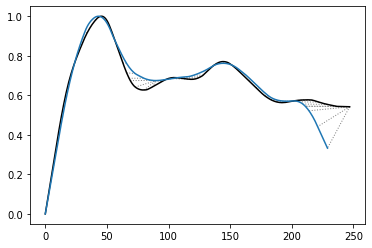

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.556089212559156


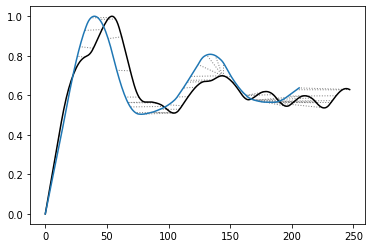

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.214640674737681


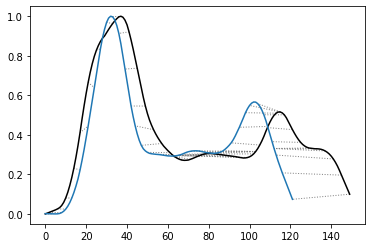

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.151405577429557


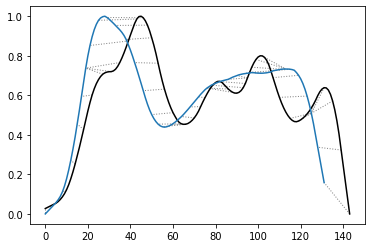

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.547441306846455


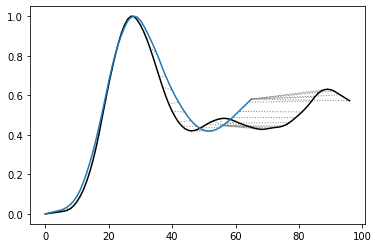

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.462459523083401


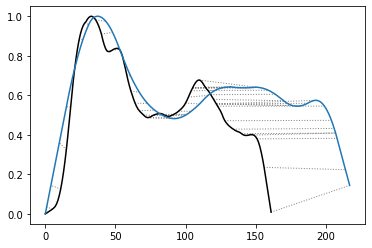

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.011054133102968


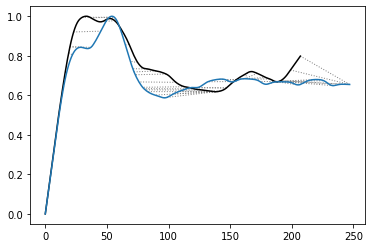

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.221304113774045


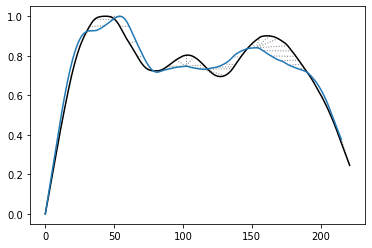

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.6566213998956285


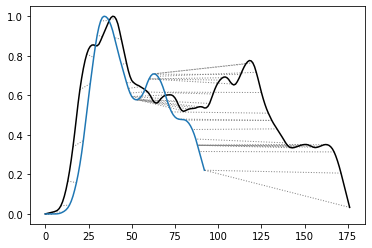

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.093664461085953


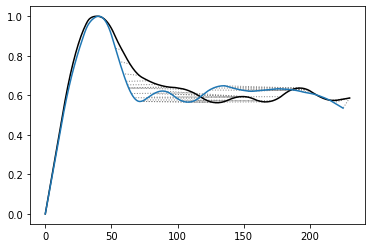

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.1333836344829886


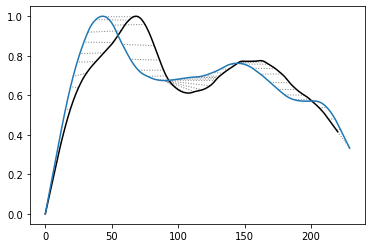

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.9485297249263102


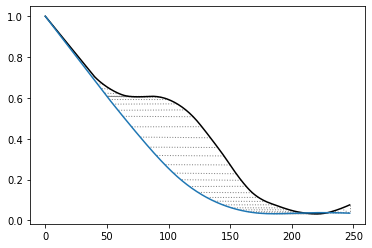

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.7934111188958455


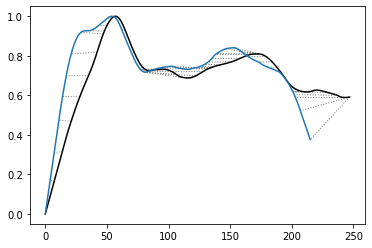

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  7.477679357492852


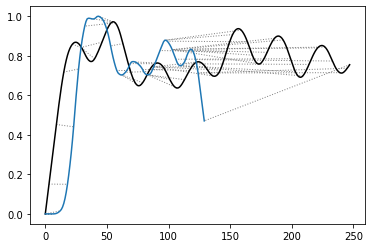

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0600240217133907


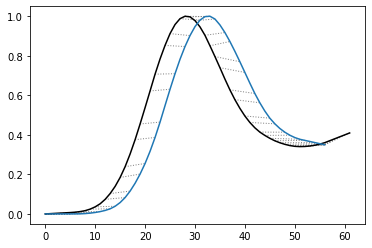

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.8210072767624518


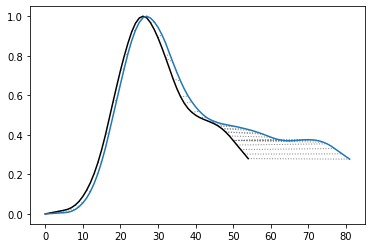

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.0930833302888514


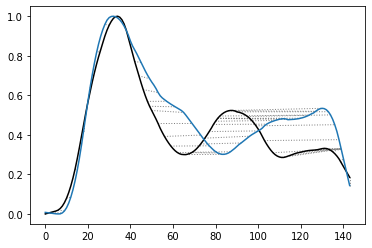

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.79618097827983


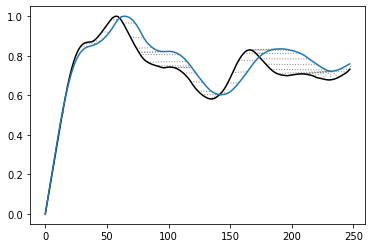

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.0313320364673224


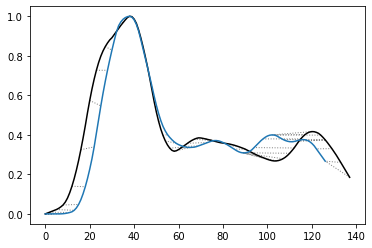

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.063901764124213


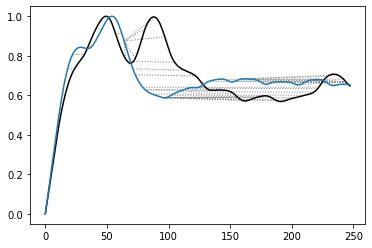

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  7.483579849968916


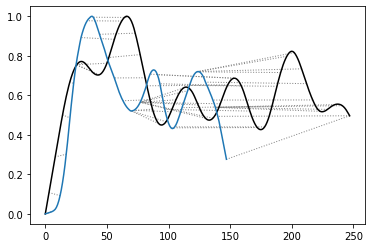

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9534515157342331


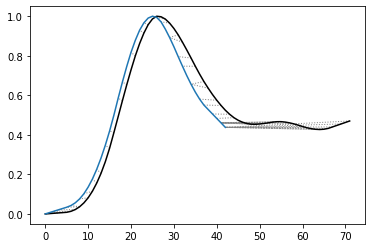

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.990623856795283


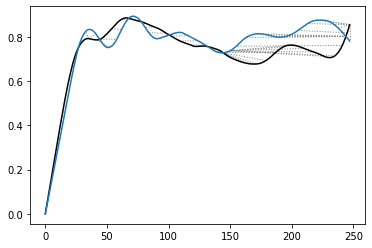

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.0166059965656227


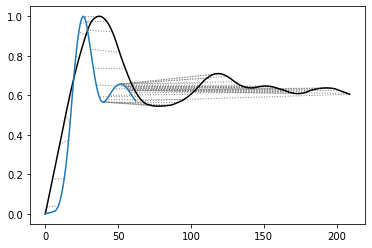

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  10.980837489412977


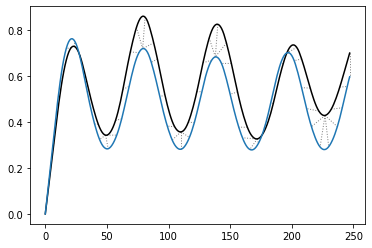

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.5860384503138982


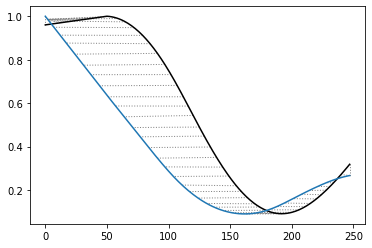

-----------------------------------------------------------------------------
p100_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  9.191387504885352


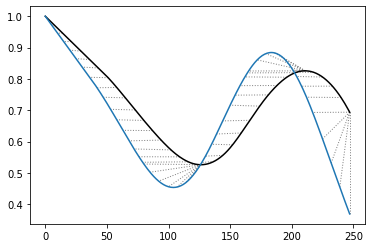

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.0842676416735286


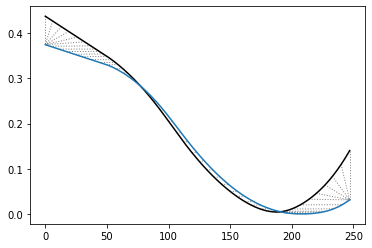

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8186083356453907


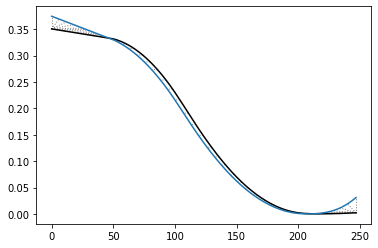

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.1534466682370303


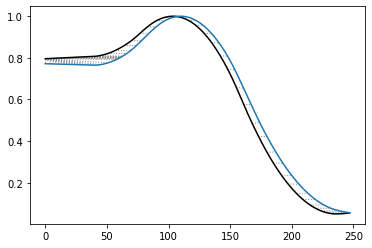

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7320225650415393


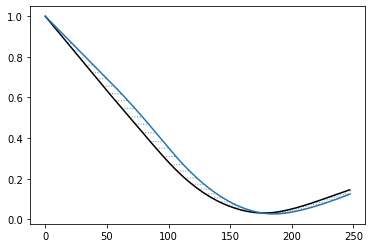

-----------------------------------------------------------------------------
p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.9507627660559086


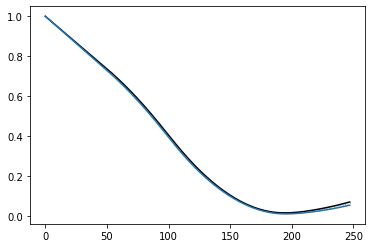

-----------------------------------------------------------------------------
p100_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8701845257500449


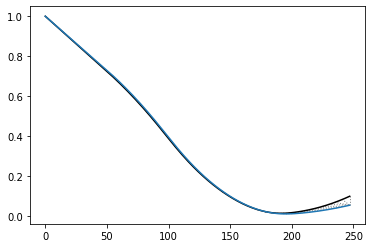

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.5927583069623457


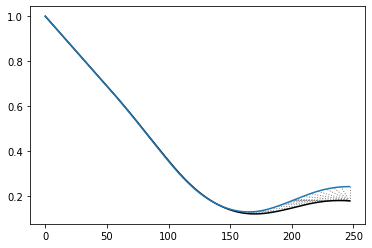

-----------------------------------------------------------------------------
p100_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  6.563098655905505


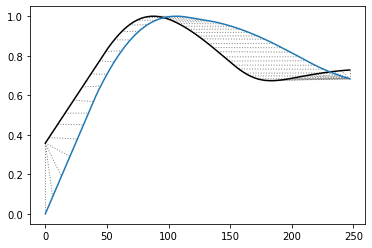

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  6.029330141153916


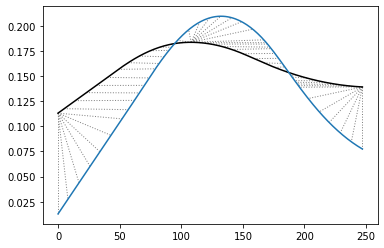

-----------------------------------------------------------------------------
p100_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.761124155599565


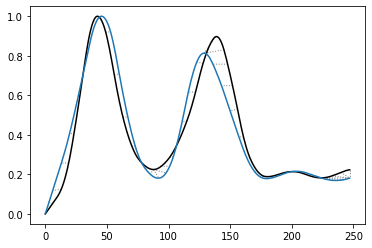

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.8274969217516452


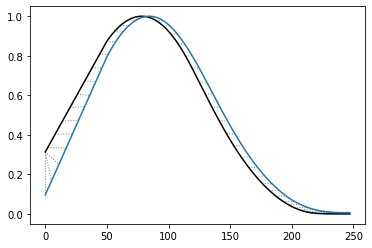

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.3724498667177776


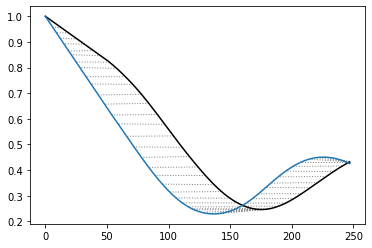

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2133251556676068


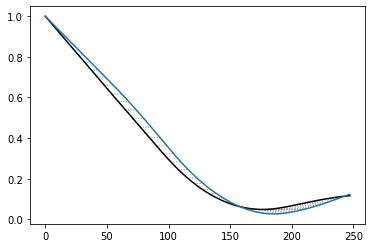

-----------------------------------------------------------------------------
p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.0400605238113583


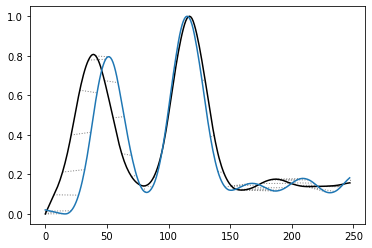

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  13.155857994780858


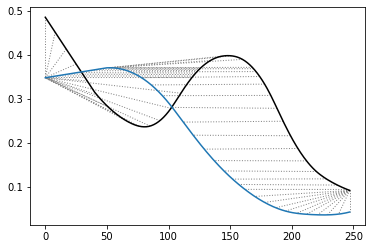

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.5883470637792394


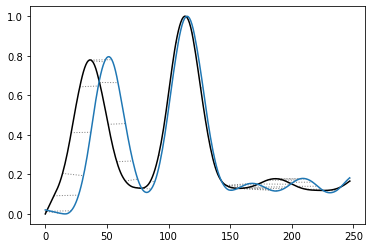

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.8224040859030872


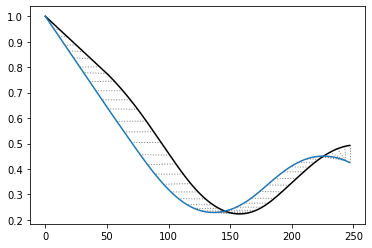

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.1731061475858249


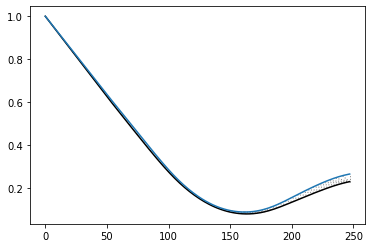

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.0328014097249496


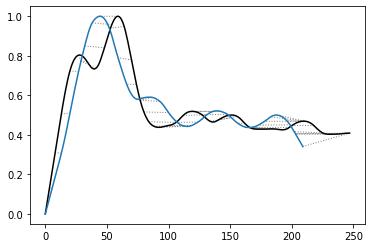

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  5.34926046292439


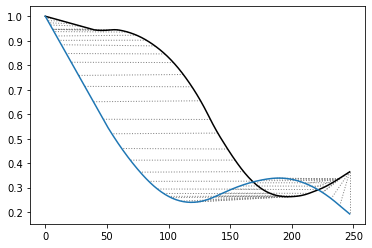

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.854051838874428


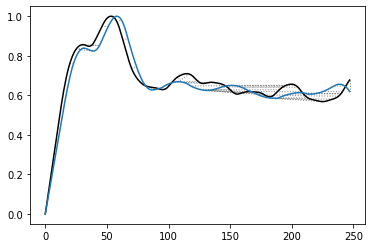

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  7.1503666237437615


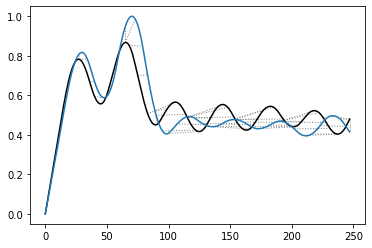

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.4298422217922908


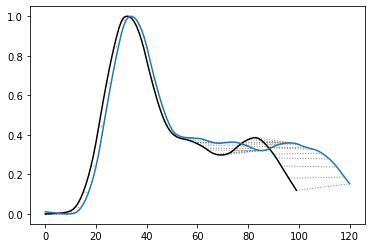

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.228950300106607


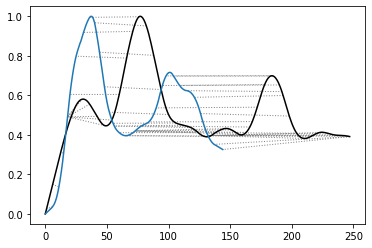

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.8297938727189136


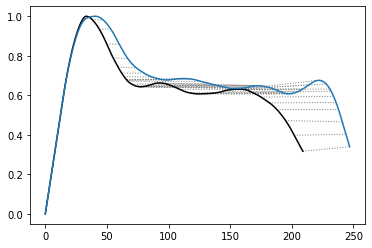

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.689088547293683


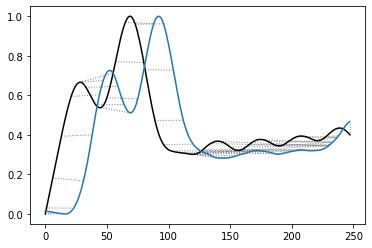

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.927082254074071


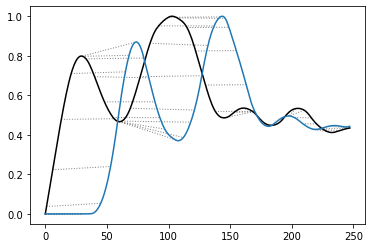

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1503982405627906


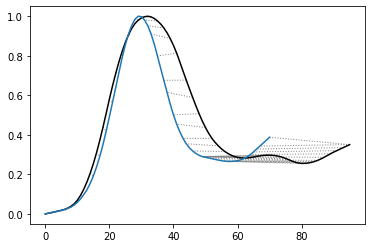

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.034392932957334


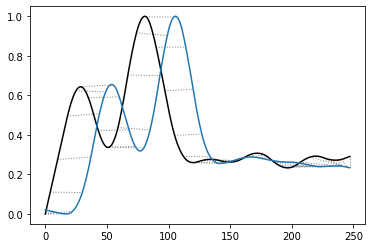

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.4397393694444496


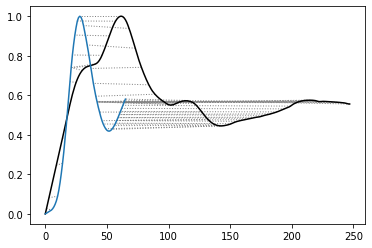

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.5522781279538955


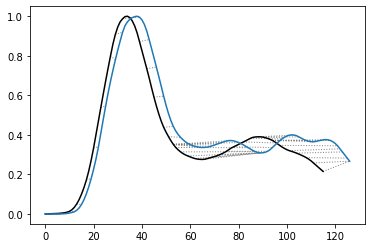

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  4.402446702180617


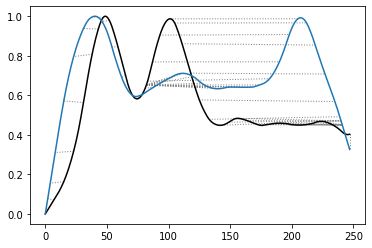

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.4420257255291515


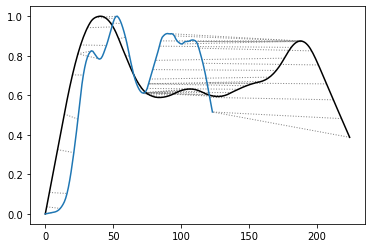

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  5.389988662019949


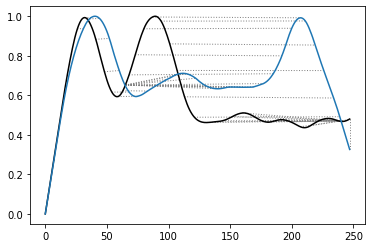

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  7.281203852819794


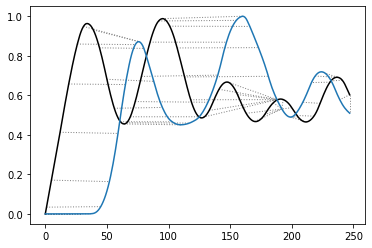

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.499167383246097


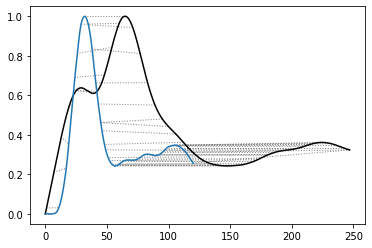

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.236265735673146


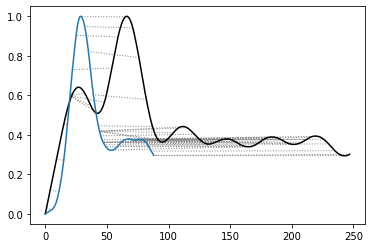

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.1232735682907586


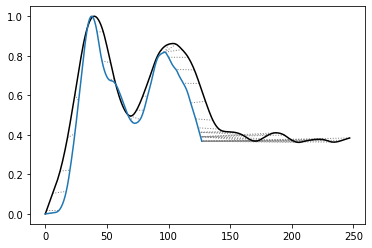

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  14.112710464654135


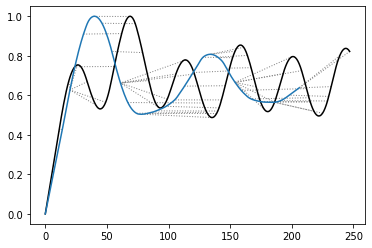

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.050286913136475


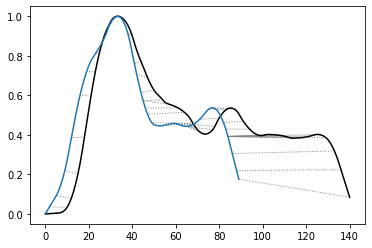

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.738432550525176


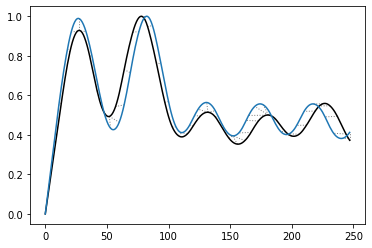

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.062490420275452


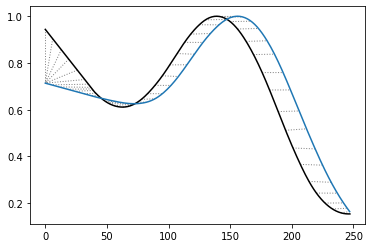

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.99722064290366


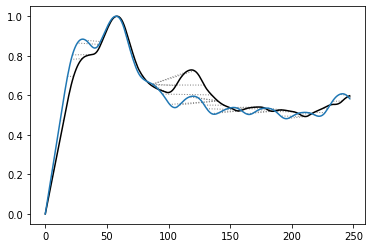

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.976173998566215


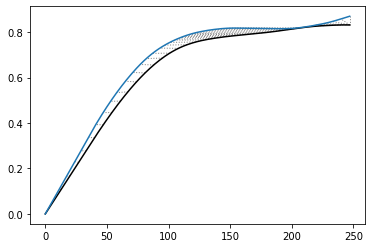

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.8888533522775806


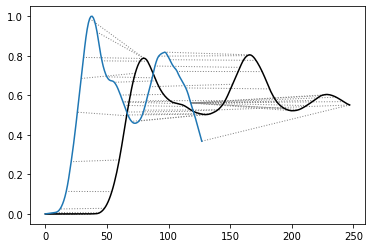

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.6336464621101533


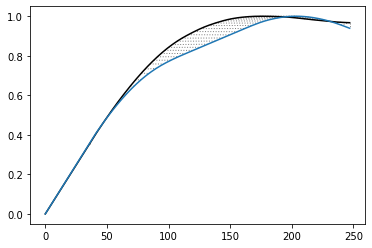

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6268625367690881


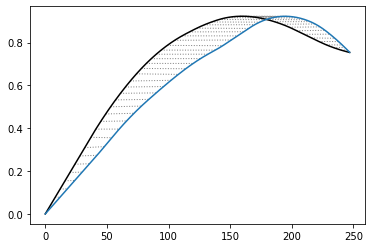

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8909773544992774


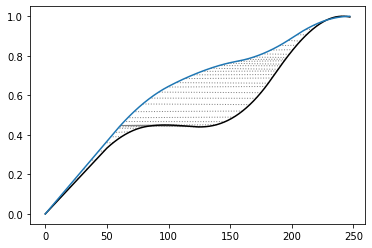

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.5505708926013833


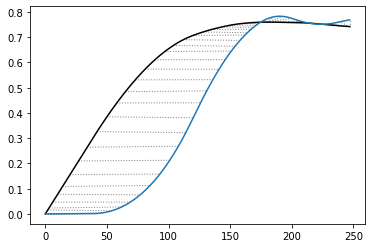

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.6587884471611384


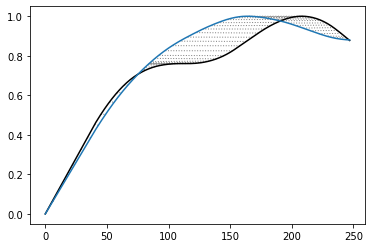

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6718140853292214


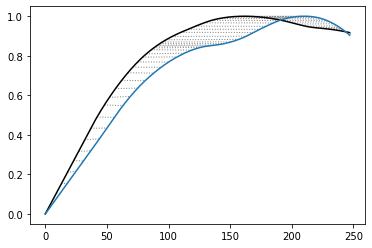

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8362925599582602


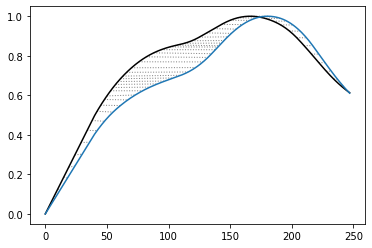

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.4546256186546533


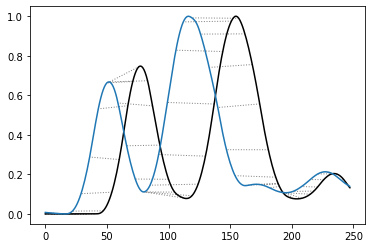

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.6603366812717959


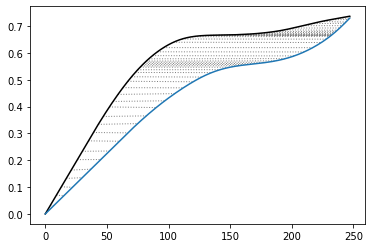

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.7010053282888795


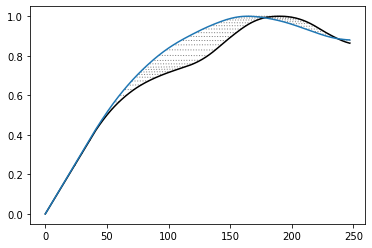

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7835019044490109


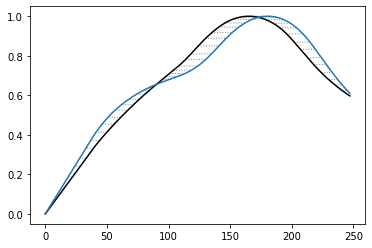

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.7920373850742862


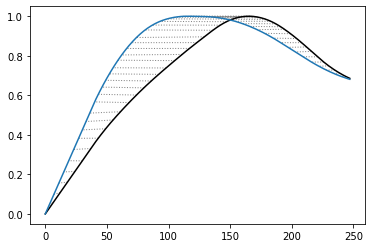

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  12.578595473024011


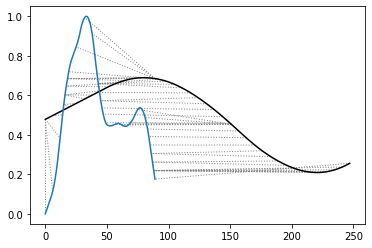

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.720462658623013


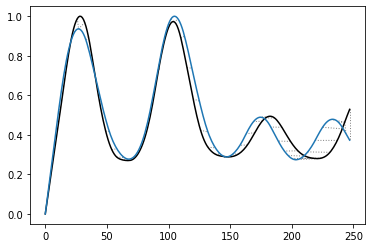

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.993046693404836


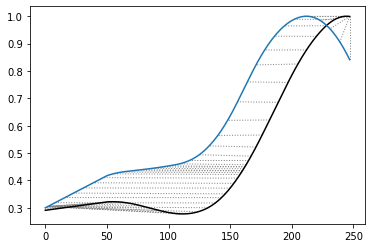

-----------------------------------------------------------------------------
p100_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.390145099658048


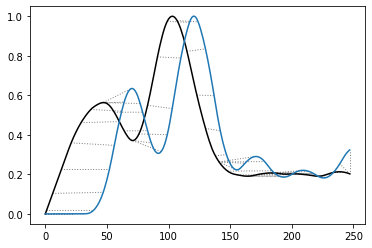

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2254829279671386


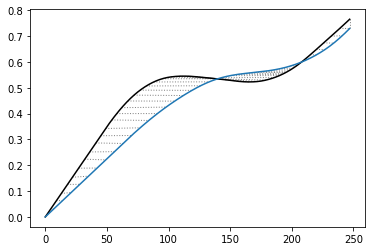

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.5445199813643158


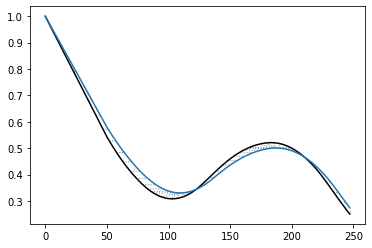

-----------------------------------------------------------------------------
p100_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  6.038980443386188


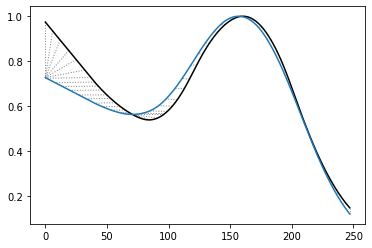

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  6.830674498368603


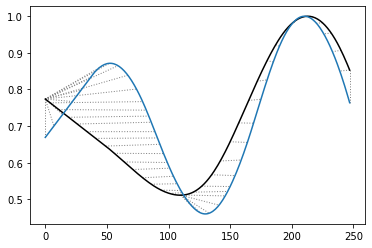

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  5.3436744908046245


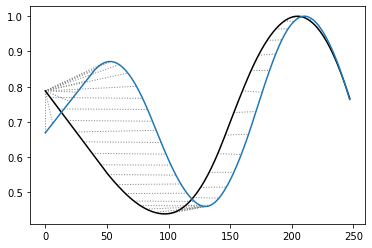

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.5226401187110858


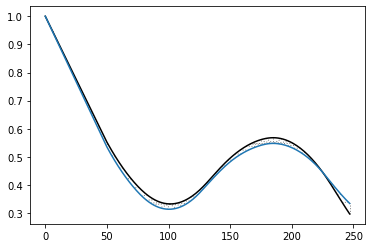

-----------------------------------------------------------------------------
p100_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.5569968590570682


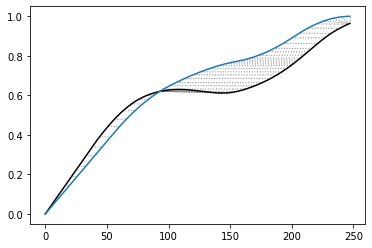

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.739842618808596


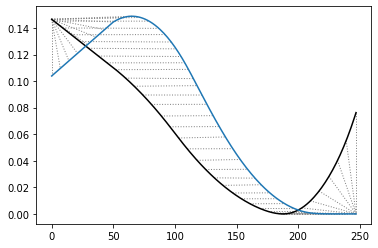

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  10.487311411297279


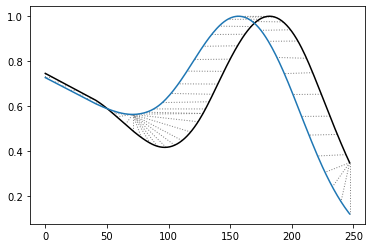

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.3577715758159545


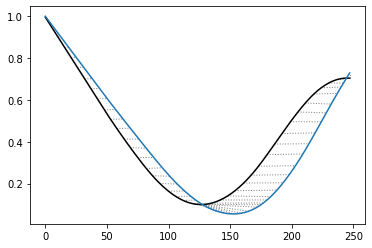

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.177467104184603


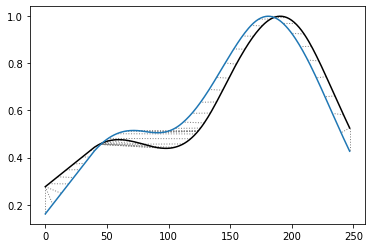

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.765892473688772


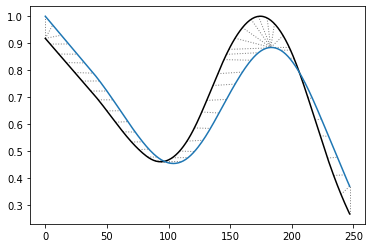

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  6.720221348534316


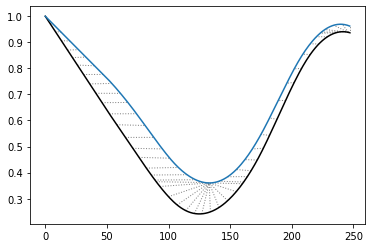

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  16.740819404386492


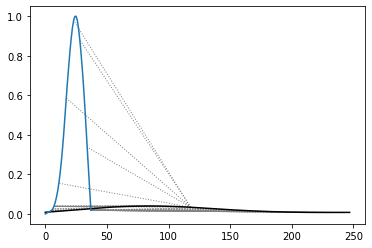

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  11.298165637863884


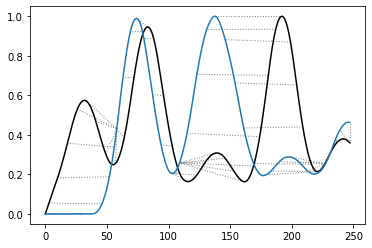

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  8.226846139318024


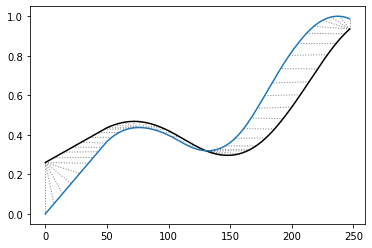

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.364002485585935


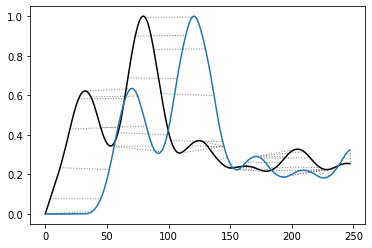

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.1843108955785686


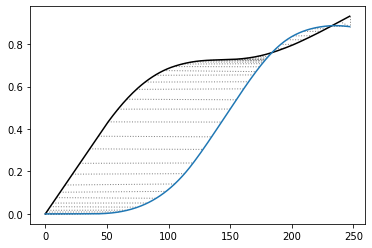

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.3423249400503554


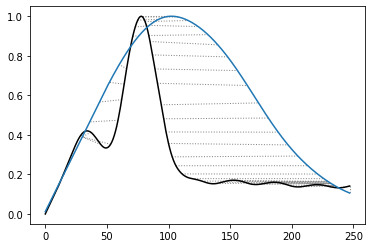

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.509552871301058


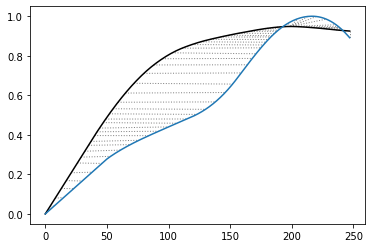

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.9499036636524272


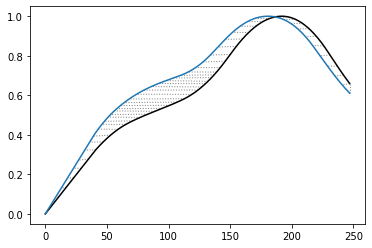

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.3105662375423197


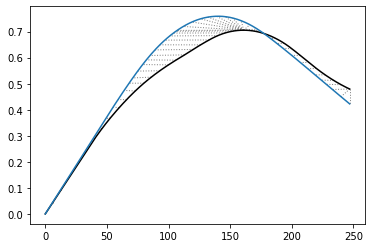

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.1409615312404116


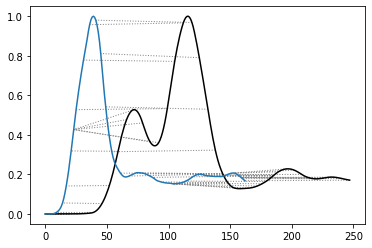

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.8928508330782511


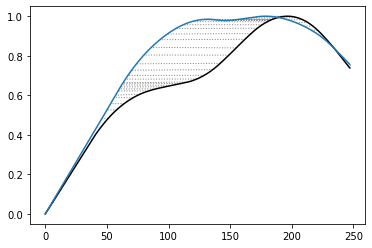

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.8183507166773446


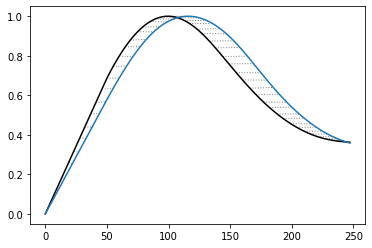

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  7.776772501907209


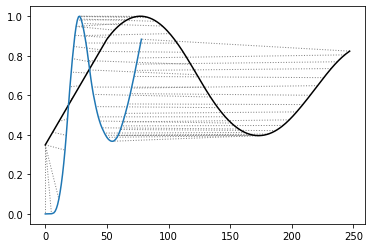

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.47371723888349


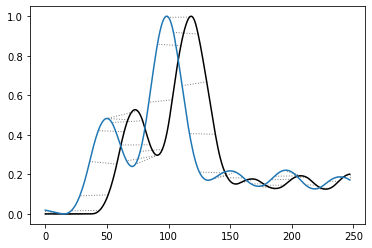

-----------------------------------------------------------------------------
p100_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7420126526972755


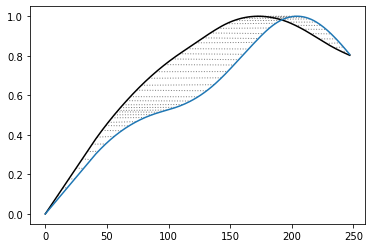

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.3485207576648544


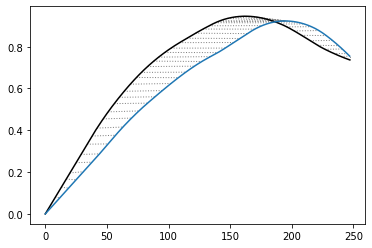

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.834545122601806


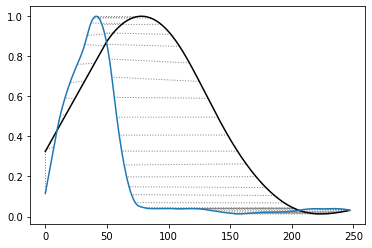

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7033773578798711


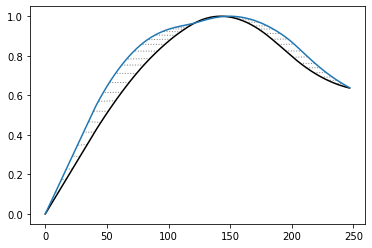

-----------------------------------------------------------------------------
p100_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.6593771017414936


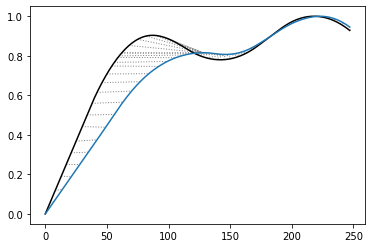

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.068144789854165


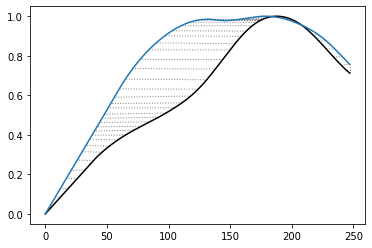

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.973333805672562


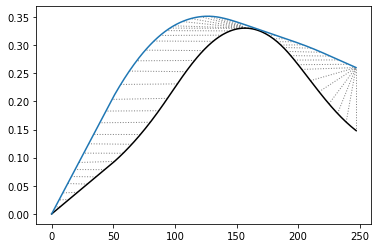

-----------------------------------------------------------------------------
p100_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.0126803952084105


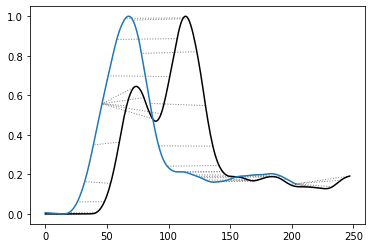

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.6210717019547258


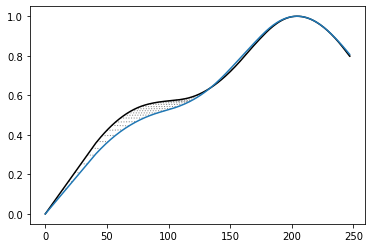

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.66485006297675


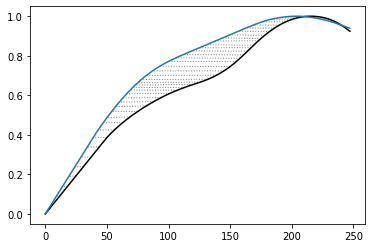

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.5506804068083028


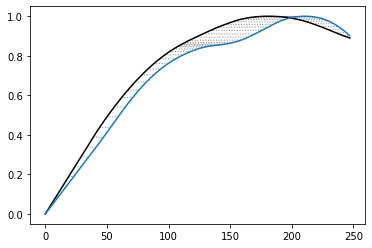

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.185762510312285


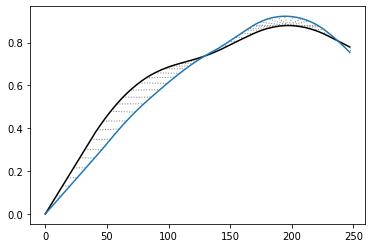

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7233775071733529


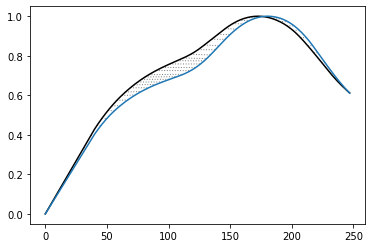

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.2609608901936165


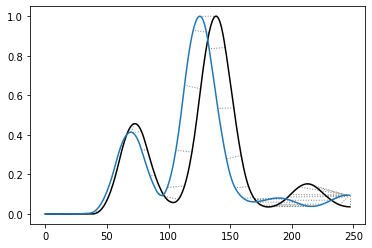

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8209741796623041


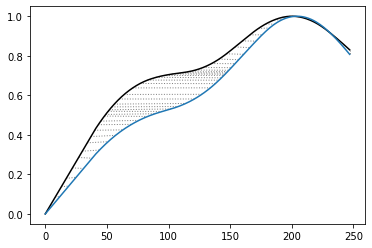

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.300156626094494


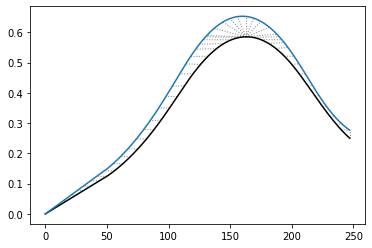

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.4855402742709175


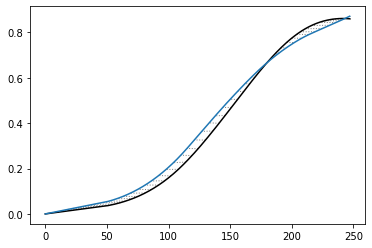

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.5458190374166724


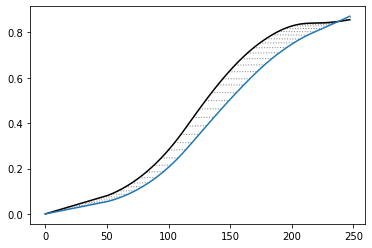

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.6611546877292444


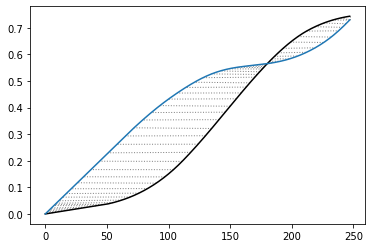

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.5067322027724837


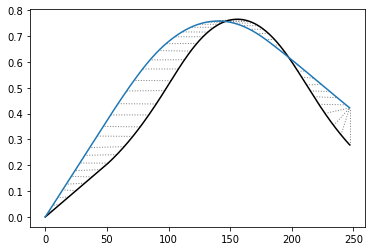

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.10755766620633


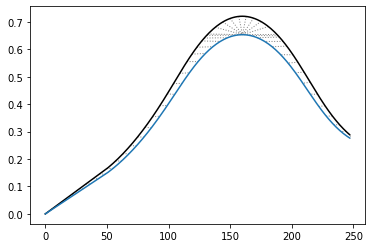

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.9539633077479768


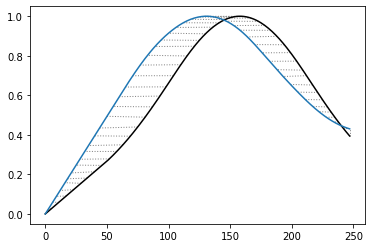

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.4988634921027075


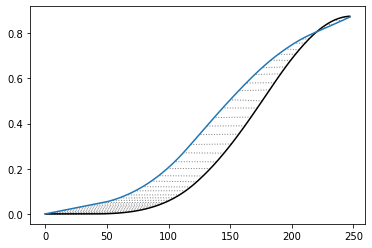

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2043285875081051


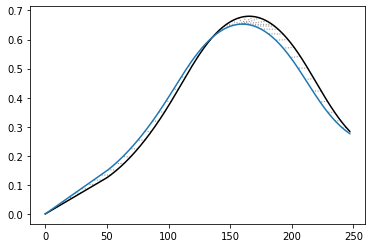

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.0571941401332987


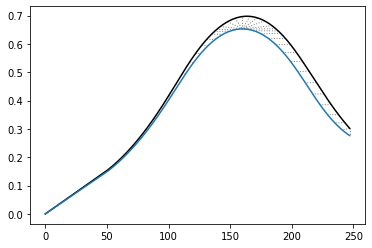

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.6564302455752102


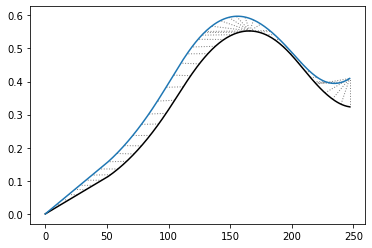

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.029969283822039


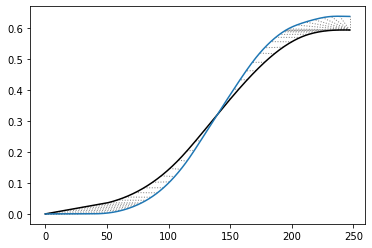

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7893982450057


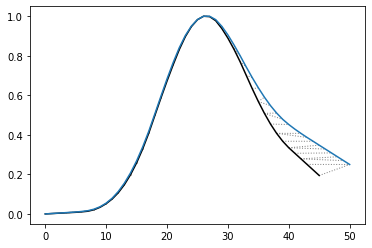

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.2536533741810043


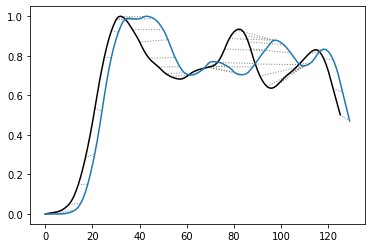

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.293419023174821


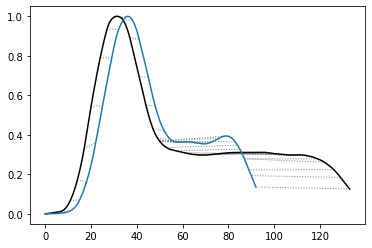

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.103466330327415


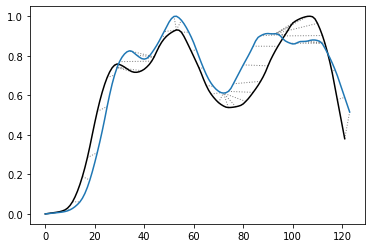

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.611441723837319


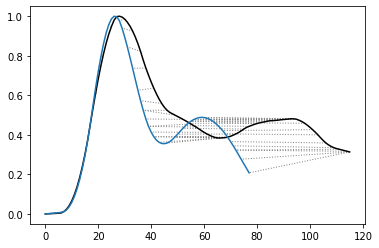

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.8640572202446921


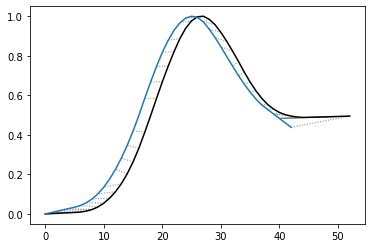

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.591826922348372


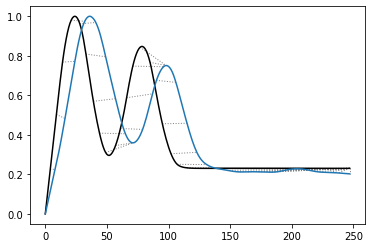

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.996387956053975


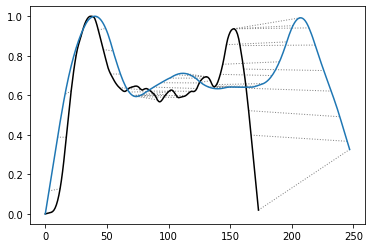

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.438403688228952


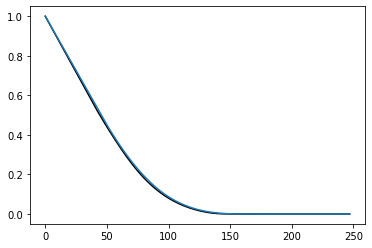

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0381606136285884


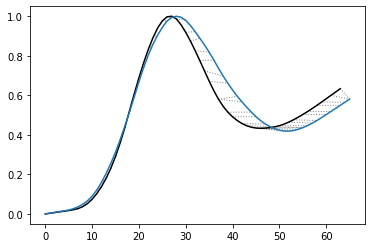

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2473636016133651


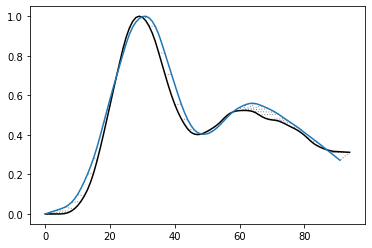

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  5.160756345021304


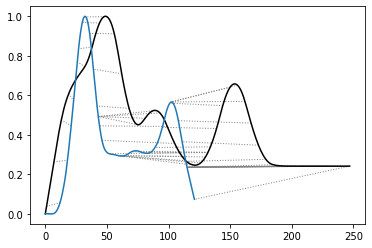

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.507232881321269


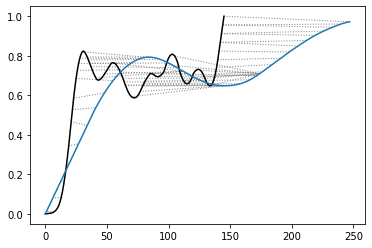

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.6381401511752711


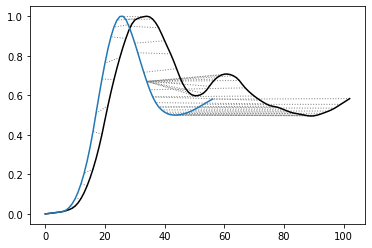

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.274180919296005


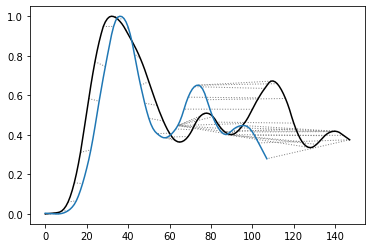

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.9878531914053426


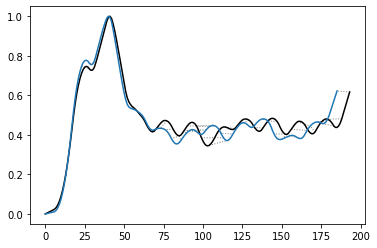

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2182102069296017


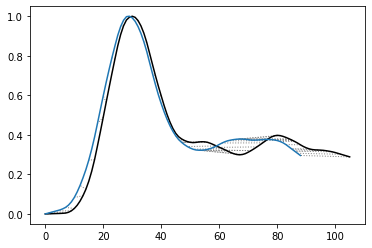

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.1234804512720618


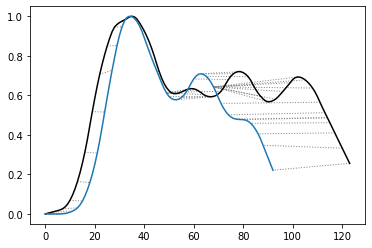

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.7872457917587847


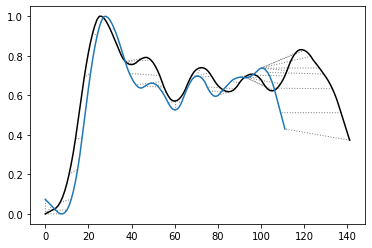

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.5888531734107323


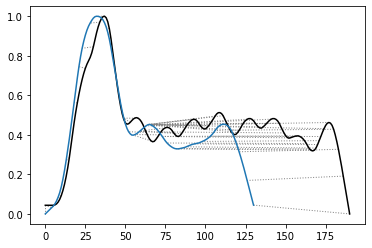

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.473977099525675


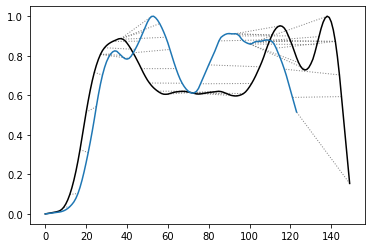

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.880095059330768


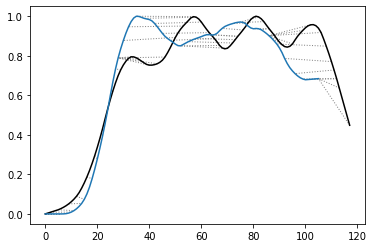

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0161653736747556


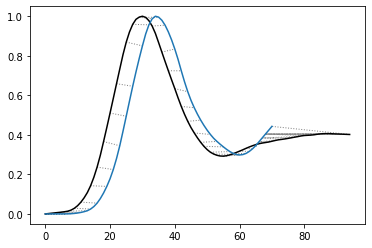

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  6.6694378122577636


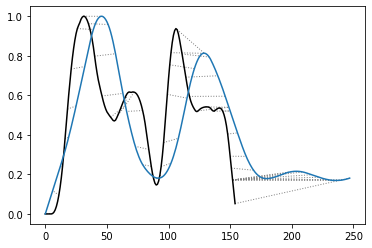

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.309837175121683


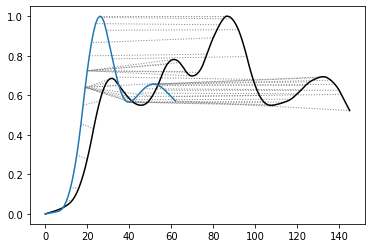

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.589447922302664


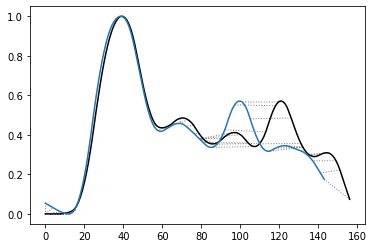

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.8637025033482937


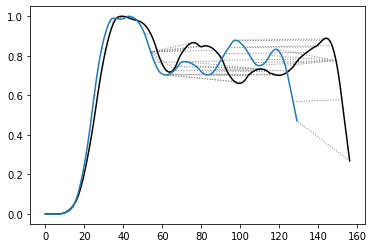

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.4119252524779657


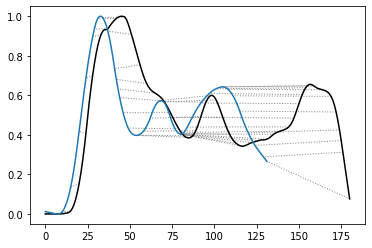

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.9345888902417328


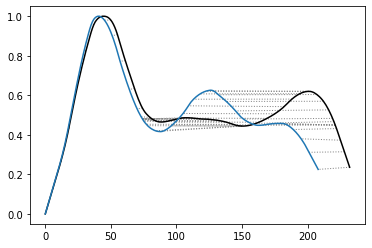

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.3153774112081185


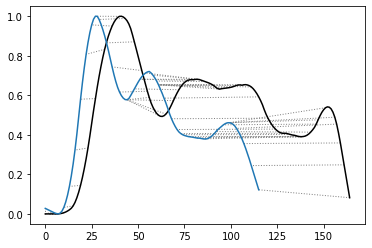

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.2809639712592067


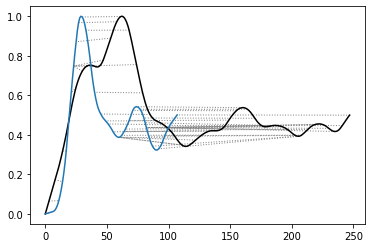

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  8.024350341057485


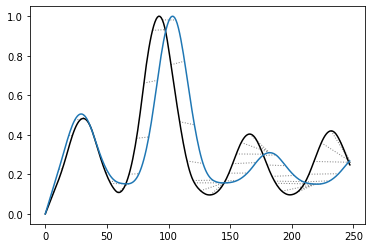

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7107875786629665


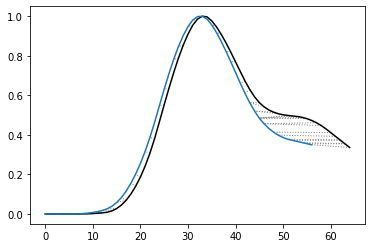

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.1770313368295677


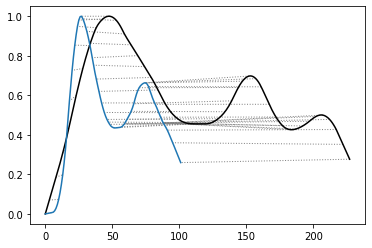

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.4539825928887935


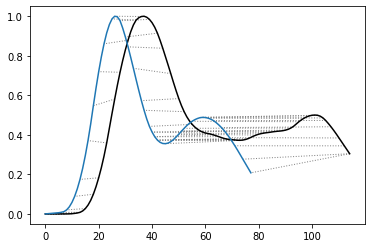

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.935580628594498


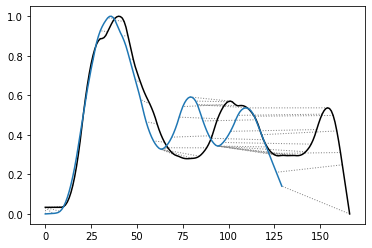

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  15.84029866326864


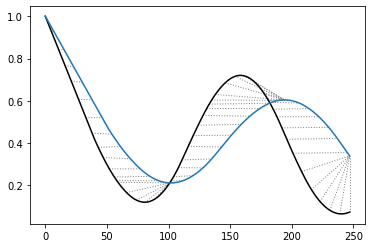

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.037678564475619


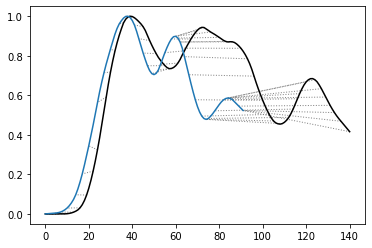

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.9455459336845684


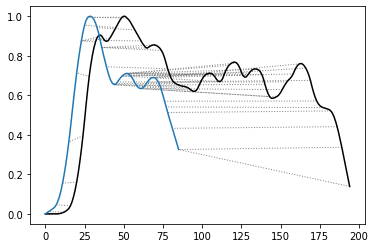

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  6.4711867878416625


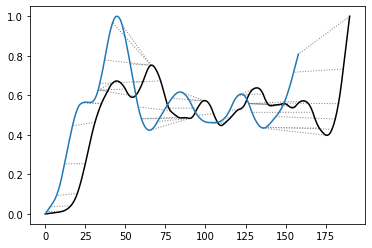

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.2298076804606017


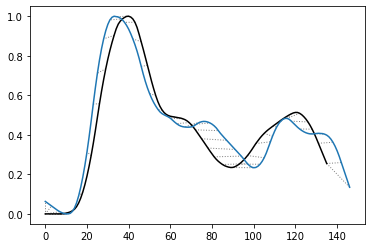

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.7889223389647684


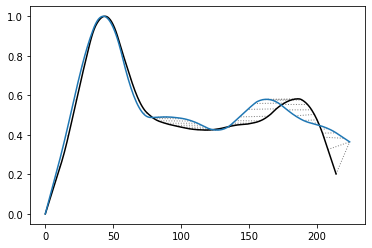

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.367527922138277


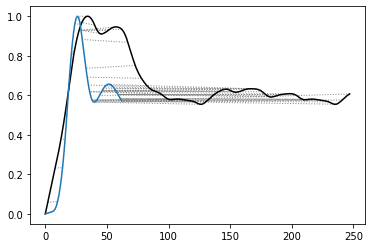

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.5282945451723176


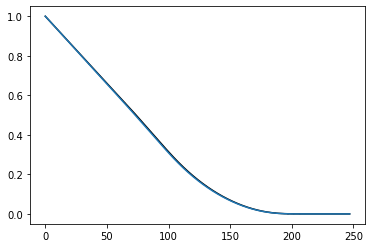

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  7.258044812937424


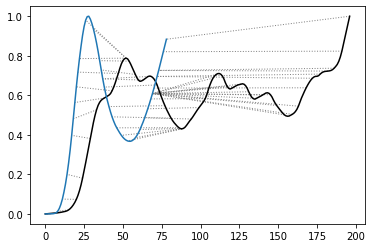

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.2932334550676523


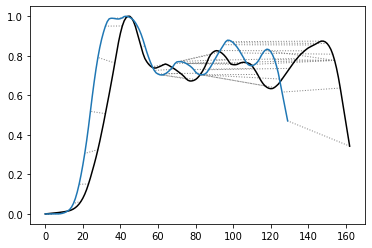

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.1579074448717888


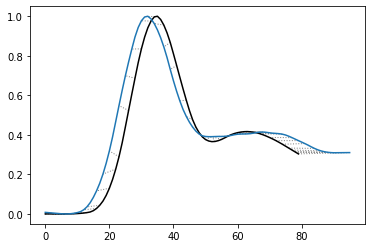

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.4693653470930563


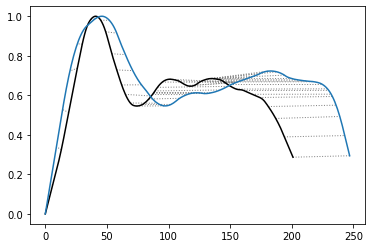

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.4279625029480973


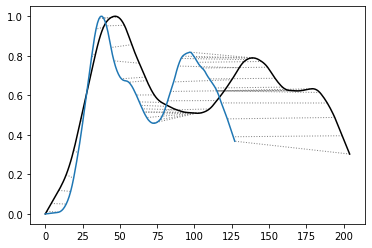

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.6433235975563454


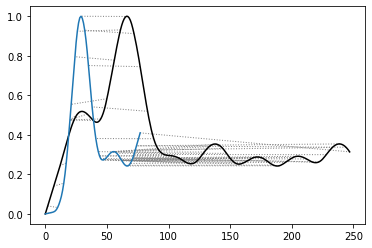

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.93601055721025


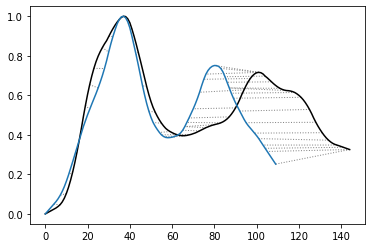

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.9878531914053426


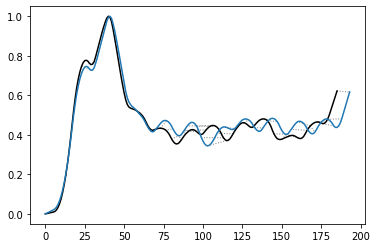

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.2316738621903676


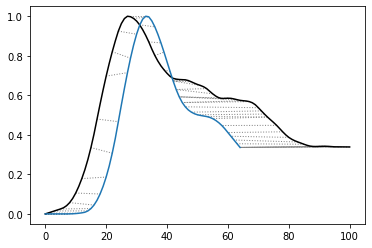

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1476320937421227


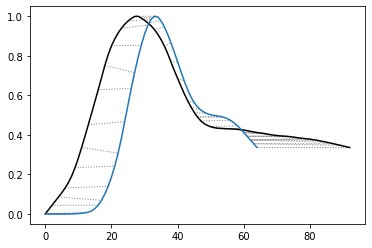

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.8210072767624518


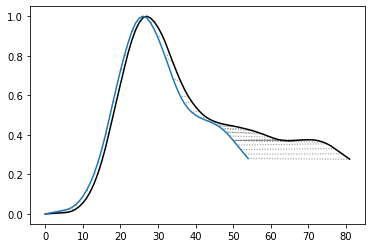

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.079444184816026


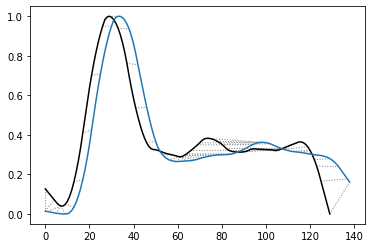

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.2228216008225457


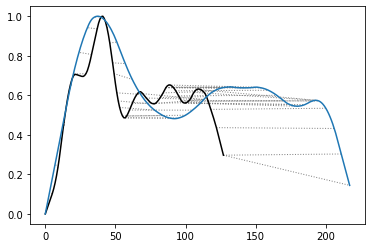

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.552774693868332


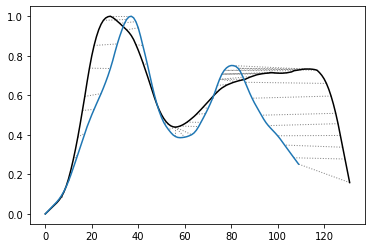

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.8252525741513983


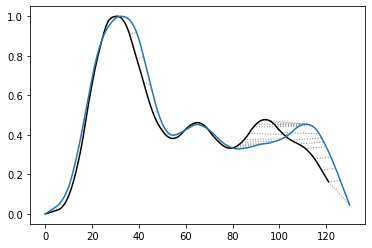

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.4131579713181024


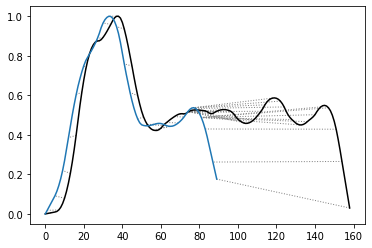

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.095200605713692


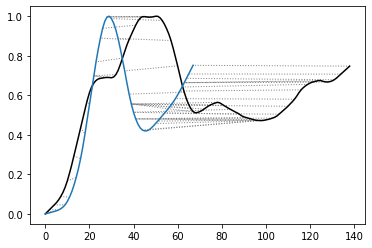

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.7059983208079269


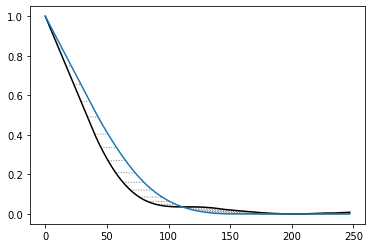

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.8570775001700564


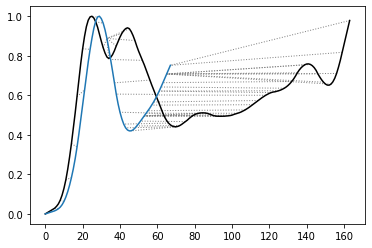

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.6088203814648274


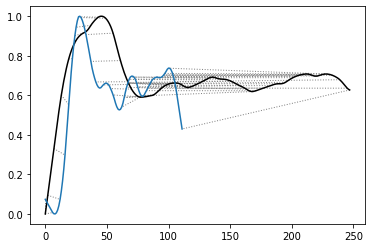

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.5994560981853052


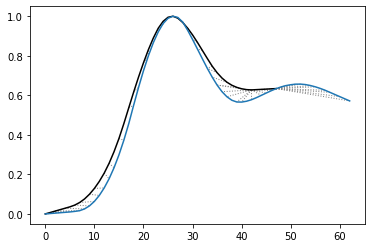

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.8640572202446921


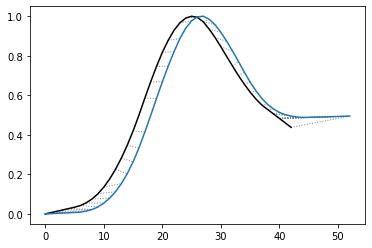

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.4142924913771693


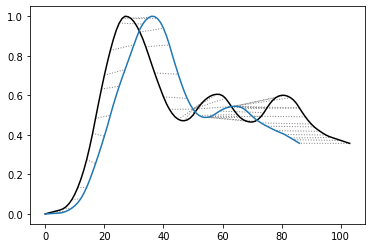

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.168733903202404


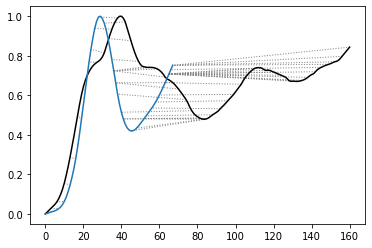

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.2473636016133651


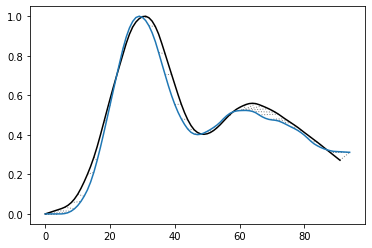

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.8117906221564786


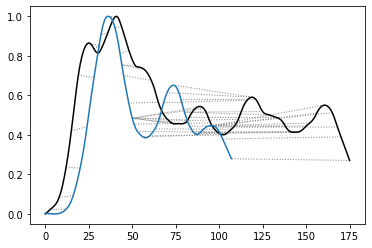

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.093664461085953


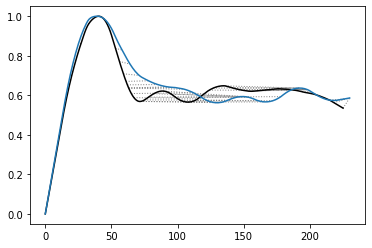

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9475990977747832


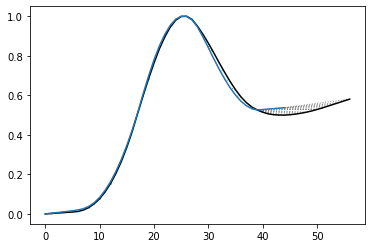

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.094730405195727


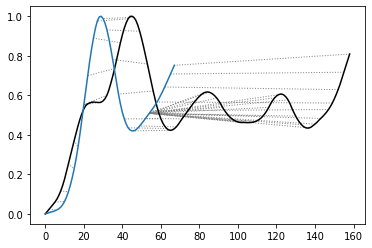

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.644698131631416


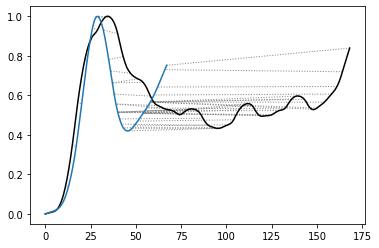

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.79618097827983


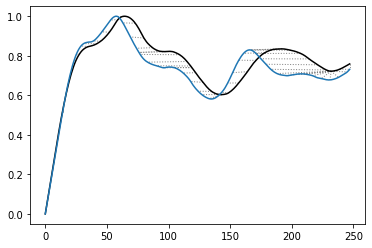

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  9.770768218914046


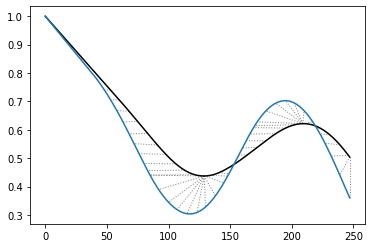

-----------------------------------------------------------------------------
p3_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  8.335117609345085


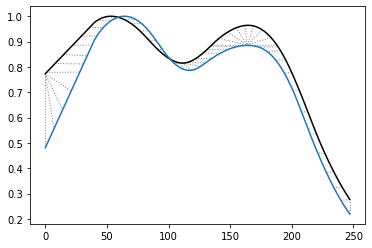

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.8629198832001064


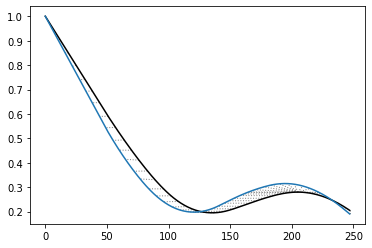

-----------------------------------------------------------------------------
p3_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.381123704604688


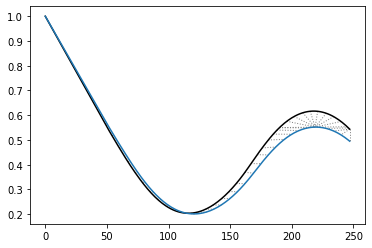

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.138657313718884


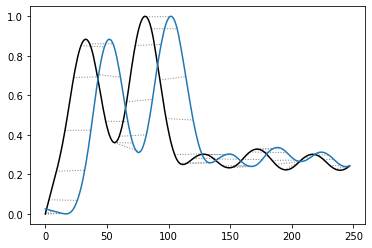

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  8.288745555260265


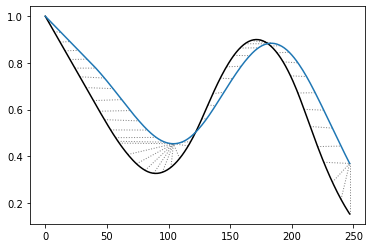

-----------------------------------------------------------------------------
p3_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8753231565956455


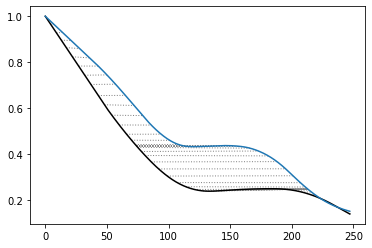

-----------------------------------------------------------------------------
p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.5438909785906447


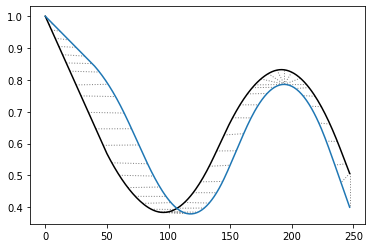

-----------------------------------------------------------------------------
p3_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.315962015072165


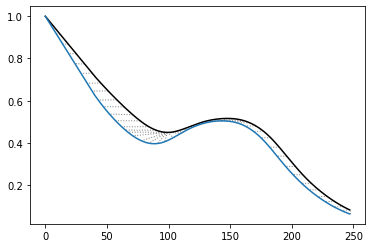

-----------------------------------------------------------------------------
p3_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.2338826437438264


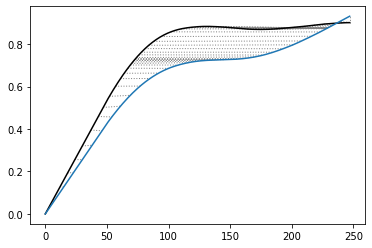

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8186083356453907


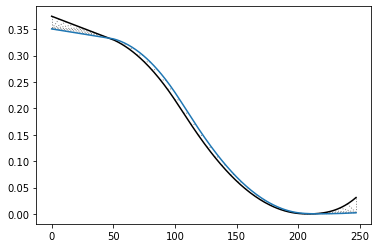

-----------------------------------------------------------------------------
p3_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.425025063301375


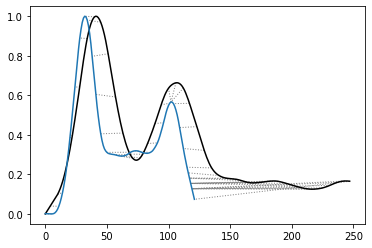

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.9475203898654416


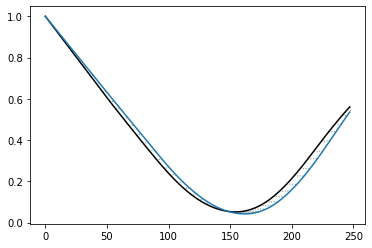

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.8656057092819247


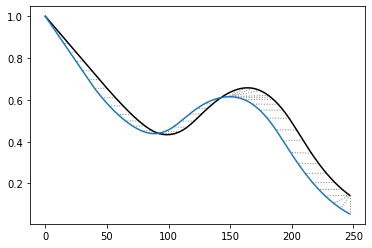

-----------------------------------------------------------------------------
p3_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.709570576120067


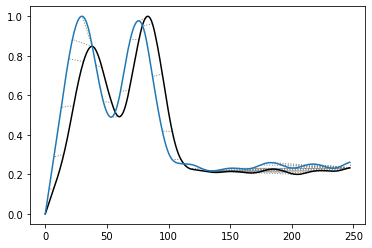

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.761688762568282


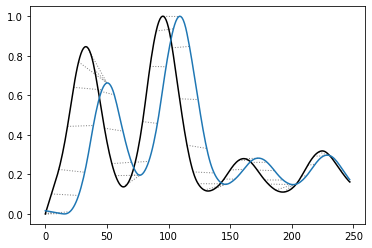

-----------------------------------------------------------------------------
p3_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  5.236068793320164


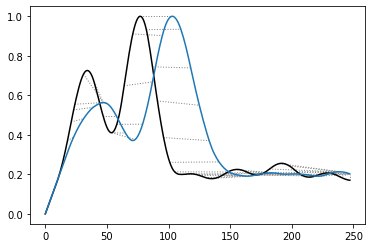

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  11.319416930642571


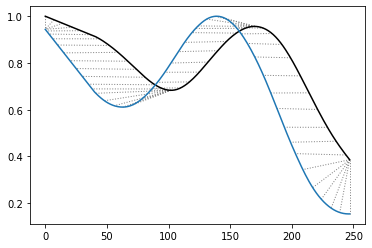

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.274772406681624


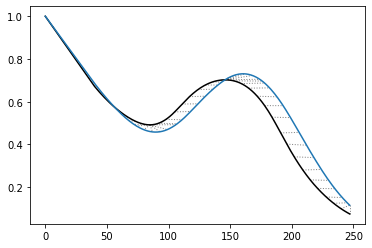

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.3228362942070224


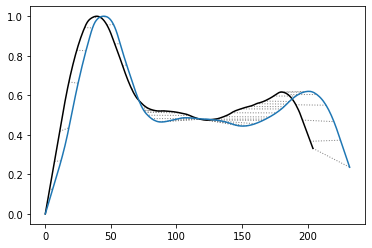

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  11.688709702620256


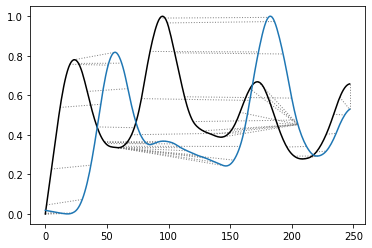

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.1333836344829886


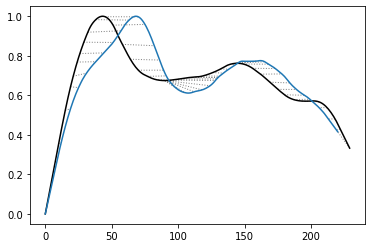

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.7080731866495062


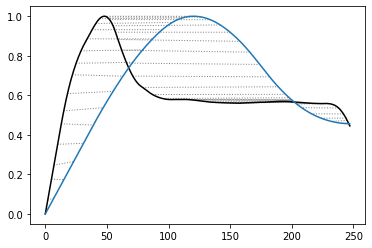

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.7755024728406756


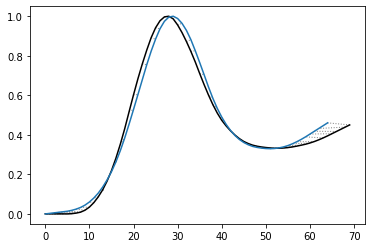

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.7934111188958455


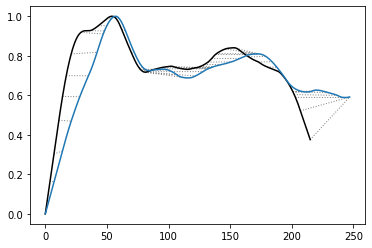

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.5191101558455613


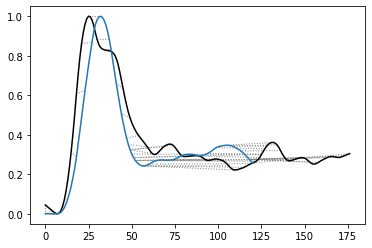

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.7275377150368803


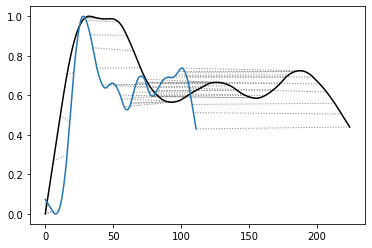

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.886414440467809


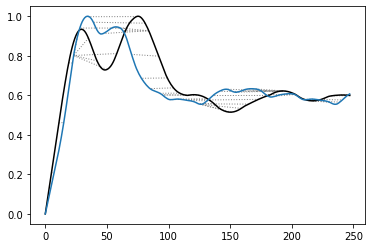

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0381606136285884


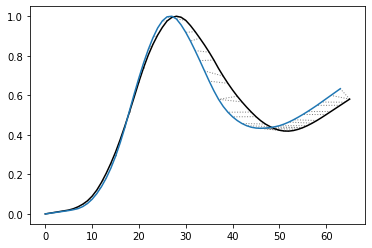

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.0078893510175595


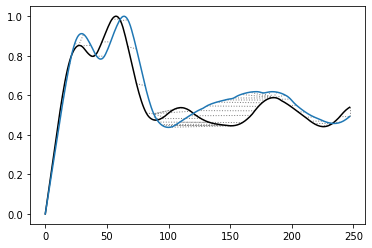

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.2023660864713794


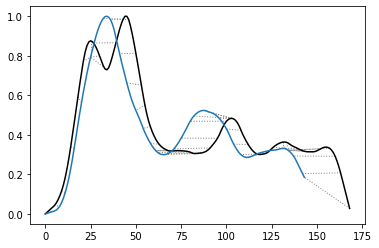

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.4539825928887935


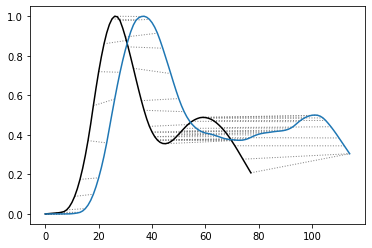

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.990623856795283


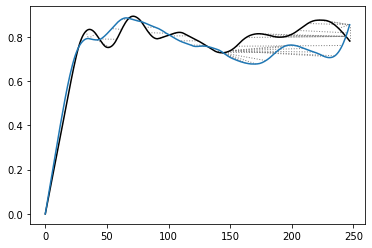

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.5858356165594345


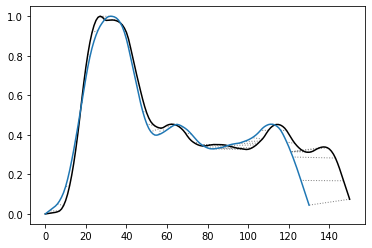

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.9620855734931832


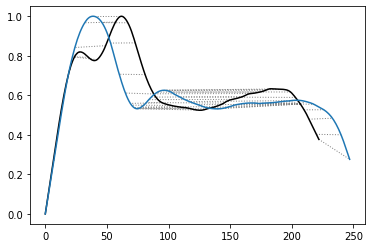

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  4.979312278275866


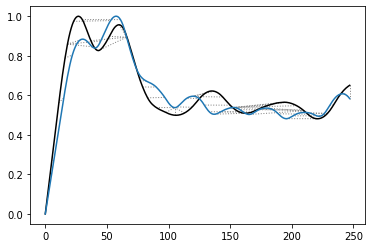

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  7.22989540085261


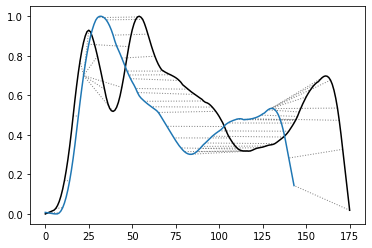

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.4279434525402737


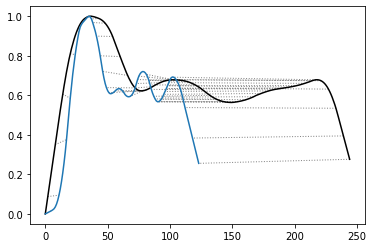

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.7450767186453895


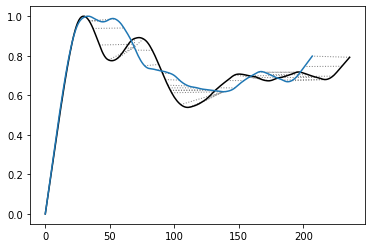

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  6.594561932496389


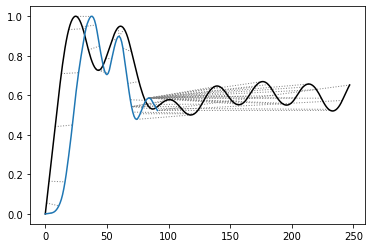

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3917185339555895


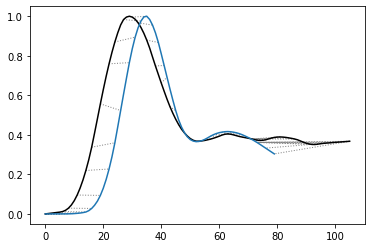

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.543135133516245


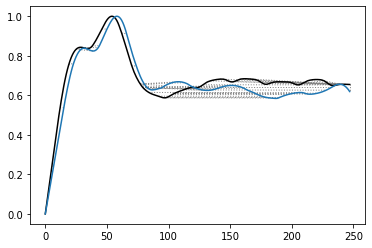

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.0054739551818166


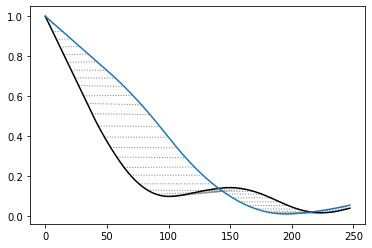

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.795504719410974


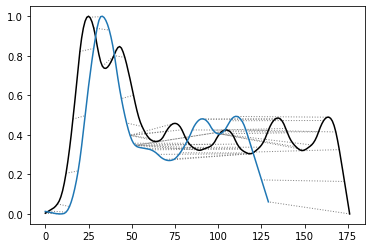

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  7.281203852819794


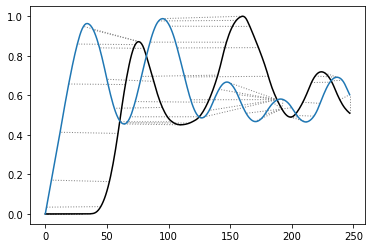

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.338342450249712


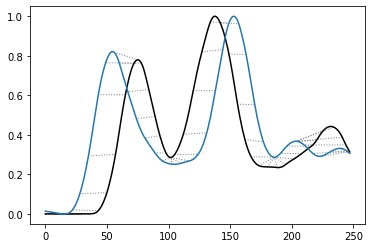

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.927082254074071


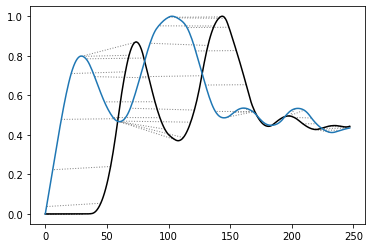

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.3108718726143254


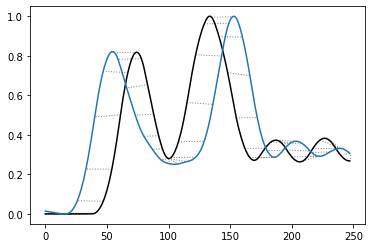

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  4.853436738804696


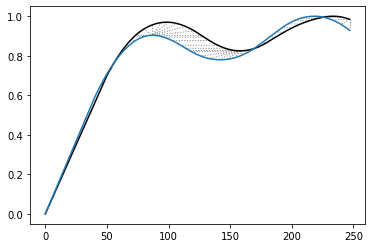

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.8021482057791256


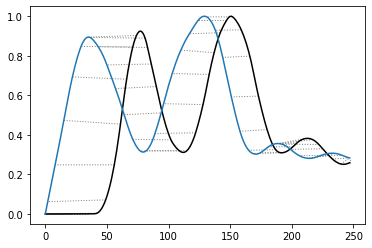

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7920373850742862


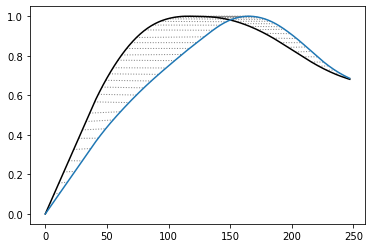

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  7.098638816515384


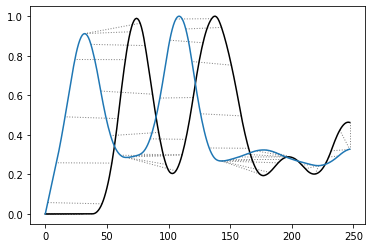

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8242979728283704


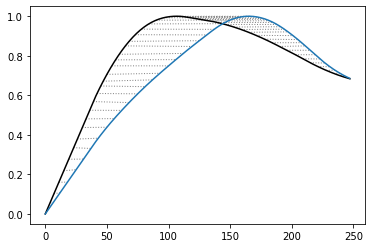

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  5.366155579452057


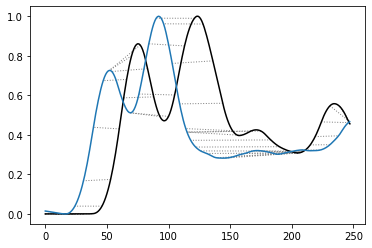

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  6.657791539883244


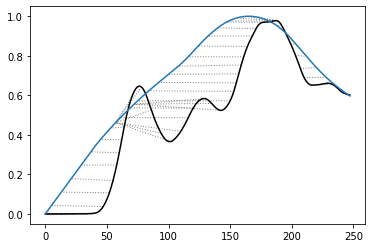

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.006801285562142


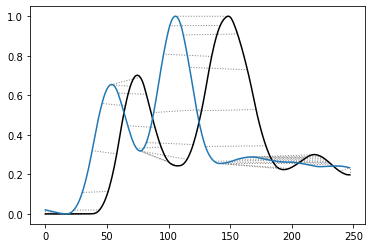

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7033773578798711


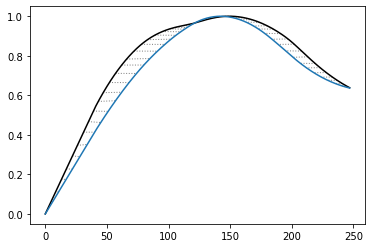

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.1390384450021216


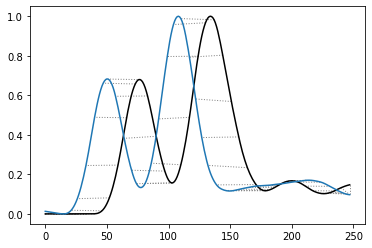

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6584894978720616


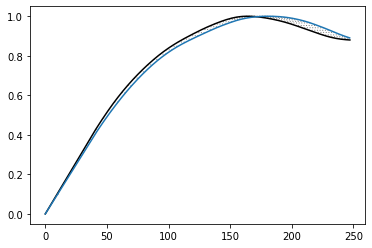

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  6.4117877956621205


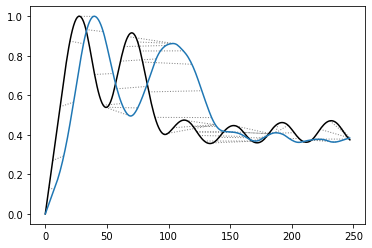

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  5.062490420275452


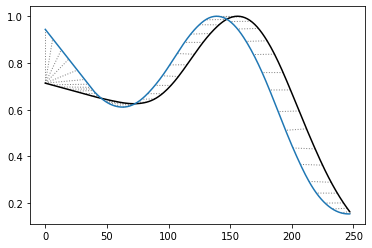

-----------------------------------------------------------------------------
p3_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.702928264493935


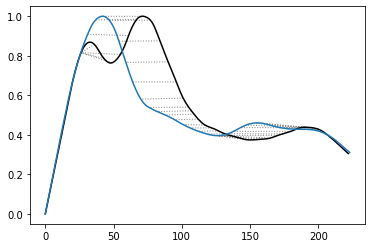

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.9406203081740472


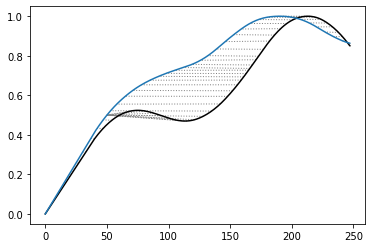

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.509396368544141


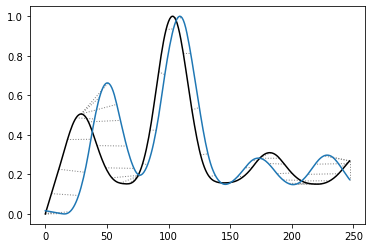

-----------------------------------------------------------------------------
p3_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.7976662273877206


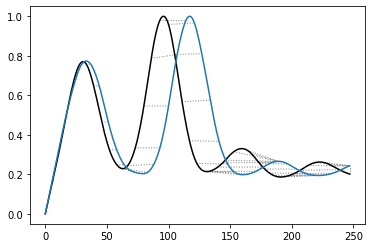

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  6.072188450456194


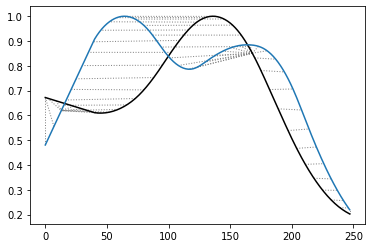

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.1534466682370303


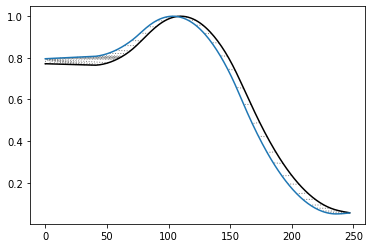

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.3649294161612728


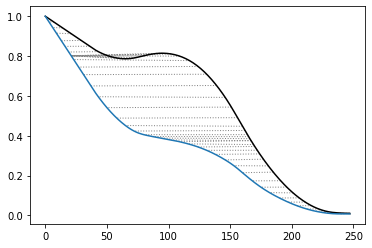

-----------------------------------------------------------------------------
p3_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.778325659769656


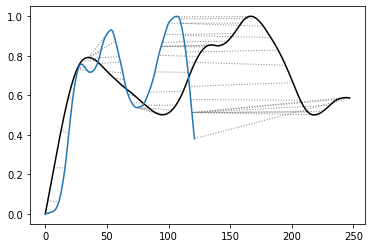

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.957017133554201


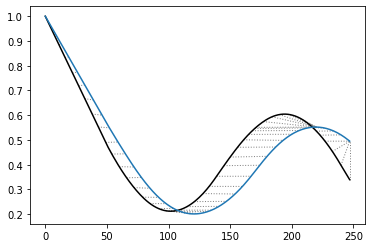

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.148933100987275


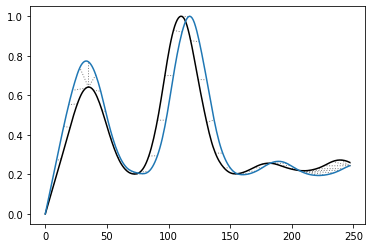

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.347866723884424


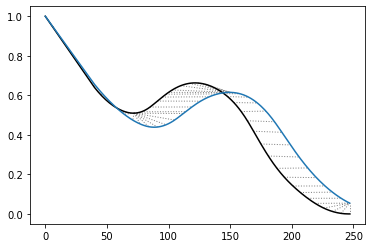

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.674838450235819


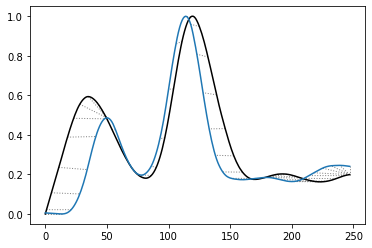

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.4249361940593195


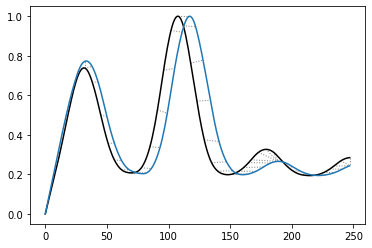

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  7.803030709165581


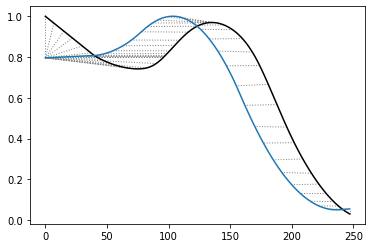

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.824510711101436


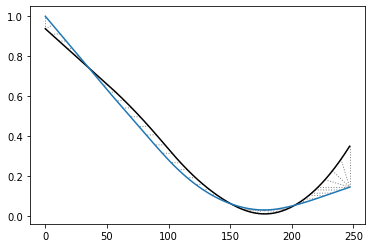

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.0512920728992654


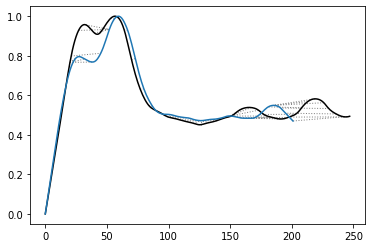

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  6.038980443386188


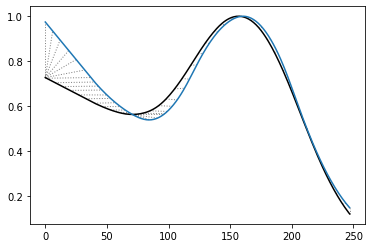

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.0769295322138093


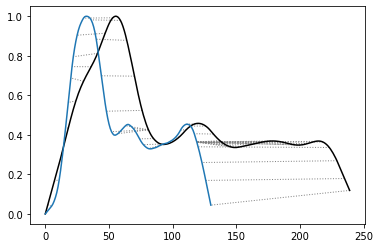

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.2003963978897407


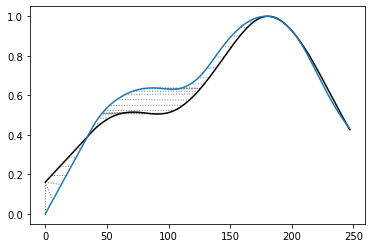

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.3517254599056858


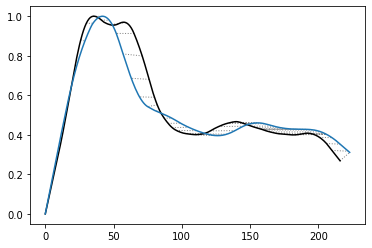

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  9.030443552972892


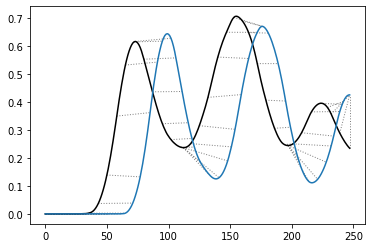

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1376928212779935


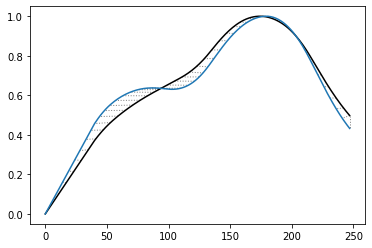

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.0820664656043983


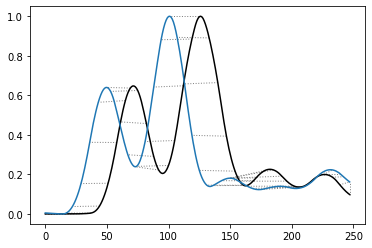

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.658444696653206


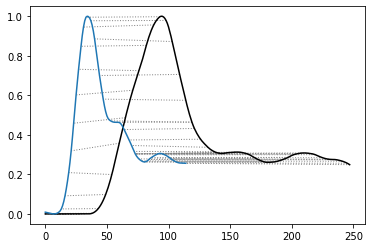

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.25772912252536


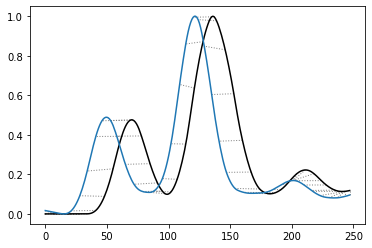

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  6.222196788849809


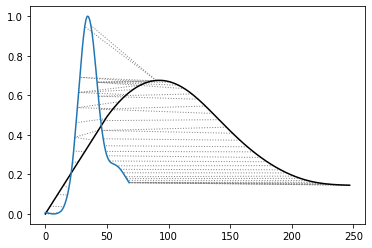

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7644847869096395


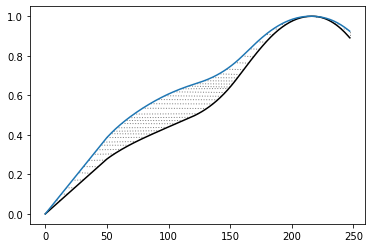

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.174572647037837


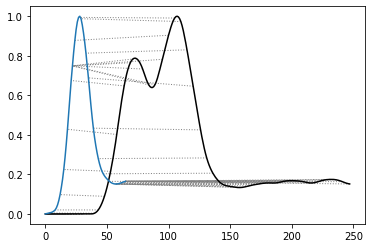

-----------------------------------------------------------------------------
p3_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.169693344105468


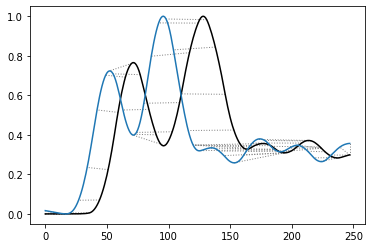

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.514476774852679


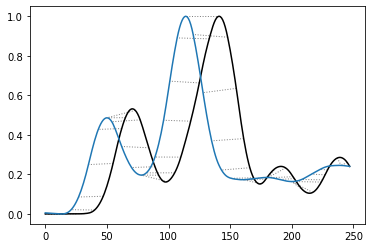

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  8.248027068025014


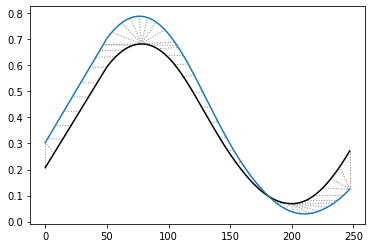

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.122559322921943


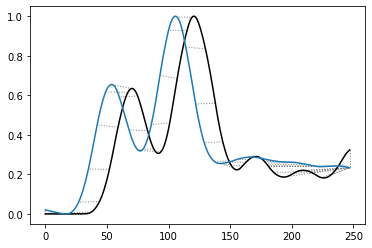

-----------------------------------------------------------------------------
p3_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8221575555824424


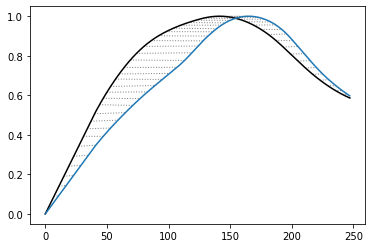

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.8303724753489536


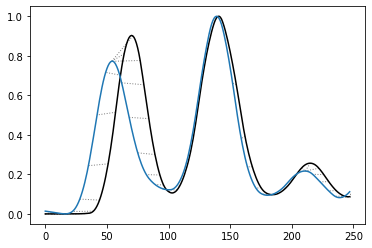

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7765794794112759


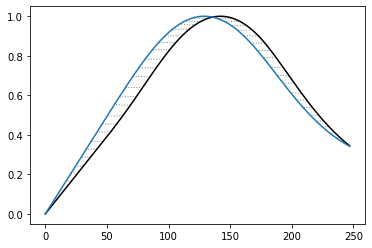

-----------------------------------------------------------------------------
p3_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.2717552541934247


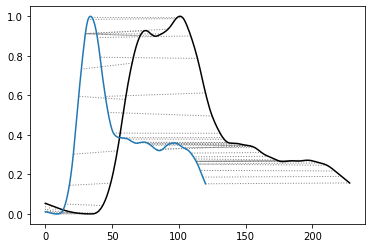

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.5788537892727834


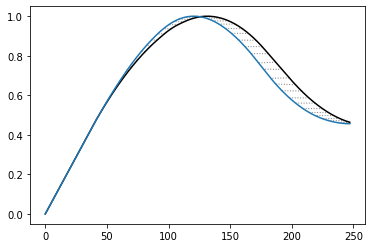

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.7233775071733529


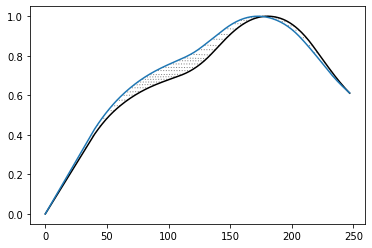

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  6.500649235798898


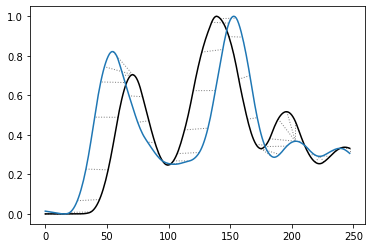

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  5.184245420430469


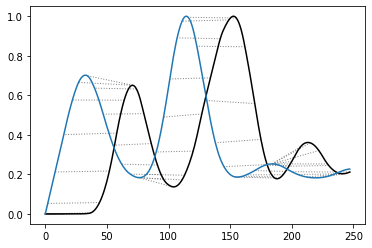

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.000527310605998


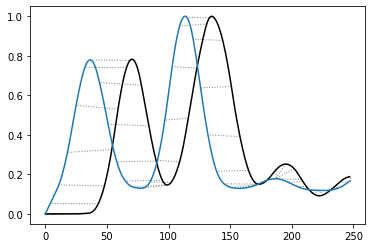

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.8745194385186537


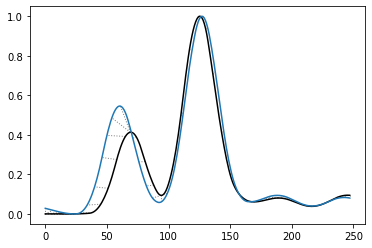

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.5566109669256023


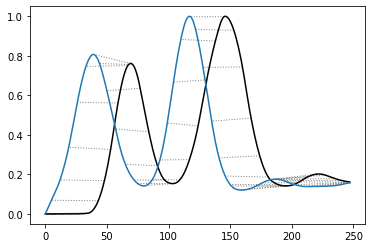

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.0252099462932234


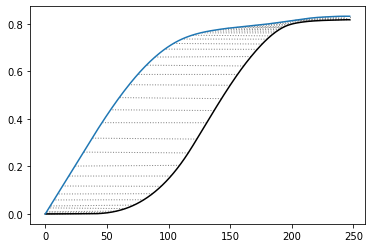

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.0950502521410086


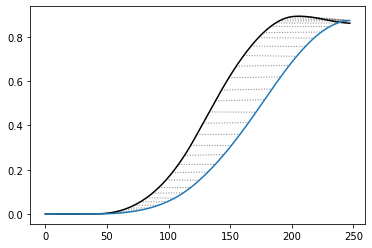

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.7797560592601225


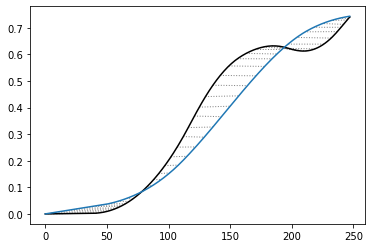

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.45124635706332


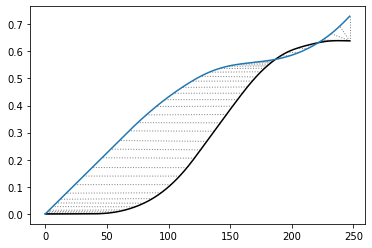

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.5937793161592104


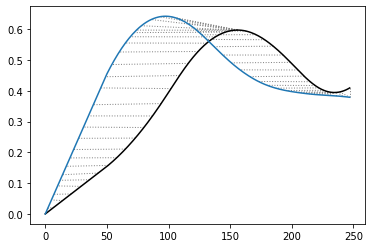

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.302223895867497


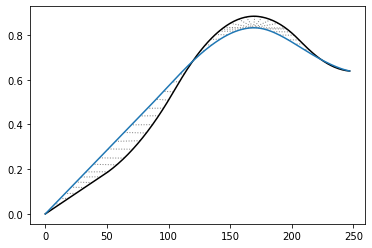

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.9914890030817676


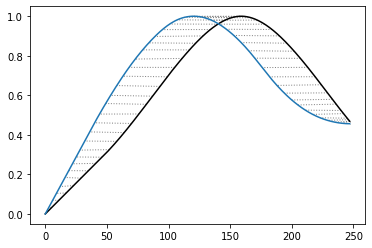

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.6370415809046892


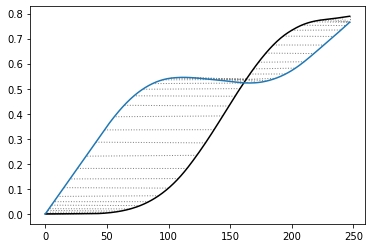

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2043285875081051


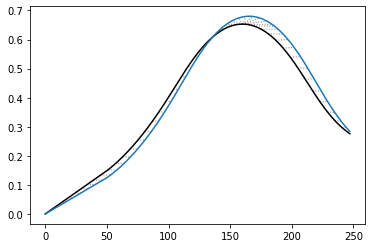

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.4855402742709175


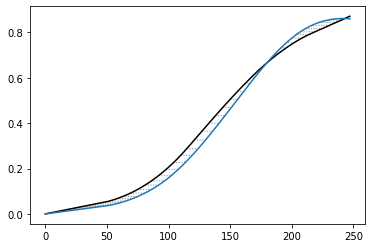

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.5505708926013833


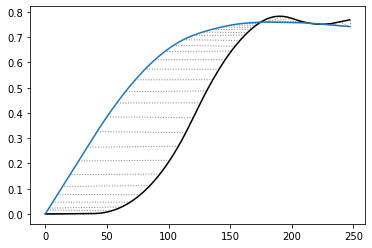

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7429265891047026


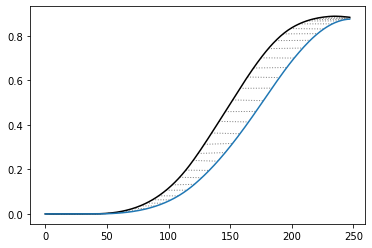

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7258172314353467


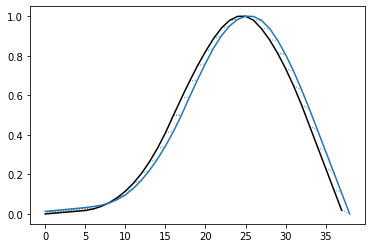

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.2273247838763257


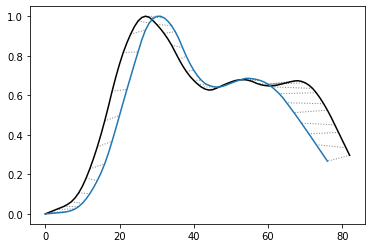

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.8451016682336605


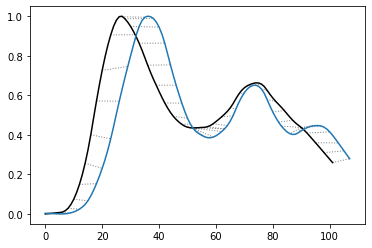

-----------------------------------------------------------------------------
p3_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.1668050566546593


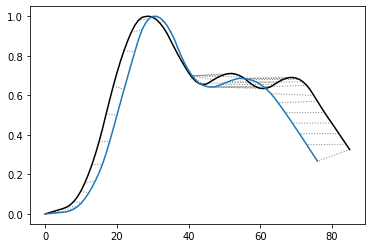

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.7576927664287925


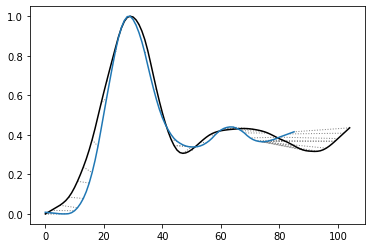

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7456970245151086


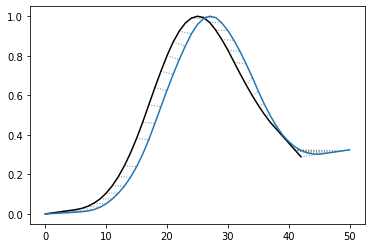

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.97233236375177


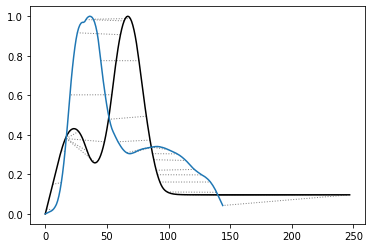

-----------------------------------------------------------------------------
p3_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.2272841122536544


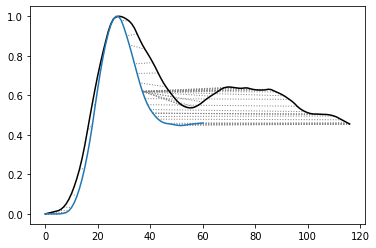

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.308907693188572


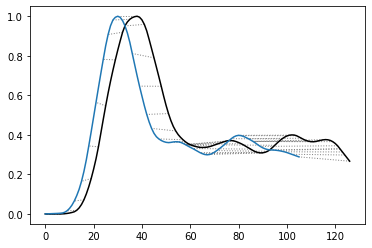

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.880095059330768


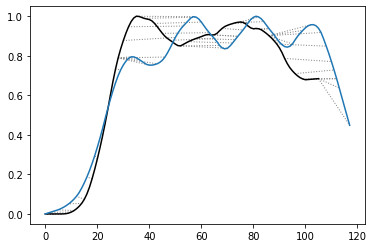

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.339668055484208


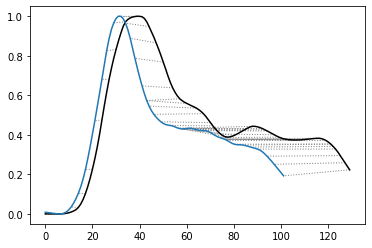

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.596690079595725


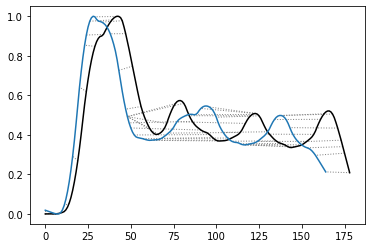

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3933750689728628


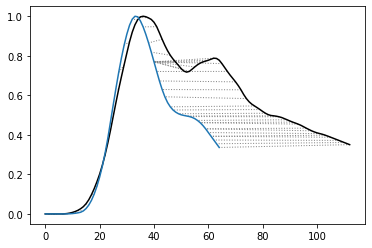

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.737825969123408


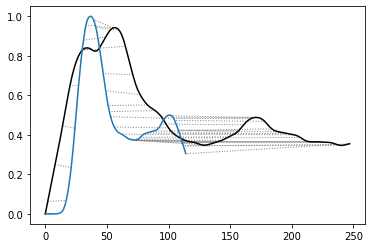

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.1828012746715717


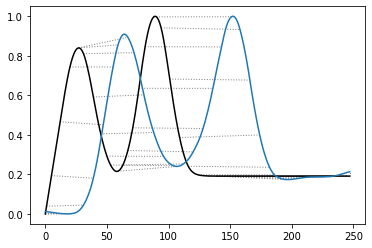

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7107875786629665


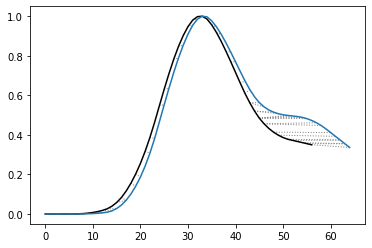

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.7223132049805423


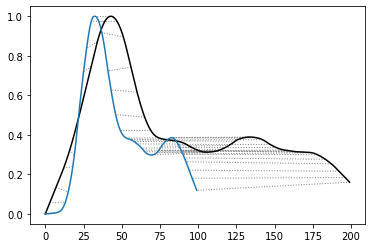

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2255525212155942


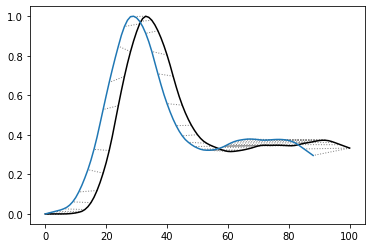

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.6095250857683925


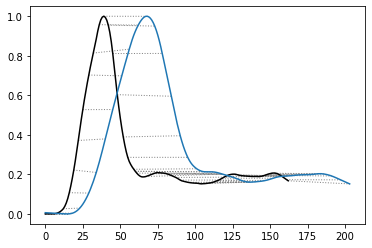

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.256827504414128


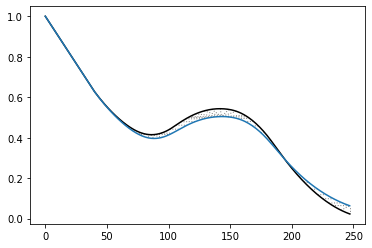

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.6958730164278468


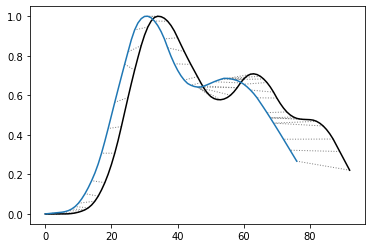

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.7884891090199324


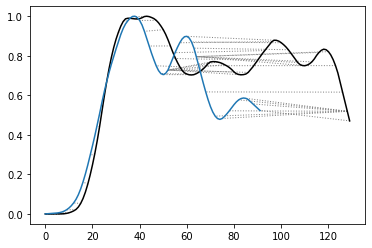

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.9366435361836576


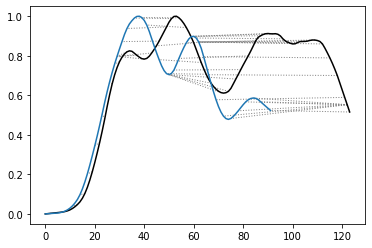

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.6342072943454633


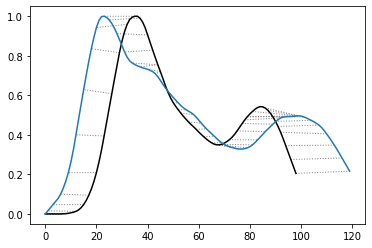

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.600220437875051


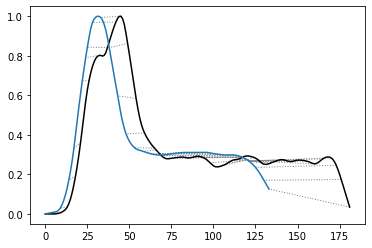

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.658982556429961


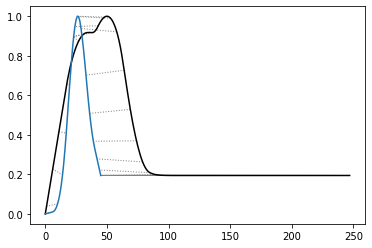

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.5282945451723176


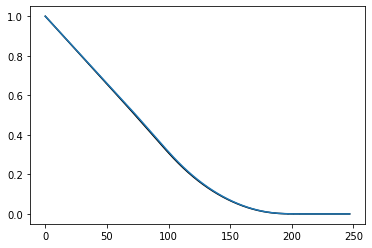

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.4279625029480973


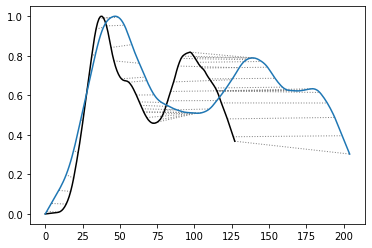

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.7496301026232095


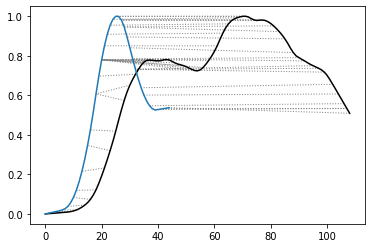

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.8513881914990538


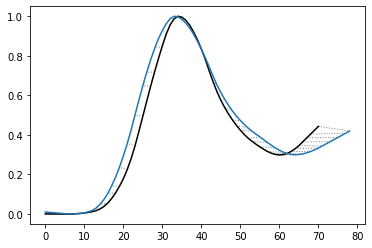

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.912778194402601


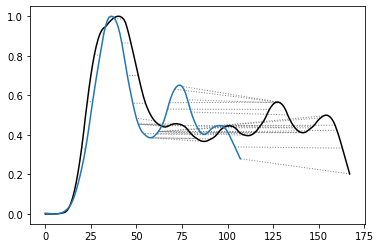

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.788067068013776


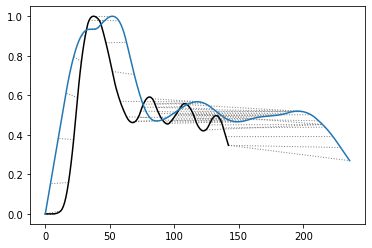

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.983321912185114


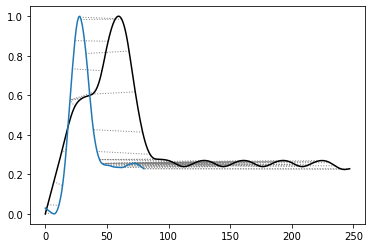

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.0660496575570364


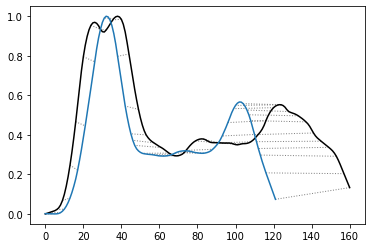

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.462459523083401


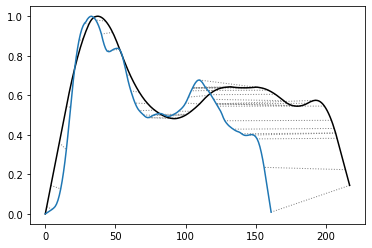

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0720121857975595


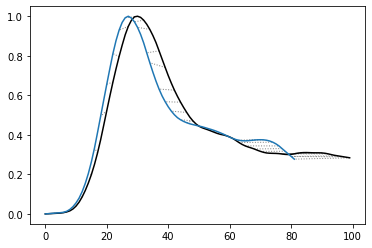

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.7304737154617276


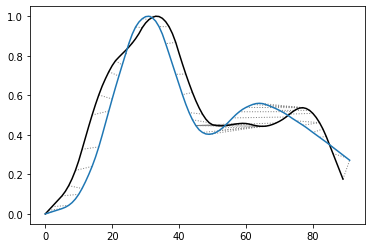

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.5994560981853052


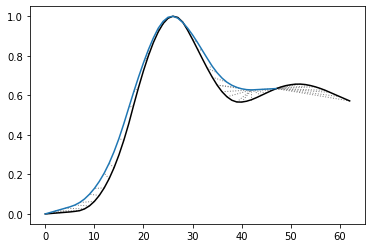

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.717449241713488


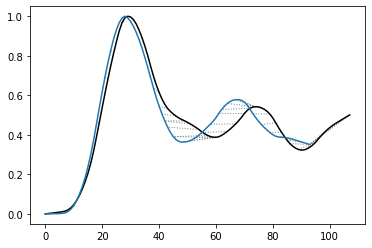

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.6342072943454633


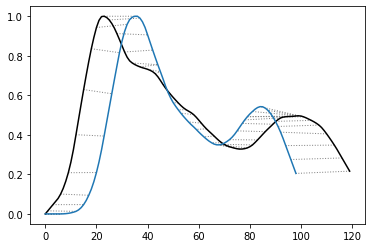

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.5858356165594345


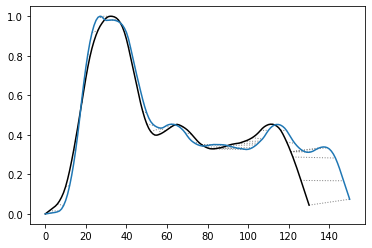

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.7562543777845456


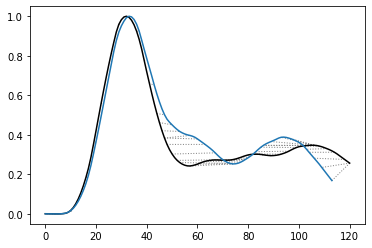

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.8966609970866728


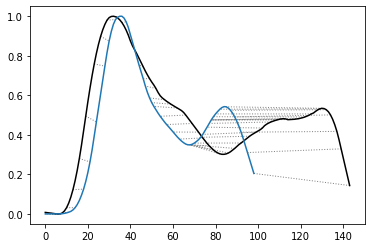

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  5.0071941906523385


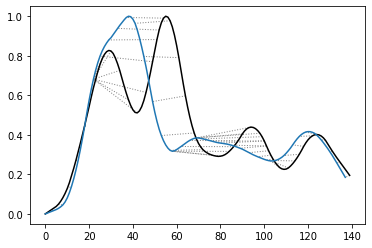

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  10.980837489412977


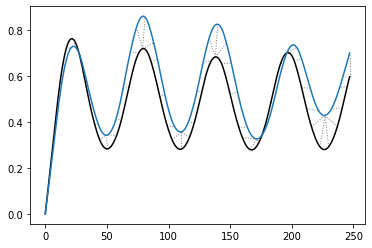

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.379542898236335


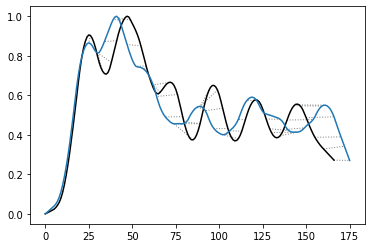

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.441860653865935


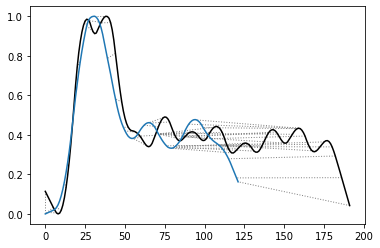

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9475990977747832


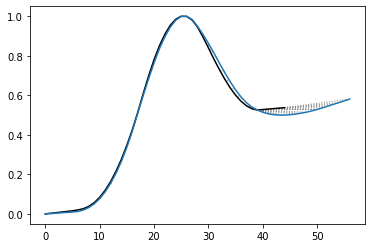

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.007069893049873


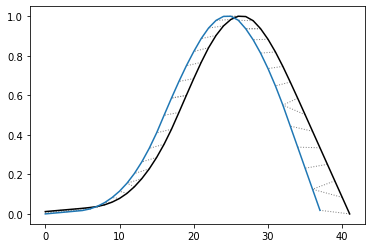

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0637687539302287


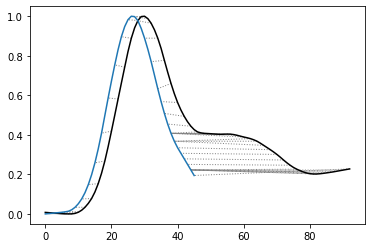

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.224631414473325


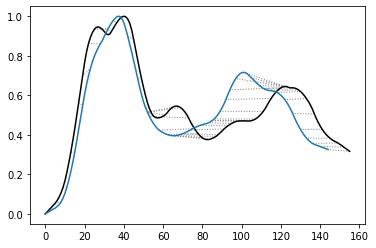

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.2182102069296017


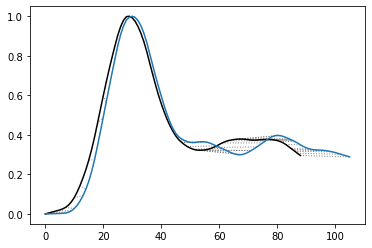

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  5.2770769500989845


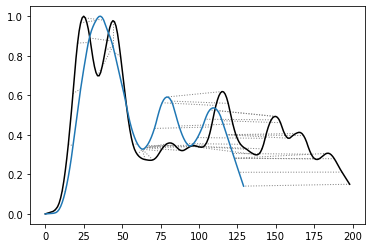

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.9620855734931832


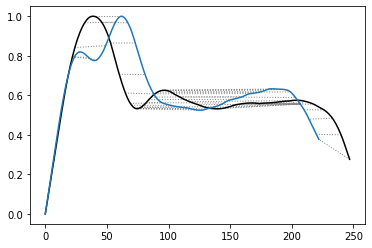

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7893982450057


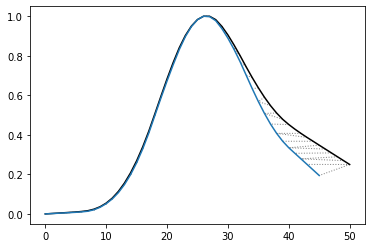

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.2346711710483462


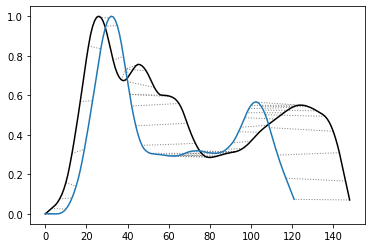

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.2064947003284248


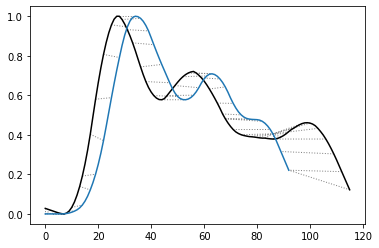

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  15.449721560651277


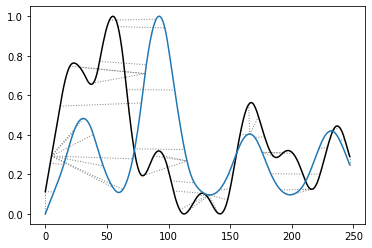

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.3724498667177776


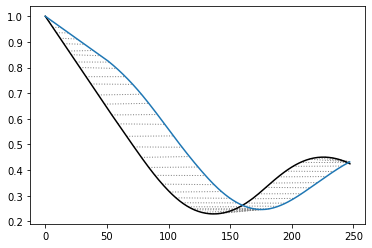

-----------------------------------------------------------------------------
g5_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8753231565956455


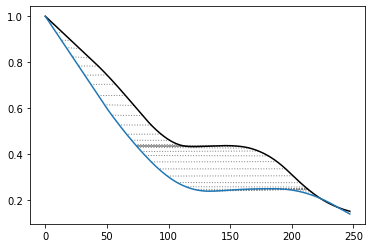

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.9485297249263102


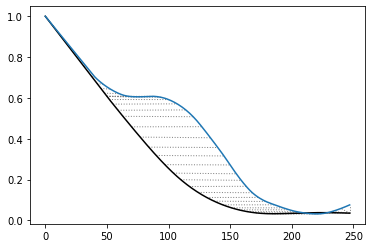

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.8629198832001064


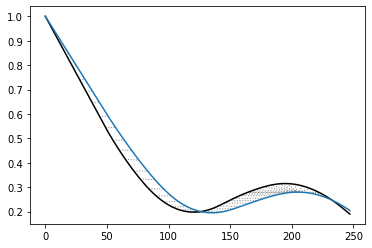

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  6.004997755982287


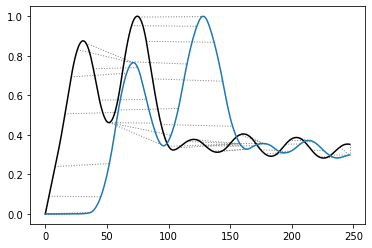

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.4589196073435895


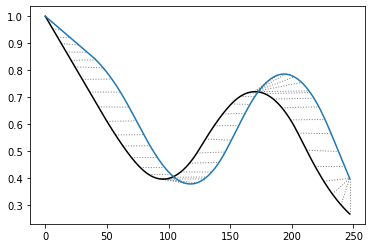

-----------------------------------------------------------------------------
g5_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  6.594030468135822


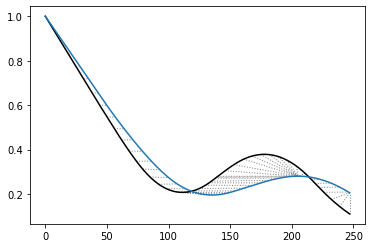

-----------------------------------------------------------------------------
g5_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  5.232683491123323


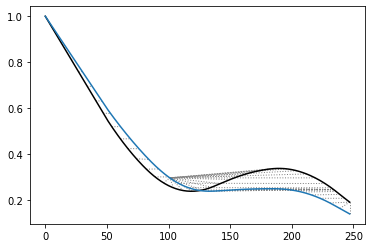

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.9614594795316432


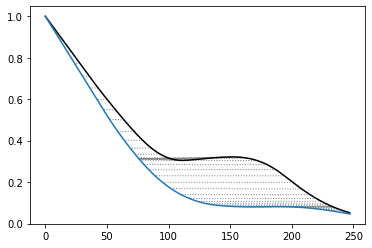

-----------------------------------------------------------------------------
g5_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.3436744908046245


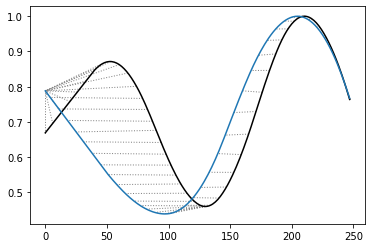

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.1164083480905105


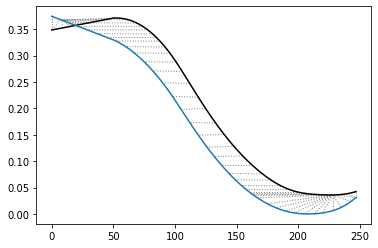

-----------------------------------------------------------------------------
g5_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.549677476399943


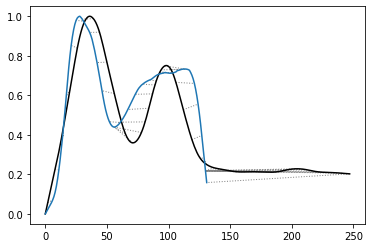

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.3293949684628448


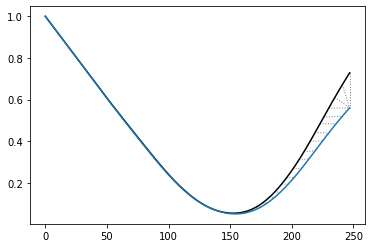

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  5.754640878048488


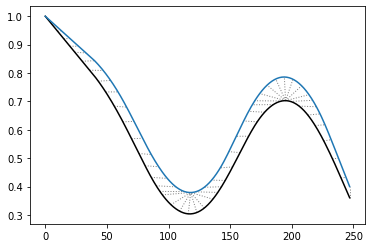

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.5445199813643158


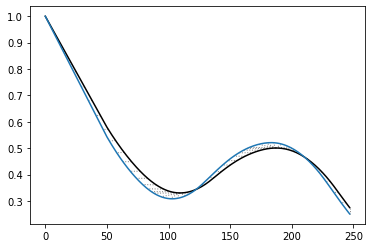

-----------------------------------------------------------------------------
g5_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.709570576120067


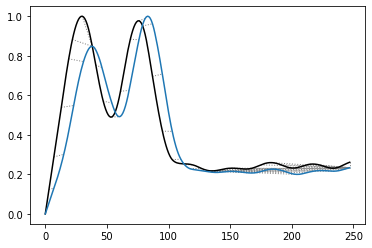

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  6.720221348534316


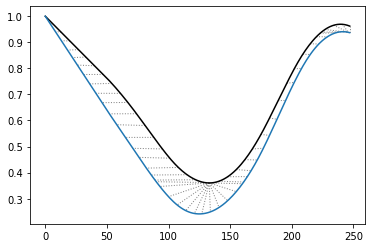

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.690841155088451


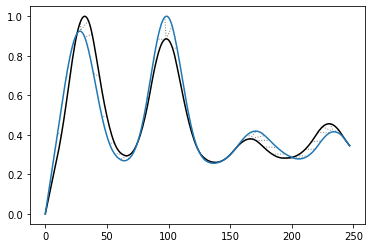

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.904416506793304


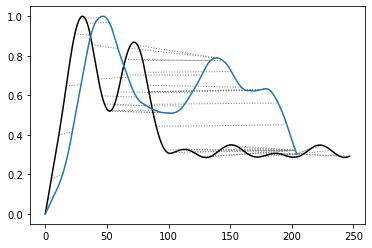

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.6343253665827762


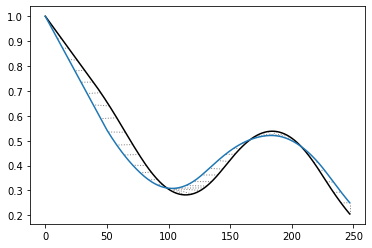

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  5.231431508228483


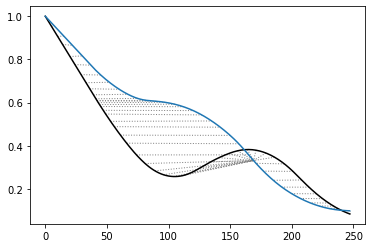

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.3461812701413605


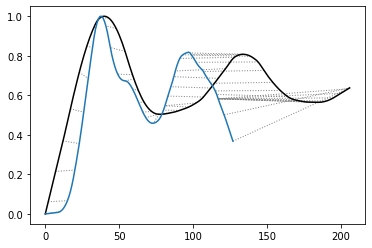

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  13.899974570342481


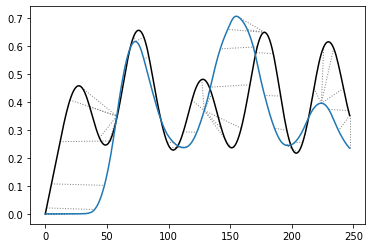

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.6888131659079715


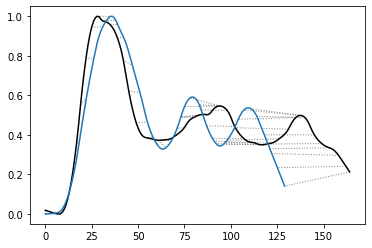

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.8297938727189136


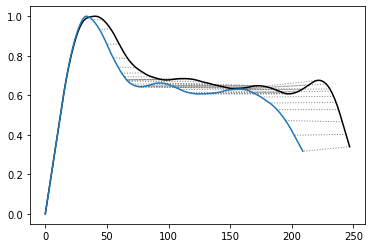

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1621762283434427


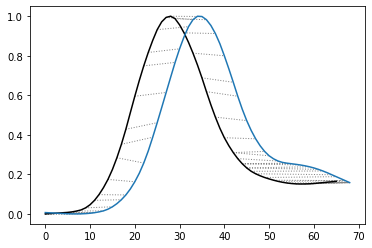

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.971429061192469


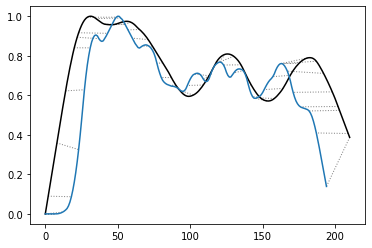

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.0468335294887288


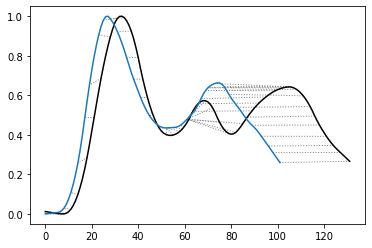

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.8676010636440776


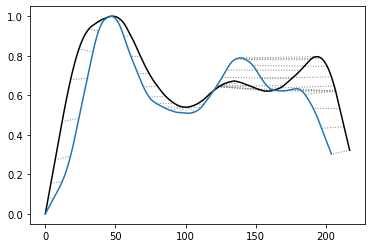

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.852322618826404


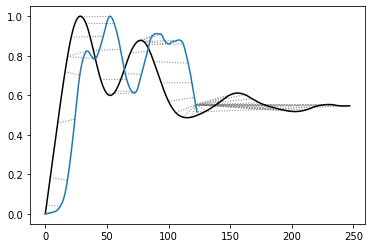

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.2754216617807217


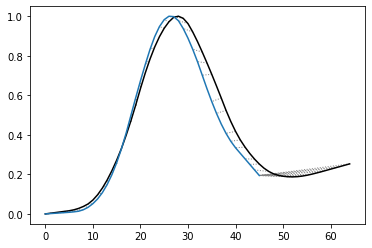

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.854051838874428


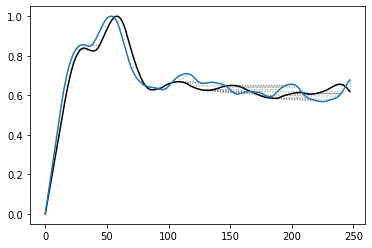

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.4673737869699357


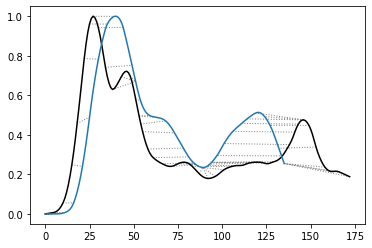

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0328445556675188


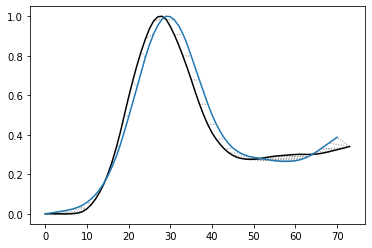

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.811362162015893


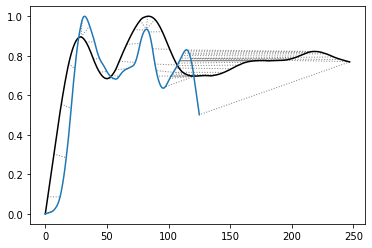

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.544160411926993


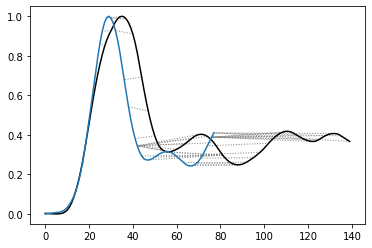

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.5765949575670914


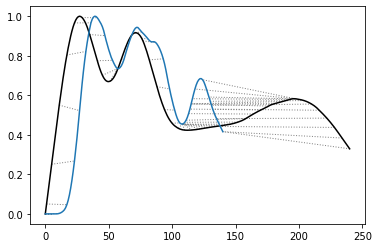

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.9597534573400006


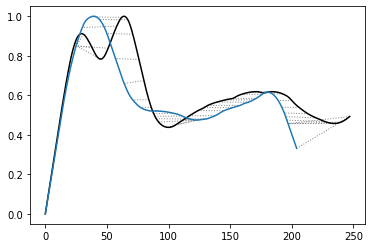

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  7.034546643342477


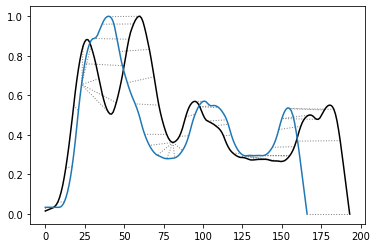

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.4693653470930563


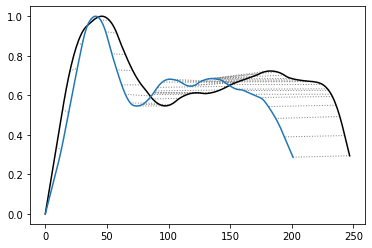

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.1659092369803985


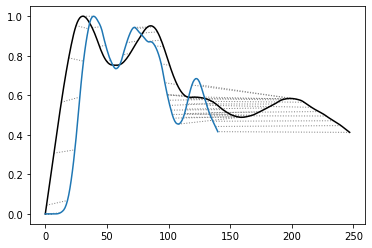

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.1727278410254485


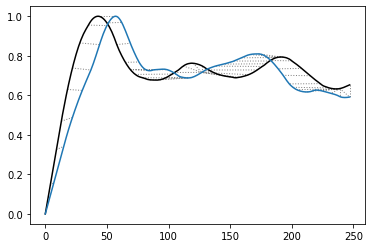

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.1259790985298586


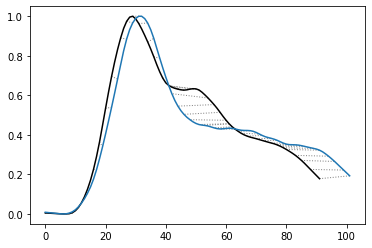

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.282528247190409


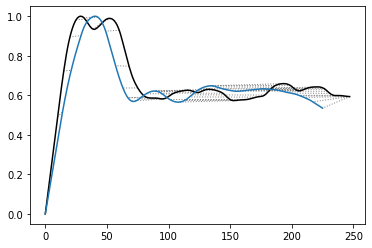

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.9500757932262492


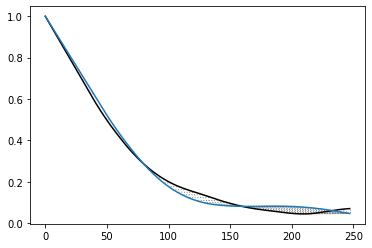

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.9092963402604815


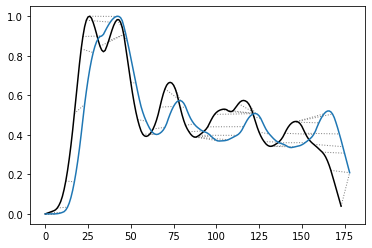

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.380930875152491


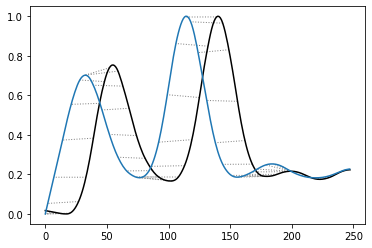

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.006801285562142


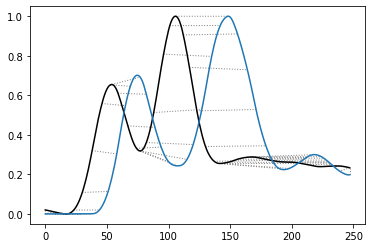

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.291614572391821


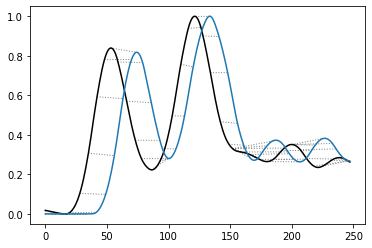

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.065686198490555


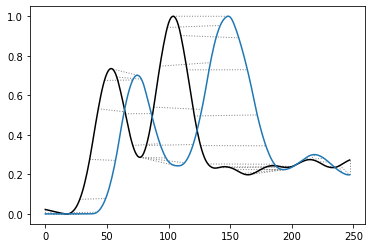

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  6.072188450456194


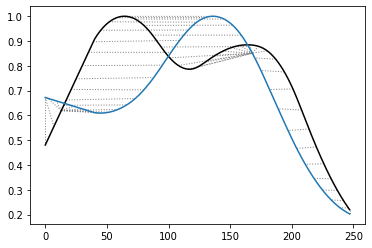

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.5883470637792394


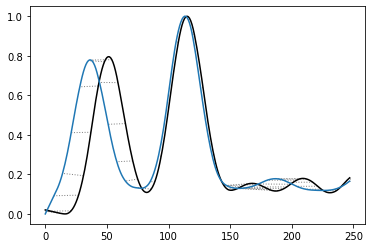

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.691734849772887


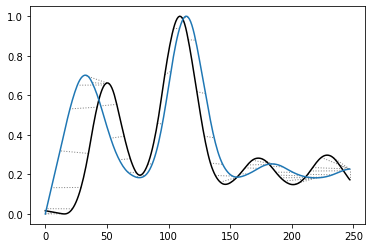

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  6.583295988908006


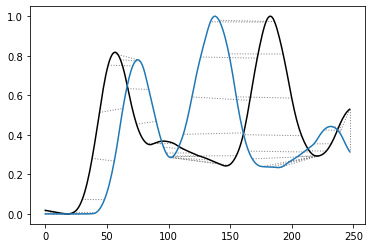

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.138657313718884


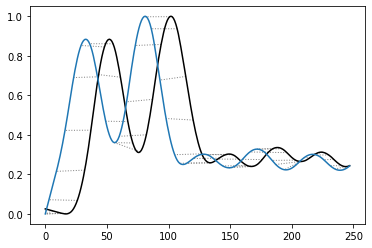

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.9618864538059295


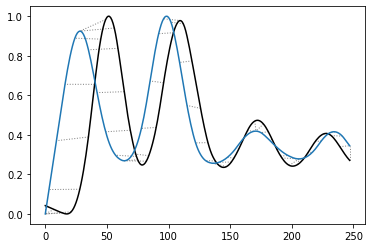

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.689088547293683


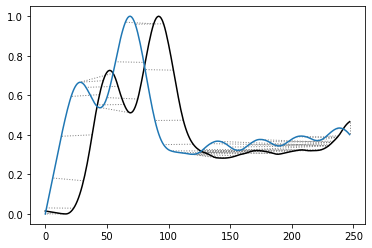

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.3108718726143254


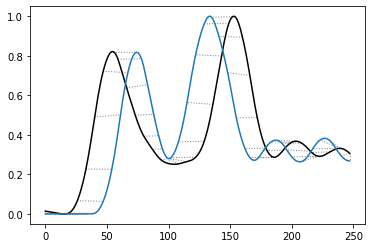

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.171135542380483


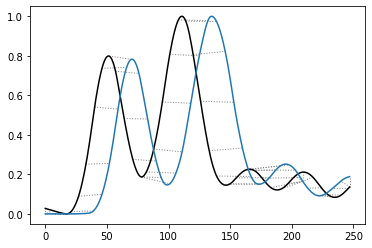

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  9.044694672676377


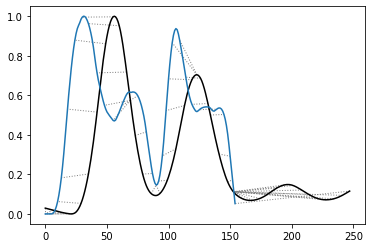

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.169693344105468


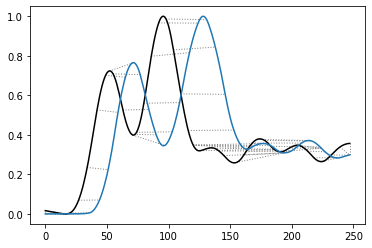

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  9.802523147298498


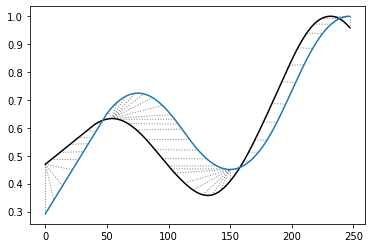

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.485352013510108


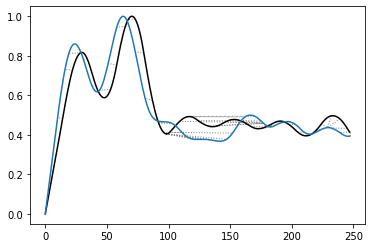

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  5.507232881321269


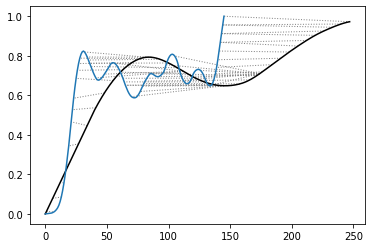

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.274772406681624


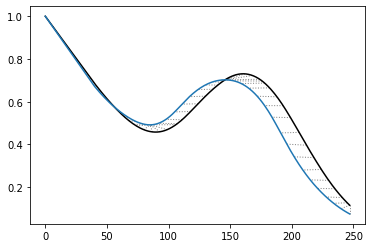

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  4.5692170314113865


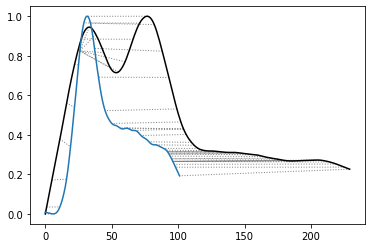

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.0663270328719423


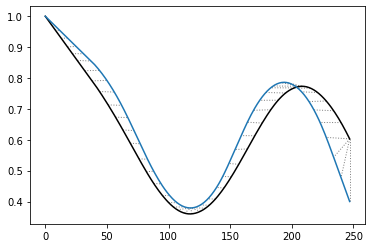

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  5.8831020091952295


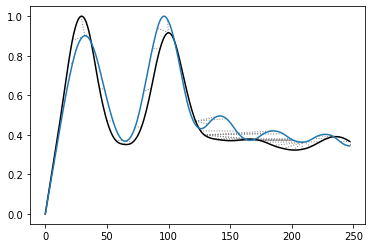

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  6.1962826185768565


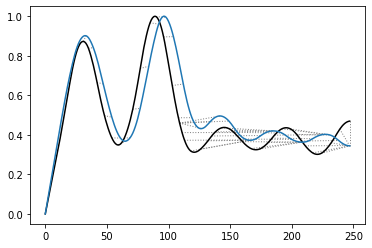

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  7.108750632504747


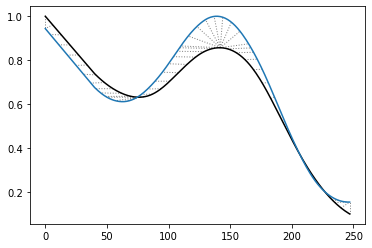

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.4620594201665356


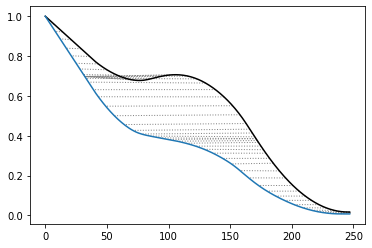

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.727449635285203


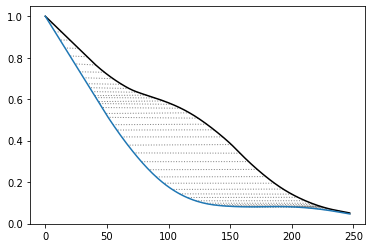

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.389292060872878


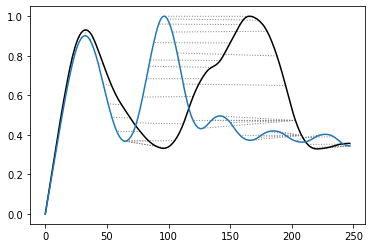

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.5226401187110858


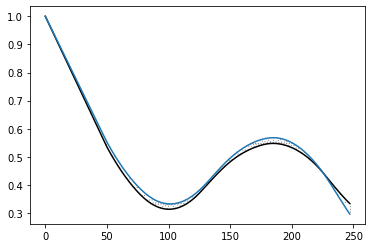

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.996083333816582


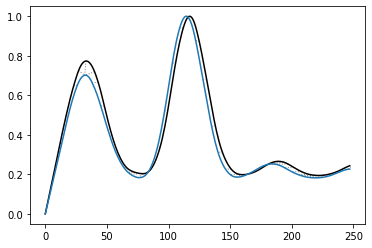

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.8203396947856767


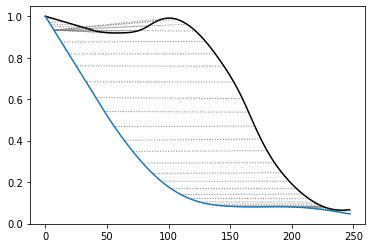

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.200398238963526


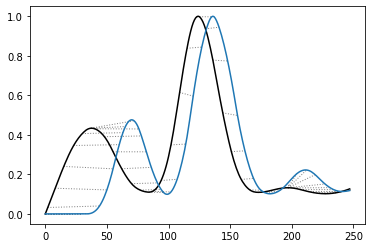

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.4704207727780405


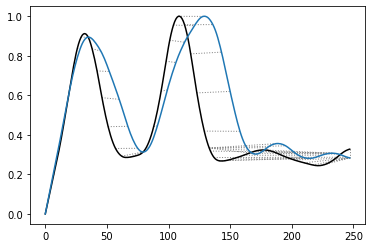

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.8656057092819247


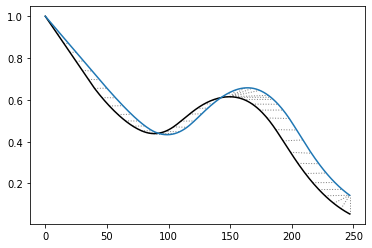

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.9475203898654416


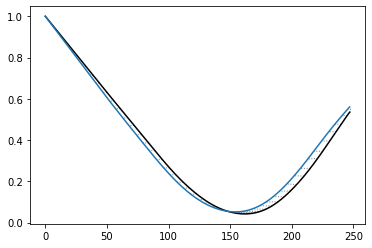

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.6288079441608256


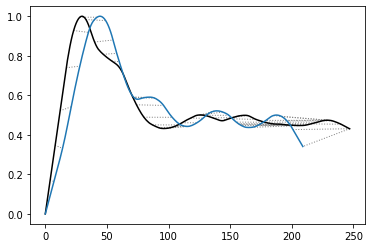

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  6.532993780627832


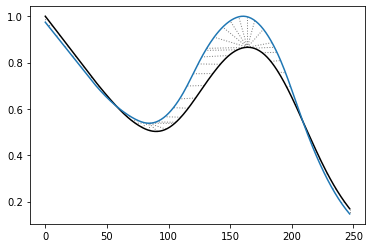

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.788067068013776


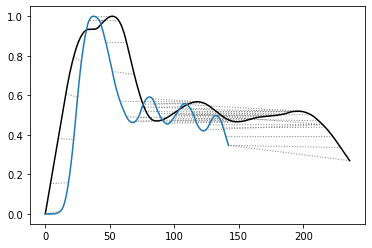

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  5.297937881913948


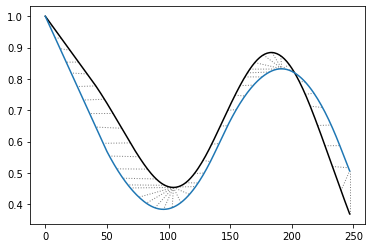

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.8782445249012216


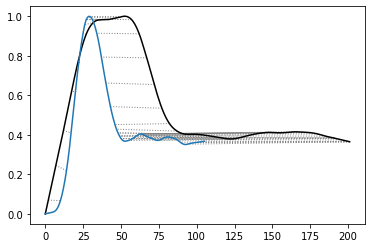

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.477313149418689


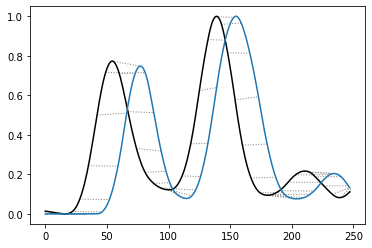

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.768866185050708


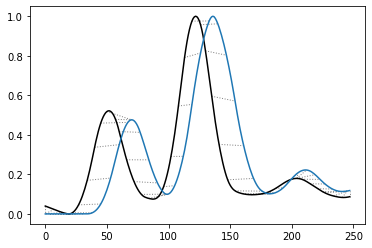

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.47371723888349


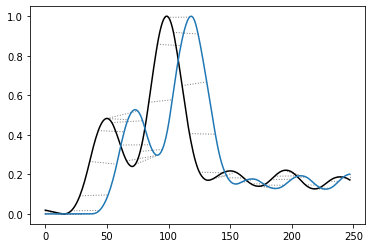

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.6095250857683925


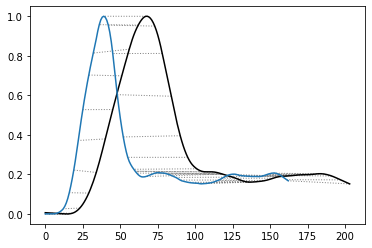

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.514476774852679


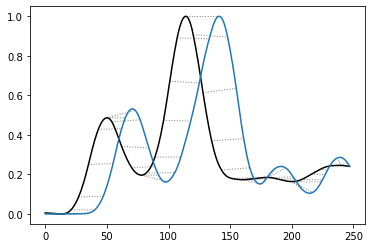

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.4412203880860246


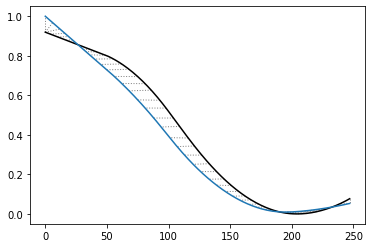

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.959396016695302


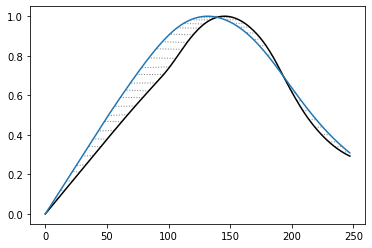

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.6825688887372643


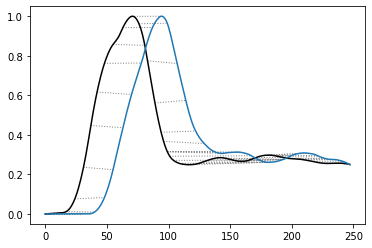

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.141844568267269


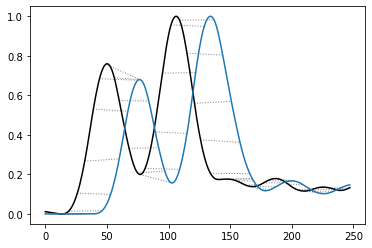

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.266425539061369


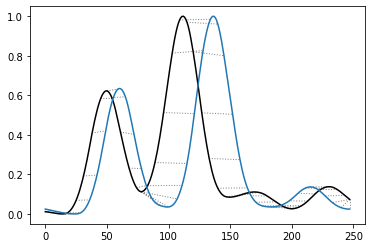

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  11.220045771131186


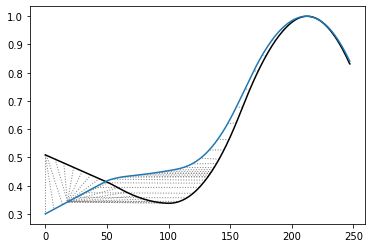

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.0820664656043983


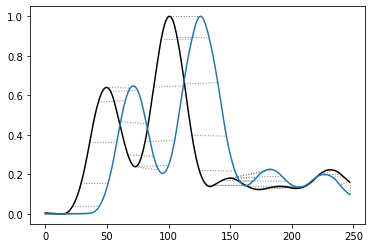

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.4794783855689984


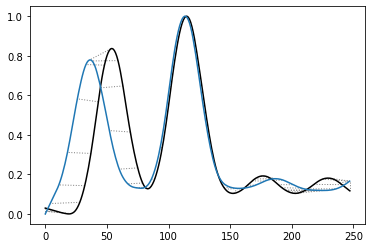

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.4546256186546533


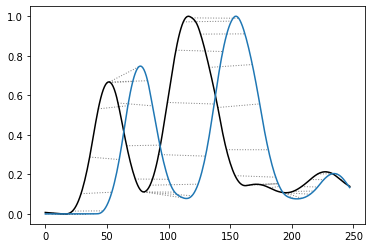

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.973333805672562


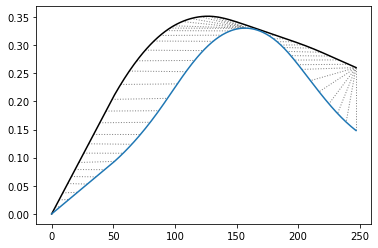

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  5.508544726969213


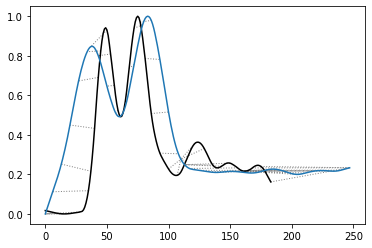

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.25772912252536


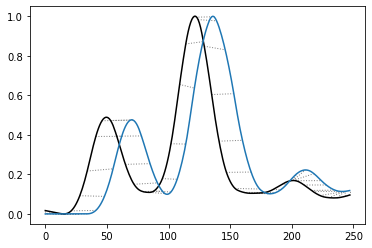

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.5788537892727834


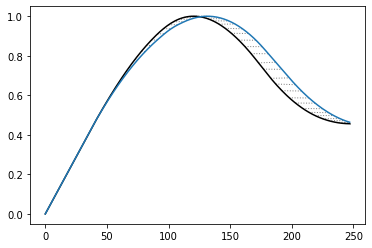

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.162922643500236


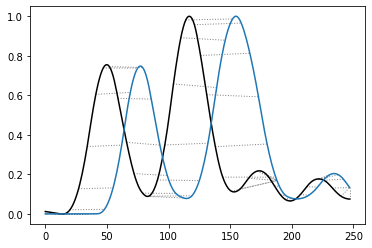

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.627502620044372


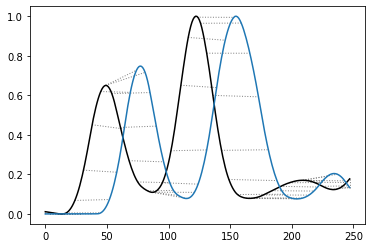

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.1390384450021216


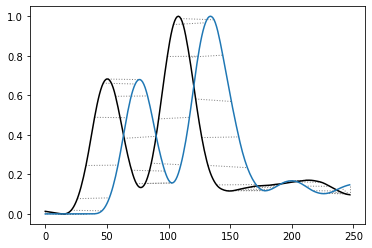

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.716226732533147


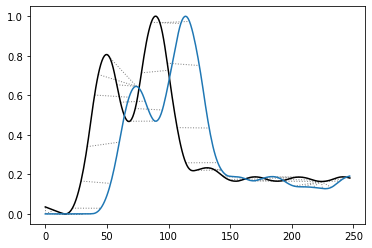

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.9011251529726705


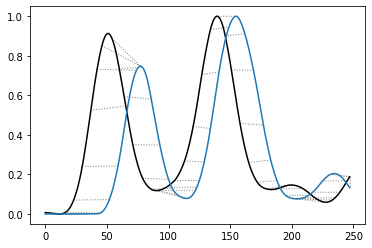

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.781202445654236


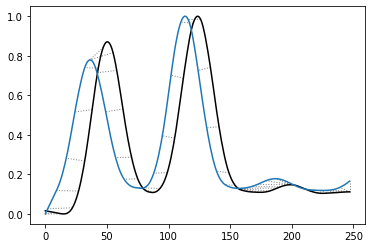

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6719119222600529


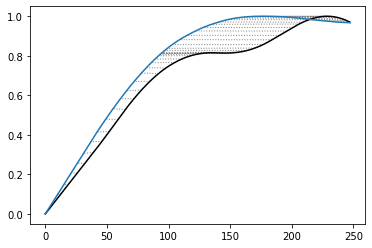

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  9.030443552972892


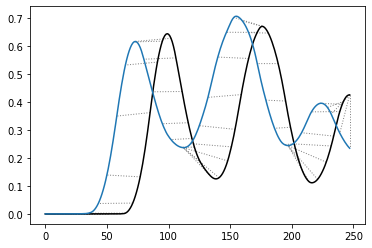

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.6944077092371046


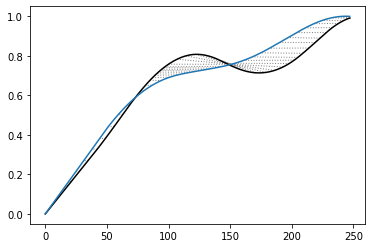

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.8910745453017064


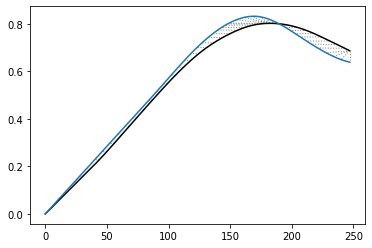

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6268625367690881


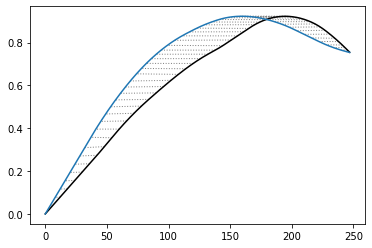

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6656014093459168


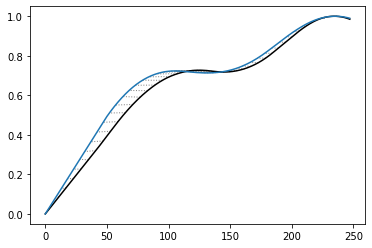

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6496661771922525


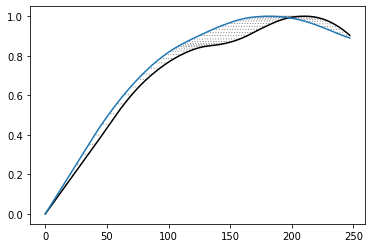

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.1368309299841686


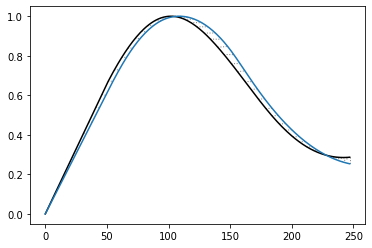

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  12.139046173809936


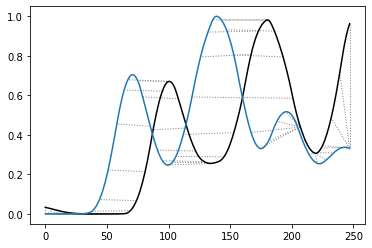

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.5276082310258118


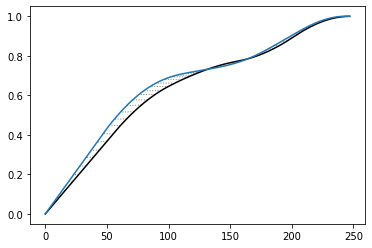

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.6840036950545829


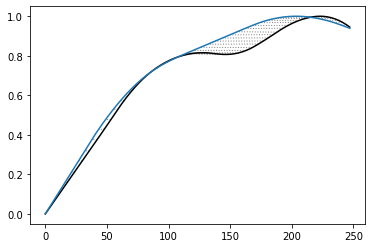

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.8928508330782511


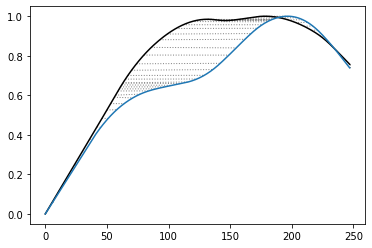

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.5506804068083028


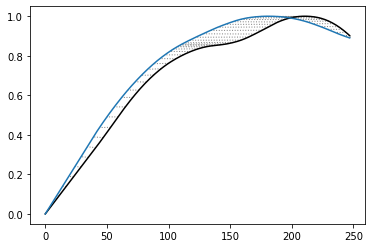

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.2317569277727105


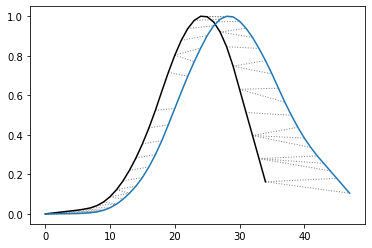

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7755024728406756


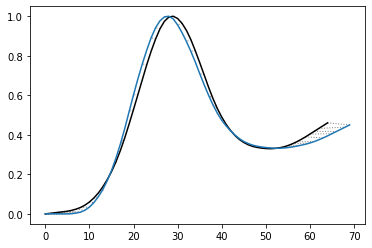

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.590638605109857


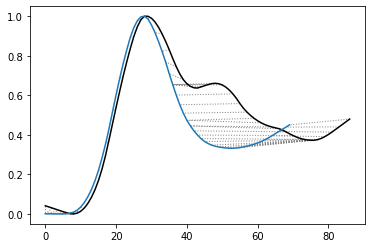

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.2117286606642763


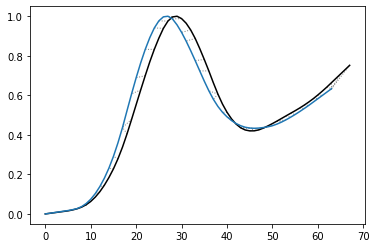

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.559437917994148


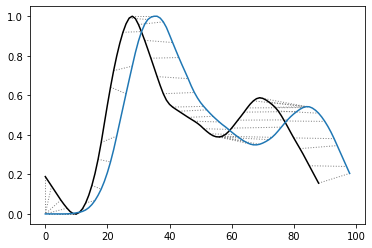

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7258172314353467


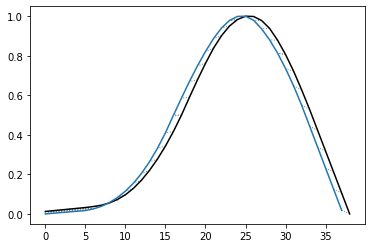

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  18.71777077624493


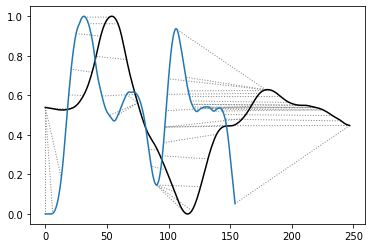

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.1313506526114767


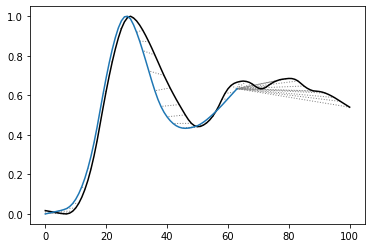

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.5075849056650092


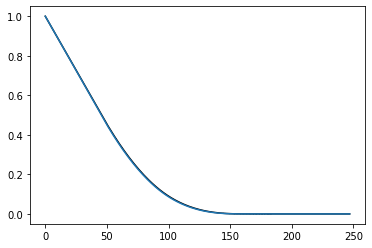

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.8718250165720096


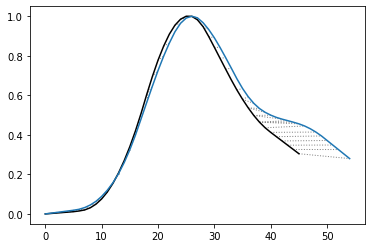

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.6660336304100114


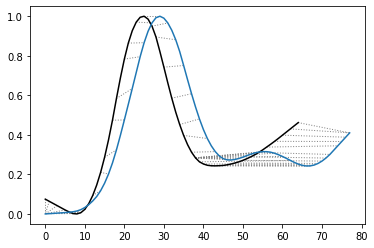

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  6.322770014157149


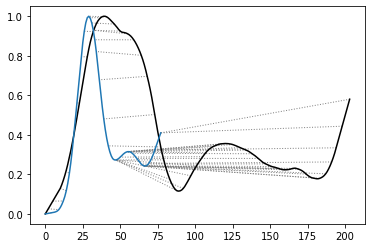

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.1668050566546593


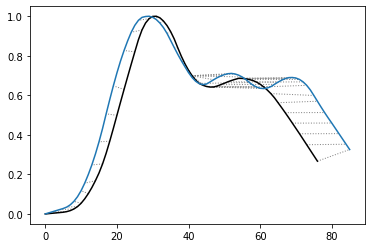

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.080423356174801


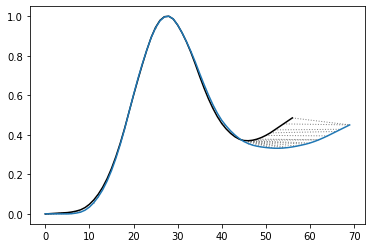

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3229190665819364


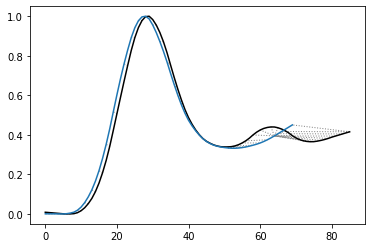

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.7275377150368803


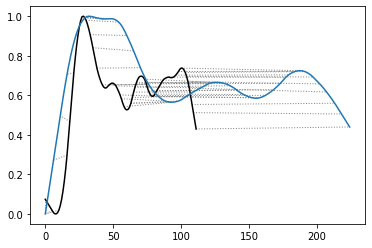

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9849157656591618


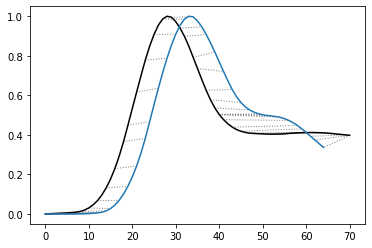

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1662936259748466


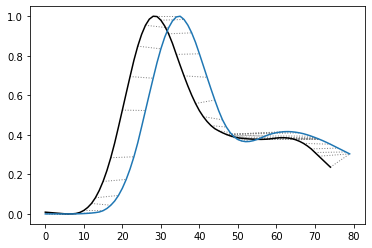

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.8721583380414732


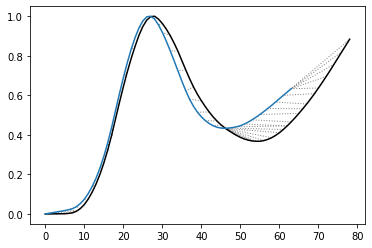

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.6626995638740898


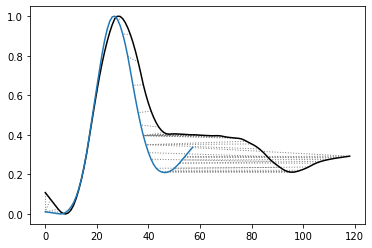

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3381652722485455


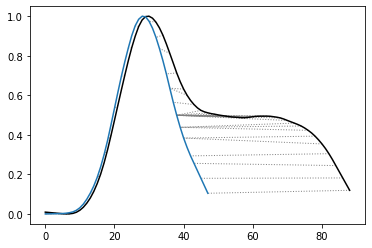

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.2039603024054015


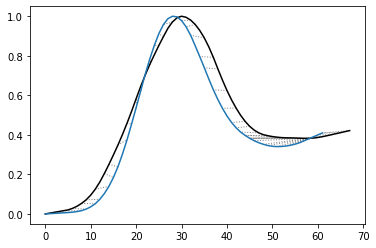

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9824791945438079


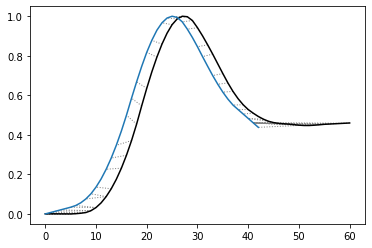

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  11.243878162896538


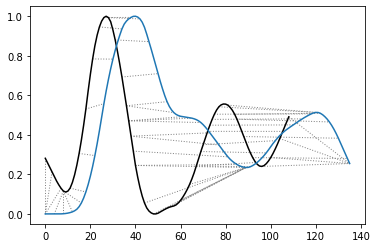

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3237284527257165


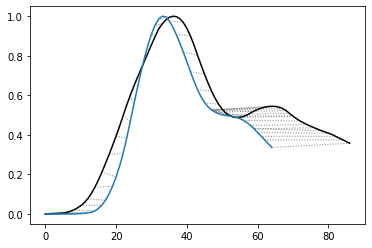

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.5270352707763706


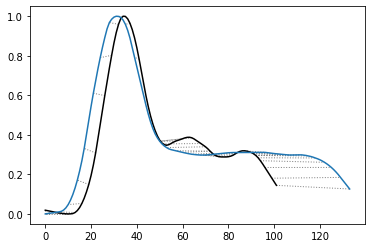

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.293419023174821


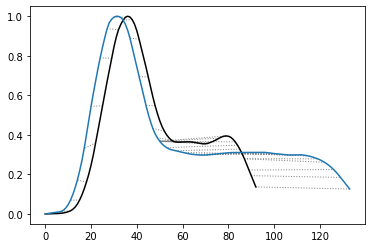

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.147950865792053


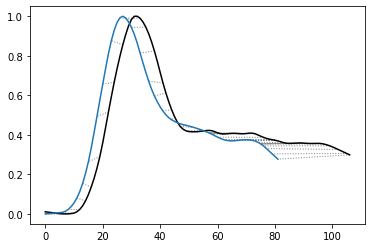

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.596557718480541


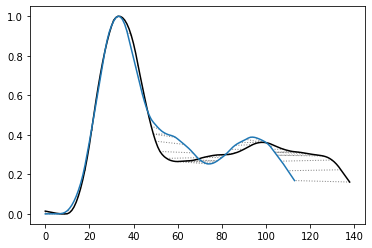

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1566731748065977


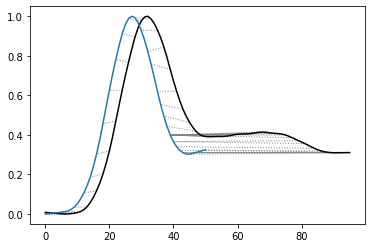

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.6245297351573362


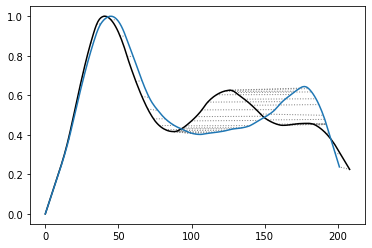

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  12.370452854011528


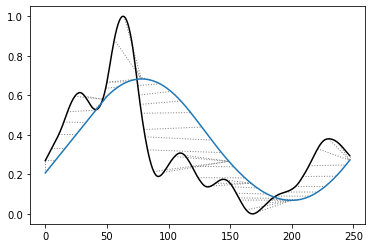

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7996826390974661


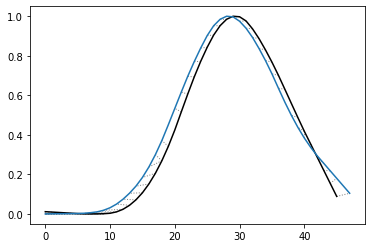

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.2298076804606017


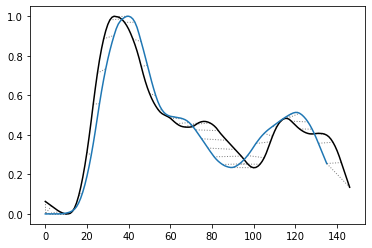

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9993080355178856


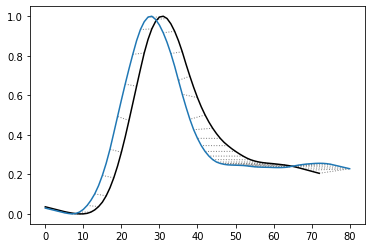

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.4315591027866017


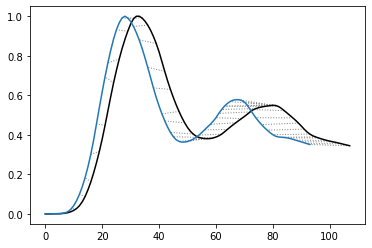

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8296605059765773


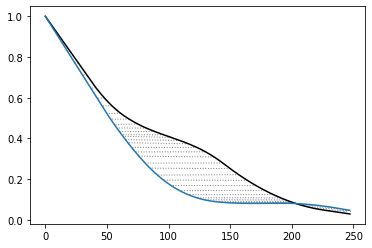

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.8513881914990538


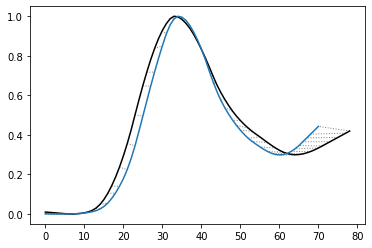

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.4762277419914465


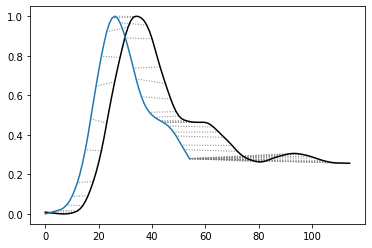

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.8451016682336605


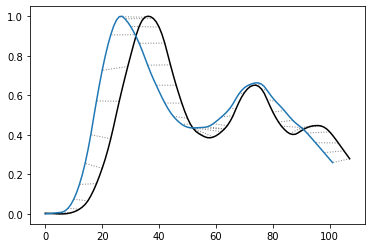

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1632540401667184


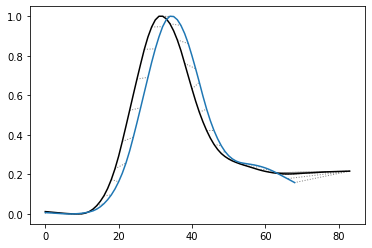

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.257495276305752


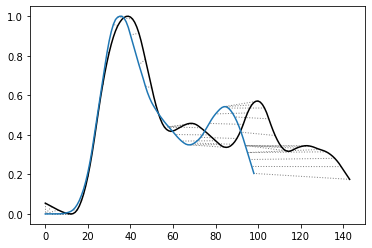

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  5.574290532169937


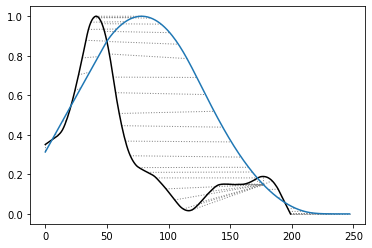

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.4984996843403006


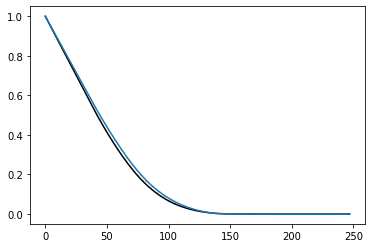

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.338271215425394


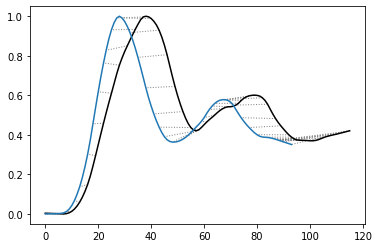

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.3685704835544388


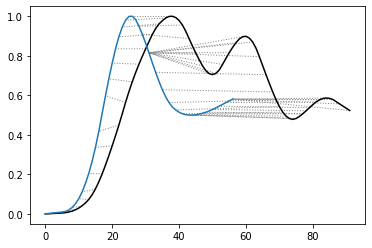

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.964131768799286


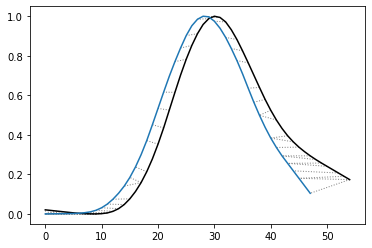

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.2454038699084875


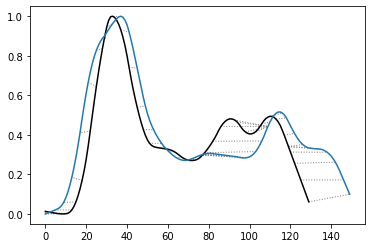

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.4298422217922908


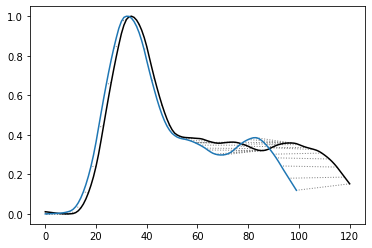

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.7889223389647684


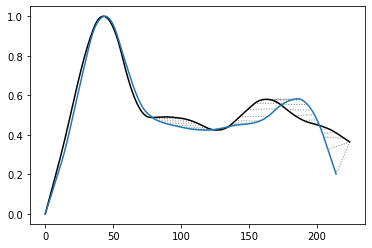

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.485352013510108


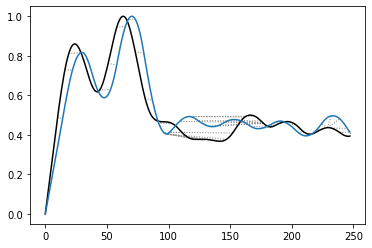

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.514328954623153


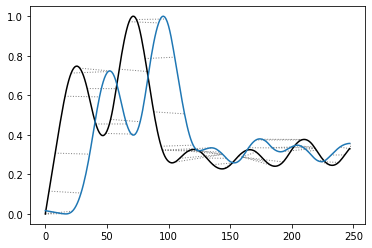

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.9906990018061717


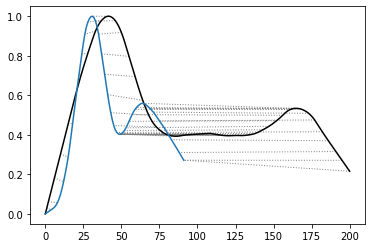

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.639456227732558


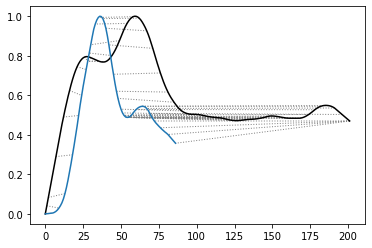

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.4315591027866017


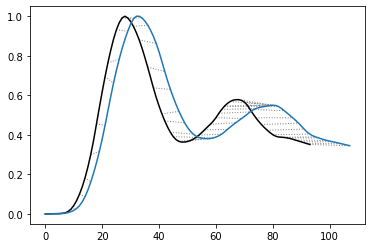

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.0660496575570364


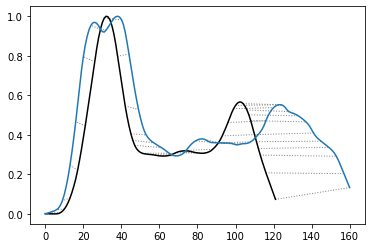

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3517254599056858


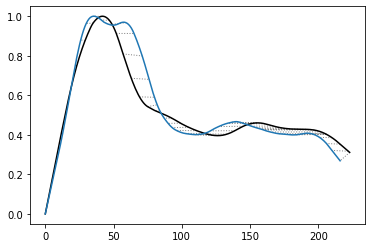

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.1898519584924987


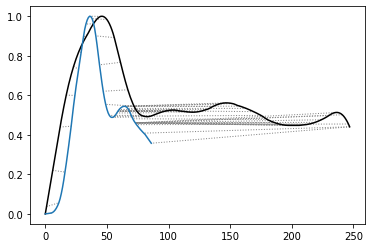

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  13.776991837479475


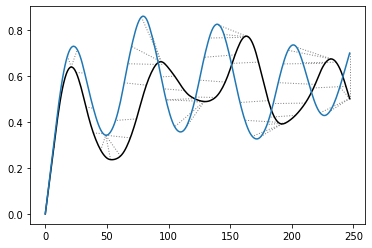

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.996387956053975


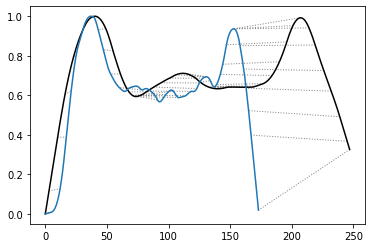

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.0328445556675188


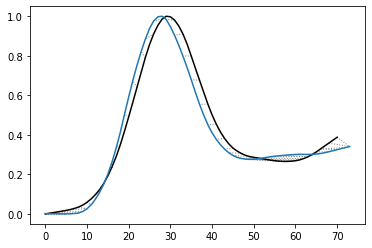

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9969596323041576


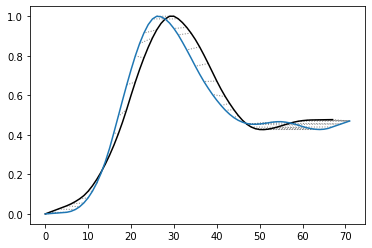

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.4344838313372494


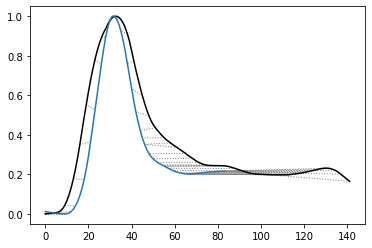

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.8418529362918568


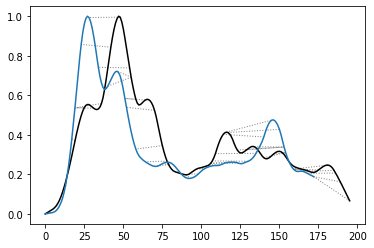

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3857383991830048


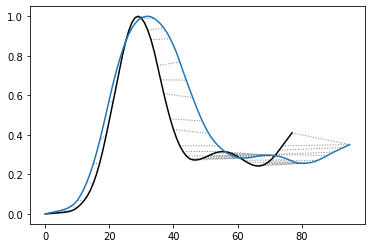

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.3730529335721187


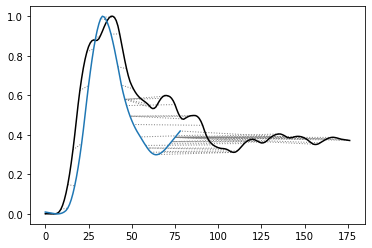

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  6.907549326929092


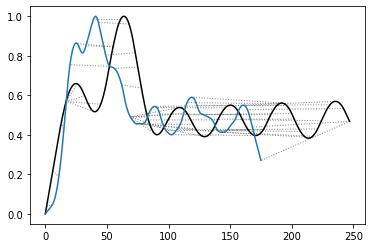

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.095967610901466


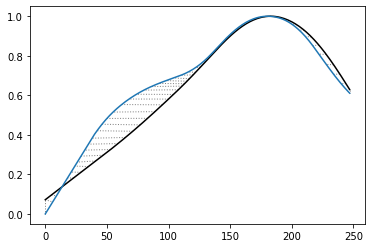

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.1030551326834246


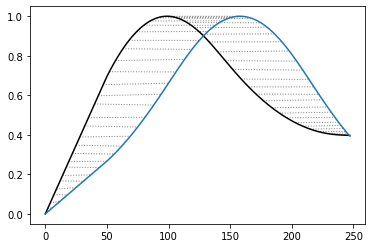

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.539820543459354


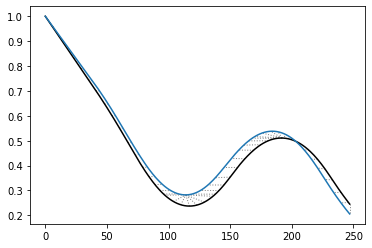

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  11.217605523368471


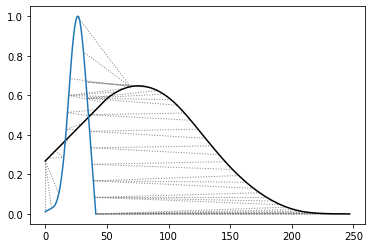

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.0701300448086826


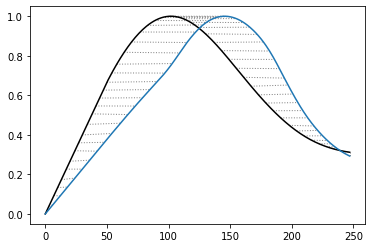

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.229528450333808


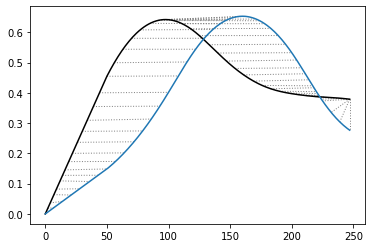

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.855958268797452


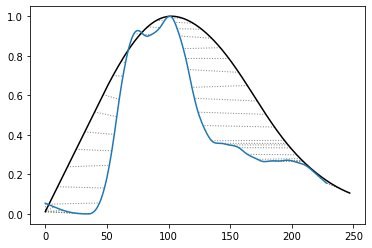

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6603366812717959


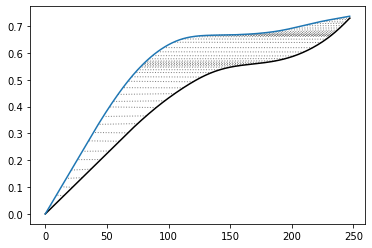

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8929730699965049


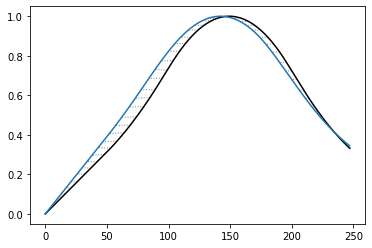

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  10.564845939207586


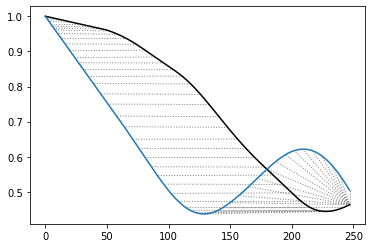

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.1368309299841686


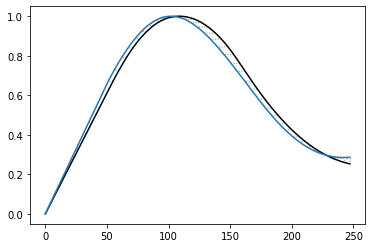

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.92881940636405


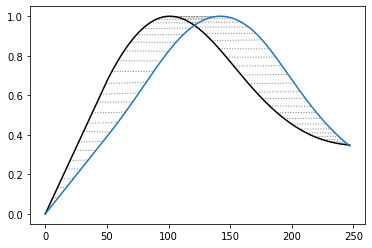

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  9.50859879517448


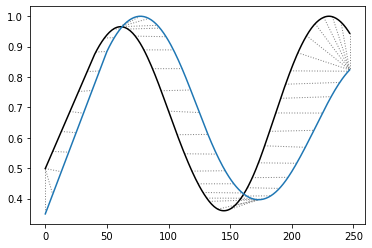

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.3416225868466536


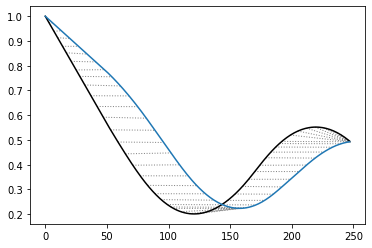

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.5438909785906447


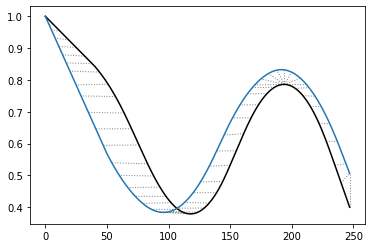

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.959396016695302


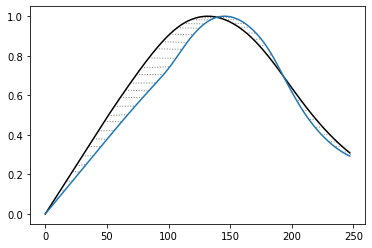

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.8274969217516452


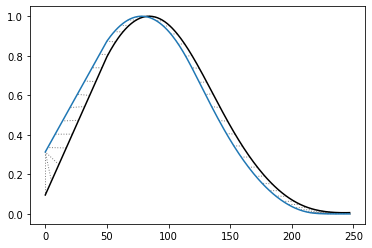

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.994190628225636


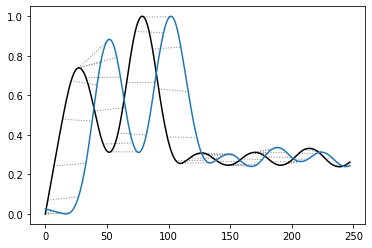

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  6.293584470698078


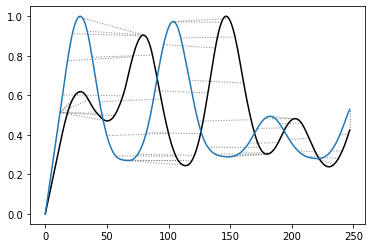

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.589482059823076


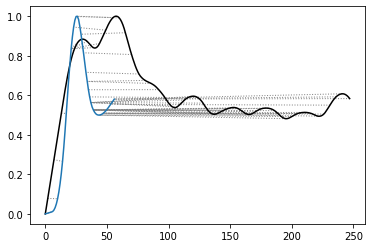

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.801494349914511


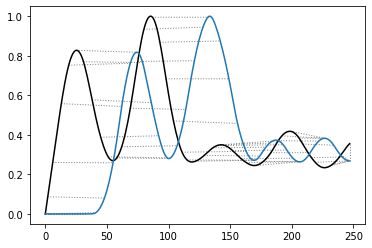

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.381282780051256


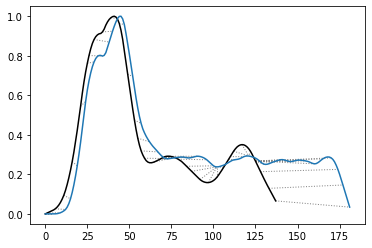

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.9648734252278017


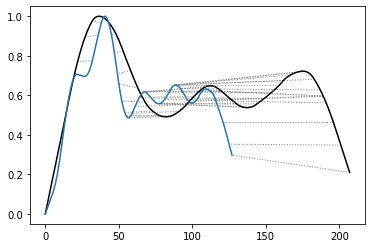

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.720462658623013


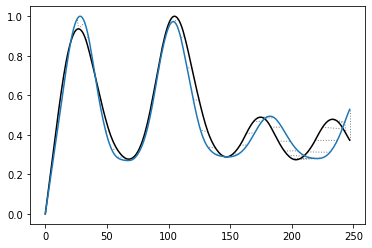

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.3886523680037843


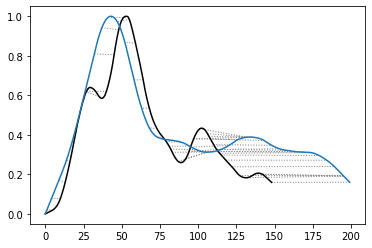

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.389292060872878


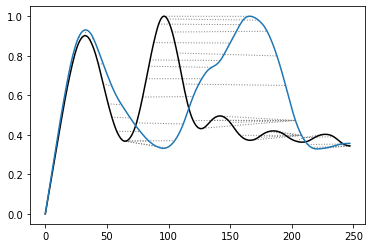

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.736693907178117


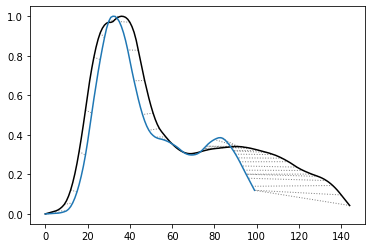

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.4845328577326384


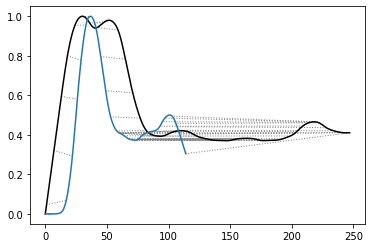

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.8021482057791256


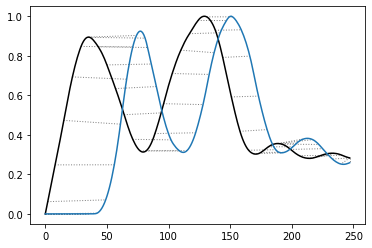

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.535464409110869


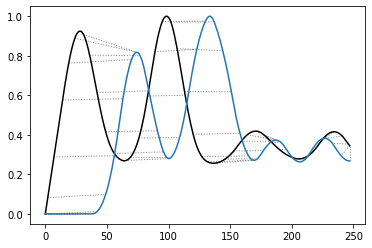

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  8.192415135778301


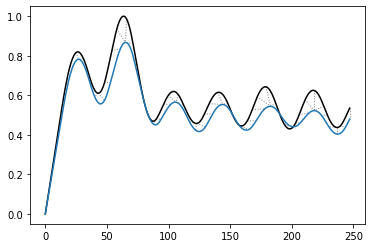

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.7489859002546315


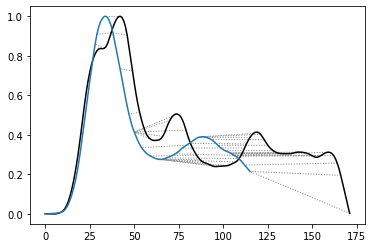

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.7080946427937145


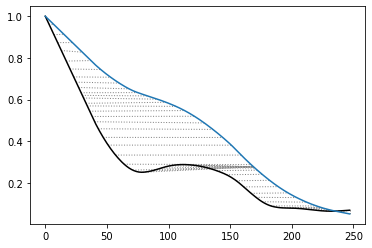

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.738432550525176


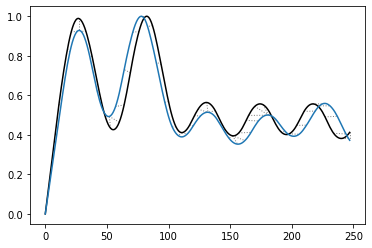

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.8910745453017064


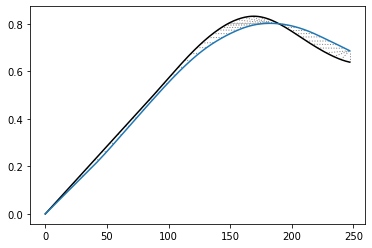

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값 :  9.802523147298498


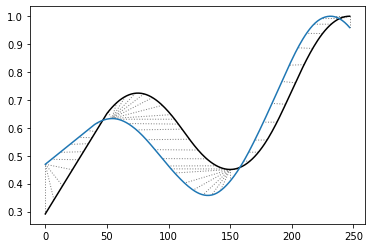

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.6656014093459168


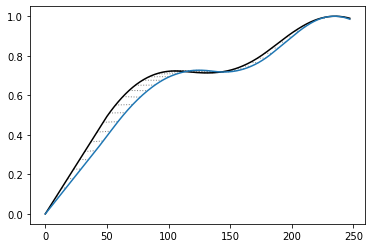

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  4.585653180616764


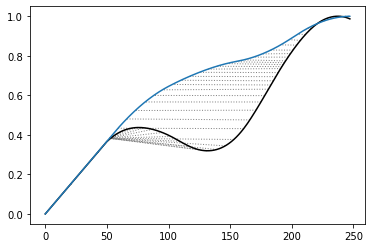

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  0.6336464621101533


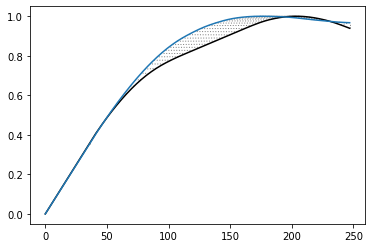

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.2122841112761713


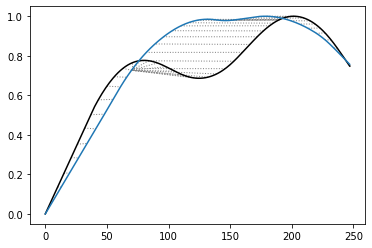

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.6210717019547258


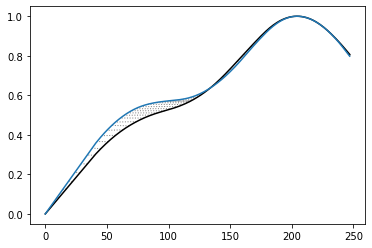

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.256827504414128


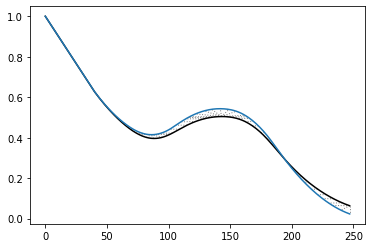

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  6.215211735283433


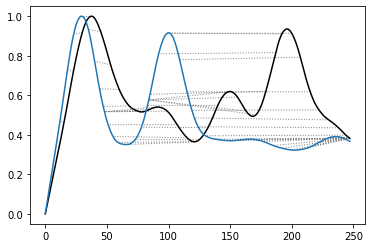

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.1731061475858249


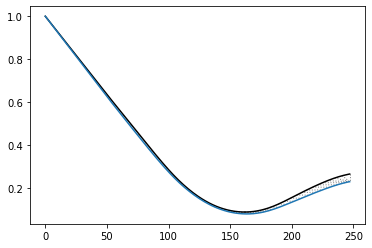

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.5927583069623457


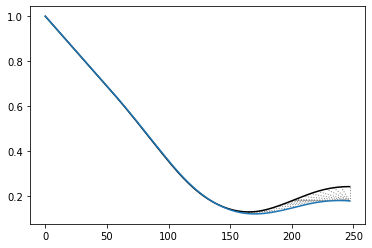

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.151160970556629


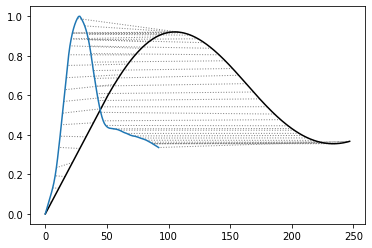

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  7.433132879082987


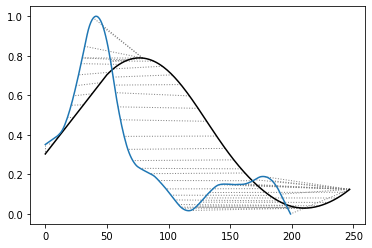

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.7320225650415393


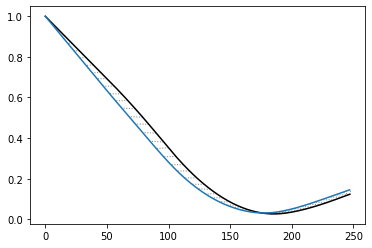

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.5067322027724837


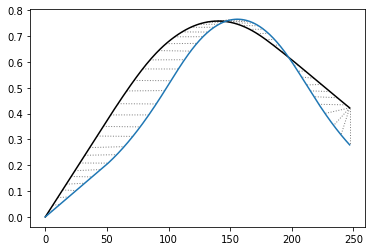

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.739842618808596


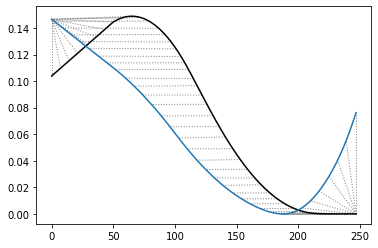

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.7383108968136414


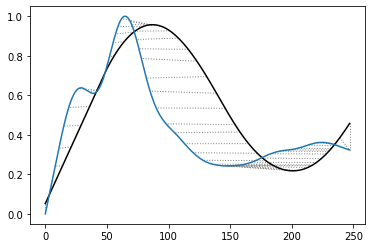

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8701845257500449


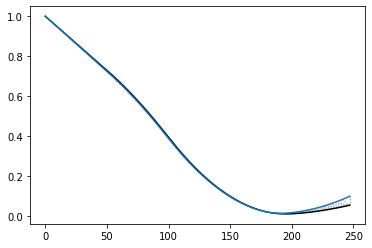

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.884164820034837


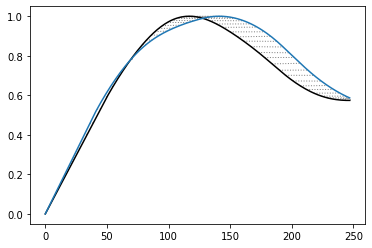

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.6664964632417032


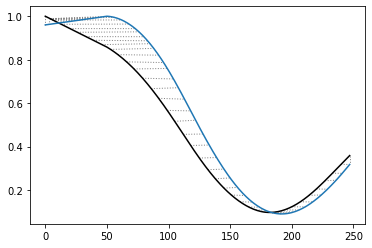

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  12.803680545759086


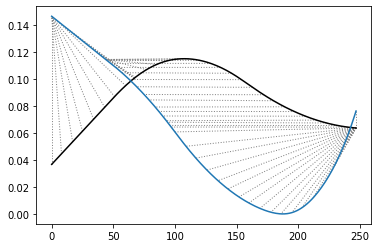

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.333994880483211


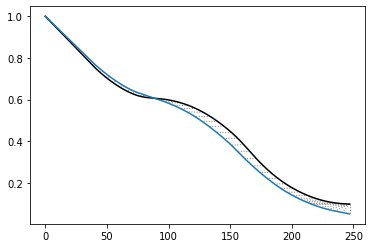

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.996083333816582


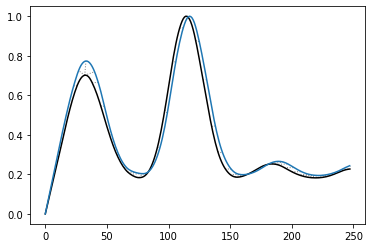

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.761124155599565


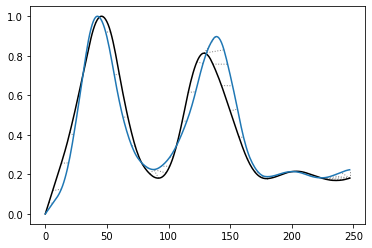

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.0317431526001302


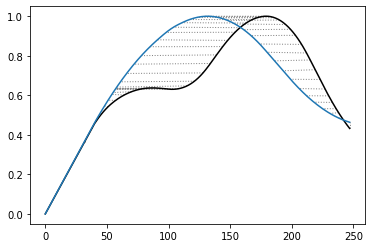

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.993046693404836


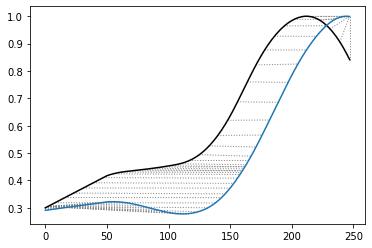

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  3.72046060135211


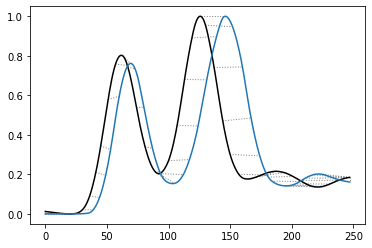

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  2.614632635570436


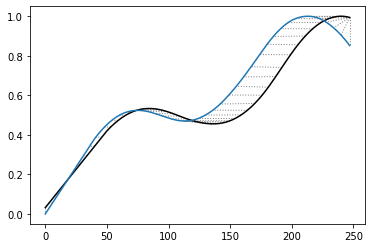

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  8.518651521018478


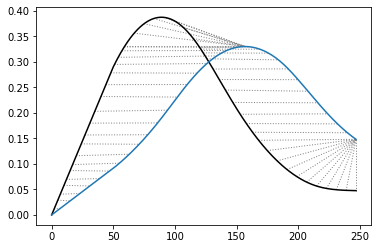

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.522451833071996


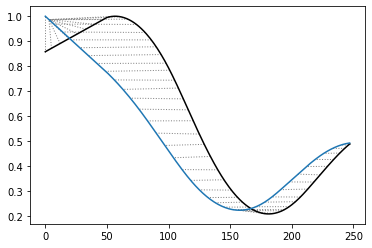

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.8745194385186537


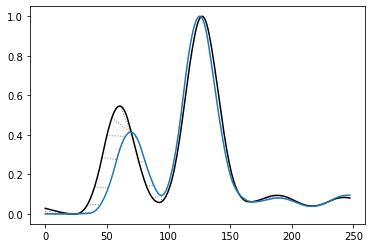

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값 :  0.7239102363968072


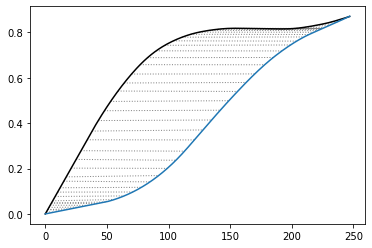

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.811845949989073


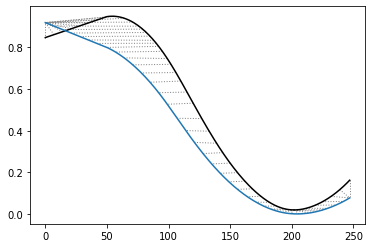

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.5276082310258118


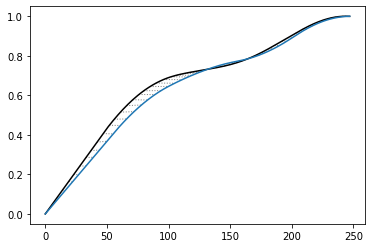

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  9.436656221207619


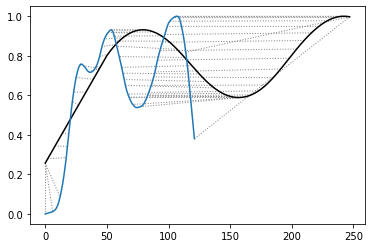

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.7770540307962115


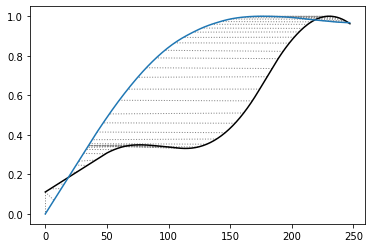

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  6.029330141153916


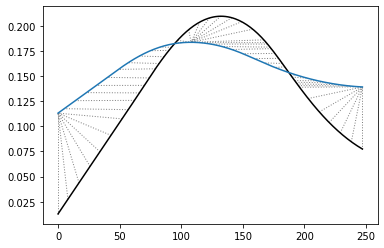

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  3.1828012746715717


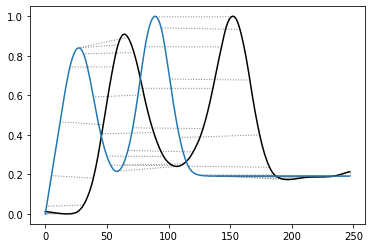

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  7.01148060615707


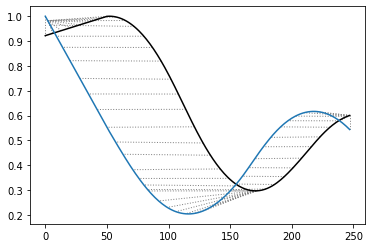

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.266425539061369


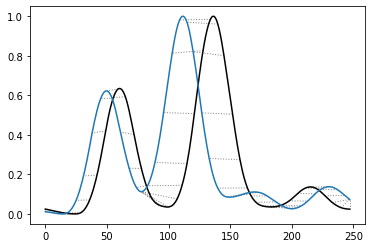

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.9539633077479768


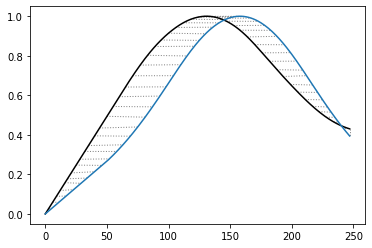

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.0059411945480394


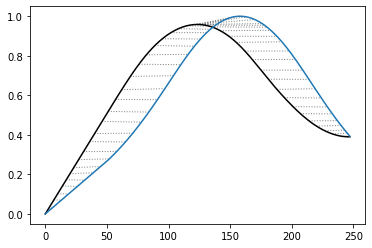

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.8183507166773446


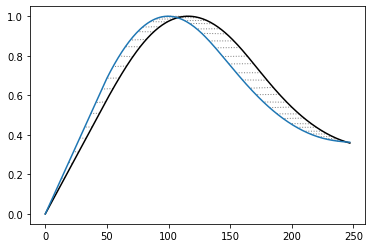

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.7765794794112759


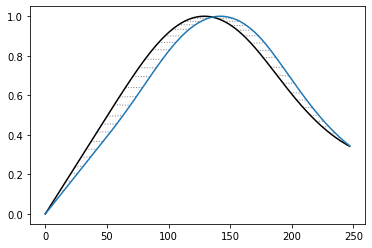

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  4.215418395008524


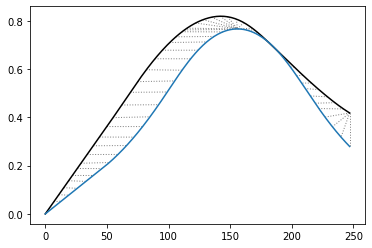

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.2285420790790202


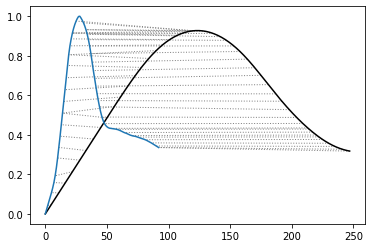

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7996826390974661


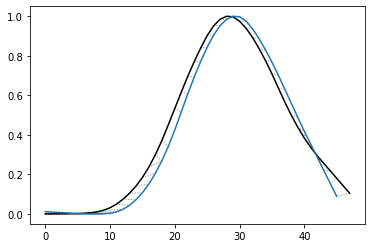

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.6888131659079715


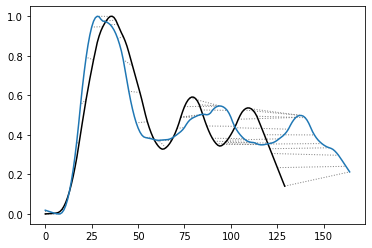

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.0932295909205578


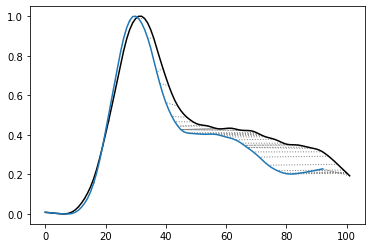

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.7456970245151086


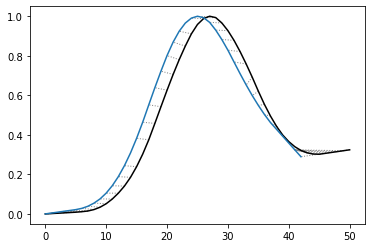

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  11.96698521396545


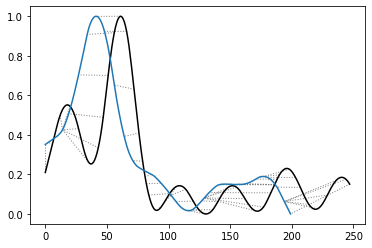

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  0.438403688228952


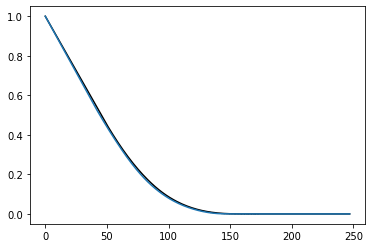

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.3099323042323467


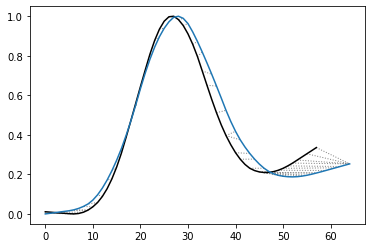

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  0.9993080355178856


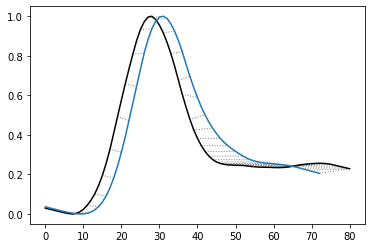

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.834545122601806


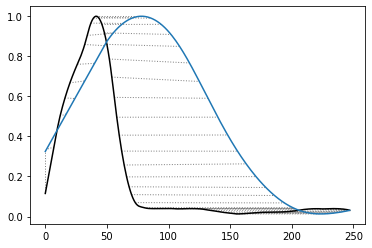

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  1.93601055721025


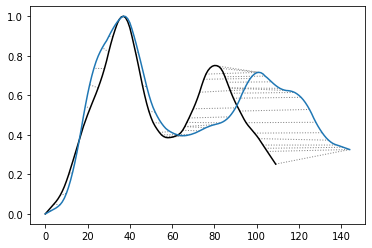

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.8085657243500783


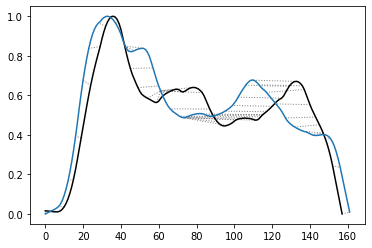

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.571139360298


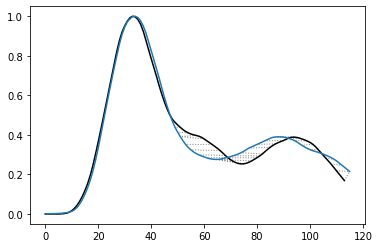

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.808641240973933


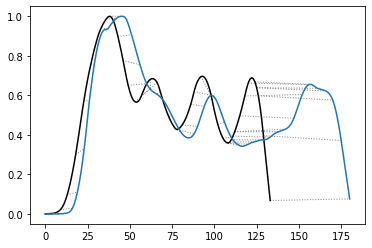

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  3.257391664866262


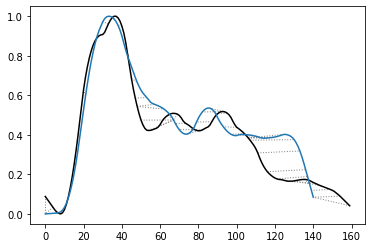

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값 :  3.803863578847744


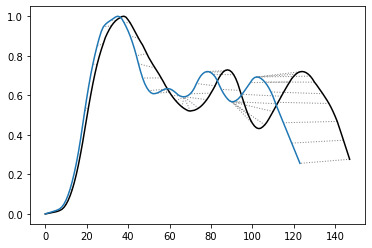

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.5261706134252049


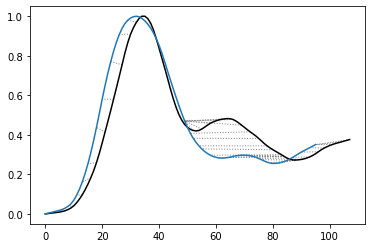

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값 :  2.7914526309349146


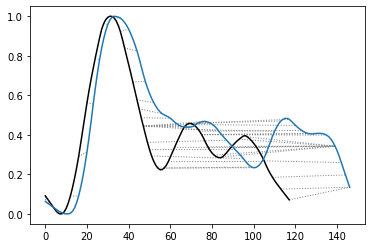

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.091784507619201


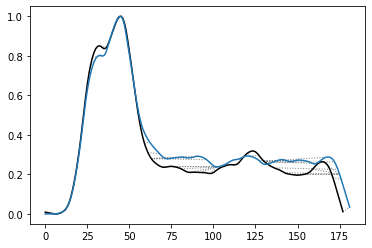

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.6245297351573362


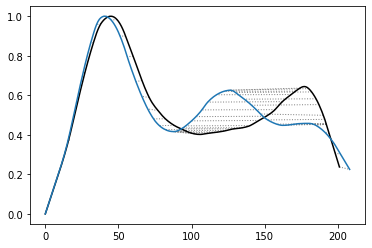

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값 :  2.2188625281227115


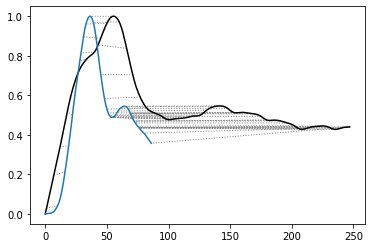

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값 :  5.1086844057825695


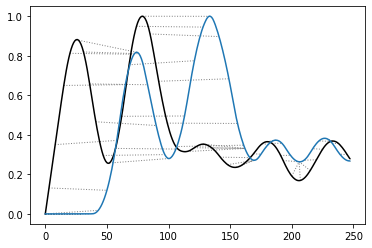

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.100657080679093


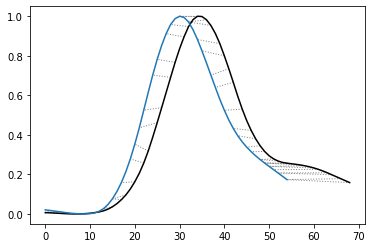

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값 :  4.0637137612747125


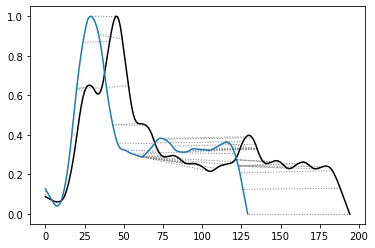

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값 :  1.6155775123766805


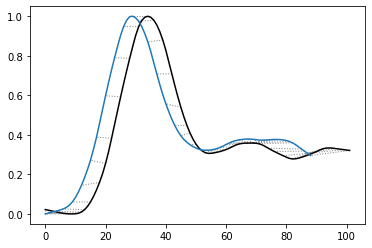

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값 :  4.828404280006391


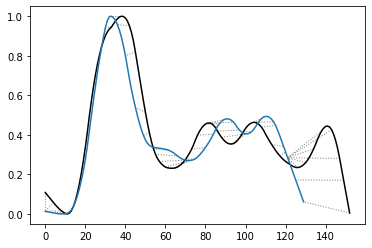

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값 :  1.0000853984896692


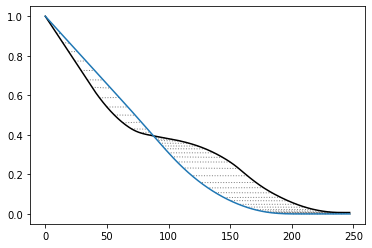

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값 :  1.7066859502332952


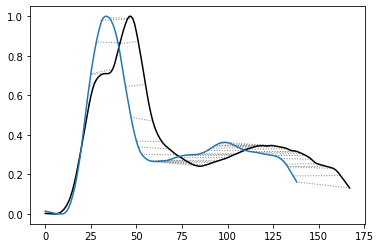

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  3.3167027704607293


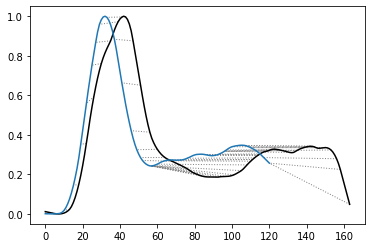

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.837459670638951


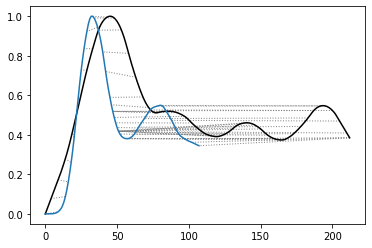

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.6425254057061003


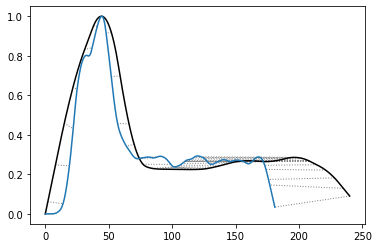

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값 :  0.727449635285203


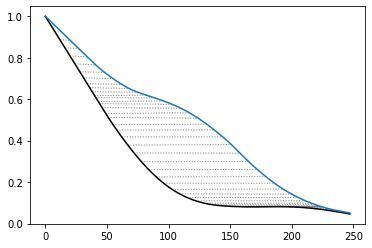

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값 :  1.1086983509902386


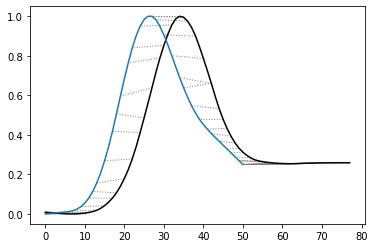

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값 :  2.6288079441608256


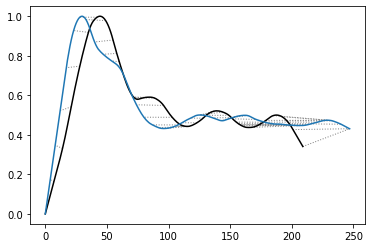

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값 :  2.841805846508419


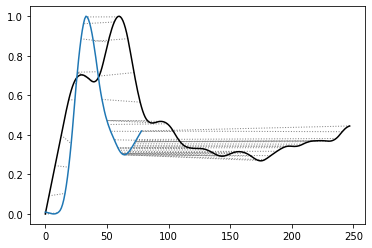

-----------------------------------------------------------------------------


In [82]:
for i in DTW_memoryutil.columns:
    while(True):  # 동일한 인스턴스가 뽑히는걸 방지해준다.  
        min_value = min(DTW_memoryutil[i])
        if(i[:i.find('_')] != DTW_memoryutil.columns[list(DTW_memoryutil[i]).index(min_value)][:i.find('_')]):
            break
        DTW_memoryutil[i][list(DTW_memoryutil[i]).index(min_value)]=100

    print(i + ' 와 가장 비슷한 매트릭은 ?  ') 
    print('=  '+ DTW_memoryutil.columns[list(DTW_memoryutil[i]).index(min_value)])
    print('DTW 값 :  '+ str(min_value))  # 최소값
    #print( list(DTW_memoryutil[i]).index(min_value)) #최소값 Index
    
    query = np.array(Timeseries_gpu_memory[i])
    query = query[np.isfinite(query)] # 뒤쪽에 nan 값 제거
    query2 = np.array(Timeseries_gpu_memory[DTW_memoryutil.columns[list(DTW_memoryutil[i]).index(min_value)]])
    query2 = query2[np.isfinite(query2)] # 뒤쪽에 nan 값 제거
    dtw_value = dtw.dtw(query,query2,keep_internals=True).distance
    #print(dtw_value)
    dtw.dtw(query,query2,keep_internals=True).plot(type="twoway")
    Memoryutil_similar_metric['Similar_metric'][i]  = DTW_memoryutil.columns[list(DTW_memoryutil[i]).index(min_value)]
    Memoryutil_similar_metric['DTW'][i]  = min_value
    print("-----------------------------------------------------------------------------")

## 2. Timeseries_gpu_utilization

In [76]:
DTW_gpuutilization = pd.read_csv('DTW_gpuutilization.csv')
Timeseries_gpu_utilization = pd.read_csv('Timeseries_gpu_utilization.csv')

In [77]:
DTW_gpuutilization = DTW_gpuutilization.rename(columns={DTW_gpuutilization.columns[0]: 'LISTS'})
DTW_gpuutilization.set_index(DTW_gpuutilization.columns[0],inplace=True)
DTW_gpuutilization.head()
DTW_gpuutilization = DTW_gpuutilization.replace(0.000000, 100)   # 본인과 본인비교는 0이라 최소에서 제거해주기위해
# 가장 흡사한 매트릭 매치해서 Dataframe 으로 만들기
Gpuutil_similar_metric = pd.DataFrame(index = list(DTW_gpuutilization.columns),columns=['Similar_metric','DTW'])

p100_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.797651014911181


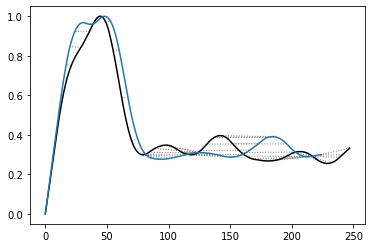

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.050364024146941


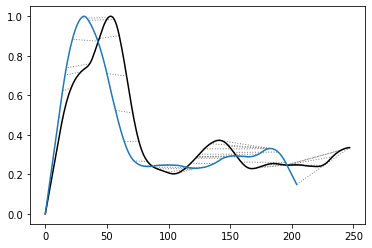

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.5321783081380267


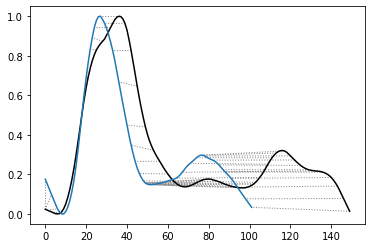

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.271828047319167


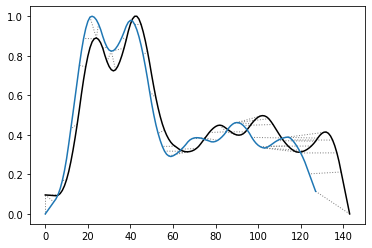

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7567431414589365


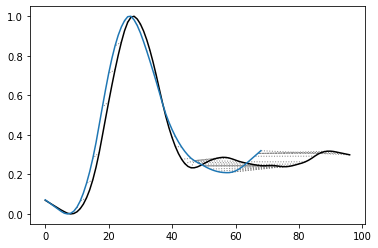

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.600981941570056


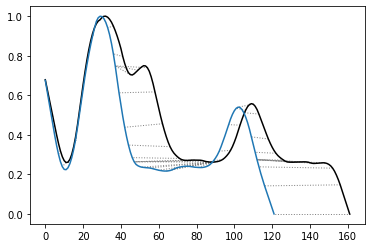

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.1662599258449977


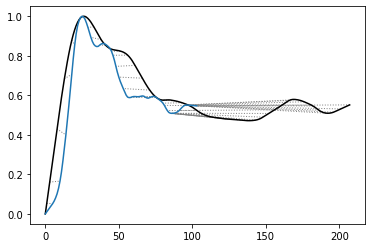

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.238299956394893


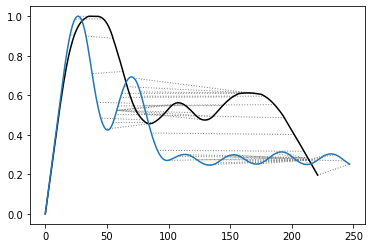

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.5749818003394136


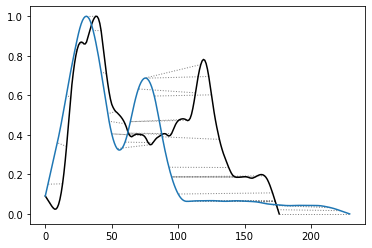

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.532346988916246


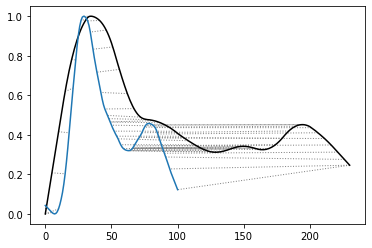

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.561920024146364


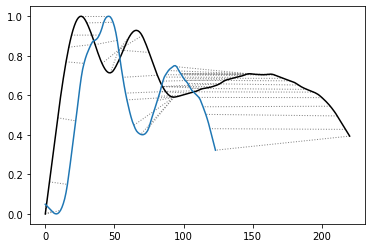

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6051598934530045


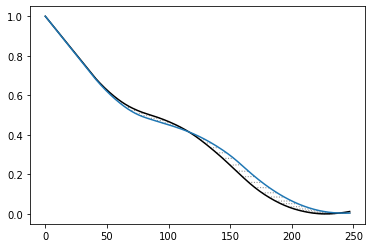

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.075934901996903


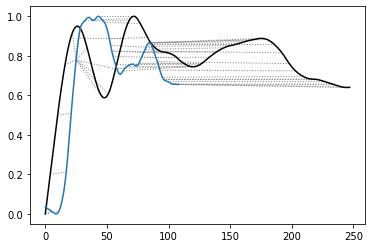

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.528979223323357


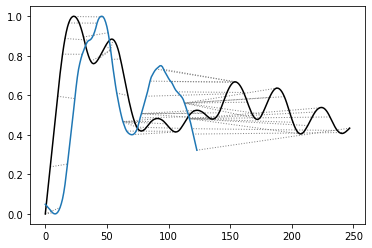

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.9448764537906702


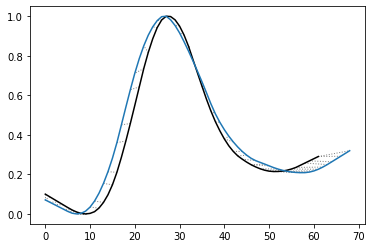

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1548768454654637


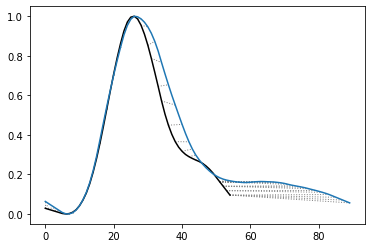

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.2087311603387496


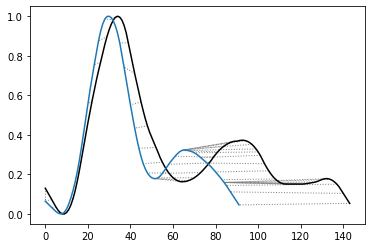

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.4439120786027155


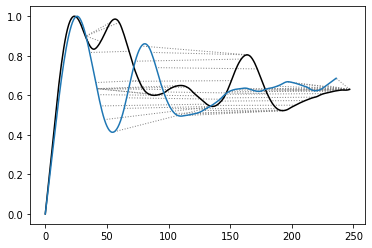

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.508315070462877


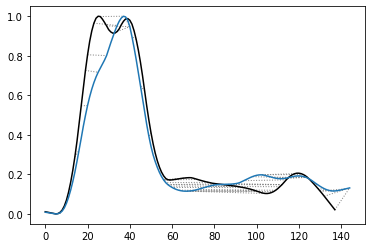

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.376805841032638


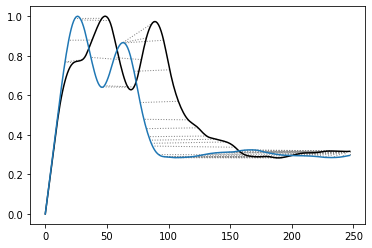

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  8.326598924175595


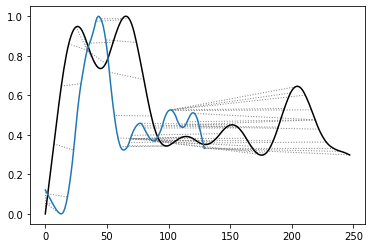

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3849146793106717


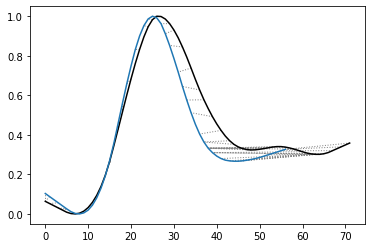

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.6845025508037175


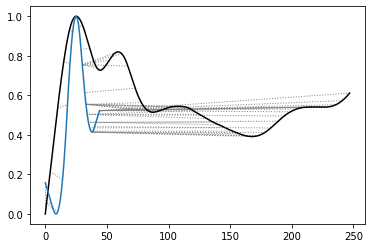

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.3251945155406135


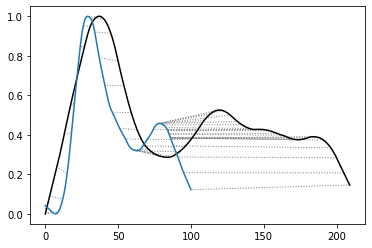

-----------------------------------------------------------------------------
p100_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  17.380647502162574


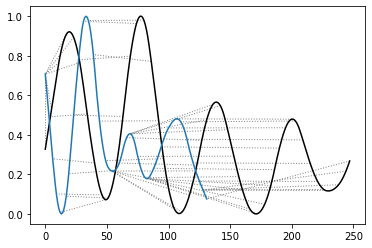

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6452555974836637


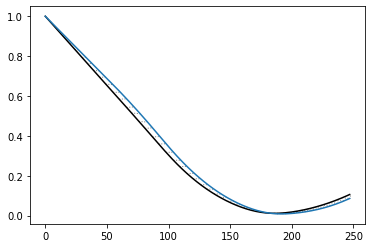

-----------------------------------------------------------------------------
p100_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2235373613128486


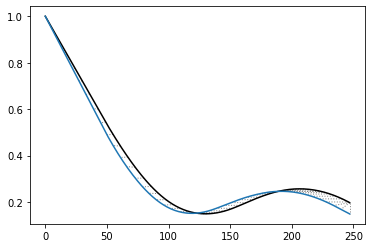

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  4.487168630851978


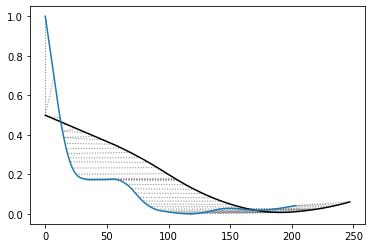

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.302950807132639


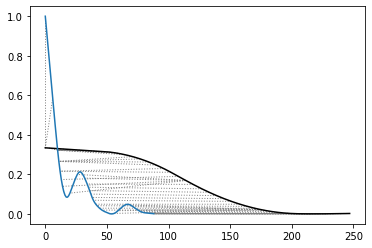

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6445142978120822


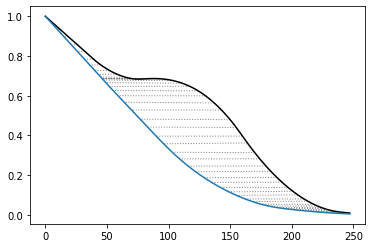

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.425798455091047


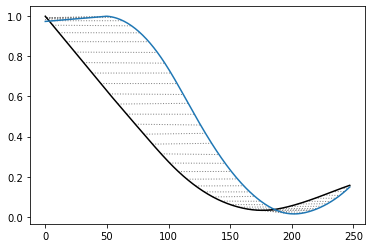

-----------------------------------------------------------------------------
p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6046088453316129


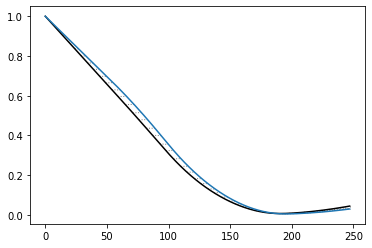

-----------------------------------------------------------------------------
p100_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5998211455689073


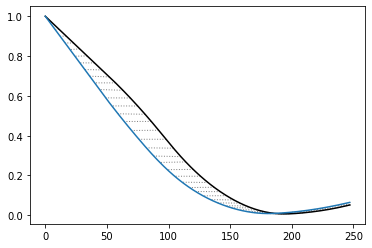

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.8915206132638267


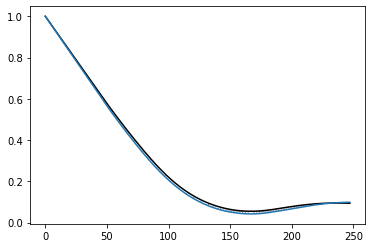

-----------------------------------------------------------------------------
p100_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2320107822290765


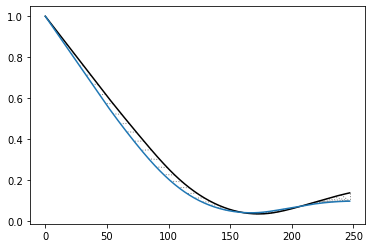

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  4.92547600143633


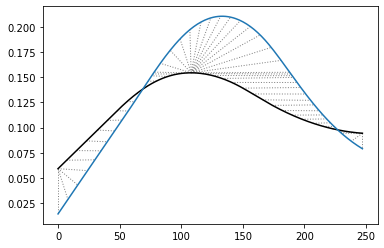

-----------------------------------------------------------------------------
p100_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.184732954037512


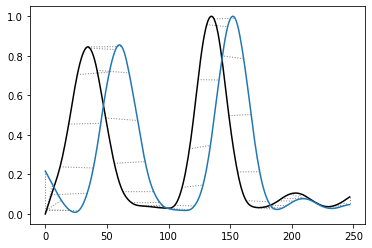

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.4454914091381237


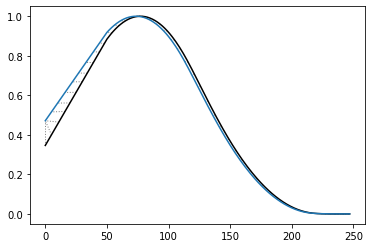

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.3181204697382118


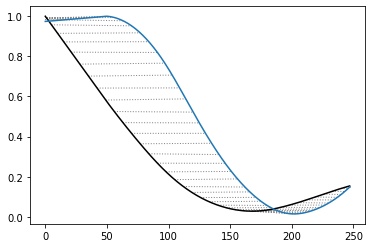

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.192680623196293


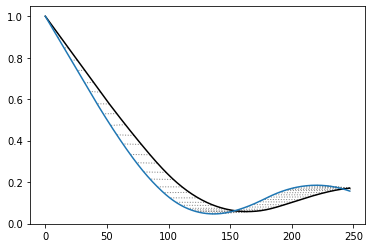

-----------------------------------------------------------------------------
p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.353825175594031


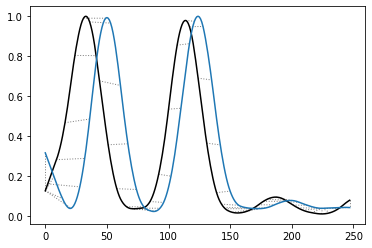

-----------------------------------------------------------------------------
p100_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.5602156056946574


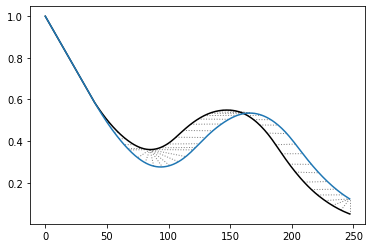

-----------------------------------------------------------------------------
p100_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.730373351262574


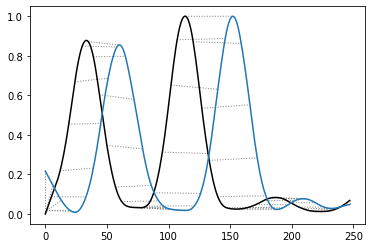

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.5014116979109748


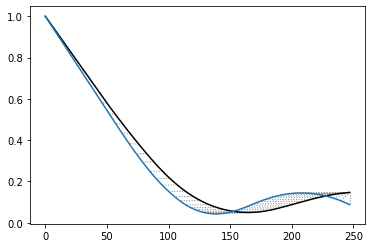

-----------------------------------------------------------------------------
p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0505906856668246


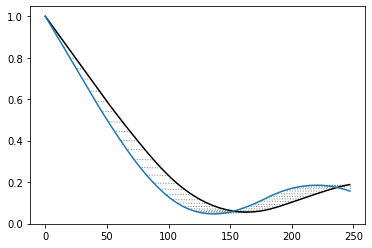

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.7918611546885743


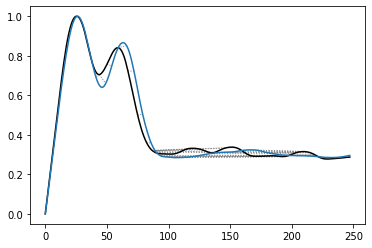

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6303136031879591


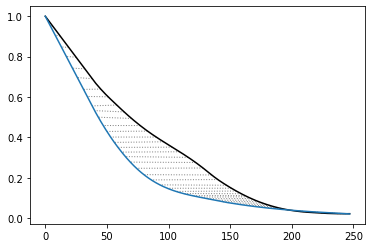

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.247485140259688


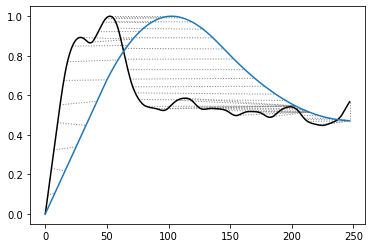

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.818506589767708


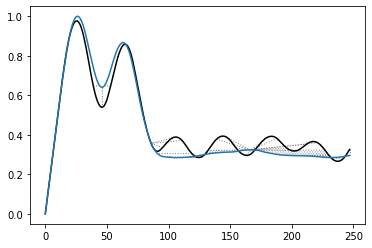

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.854951265049298


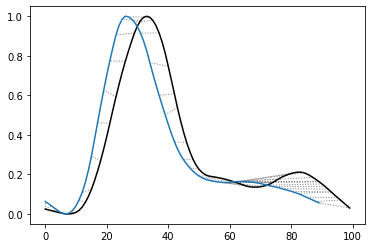

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  11.05075641759798


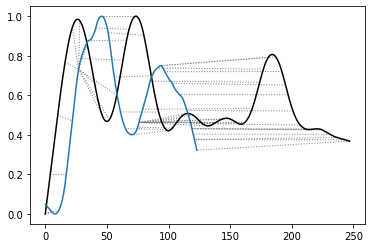

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.296780590646013


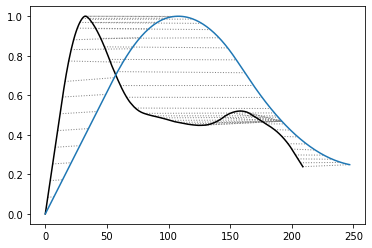

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.593886397515734


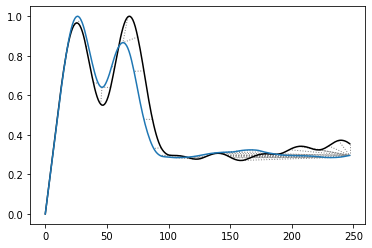

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.6408697893900515


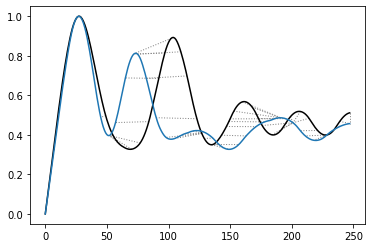

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5143321711392153


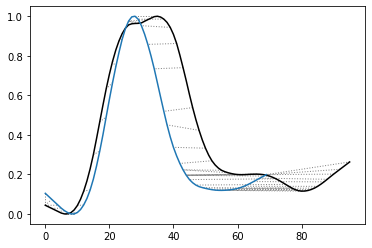

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.4329848434376995


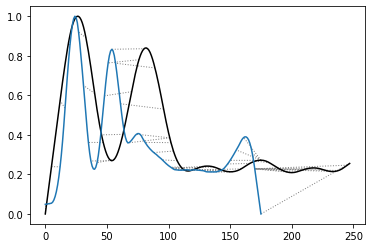

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.246009803909546


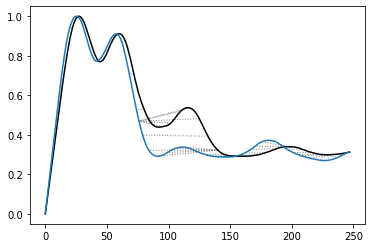

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.8943251331580453


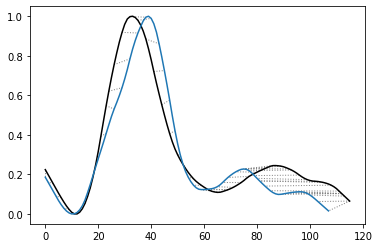

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  12.06106216953763


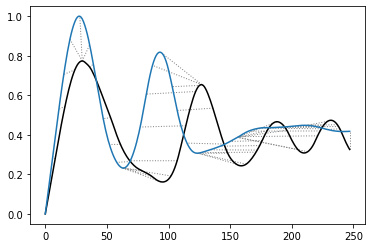

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.240326950385042


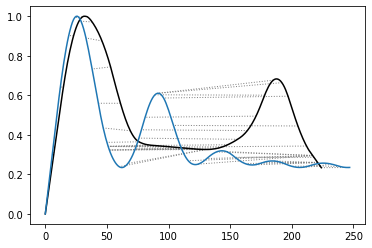

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.300658496430257


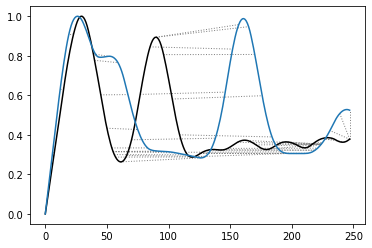

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.982736178022182


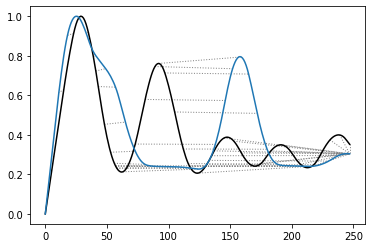

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.178722476006851


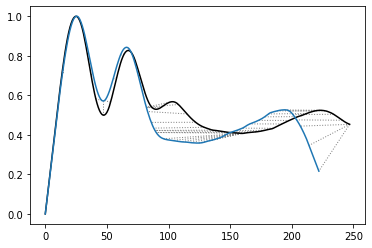

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.7908287543219


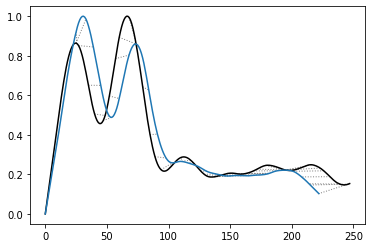

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.122465005650545


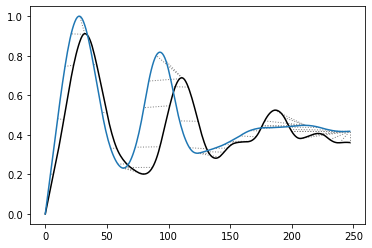

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  14.07432411169914


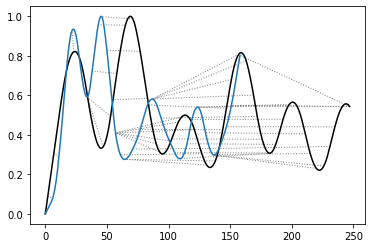

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.2687617852399766


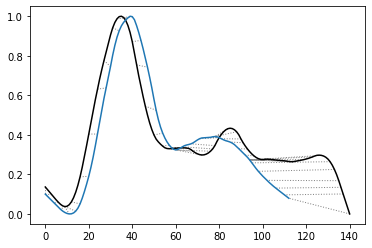

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.9182572858996005


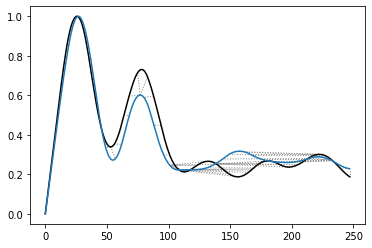

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.229886278467974


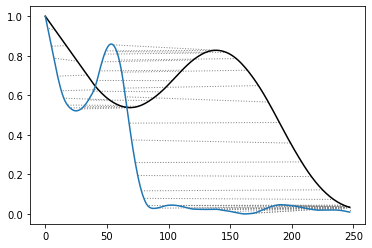

-----------------------------------------------------------------------------
p100_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.162780273719544


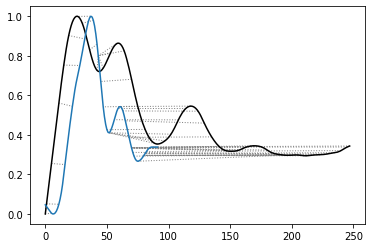

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.528890475222361


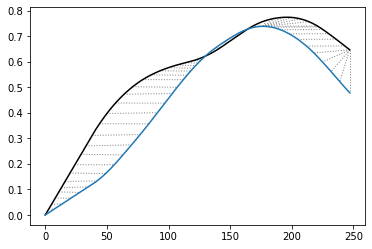

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.6453379997520265


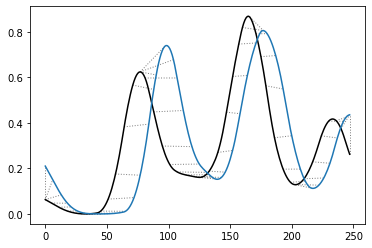

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8020082921324941


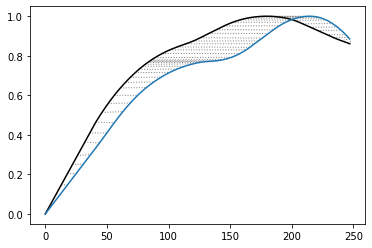

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.0063250808138888


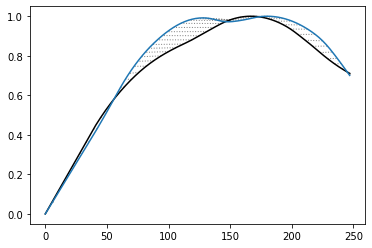

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.8034640281633543


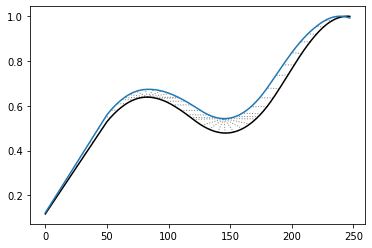

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.3988323077224205


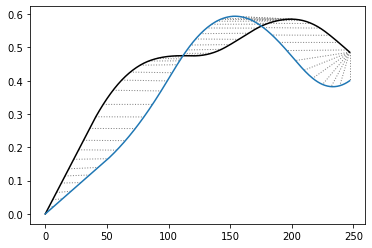

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.9762249701961472


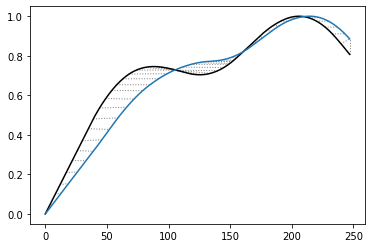

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1485530920483558


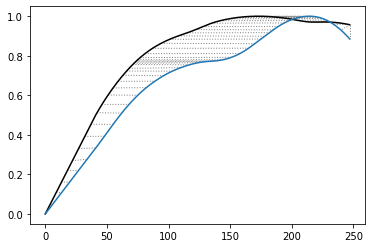

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8193999994006356


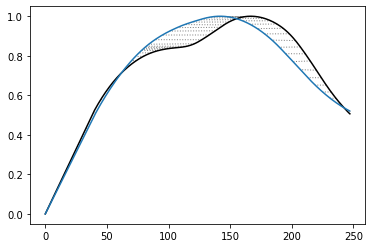

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.130615072954923


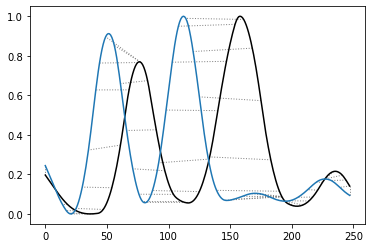

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.826720860390921


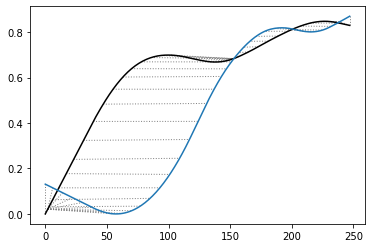

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.7327823161598661


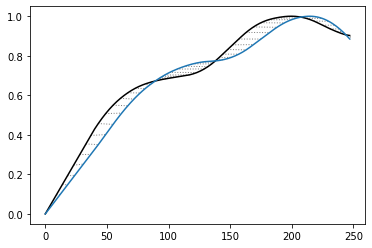

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8590820106606799


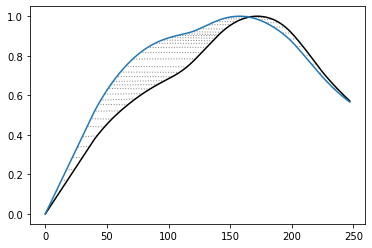

-----------------------------------------------------------------------------
p100_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.8587500435596817


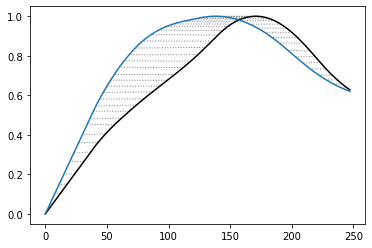

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6026249975160649


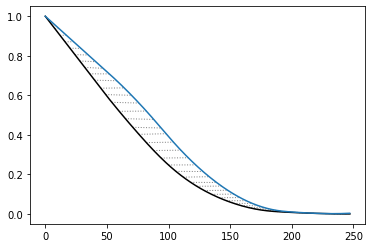

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.5832003055724613


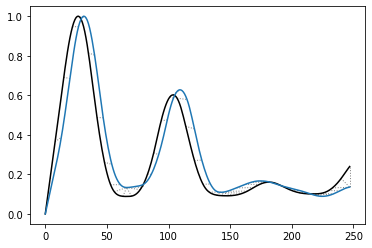

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6562251589802559


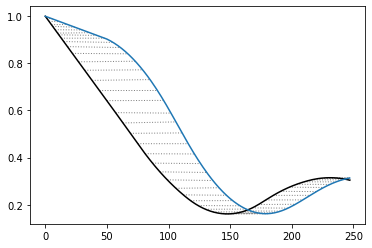

-----------------------------------------------------------------------------
p100_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.6422304096479614


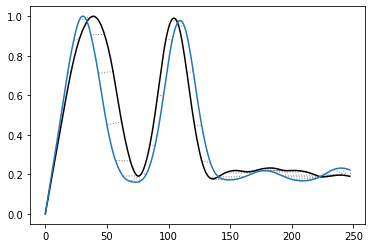

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5986949018155796


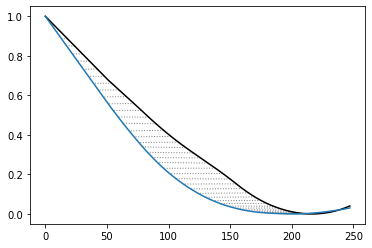

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.4701529319765687


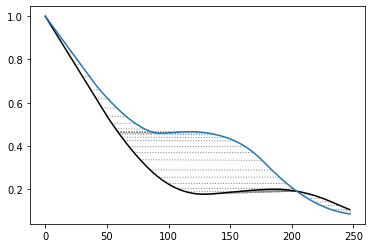

-----------------------------------------------------------------------------
p100_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9414436981394327


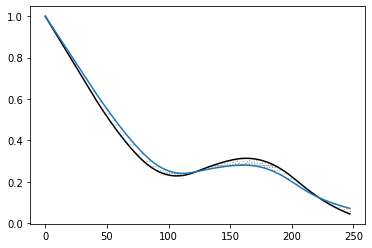

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.1981166285977674


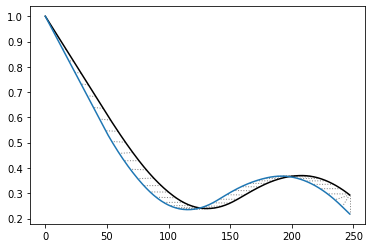

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2978964587884585


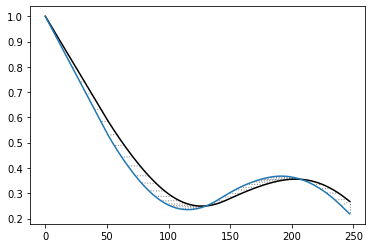

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.0073564789720653


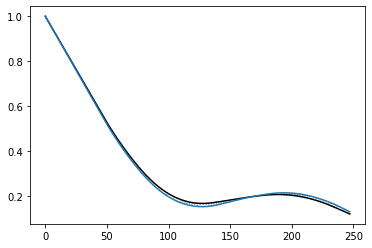

-----------------------------------------------------------------------------
p100_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  7.058716194135034


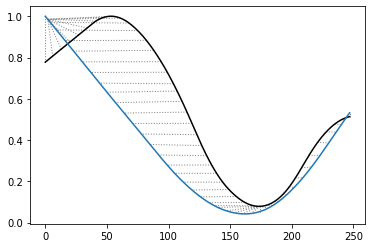

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.228464371682009


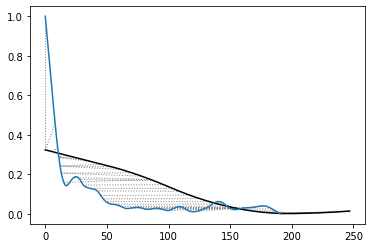

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.367494844995707


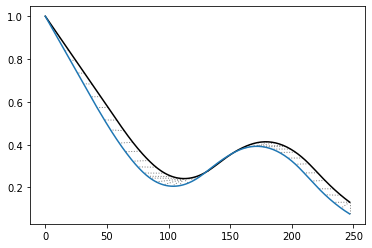

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4162480620952478


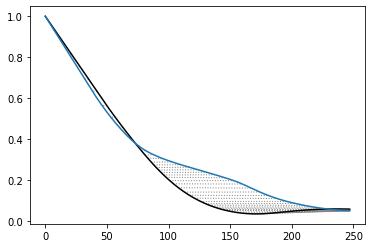

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.496072975977712


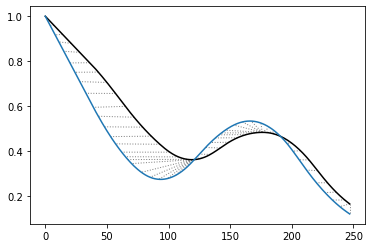

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.4299316801211592


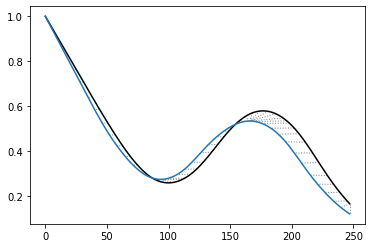

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0174860454648382


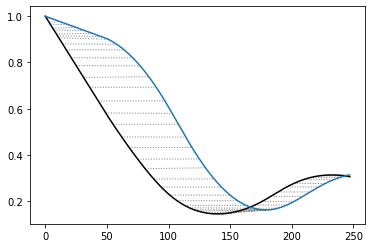

-----------------------------------------------------------------------------
p100_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.608266067793517


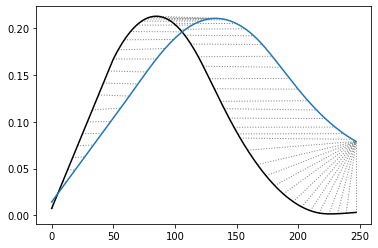

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  16.839585046792358


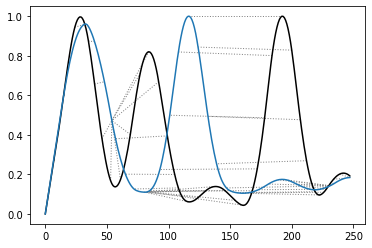

-----------------------------------------------------------------------------
p100_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.7832537349546858


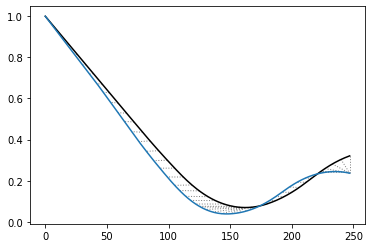

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.577095555475756


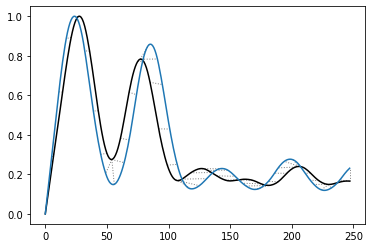

-----------------------------------------------------------------------------
p100_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.2243569539143266


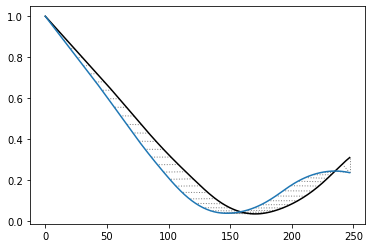

-----------------------------------------------------------------------------
p100_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.10567371281983


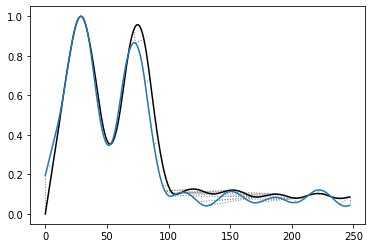

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.0219506010980135


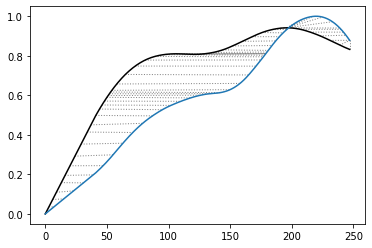

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.9336624547677046


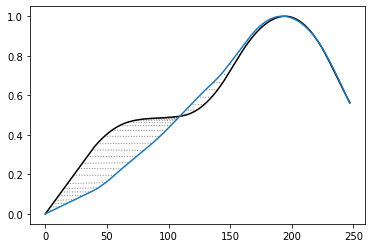

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5099084213688438


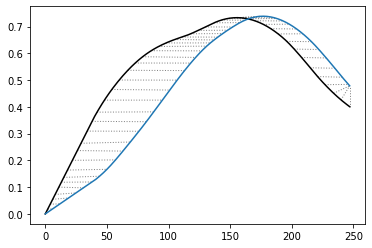

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.657119201652272


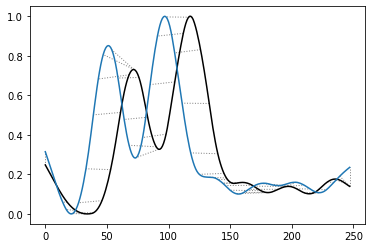

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0038765933798697


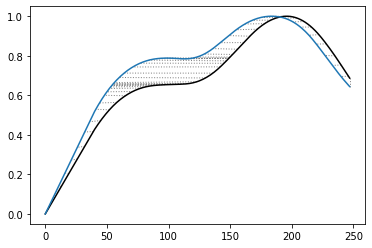

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.3170043933284887


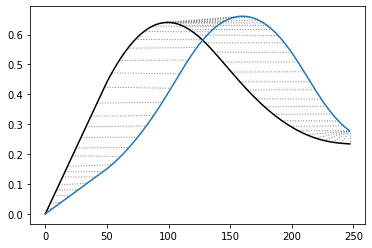

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  11.767922250673006


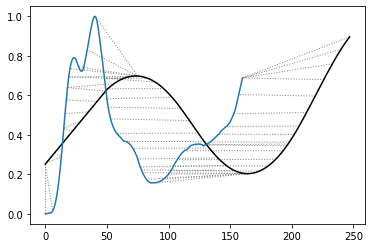

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.287197008649594


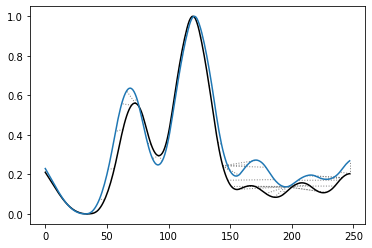

-----------------------------------------------------------------------------
p100_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.8603593390905071


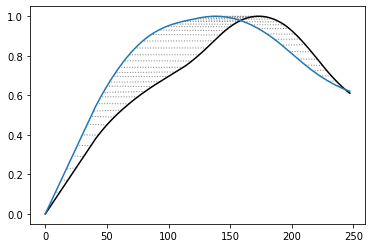

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.7488640592910566


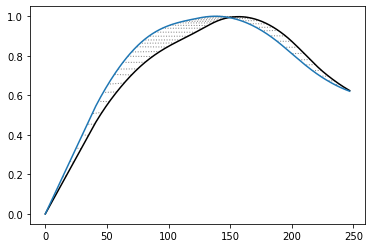

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.79773384069834


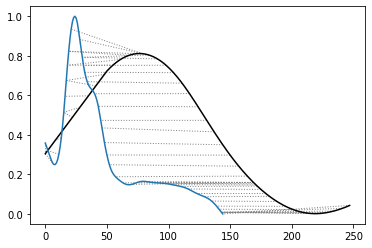

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.9528811866291976


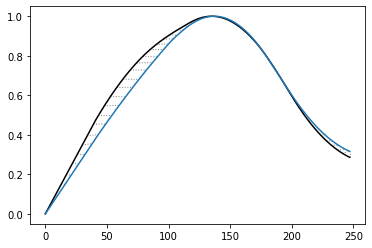

-----------------------------------------------------------------------------
p100_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.5602692424249005


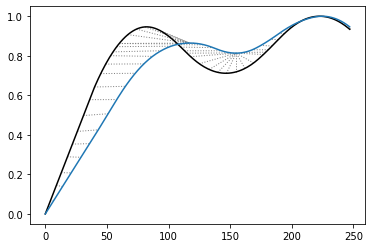

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1963649163630987


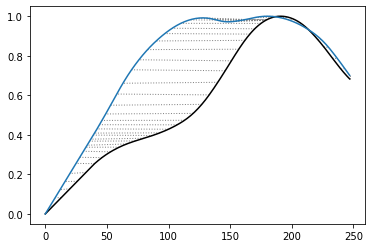

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.7348461428950515


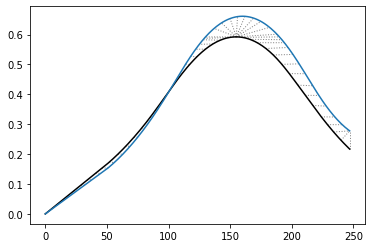

-----------------------------------------------------------------------------
p100_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.599421684002138


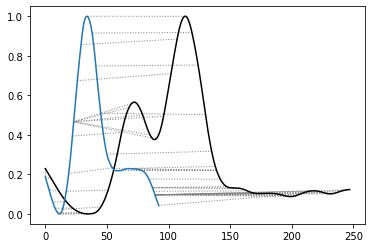

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.4454056737791818


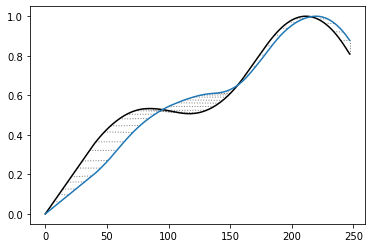

-----------------------------------------------------------------------------
p100_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6956656077785314


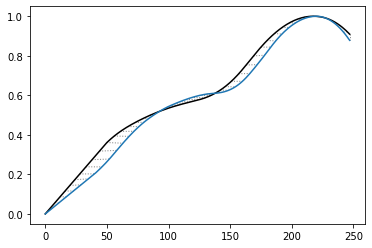

-----------------------------------------------------------------------------
p100_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.0867550034454403


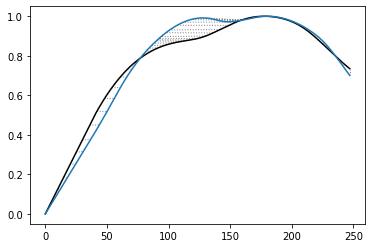

-----------------------------------------------------------------------------
p100_ResNet50_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.4410630129769255


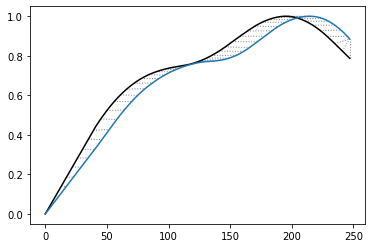

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.7809602849587979


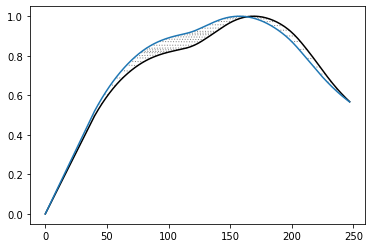

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3176006255349457


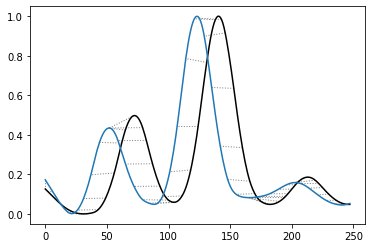

-----------------------------------------------------------------------------
p100_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1727015955253564


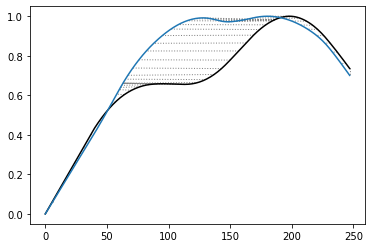

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.9422796587710005


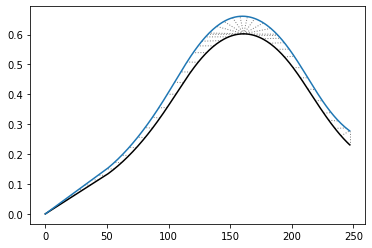

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.231472181918233


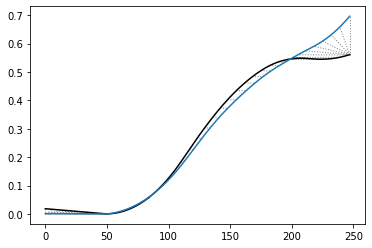

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.043422852261572


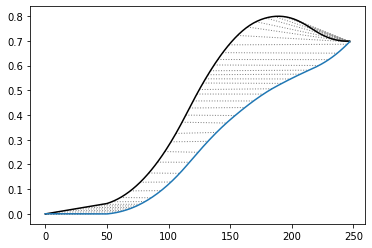

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  10.909878850117046


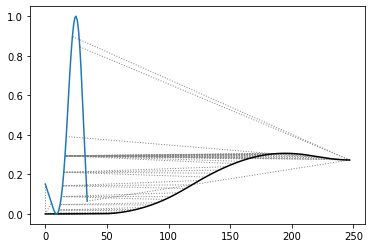

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.038920208684652


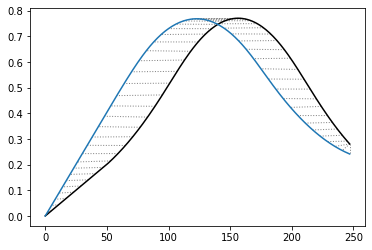

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.6786681123049436


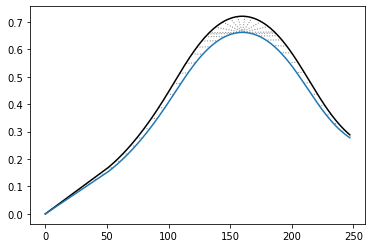

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8759383058358975


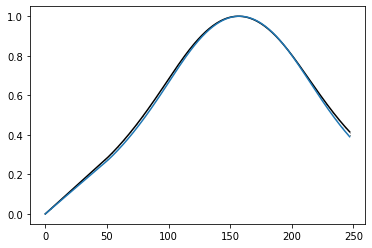

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.47405741776186


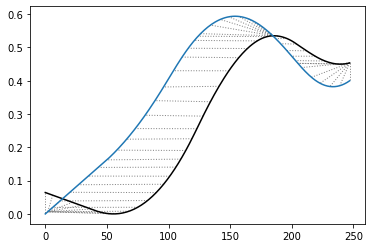

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5812873405328648


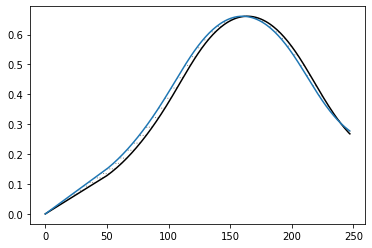

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.2960670384596409


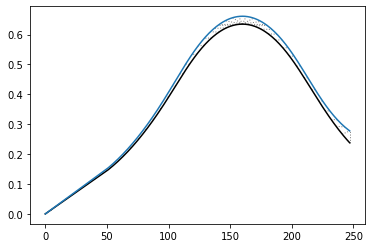

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.772703592127294


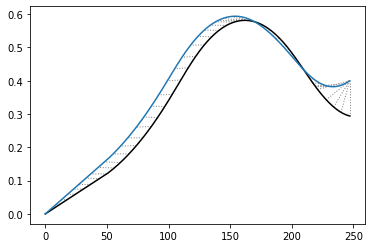

-----------------------------------------------------------------------------
p100_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.761846621047872


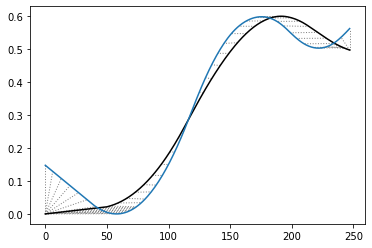

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.7045963748477545


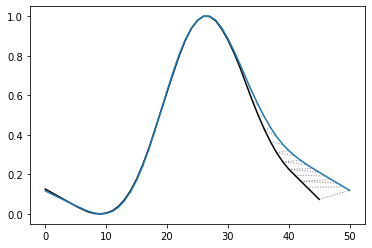

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.1401534006517378


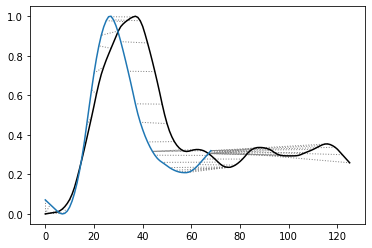

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.734411378405669


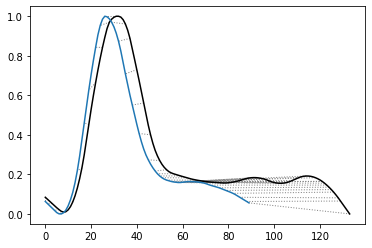

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.9523979380468215


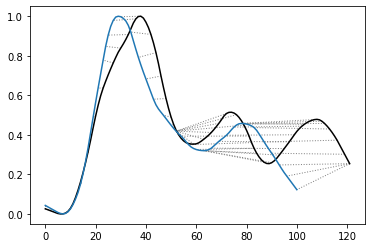

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.4061271627326757


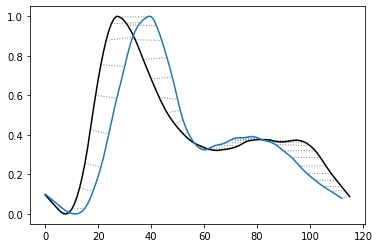

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.287216002857011


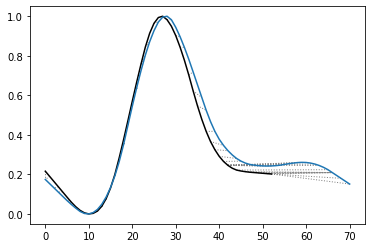

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.8534649420853215


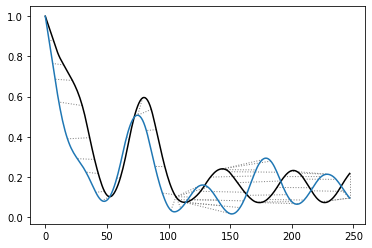

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.580670992417142


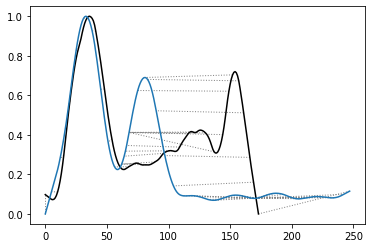

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.7351692462387073


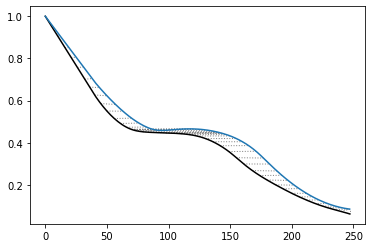

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0490026005586208


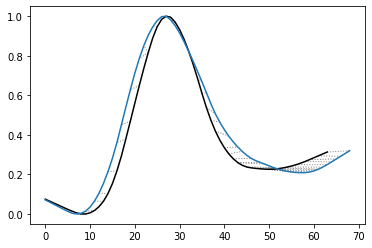

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.667944414427493


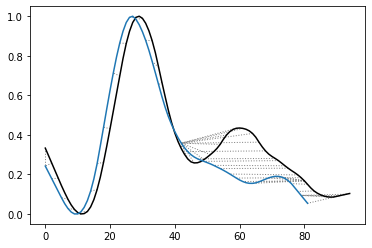

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  13.112206494219642


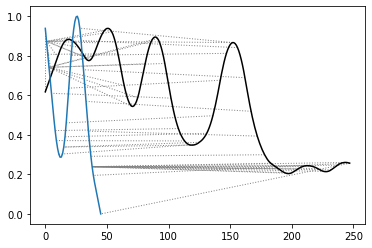

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.62317689845153


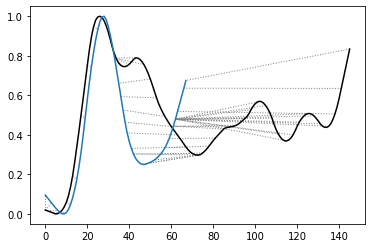

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.684517409727064


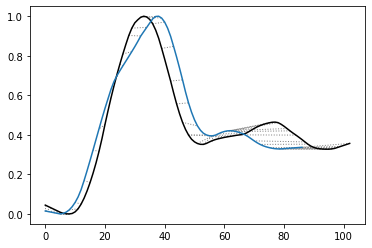

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.274447737675379


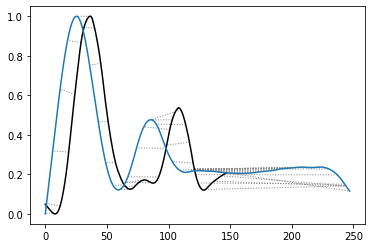

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.137616987701676


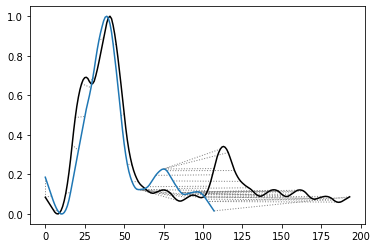

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.7796388227752382


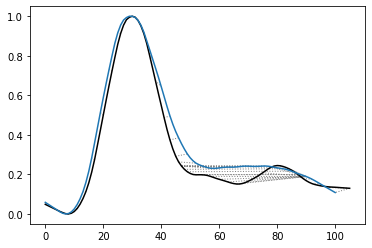

-----------------------------------------------------------------------------
p100_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.7378132832137565


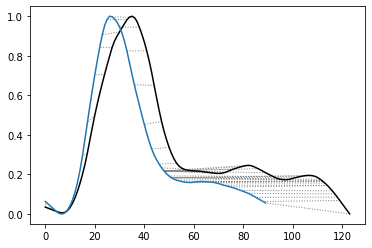

-----------------------------------------------------------------------------
p100_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.142333152248195


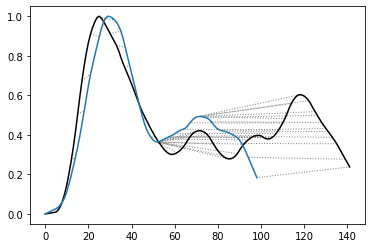

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  9.210084086622675


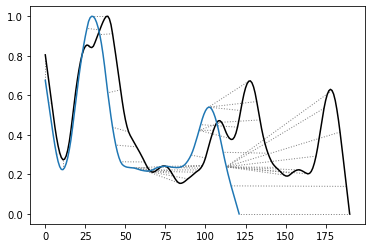

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.8329273587067725


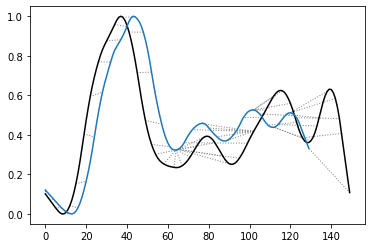

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.000544089820018


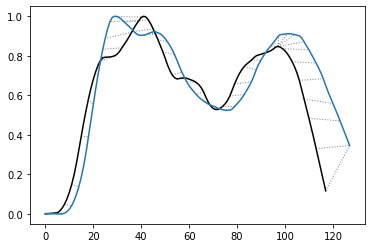

-----------------------------------------------------------------------------
p100_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3386151571095157


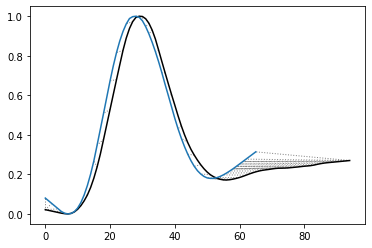

-----------------------------------------------------------------------------
p100_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.143388980626803


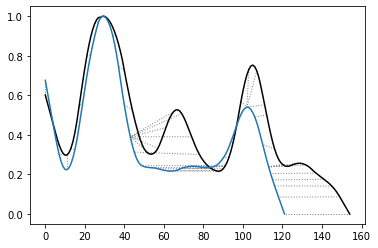

-----------------------------------------------------------------------------
p100_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.513355091590288


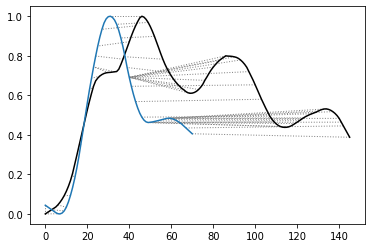

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.2697476729966497


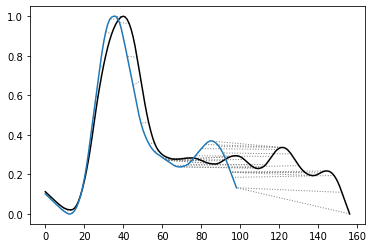

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.5935876608416653


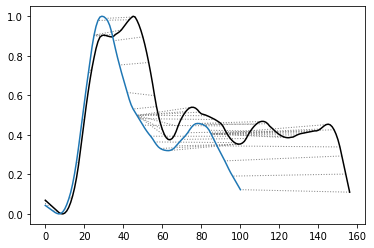

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.01459755114301


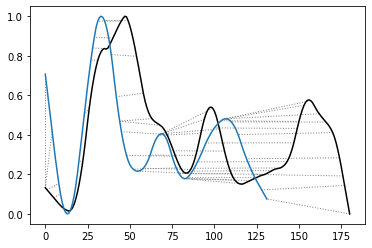

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.026527331376096


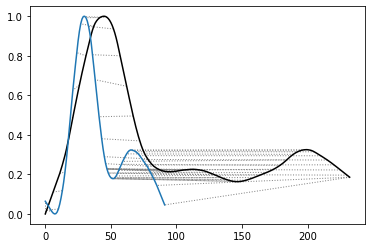

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.650437203075452


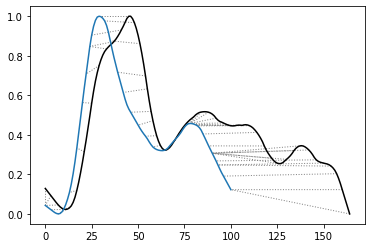

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.995161129871813


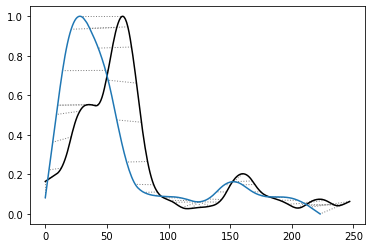

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.535854888205908


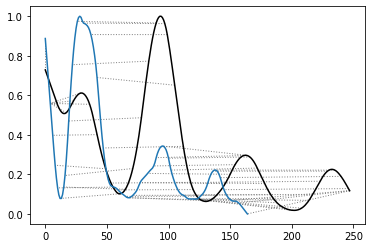

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.9768439022914356


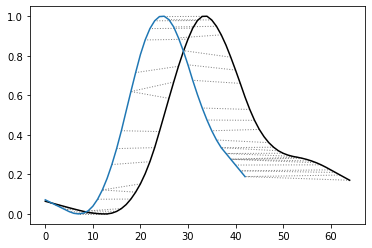

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.011913875249617


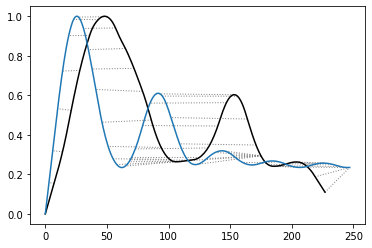

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.0379536282859423


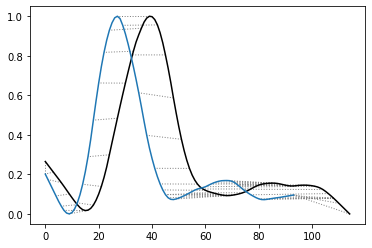

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.5920540564798773


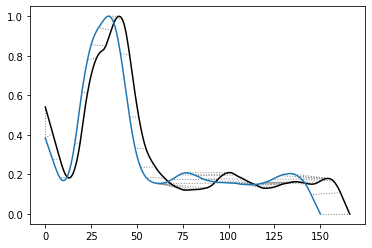

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2067217383655775


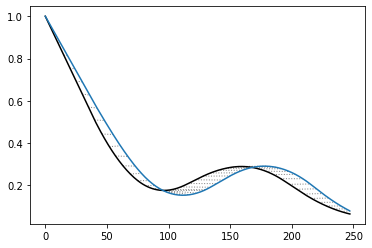

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.506617526018444


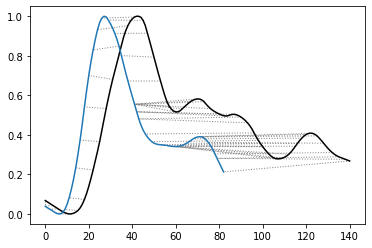

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.032132401739827


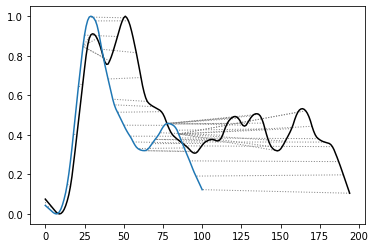

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.448785691226977


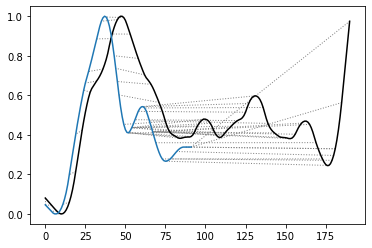

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.047954969015825


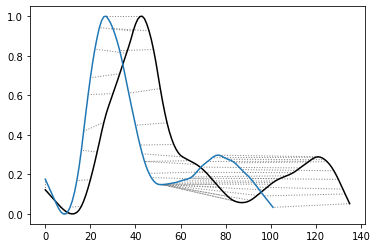

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.7208987516464727


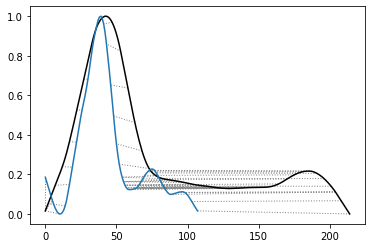

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.205609423504615


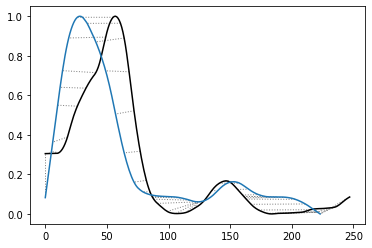

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.8813105406558575


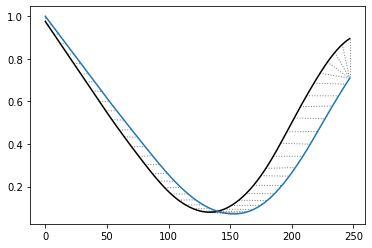

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.8695659034684065


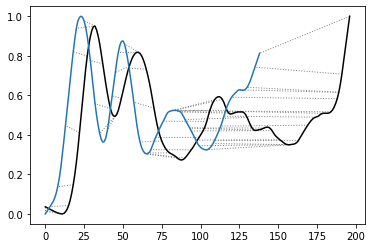

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.731910500261988


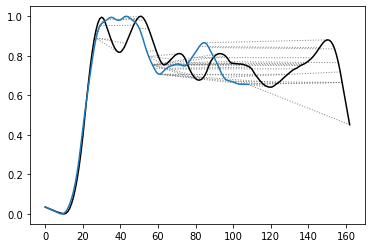

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.5110746230264405


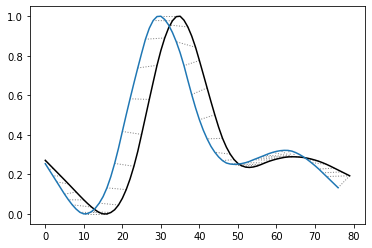

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.025361920988604


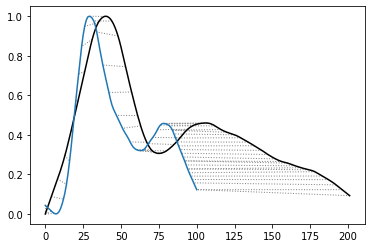

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.9283594639912405


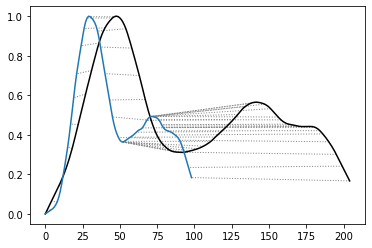

-----------------------------------------------------------------------------
p100_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.1344627951051693


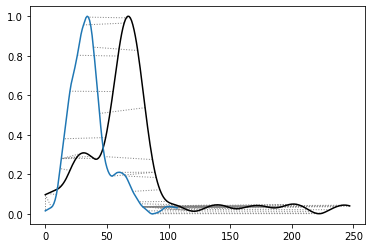

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.150427062007042


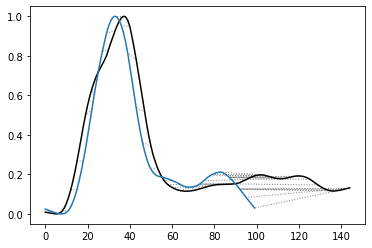

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.9128985772608367


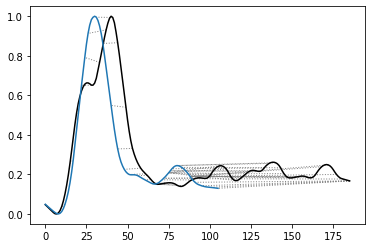

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5471306134923075


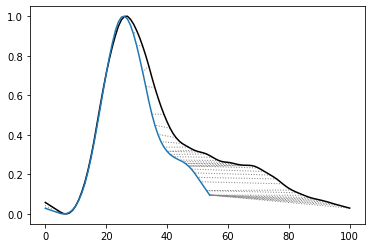

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.4939055366077625


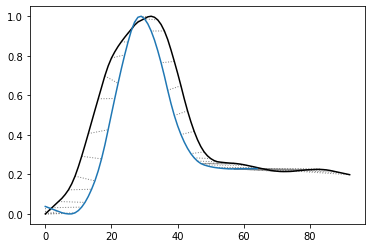

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4653664022470052


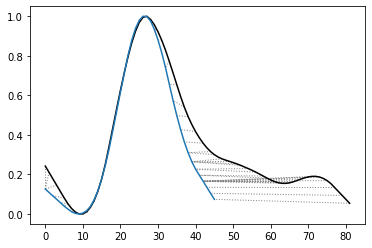

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.214635826529197


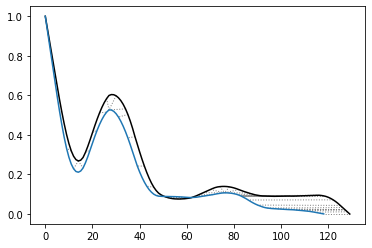

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.3087988069376744


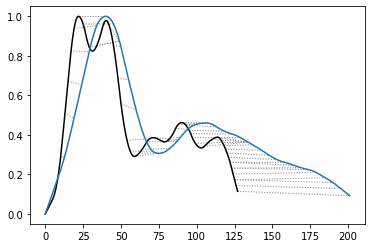

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.8169307139494357


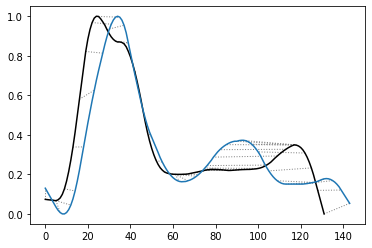

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.1401594092007854


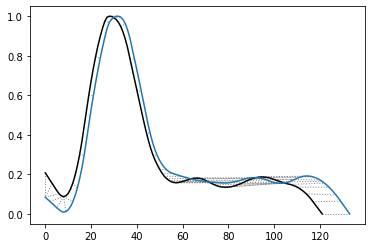

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.351749476651257


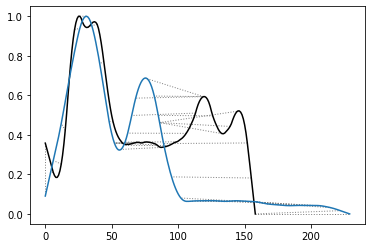

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.8695659034684065


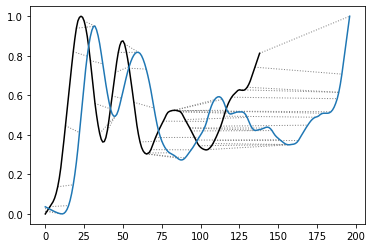

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.5763036893986259


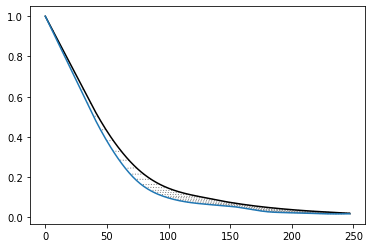

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.172744263334409


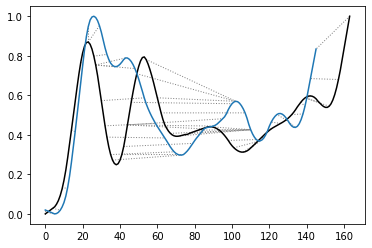

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.394751792620309


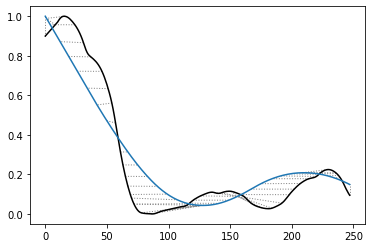

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3675295844688249


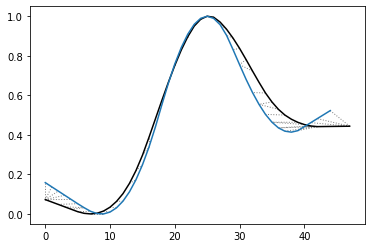

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.7486472800378909


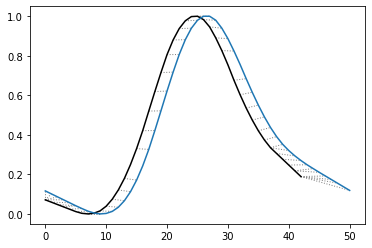

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.3770230777600716


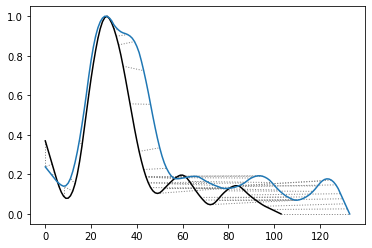

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.1004570979595485


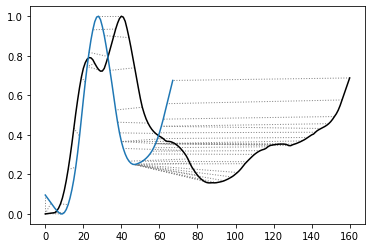

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.2087311603387496


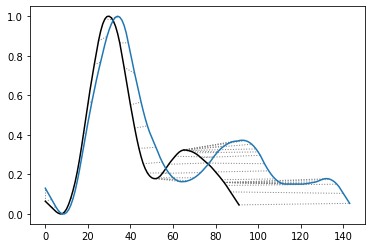

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.804866168494306


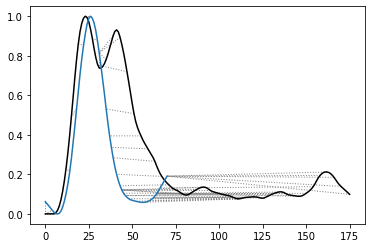

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.8461580656979932


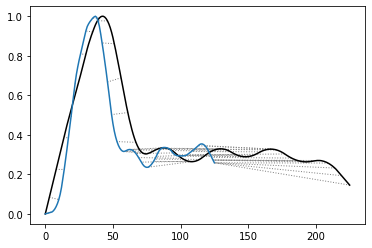

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3221969923413122


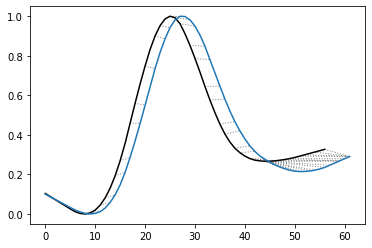

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.068473607950248


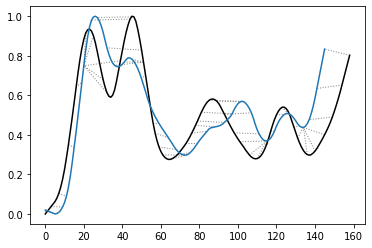

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.684566843309388


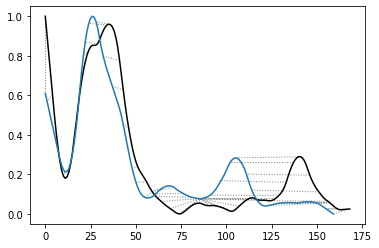

-----------------------------------------------------------------------------
p3_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.965465755689426


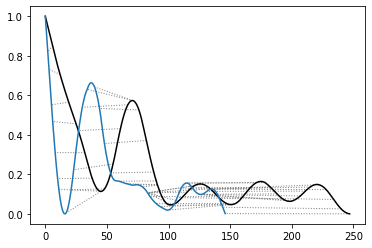

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.243217953100176


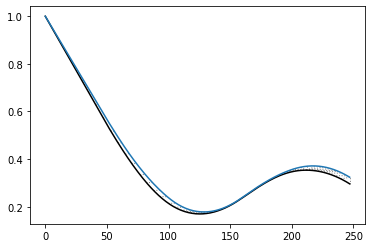

-----------------------------------------------------------------------------
p3_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.2730261669115064


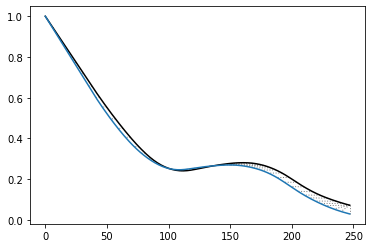

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.4273398291196107


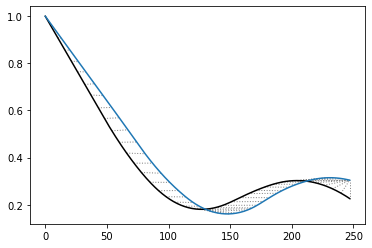

-----------------------------------------------------------------------------
p3_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.2400867483652425


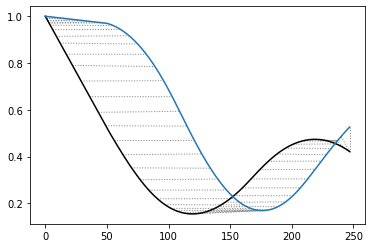

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.842920392674457


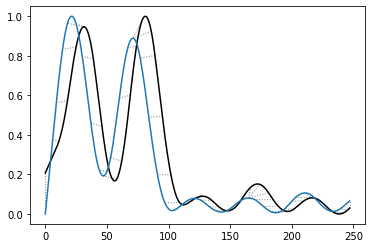

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.367494844995707


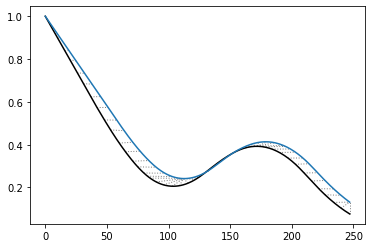

-----------------------------------------------------------------------------
p3_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.5237913536569248


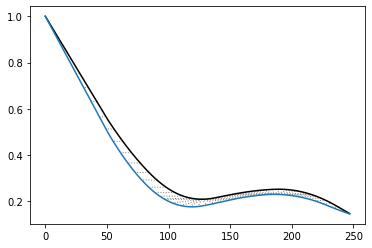

-----------------------------------------------------------------------------
p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1981166285977674


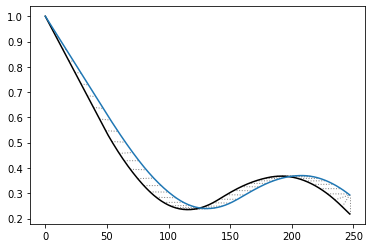

-----------------------------------------------------------------------------
p3_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7018803300918586


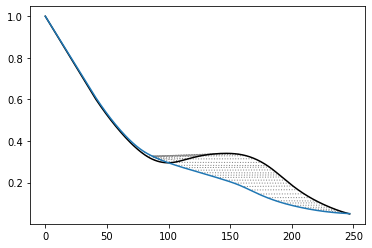

-----------------------------------------------------------------------------
p3_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.8315878189021264


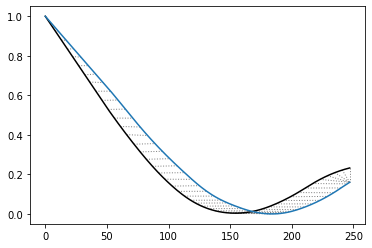

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.5800837673088888


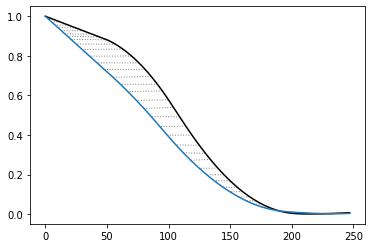

-----------------------------------------------------------------------------
p3_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.693717278073011


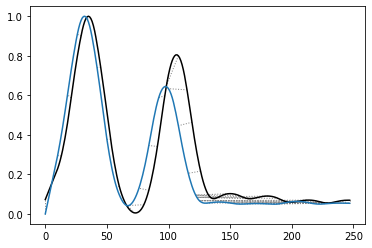

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.9259688773990064


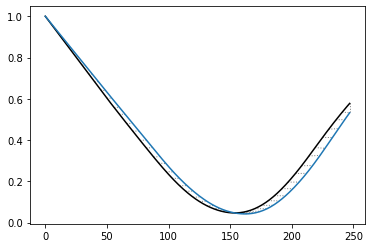

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.4299316801211592


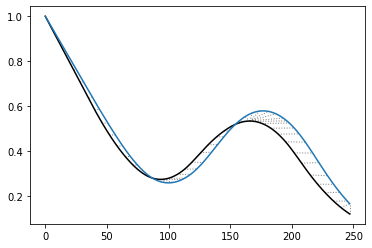

-----------------------------------------------------------------------------
p3_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7248160884893244


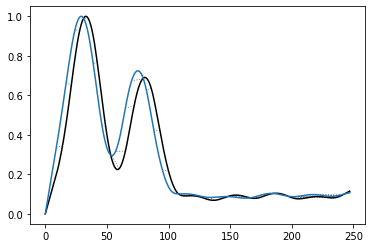

-----------------------------------------------------------------------------
p3_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.860869457978778


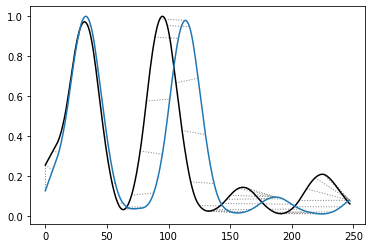

-----------------------------------------------------------------------------
p3_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.377745292139782


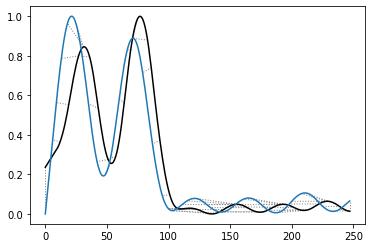

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.5305673325980869


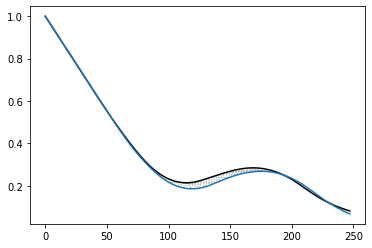

-----------------------------------------------------------------------------
p3_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.6566561165932223


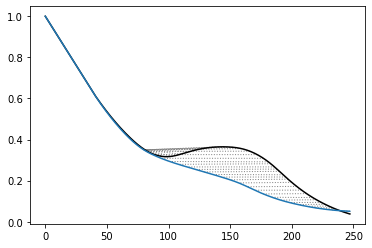

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.385234670987178


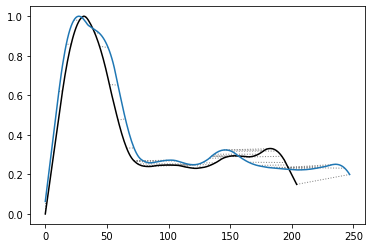

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.178968905739887


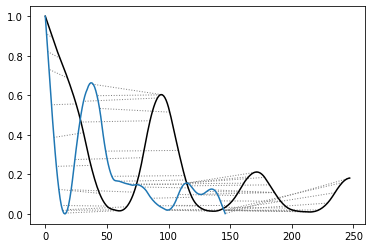

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.983148300009419


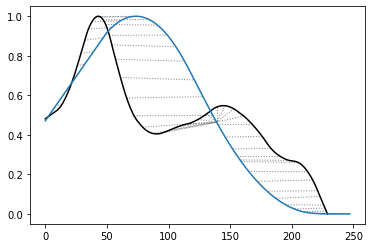

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.512210185426351


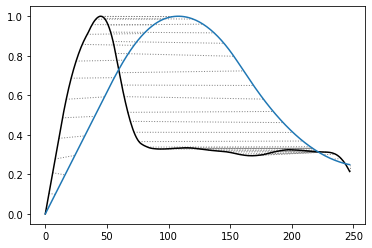

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3808502728240124


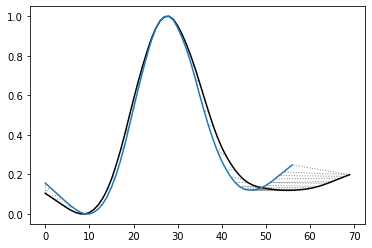

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.417960853765276


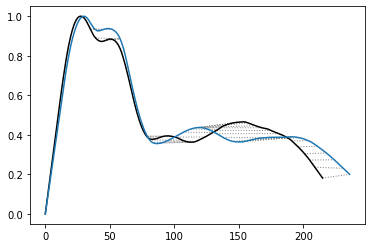

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.548108039473648


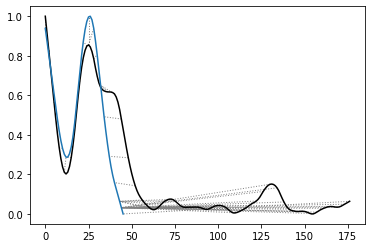

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.639340642170461


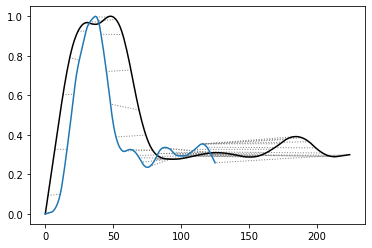

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.987364688868875


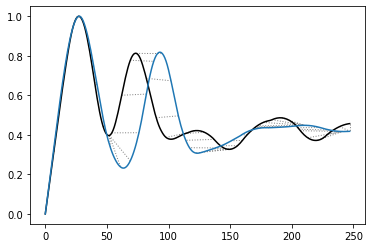

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.2568692398297758


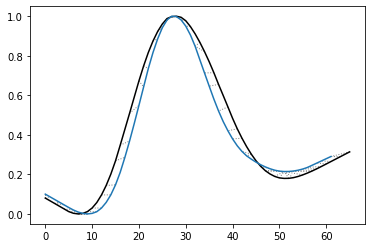

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.740377578112832


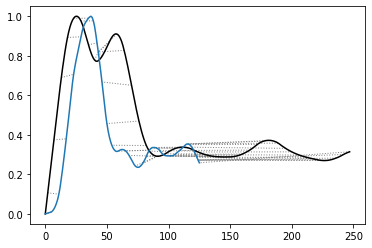

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.19964281126292


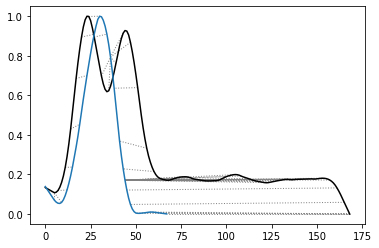

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.2538675759901565


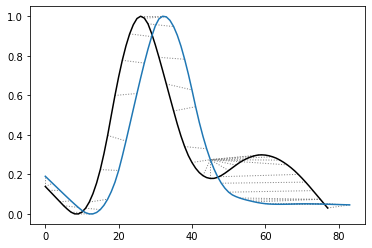

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.4110649983314385


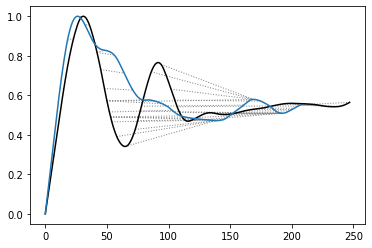

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.407024303729069


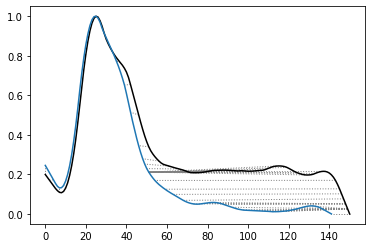

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.413869922124493


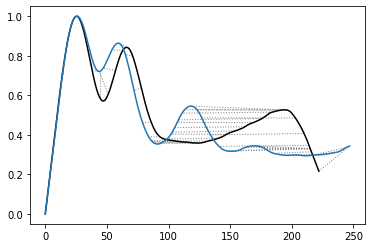

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.857387909383576


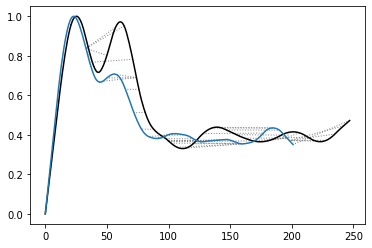

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.4329848434376995


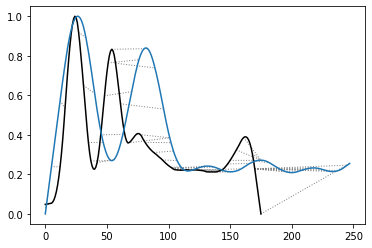

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3218383174102115


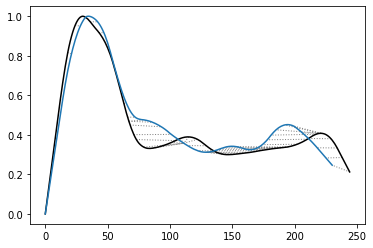

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.4439120786027155


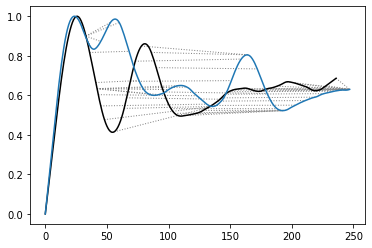

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.996892555663179


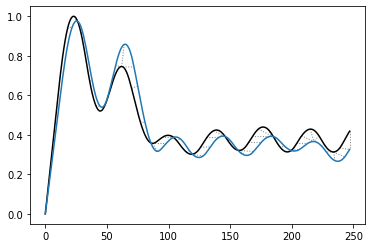

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7271479924221658


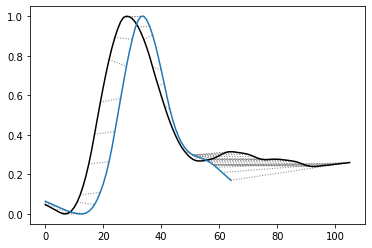

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.6381587752949054


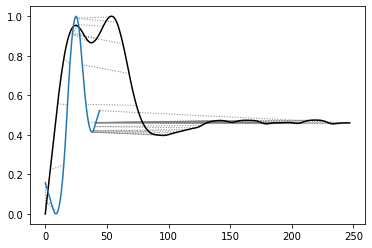

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5777587515394915


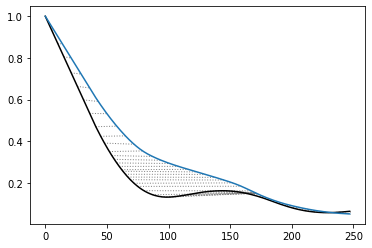

-----------------------------------------------------------------------------
p3_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.678734625282008


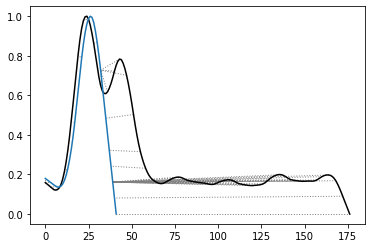

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  10.339253438844787


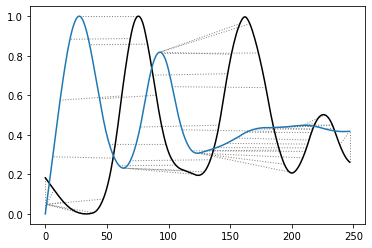

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.499783034613148


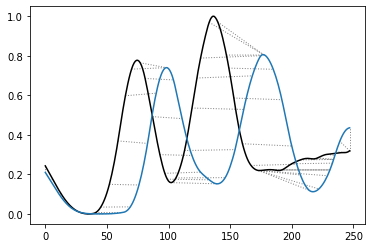

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.848184307690475


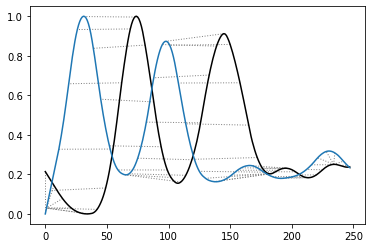

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  8.247844629267721


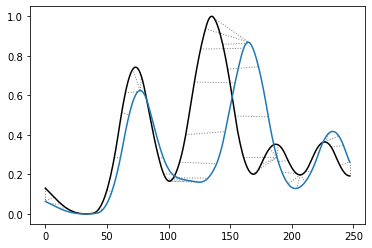

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.8034640281633543


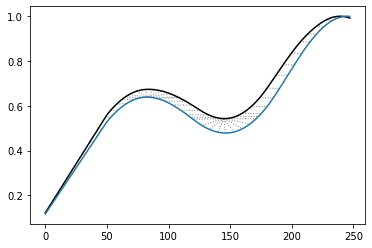

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.643817141547783


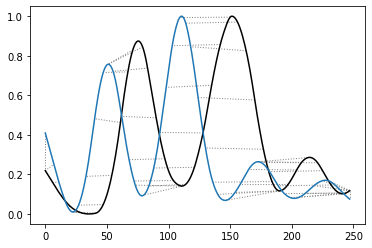

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8193999994006356


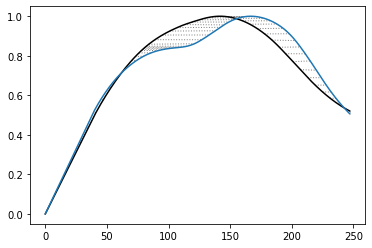

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.007259830697957


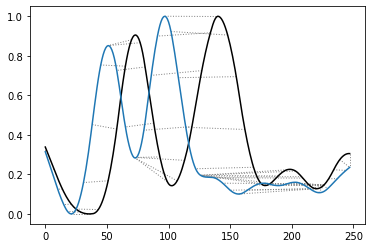

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8311661579116637


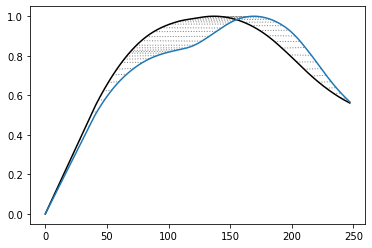

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  9.882038002258206


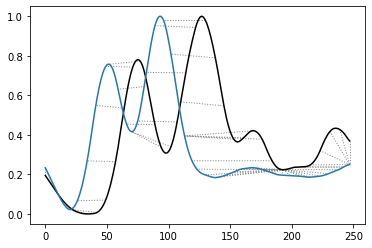

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  9.208860998056744


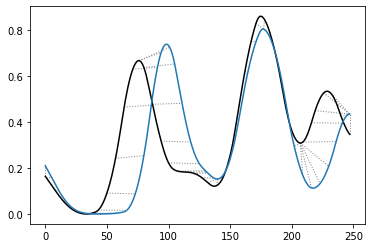

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.238502105470434


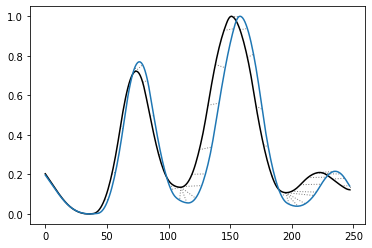

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.7809602849587979


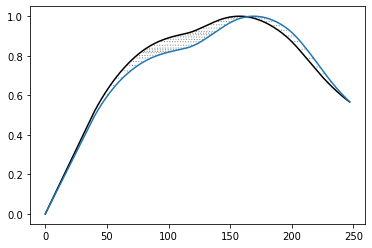

-----------------------------------------------------------------------------
p3_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.858509117851209


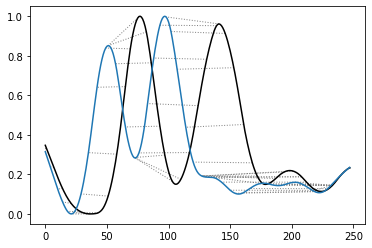

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.585316154687319


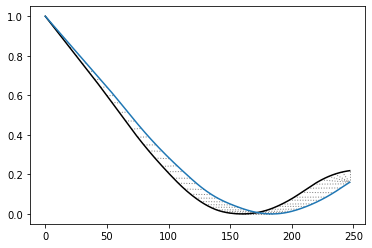

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.530895194618074


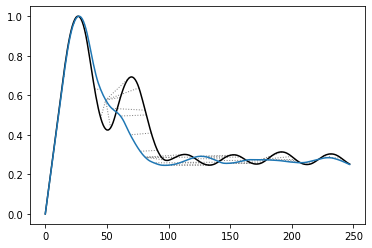

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0499639297130243


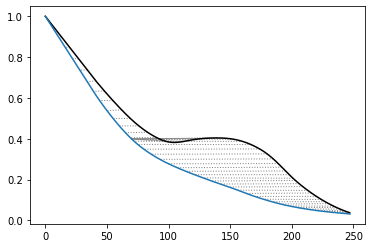

-----------------------------------------------------------------------------
p3_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.156457895081248


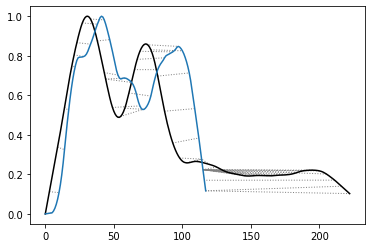

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.8236757606613807


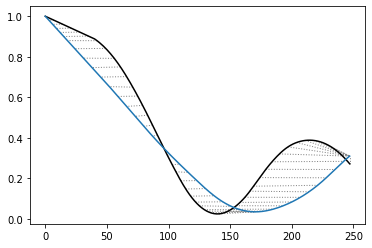

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.756376526460577


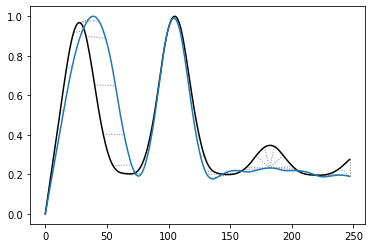

-----------------------------------------------------------------------------
p3_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.007001427828613


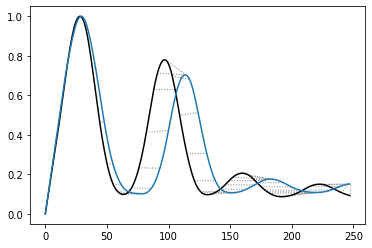

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.7351692462387073


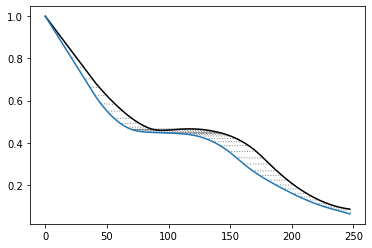

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5727582549624791


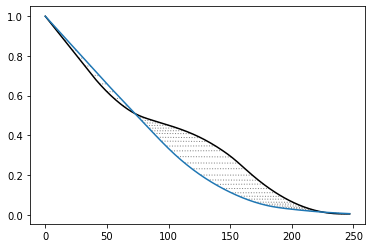

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.5096521066340624


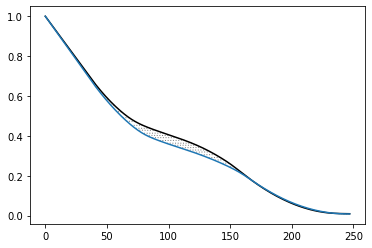

-----------------------------------------------------------------------------
p3_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.300658496430257


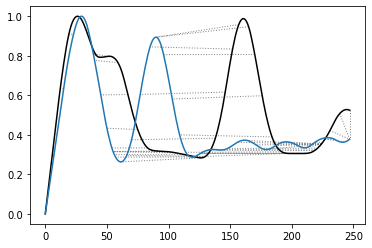

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.9123439853392576


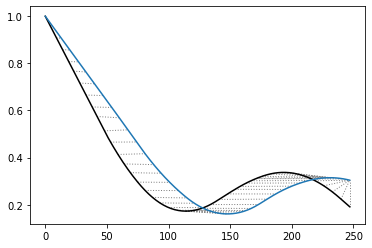

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.6422304096479614


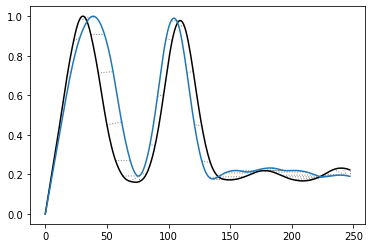

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6171837778590856


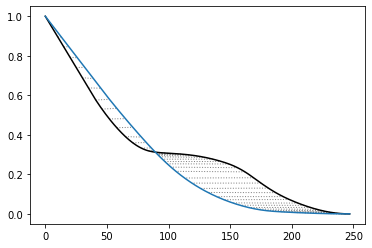

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.958956817819697


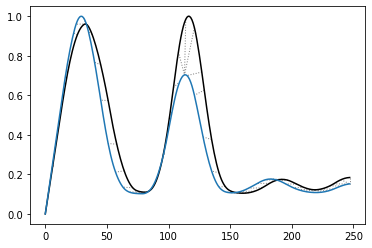

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.851367704137095


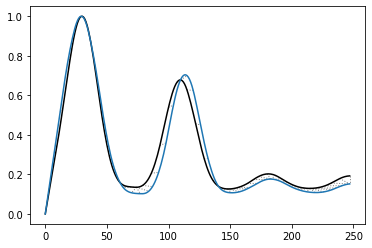

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6639114652760078


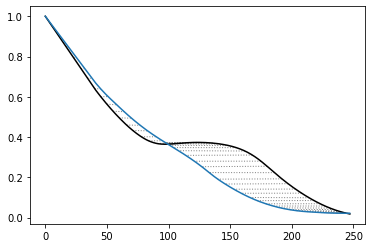

-----------------------------------------------------------------------------
p3_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.486672055220074


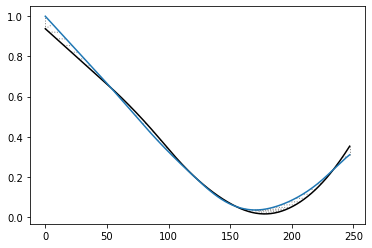

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.2163723307457364


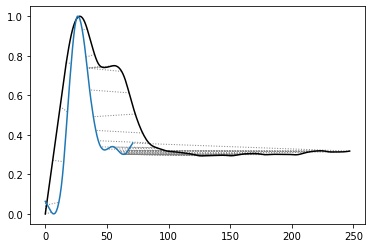

-----------------------------------------------------------------------------
p3_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.0538378025604493


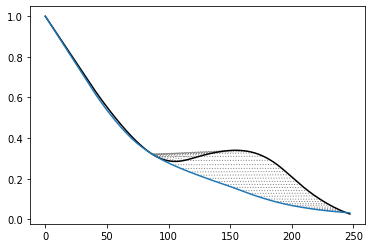

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.638726759885892


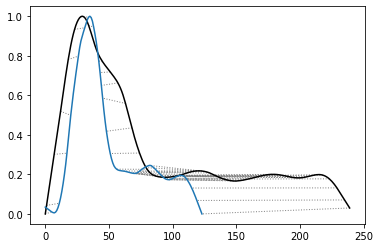

-----------------------------------------------------------------------------
p3_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7943353953256893


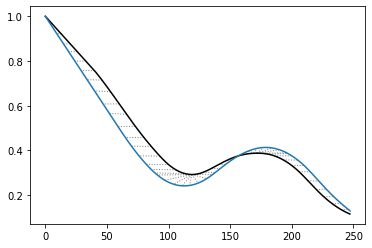

-----------------------------------------------------------------------------
p3_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7348125119163664


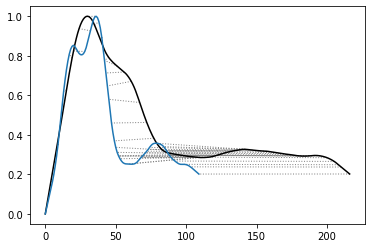

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.819935925627591


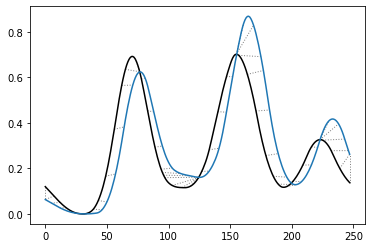

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8794361666820703


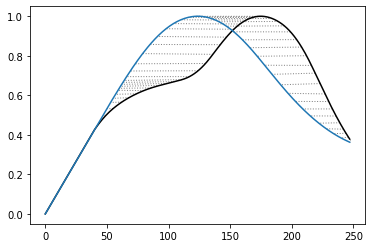

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.968858339964315


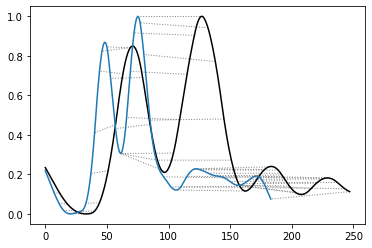

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.9562521733337643


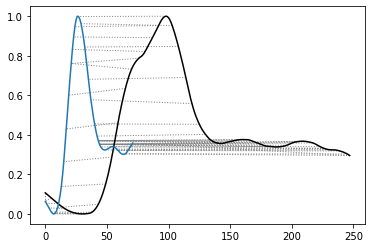

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.084298026276905


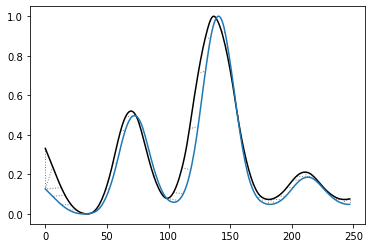

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.6437866067871227


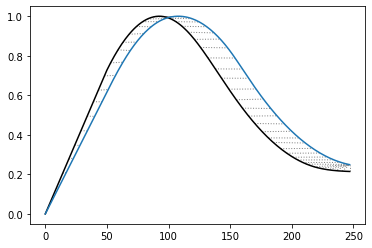

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.0257223703466112


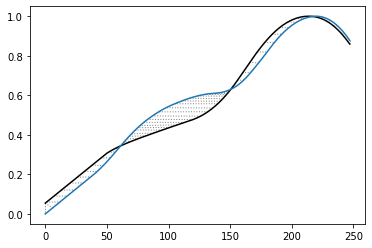

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.140344845908787


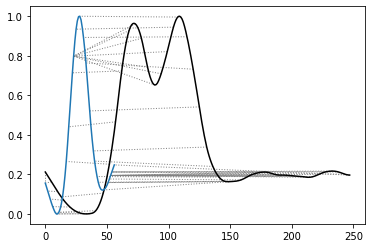

-----------------------------------------------------------------------------
p3_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.173091942898513


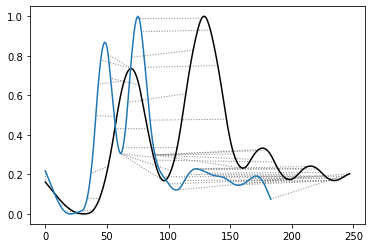

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.401162548745399


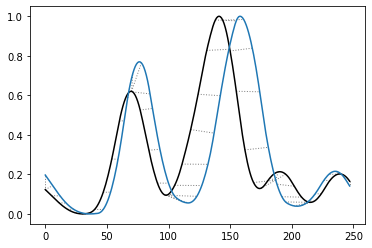

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  7.223970395598391


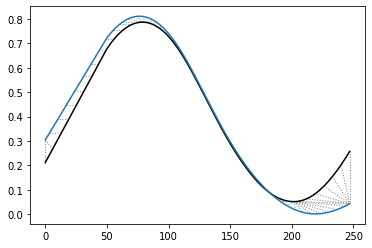

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.287197008649594


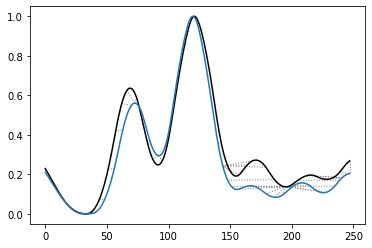

-----------------------------------------------------------------------------
p3_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.7488640592910566


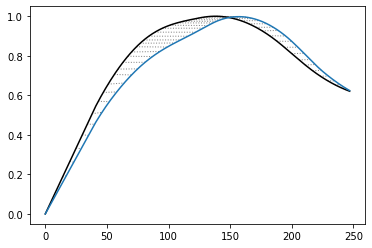

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.219394544727772


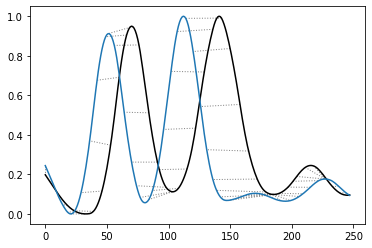

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  8.328571917285991


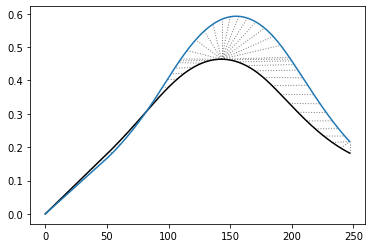

-----------------------------------------------------------------------------
p3_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.352144773441045


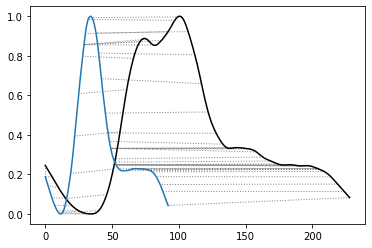

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.8284013147744216


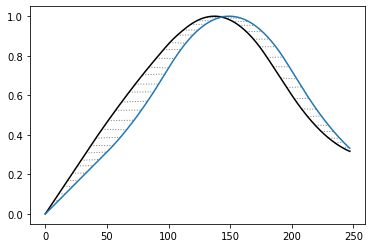

-----------------------------------------------------------------------------
p3_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8443120434027569


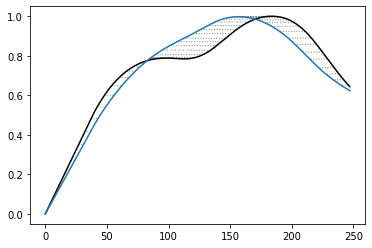

-----------------------------------------------------------------------------
p3_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  10.180045462838343


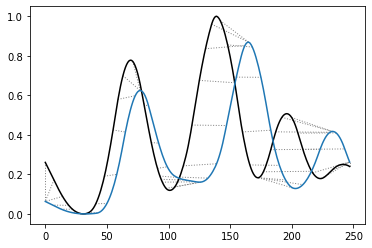

-----------------------------------------------------------------------------
p3_ResNet50_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.170488240882252


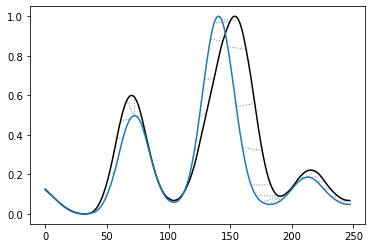

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.335569588027648


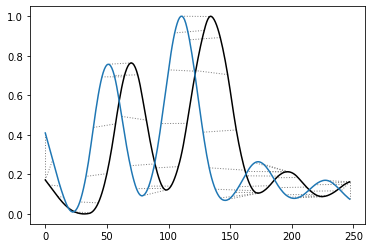

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.014810206380272


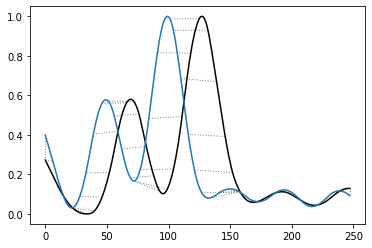

-----------------------------------------------------------------------------
p3_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.2186870910059


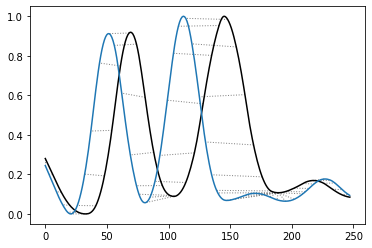

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.21775529474217


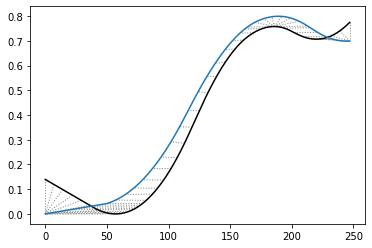

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.154973272978771


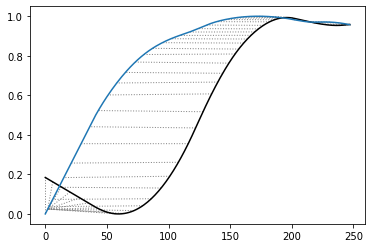

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.761846621047872


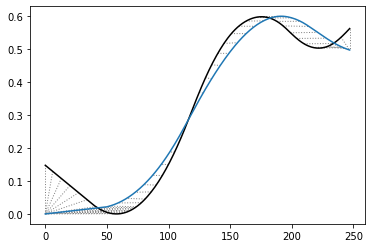

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.727546567037624


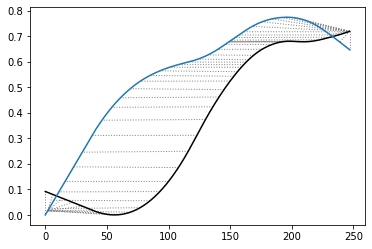

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.772703592127294


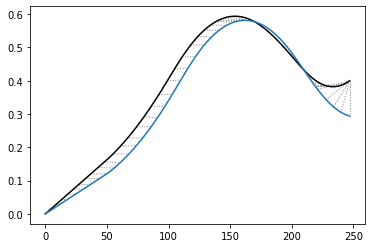

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.032150006056715


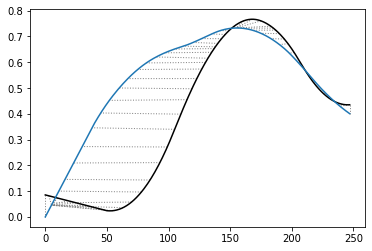

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8759383058358975


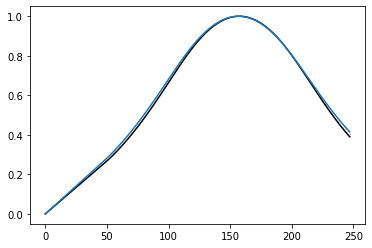

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.391182899916444


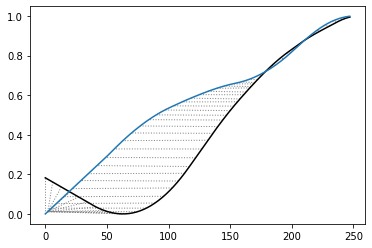

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5812873405328648


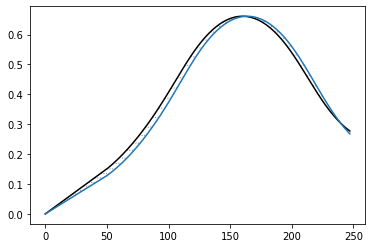

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.231472181918233


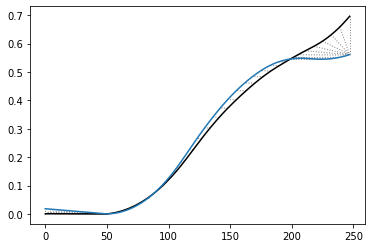

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.580040739085388


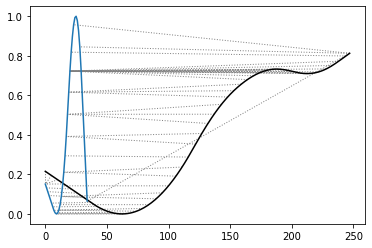

-----------------------------------------------------------------------------
p3_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.826720860390921


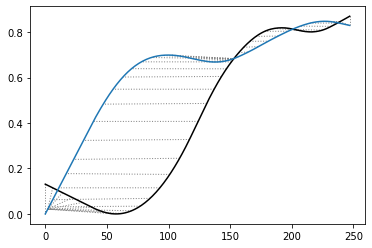

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3166853031829824


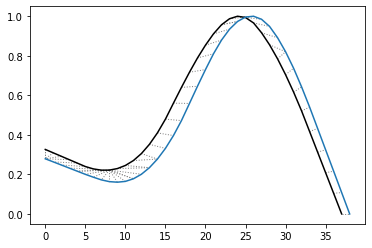

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.6337138887596745


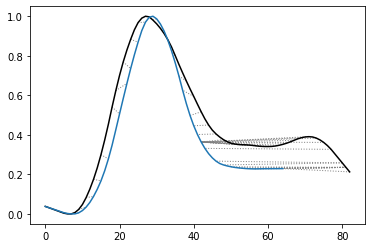

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.149305778287204


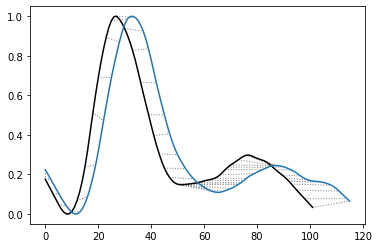

-----------------------------------------------------------------------------
p3_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4193192381369677


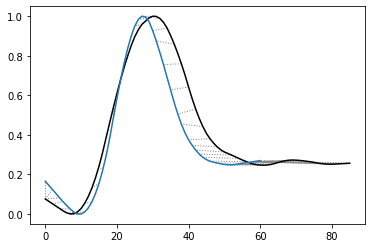

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7616584217071138


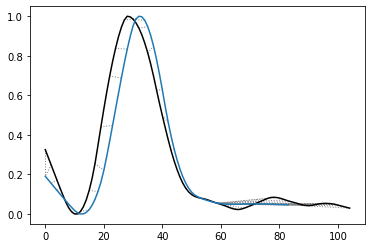

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.1372359308934348


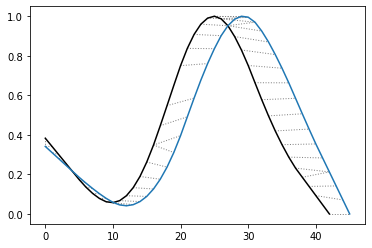

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.2395685830424465


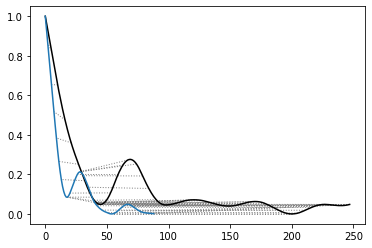

-----------------------------------------------------------------------------
p3_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.53160771874793


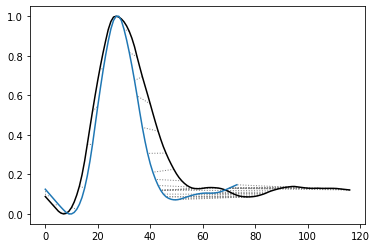

-----------------------------------------------------------------------------
p3_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  12.419333770181966


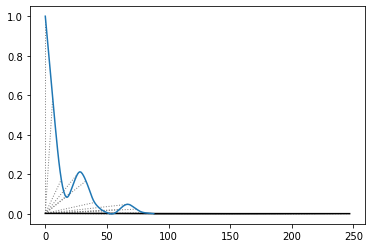

-----------------------------------------------------------------------------
p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4595053500239077


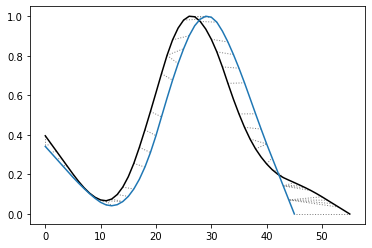

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7282894645162077


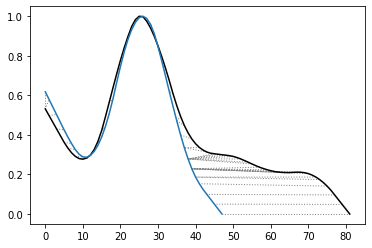

-----------------------------------------------------------------------------
p3_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.7590724996965081


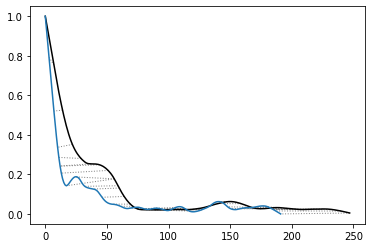

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9821441326168017


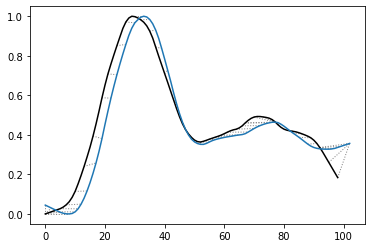

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9138687760807576


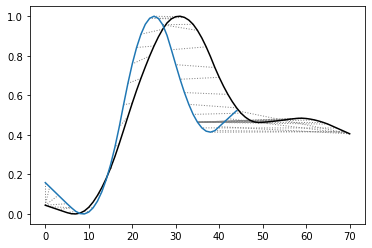

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8377767129127005


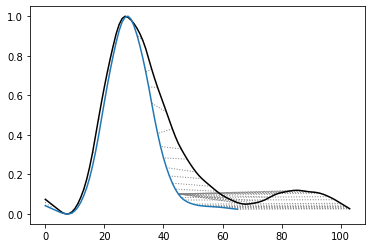

-----------------------------------------------------------------------------
p3_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.5920540564798773


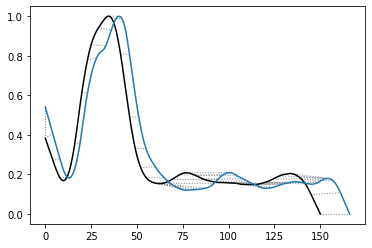

-----------------------------------------------------------------------------
p3_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0506814915738127


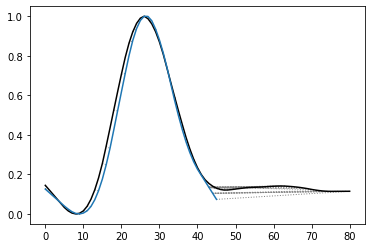

-----------------------------------------------------------------------------
p3_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.1548768454654637


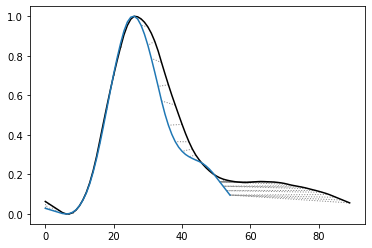

-----------------------------------------------------------------------------
p3_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.025361920988604


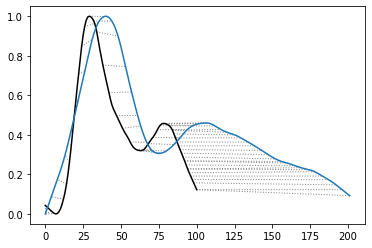

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.2926099032249945


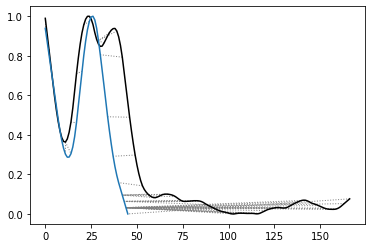

-----------------------------------------------------------------------------
p3_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.1560185784002903


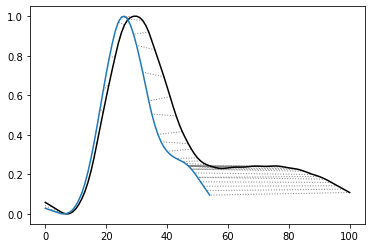

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.5790495379593117


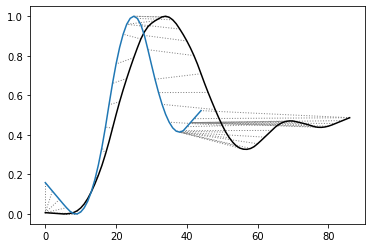

-----------------------------------------------------------------------------
p3_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.9448764537906702


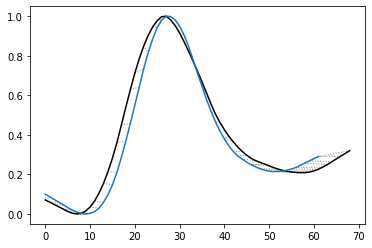

-----------------------------------------------------------------------------
p3_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.016219190488889


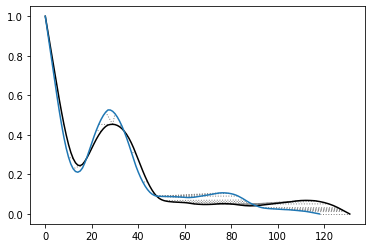

-----------------------------------------------------------------------------
p3_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.8536718032403723


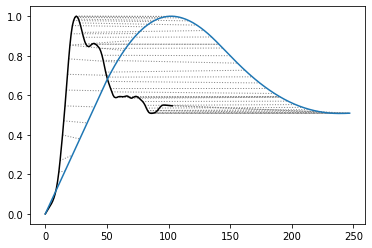

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.064121443355627


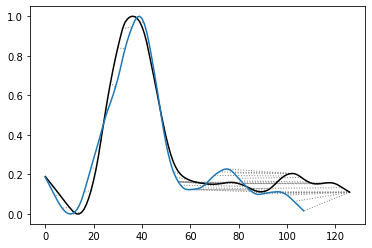

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.6649762936487782


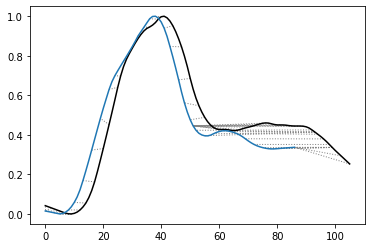

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.6406552285175195


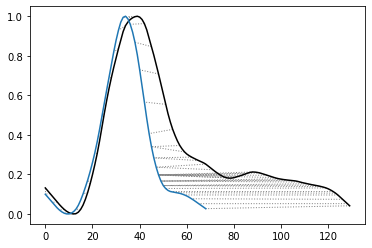

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.567507517650092


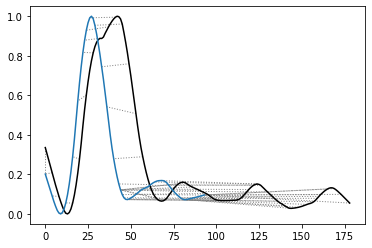

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.4061271627326757


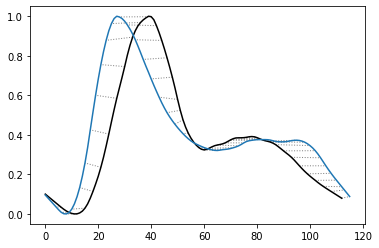

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.767860194704112


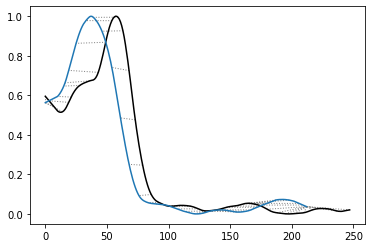

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.7880727658429736


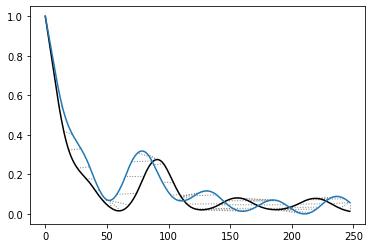

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3665234442281018


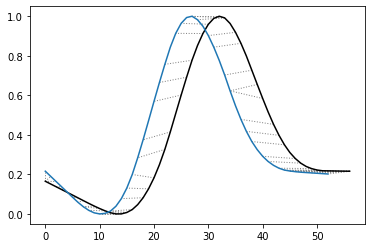

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.078266447748401


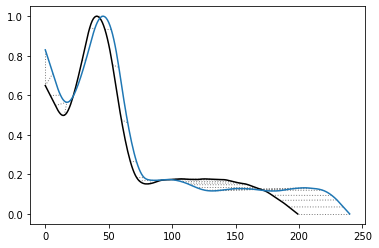

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8655874033683093


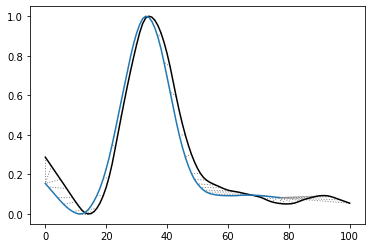

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.8400754711939973


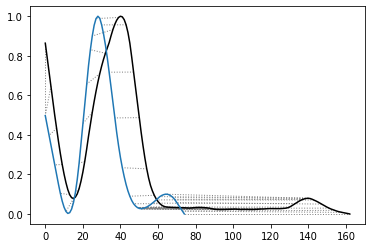

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3013358538122555


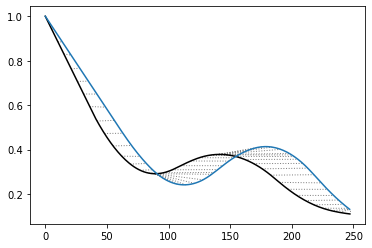

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5984533318530318


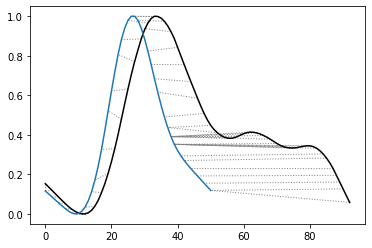

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.0997627927073945


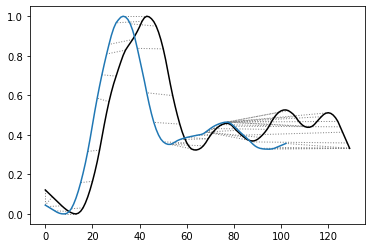

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.857298656736265


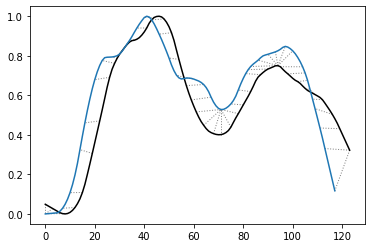

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.8940236125611711


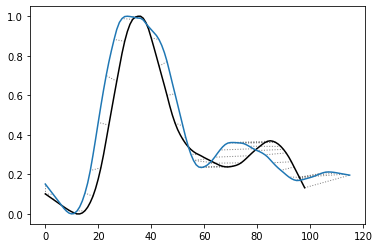

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.1183894040491698


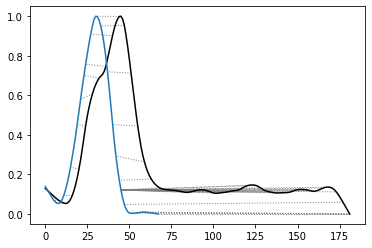

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  4.229886278467974


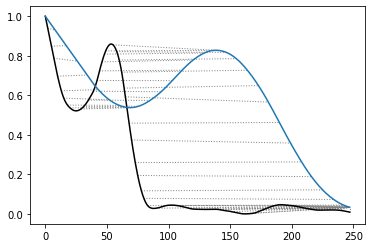

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.4748977393492544


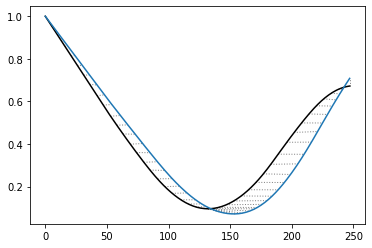

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.000544089820018


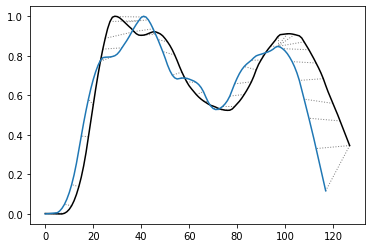

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.406487284009687


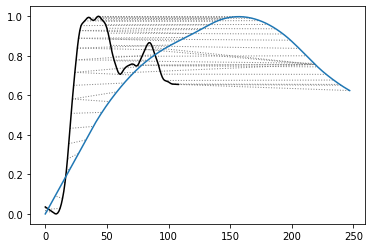

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3401804301033255


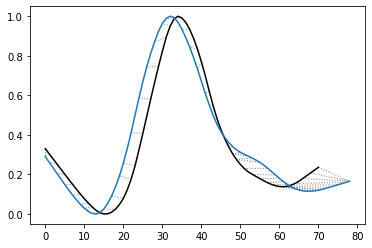

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.6863163344745


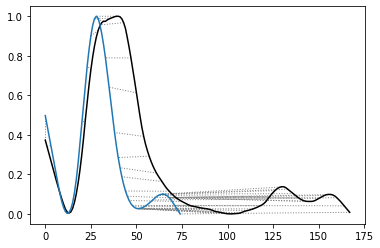

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9206785837217812


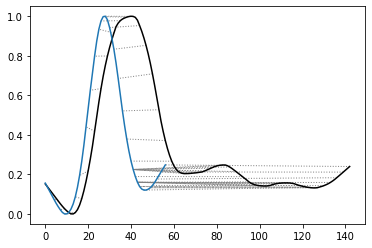

-----------------------------------------------------------------------------
p3_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5428405726455143


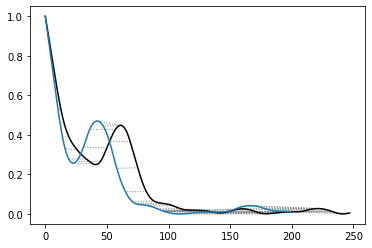

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.520277164609728


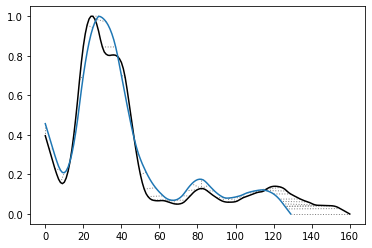

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.5178810219467223


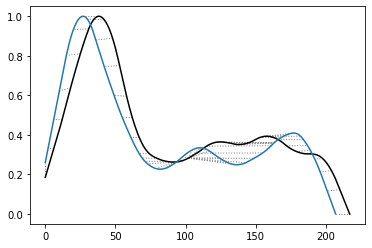

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9197427404390999


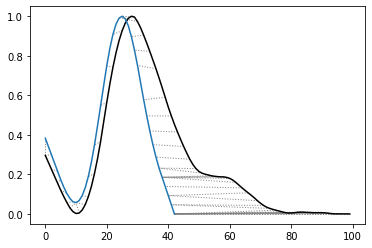

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9379866963161698


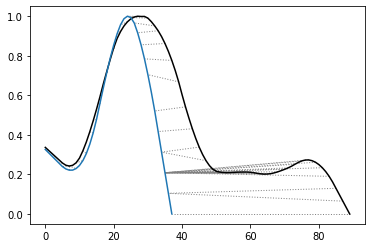

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9993188716074608


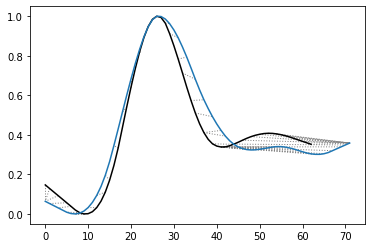

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7067573204049657


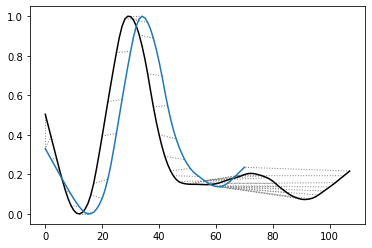

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.360327502020137


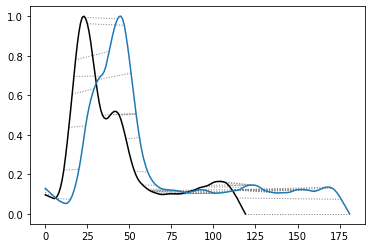

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.98880409023808


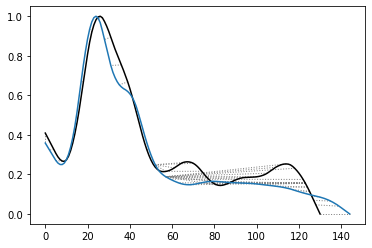

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7929575928173602


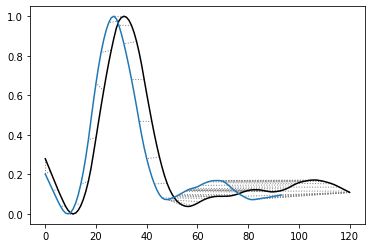

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  4.393262781017183


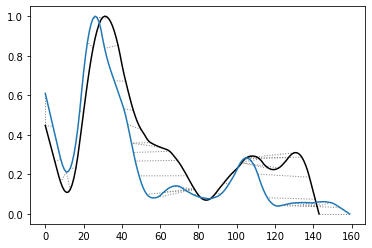

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.05947784618624


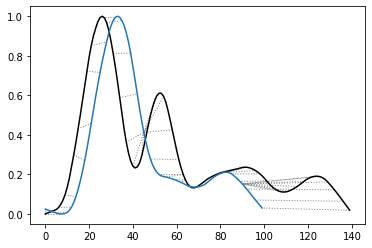

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.458180665663044


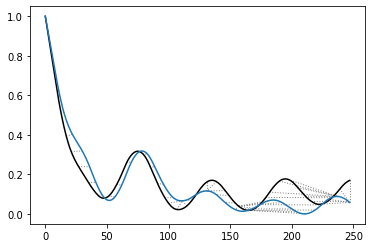

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.419081097440986


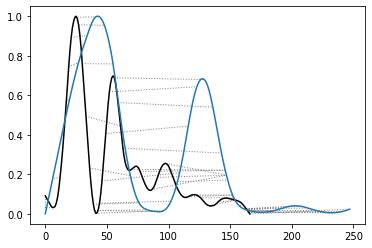

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.7590724996965081


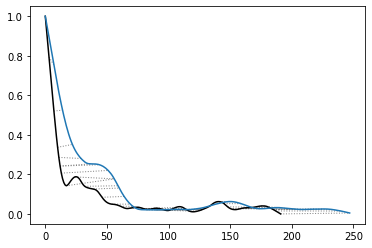

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3675295844688249


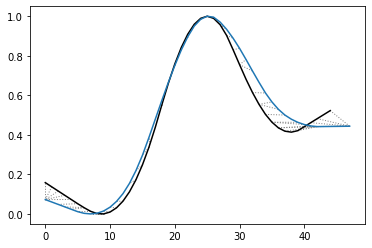

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8394458756491208


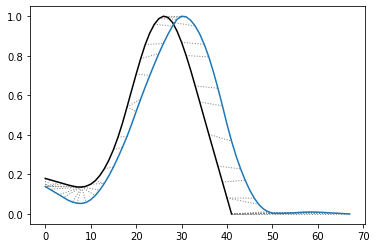

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8938006314423983


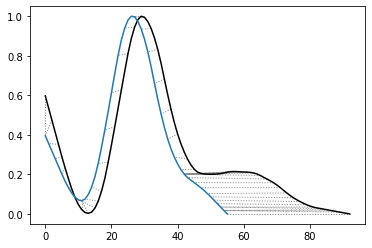

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.2948754584345927


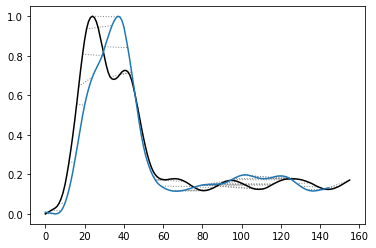

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.883212588186565


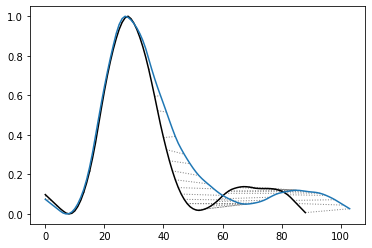

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.685066452807517


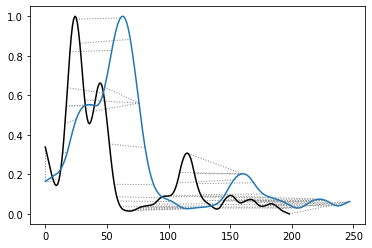

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.1038232197172215


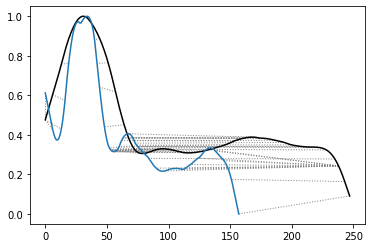

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.7045963748477545


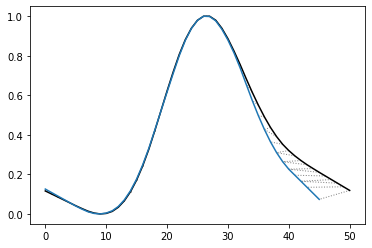

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.0826562198493805


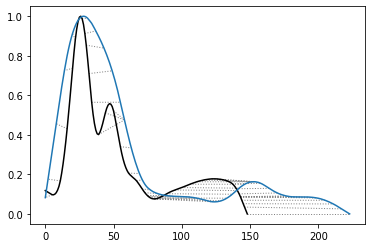

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.232921175818832


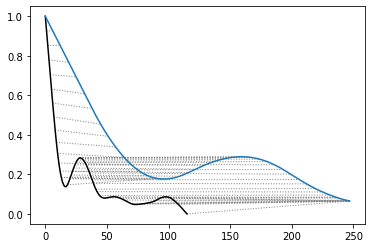

-----------------------------------------------------------------------------
g5_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.039100417500552


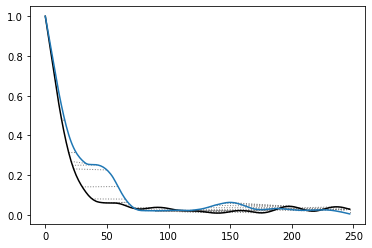

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.44141622059354


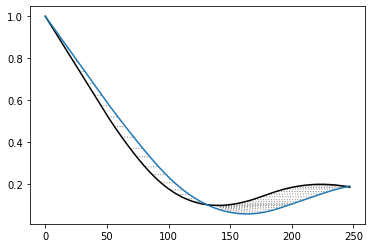

-----------------------------------------------------------------------------
g5_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.4737409425654229


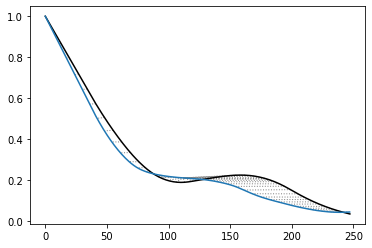

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.9604251100950096


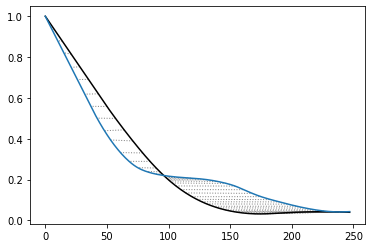

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0073564789720653


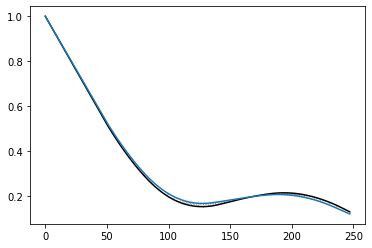

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.1393439671199115


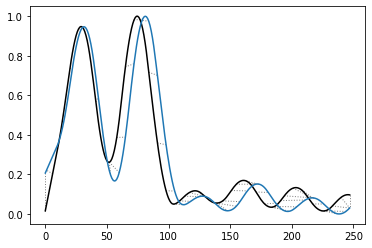

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.104133855132192


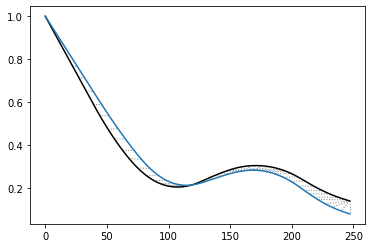

-----------------------------------------------------------------------------
g5_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2067217383655775


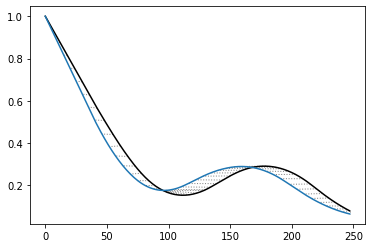

-----------------------------------------------------------------------------
g5_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.042603231611557


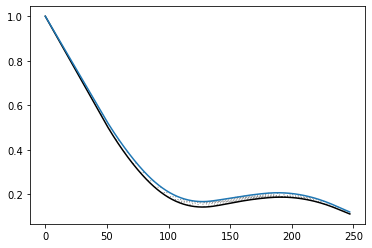

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.8881904973413688


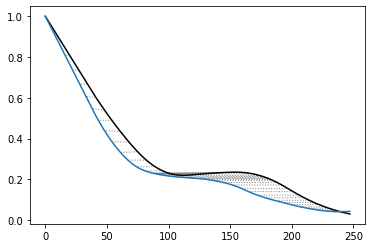

-----------------------------------------------------------------------------
g5_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3566063465323301


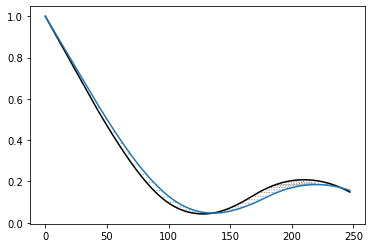

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  4.074945224406666


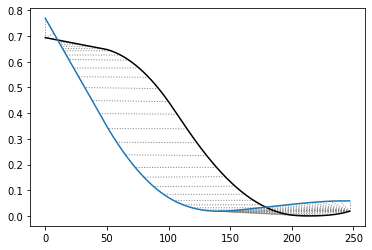

-----------------------------------------------------------------------------
g5_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.693717278073011


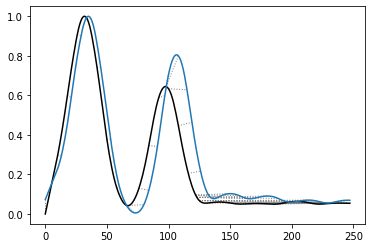

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.4748977393492544


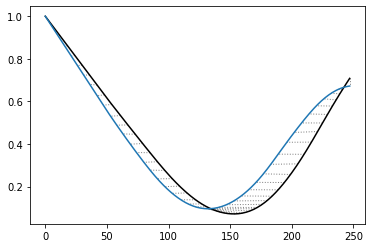

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.6069997837184915


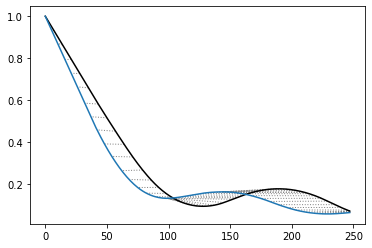

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.629372881530717


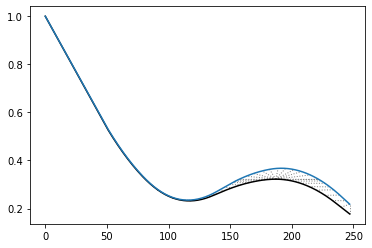

-----------------------------------------------------------------------------
g5_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7248160884893244


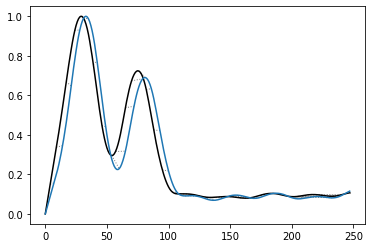

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.8452663715997226


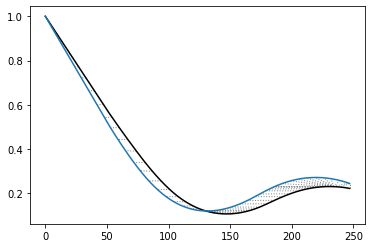

-----------------------------------------------------------------------------
g5_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.827912571890562


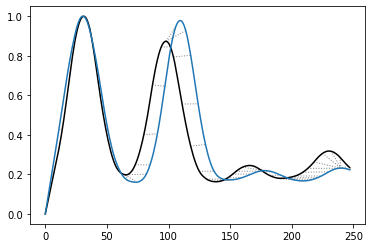

-----------------------------------------------------------------------------
g5_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.10567371281983


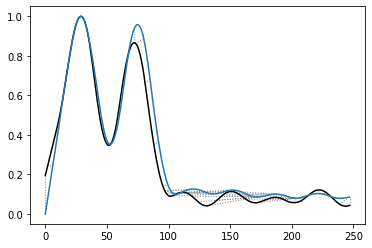

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.552520692024553


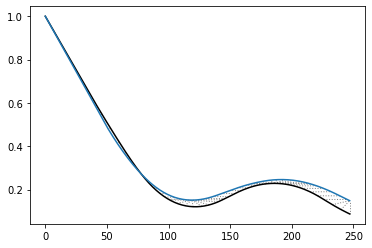

-----------------------------------------------------------------------------
g5_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.5562893201781347


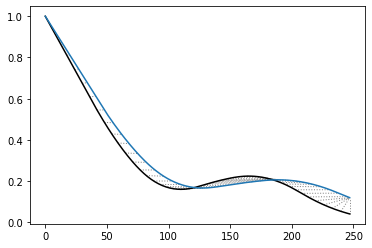

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  9.81944807130156


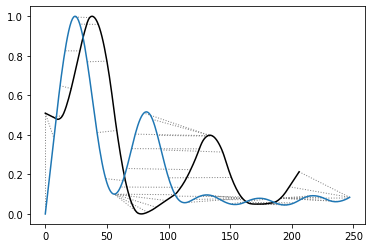

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.8534649420853215


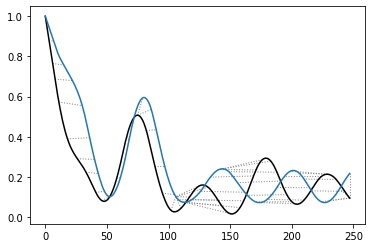

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.82496144962922


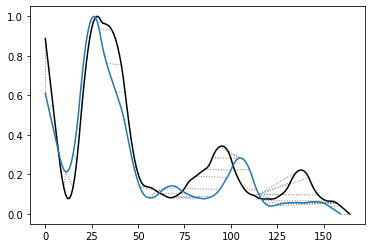

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.8727623956406103


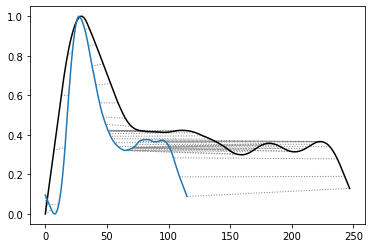

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.028115247626399


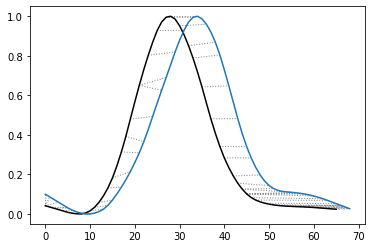

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.346347230485051


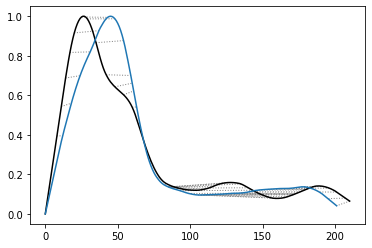

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.222798332975367


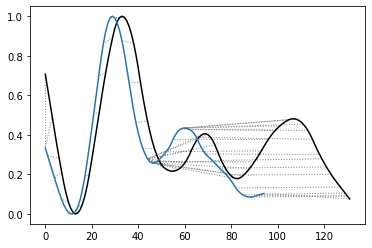

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.6361692603191718


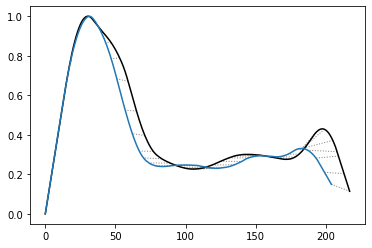

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3994088637609474


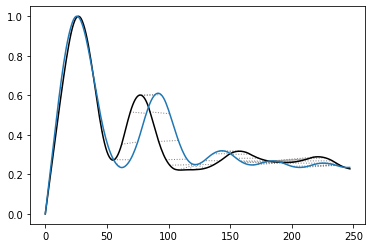

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4022671125510529


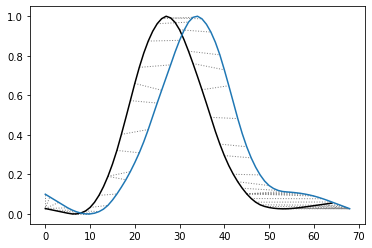

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.9041348156782743


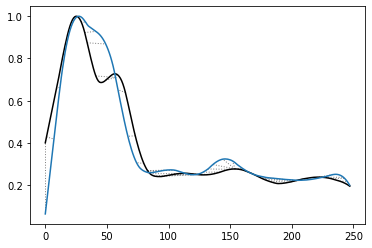

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.531030914551108


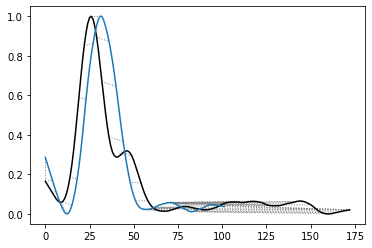

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3121116777527817


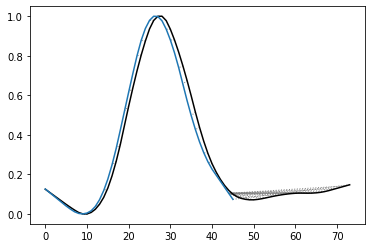

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.4335756034838125


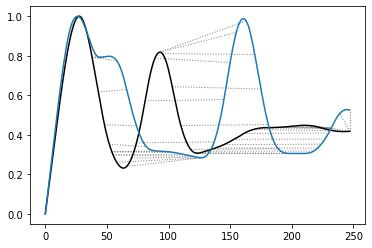

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.561103522181574


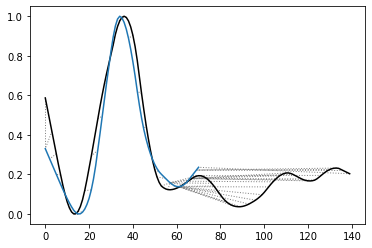

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.067306799648793


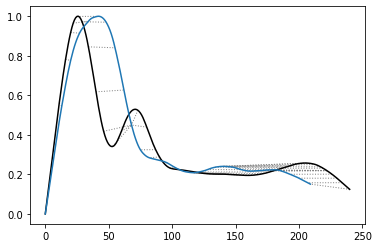

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7918611546885743


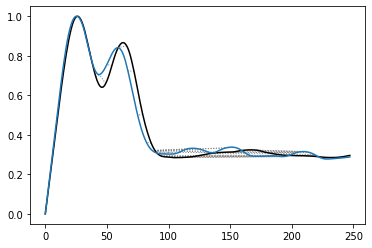

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.523105432570856


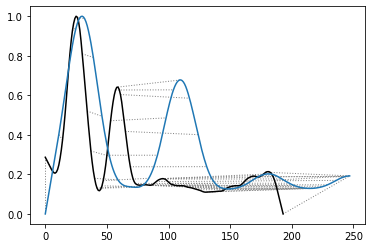

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.5857357045172527


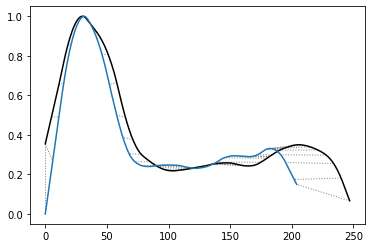

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.274447737675379


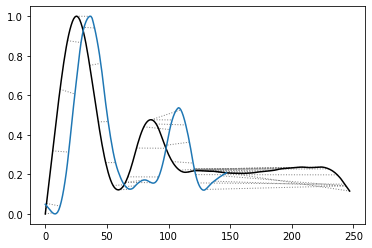

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.001966748033969


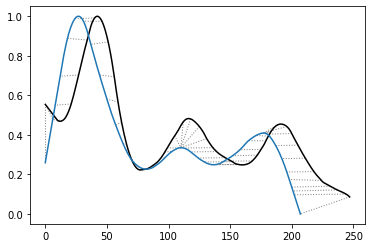

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.931420925827061


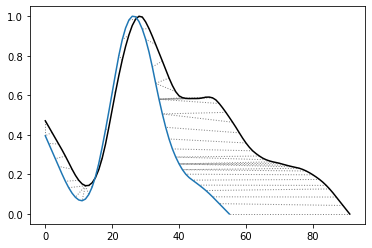

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.1959136496545915


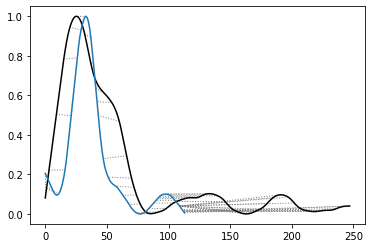

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.7145806792869256


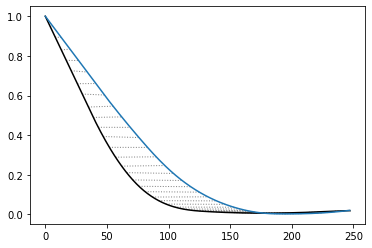

-----------------------------------------------------------------------------
g5_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.048951807107345


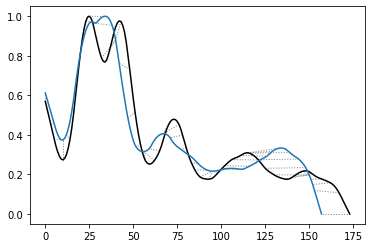

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.3868382183397285


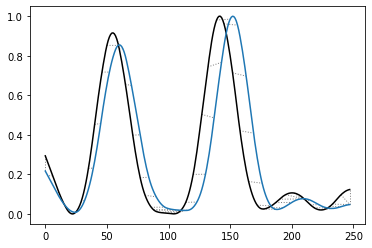

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.086486579167309


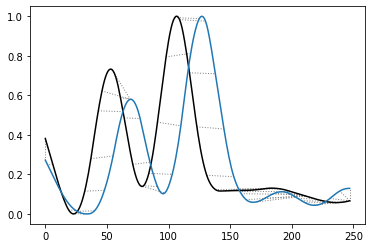

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.6201320040827945


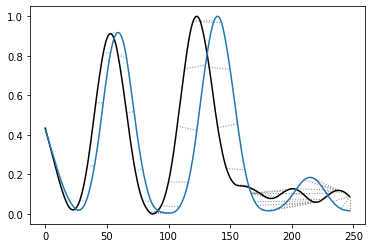

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.500856984365315


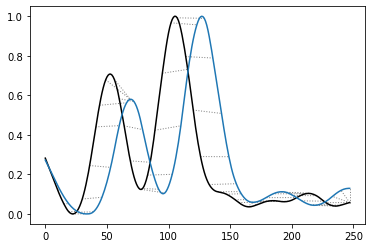

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  10.877909387525387


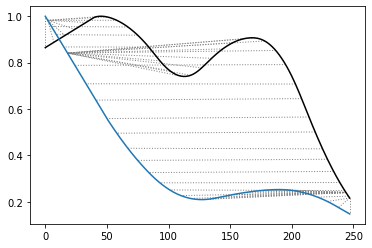

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.857867363558067


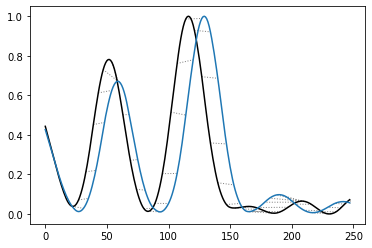

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.159220524913217


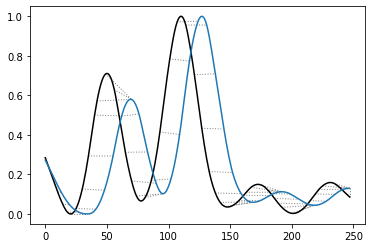

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.892812338157562


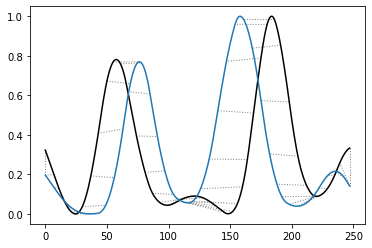

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.099249516377177


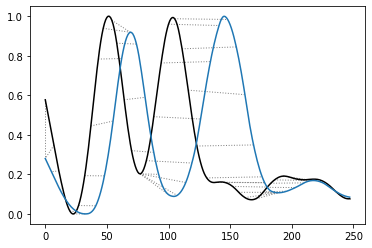

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.335569588027648


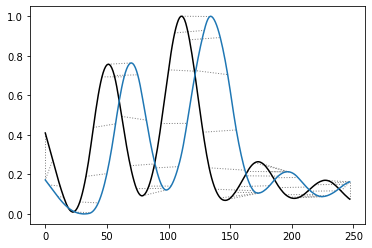

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.641048702305168


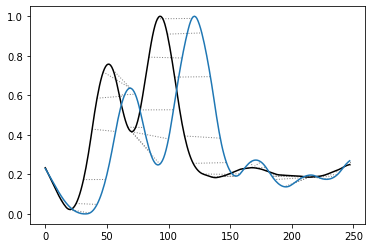

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.994528696430902


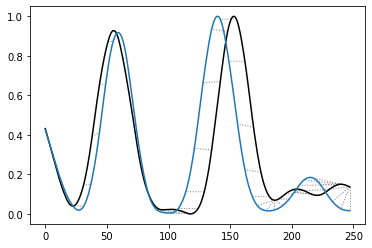

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.631580145737917


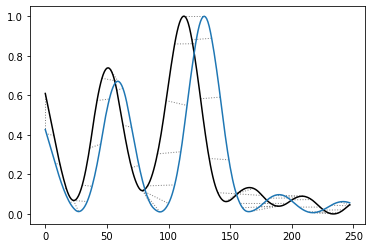

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  7.455433115513372


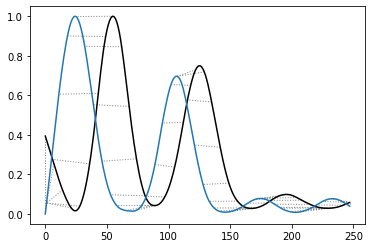

-----------------------------------------------------------------------------
g5_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.657119201652272


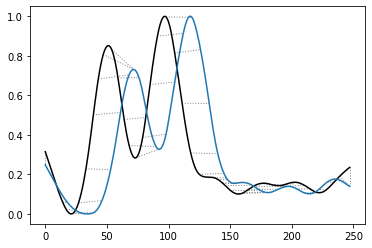

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.2243569539143266


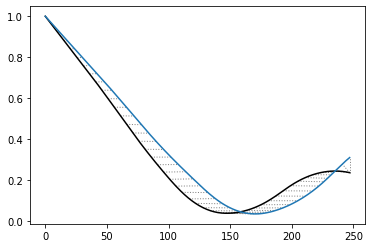

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  10.15886378053566


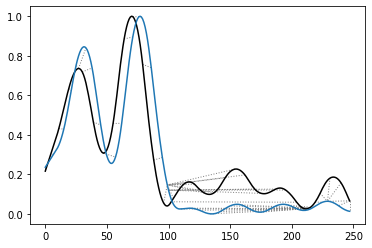

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.2197294562920866


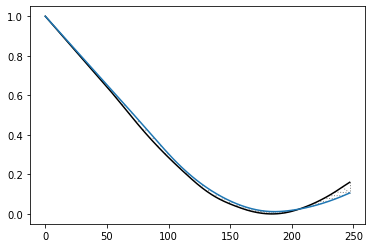

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.105774859862147


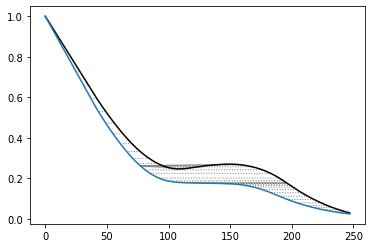

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.5749818003394136


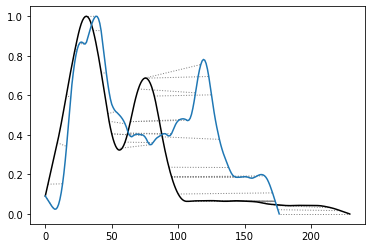

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3287704798122528


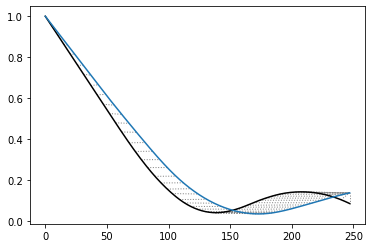

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.177451981935398


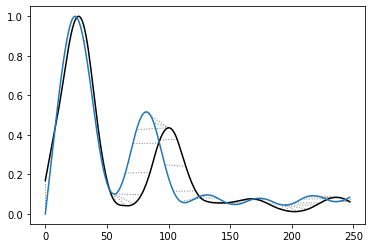

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.3184163404065554


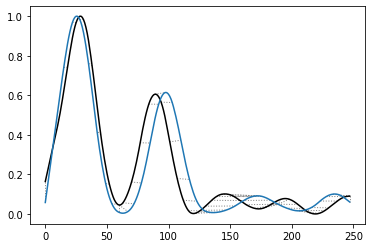

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6043767272517548


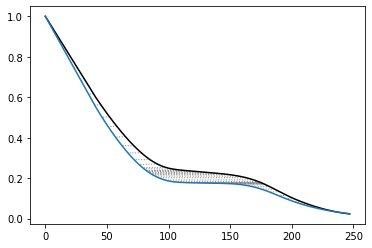

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5096521066340624


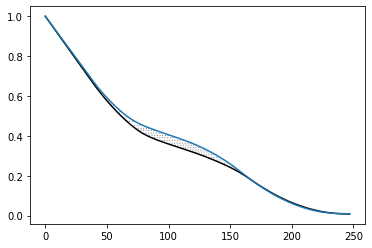

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6006523855117757


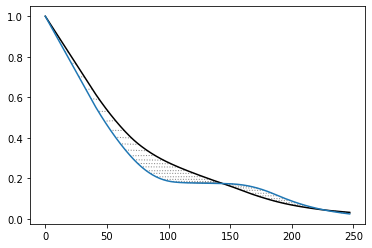

-----------------------------------------------------------------------------
g5_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.085454305719754


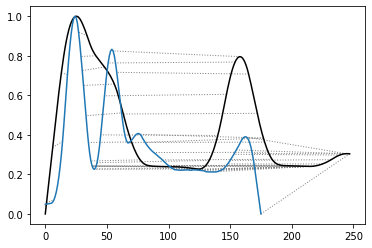

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.6407586115127293


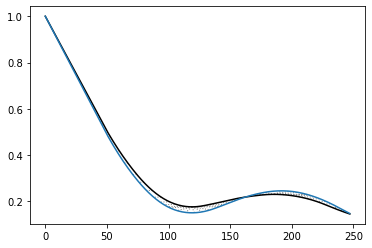

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.1727669743659215


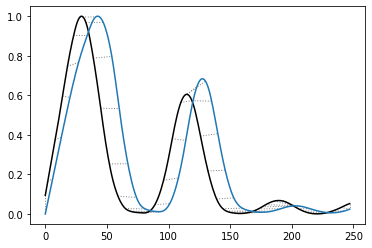

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6607407996862334


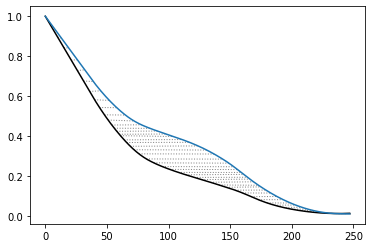

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.9916311236499786


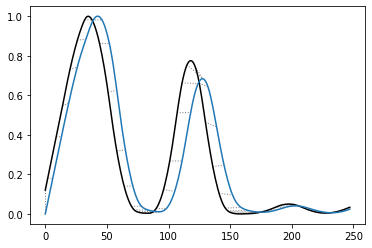

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3233414864473607


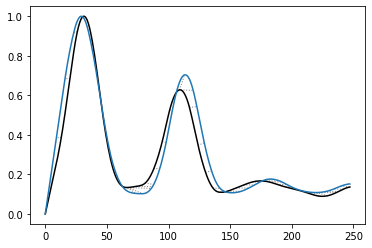

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6661179164149276


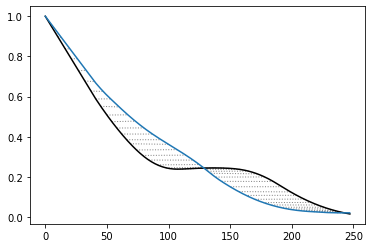

-----------------------------------------------------------------------------
g5_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.9259688773990064


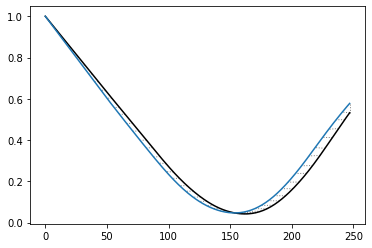

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.52160452575553


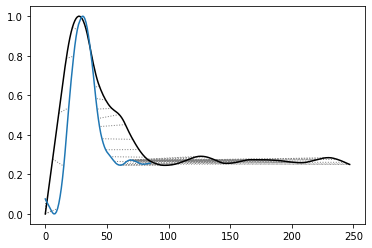

-----------------------------------------------------------------------------
g5_VGG19_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2300156526827708


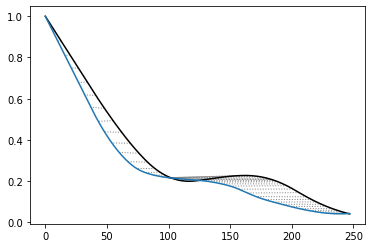

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.417960853765276


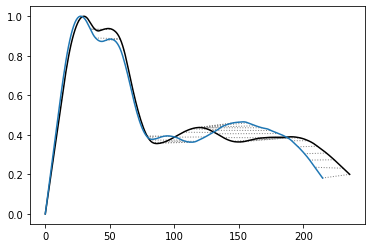

-----------------------------------------------------------------------------
g5_VGG19_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.2706243568915945


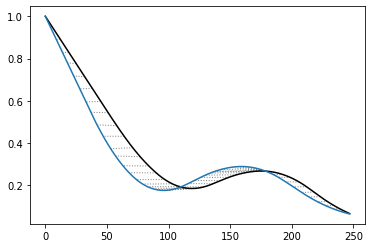

-----------------------------------------------------------------------------
g5_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.2367046210312633


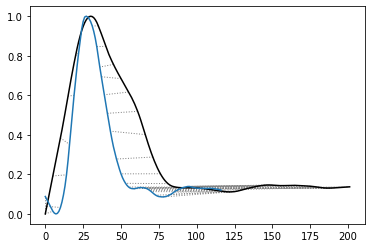

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.305959130070525


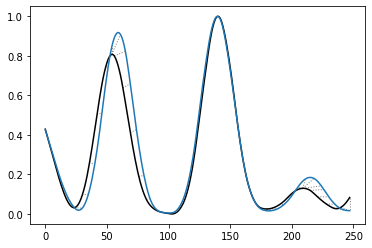

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3176006255349457


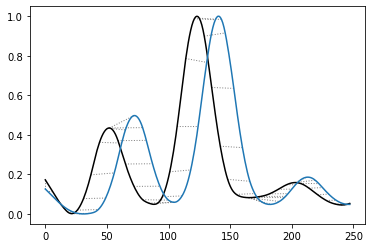

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.014810206380272


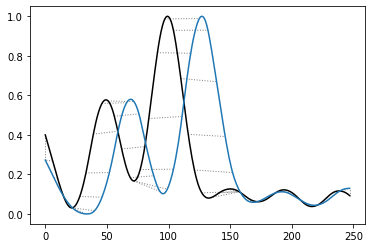

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.0830906906436883


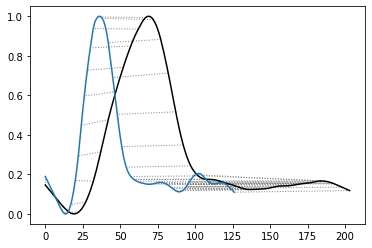

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.569804015884872


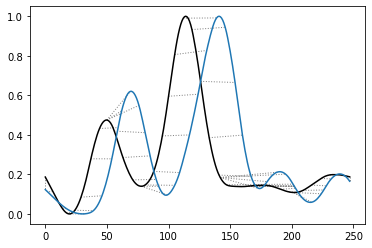

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.774586246951562


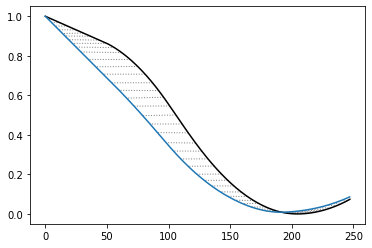

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  7.191726931981224


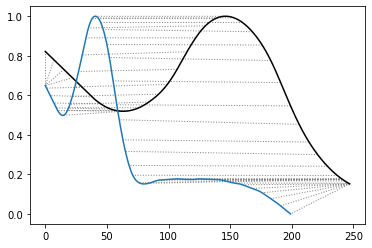

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.2161576124179585


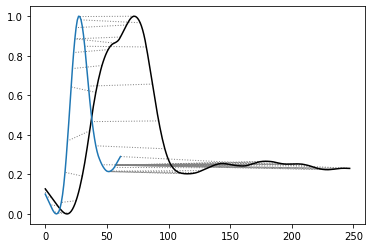

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.772393319097586


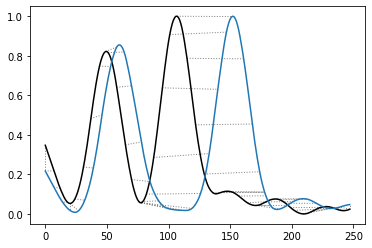

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.8960965591903545


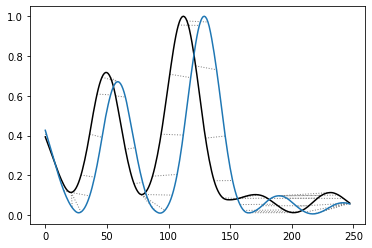

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.243217953100176


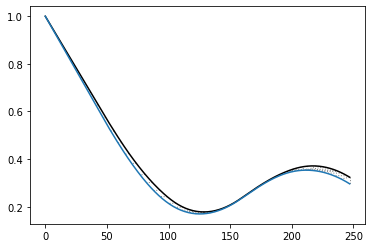

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.643059813567013


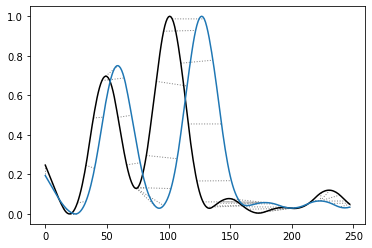

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  5.223090968474064


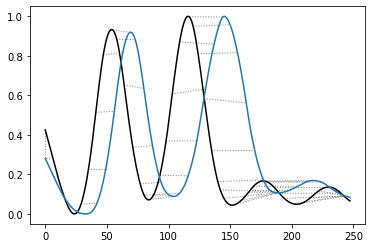

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.2186870910059


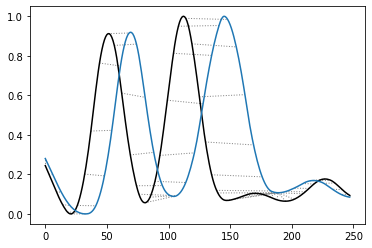

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.9725316154097876


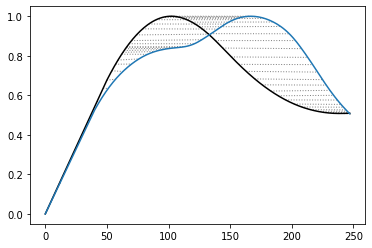

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.968858339964315


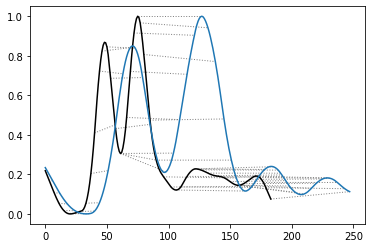

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.938619023084998


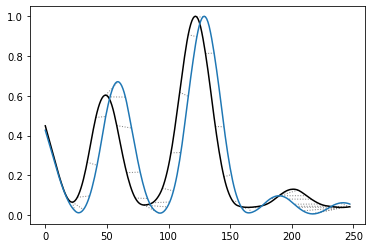

-----------------------------------------------------------------------------
g5_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.17308836995851


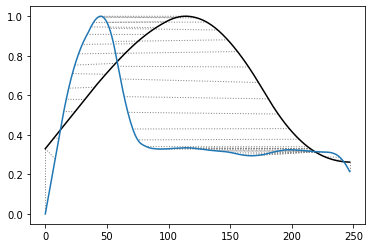

-----------------------------------------------------------------------------
g5_ResNet50_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.452250479044764


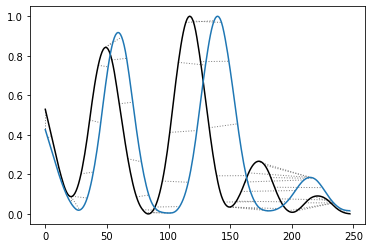

-----------------------------------------------------------------------------
g5_ResNet50_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.853620382040201


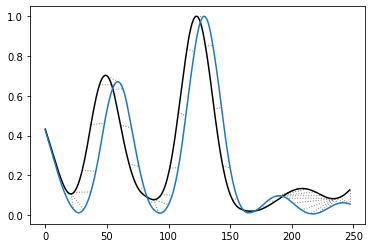

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.9614158793897927


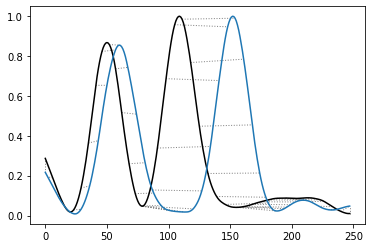

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.203911804225855


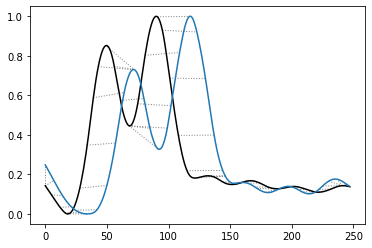

-----------------------------------------------------------------------------
g5_ResNet50_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  6.3867521201653465


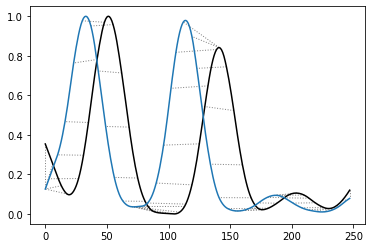

-----------------------------------------------------------------------------
g5_ResNet50_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.147101287968541


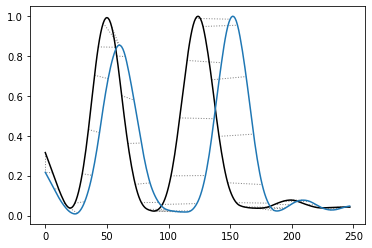

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.7236383099509487


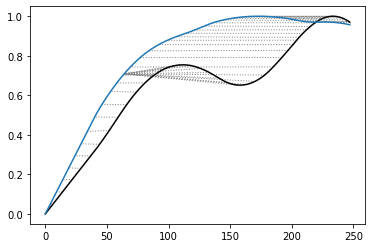

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.6453379997520265


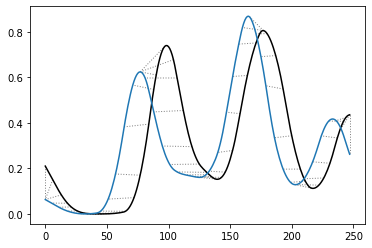

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.895076042691651


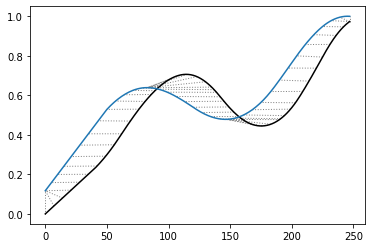

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5099084213688438


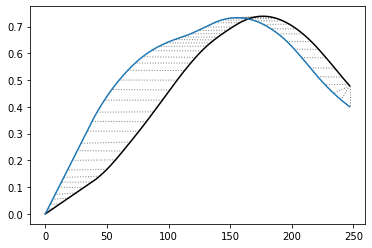

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8853425370692215


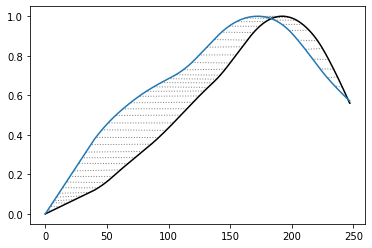

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.9126976513066816


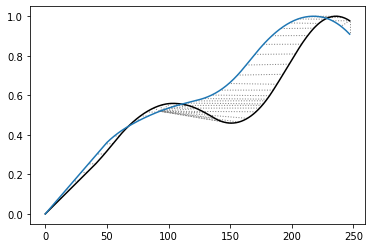

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.7327823161598661


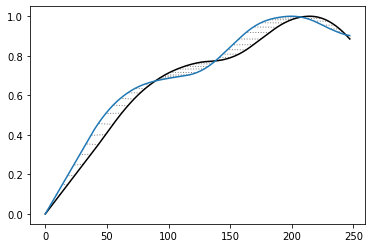

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0487971474776228


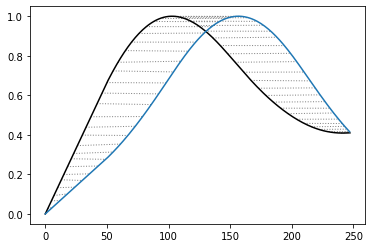

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  8.324893177664933


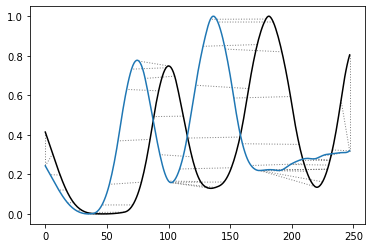

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4344831808242628


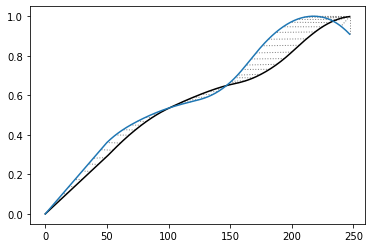

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.8765292517775356


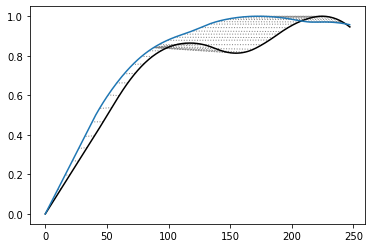

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionV3_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.0063250808138888


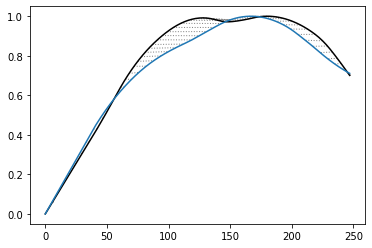

-----------------------------------------------------------------------------
g5_InceptionResNetV2_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6956656077785314


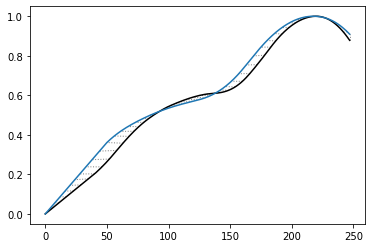

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3674354873881578


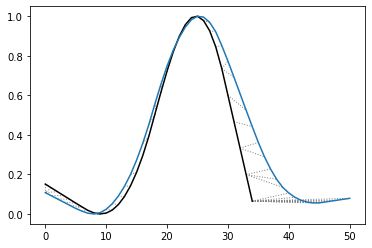

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.209171502931765


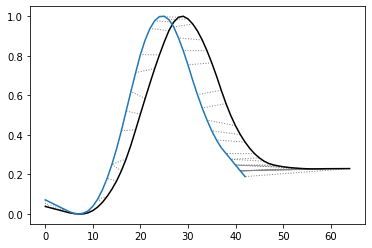

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.1614193667052115


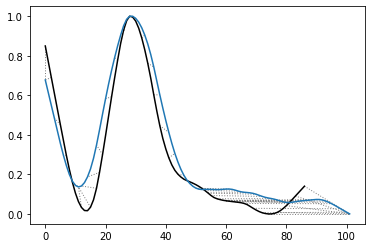

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.736766678770582


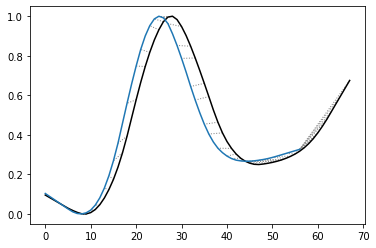

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.477414120625764


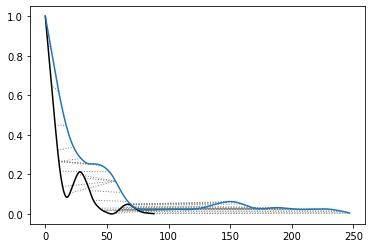

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3166853031829824


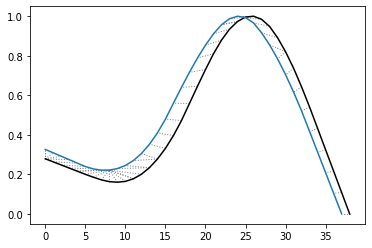

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.90072518195802


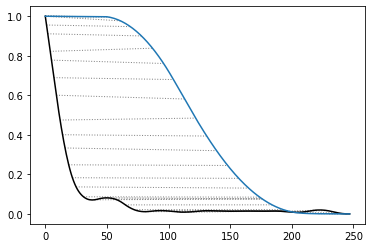

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.636483099714906


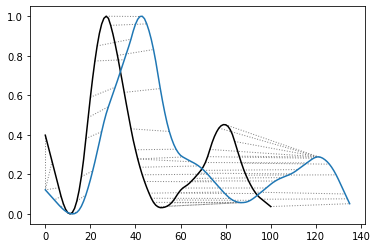

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6204653680673684


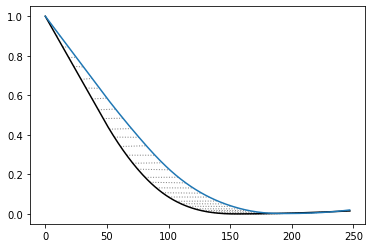

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.1429291564063897


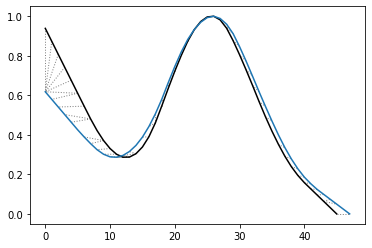

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.542622562109512


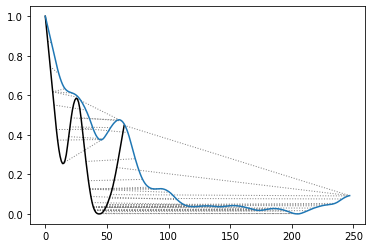

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.543749739383604


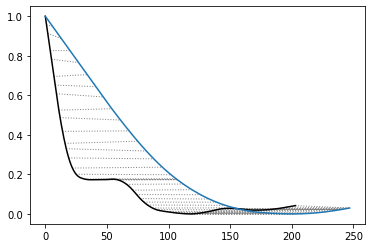

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5110746230264405


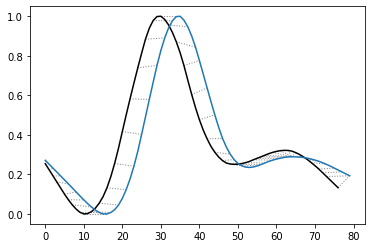

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3808502728240124


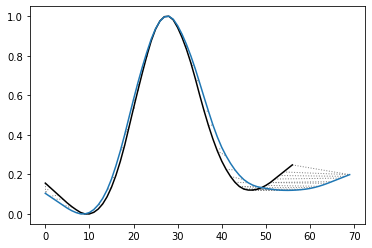

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.5218503624774438


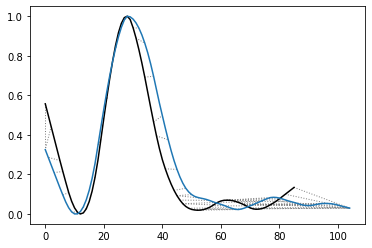

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.232775344384183


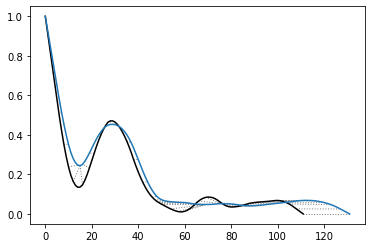

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.287216002857011


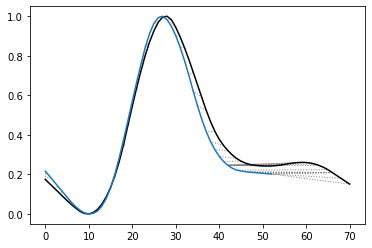

-----------------------------------------------------------------------------
g5_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.8170192926993327


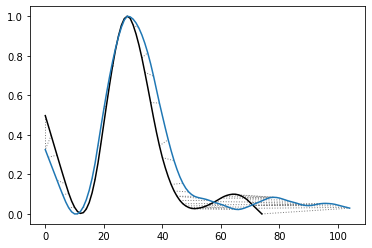

-----------------------------------------------------------------------------
g5_LeNet5_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.2294738425687033


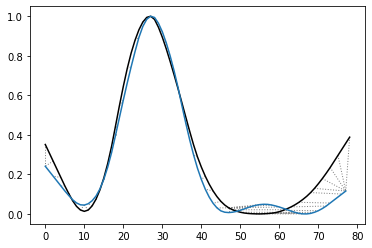

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.016219190488889


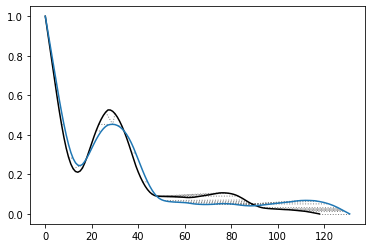

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9345734243157915


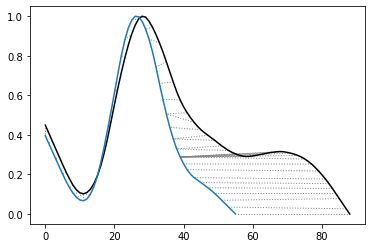

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3218801279007986


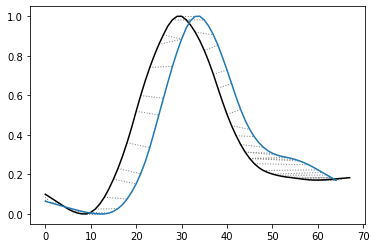

-----------------------------------------------------------------------------
g5_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.2648053196407036


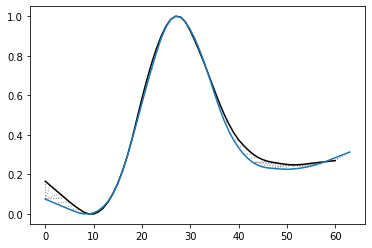

-----------------------------------------------------------------------------
g5_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.130455058246541


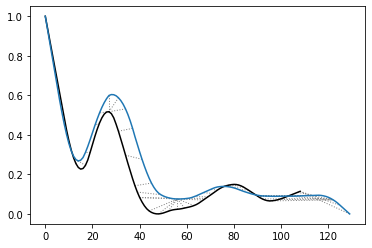

-----------------------------------------------------------------------------
g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.6006120253024343


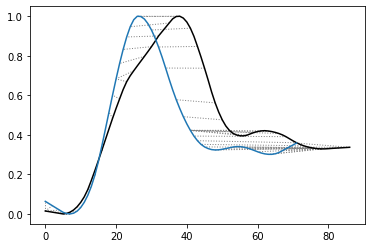

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.6208807392205042


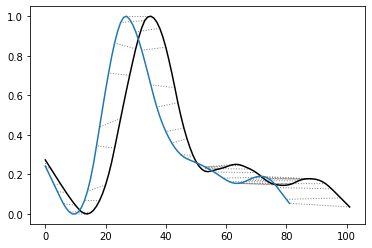

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4431302957591683


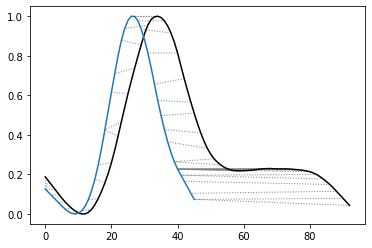

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7081795935863084


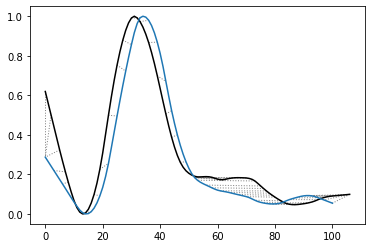

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.546698787754601


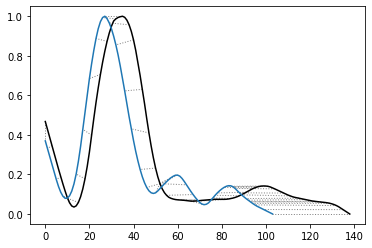

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.049387113992965


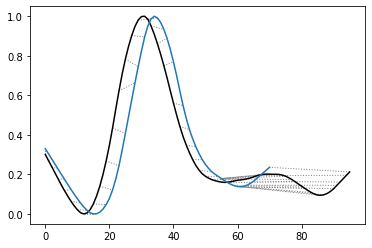

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.691193496849727


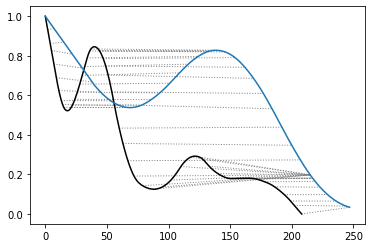

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.7372683019969495


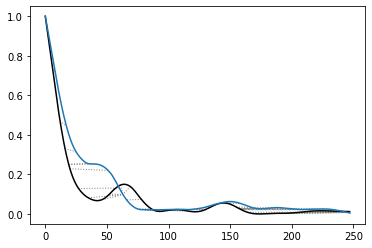

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.1372359308934348


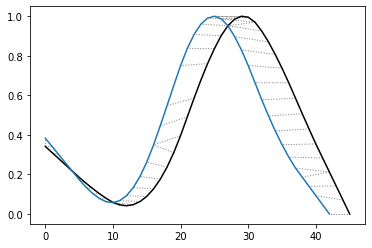

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.404475927466358


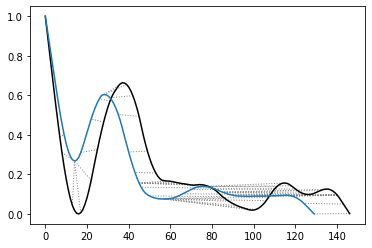

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.1592066069495752


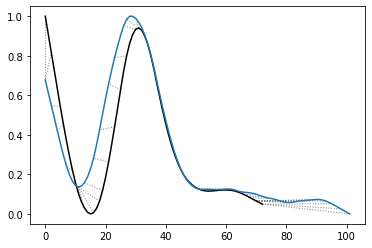

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.4156248207865705


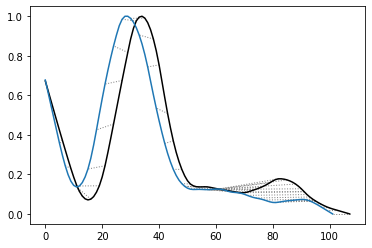

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.5831956110244308


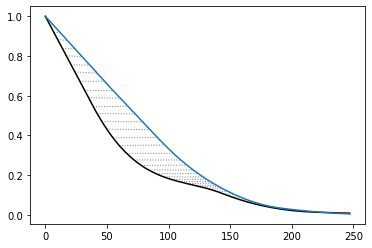

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3401804301033255


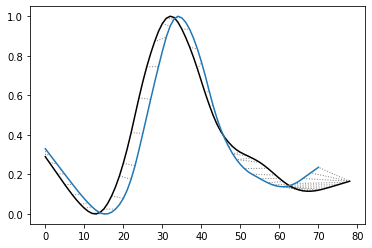

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize64_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.033287268878971


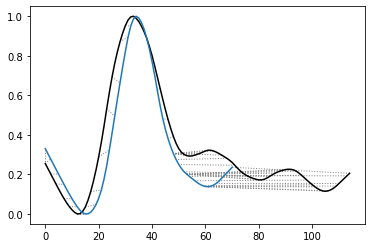

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8943251331580453


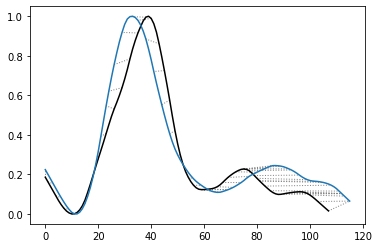

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4909198728966775


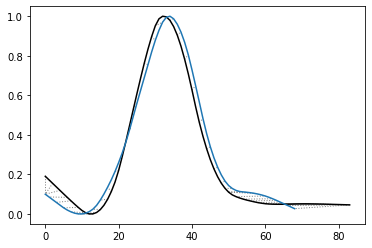

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g4dn_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.8784472608676097


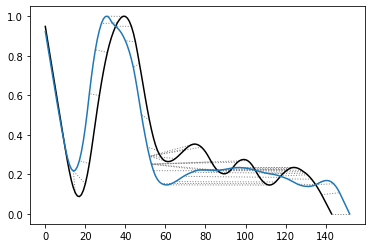

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.5428405726455143


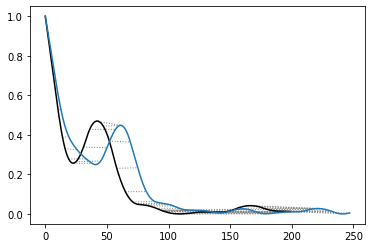

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g4dn_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.7289327687187284


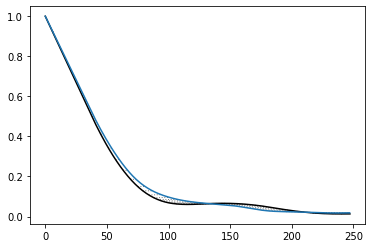

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8940236125611711


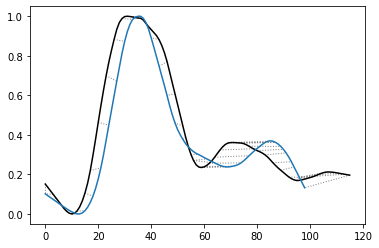

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize256_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.0967242573916773


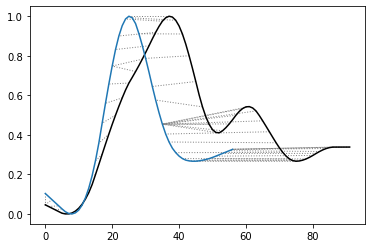

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.581296606036186


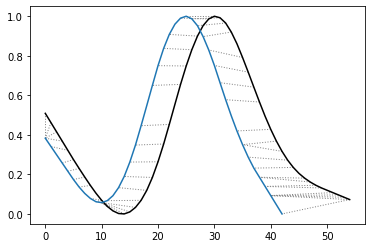

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.071793112167589


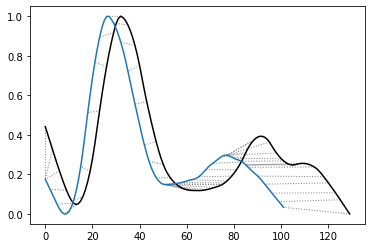

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize32_datasize256_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.3087654618213587


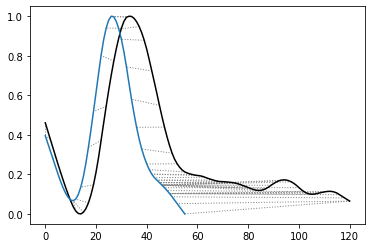

-----------------------------------------------------------------------------
g5_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.7090027767210216


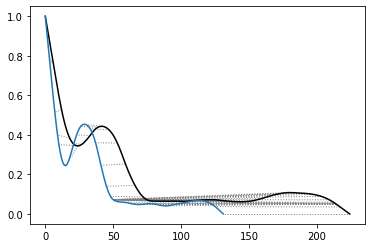

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.434645057360055


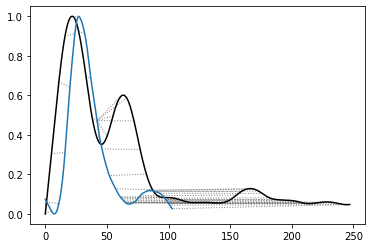

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.842920392674457


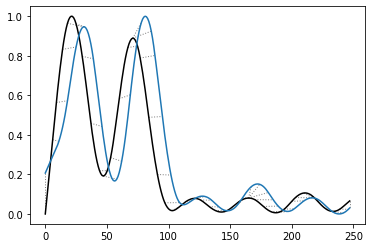

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.9793306654181169


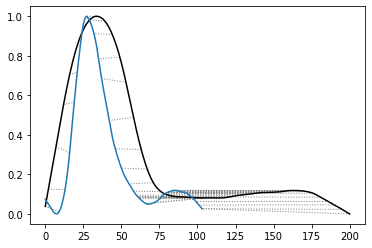

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.72645304993379


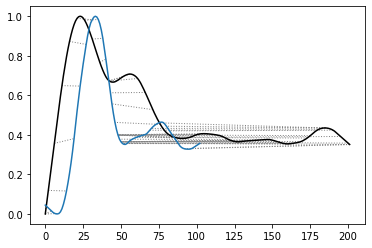

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7929575928173602


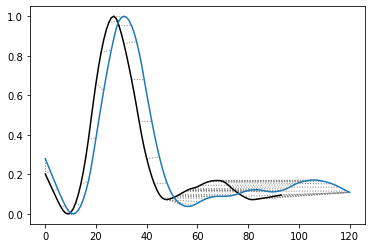

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.600981941570056


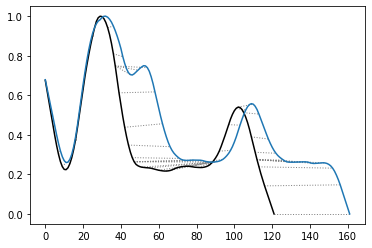

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.7366946208268605


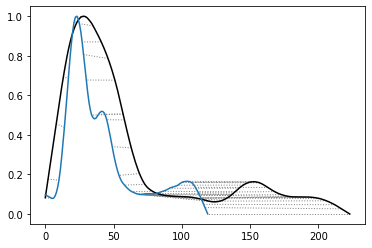

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.385234670987178


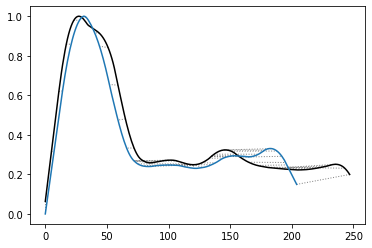

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  8.283220302296344


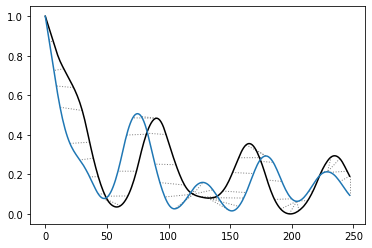

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  7.9122023027860475


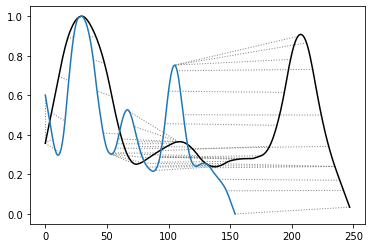

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3404679906293353


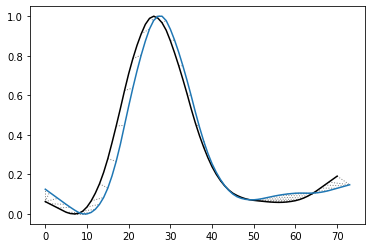

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.8394458756491208


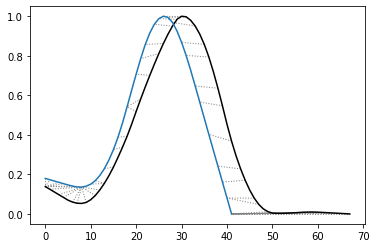

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.2563091095942807


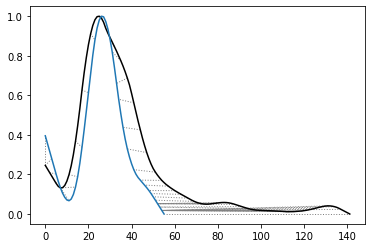

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.008691738831732


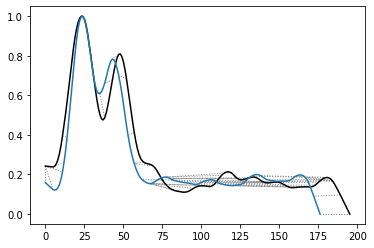

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.1377879026574185


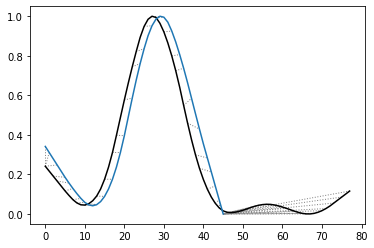

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.6524076475129945


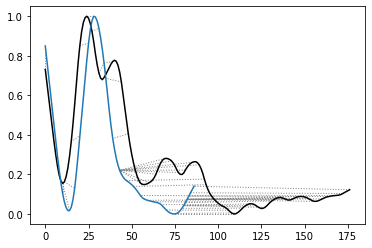

-----------------------------------------------------------------------------
g4dn_MNIST_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  13.485221455446045


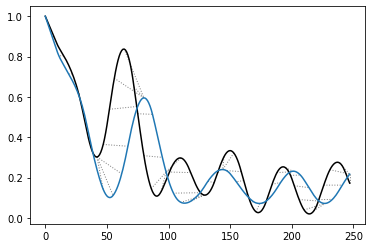

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1176959193173457


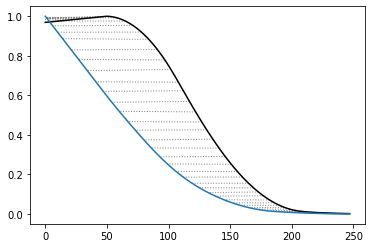

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.120700144061774


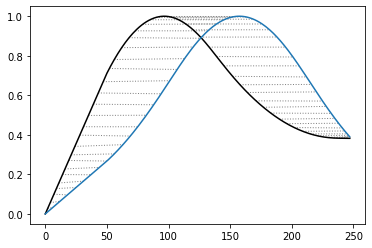

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.110121898025632


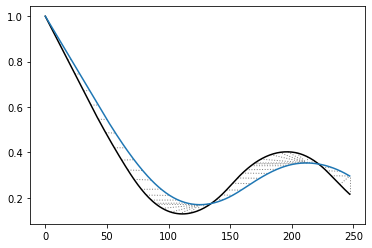

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.9024895461467874


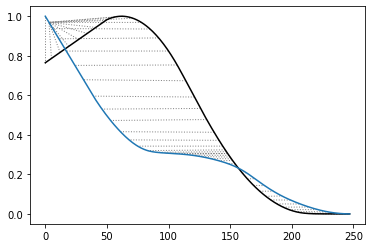

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.4815404904612348


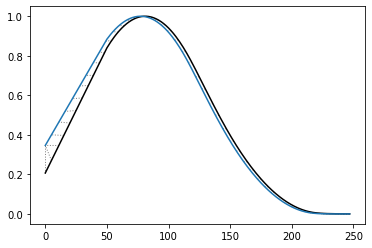

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.23827275875636


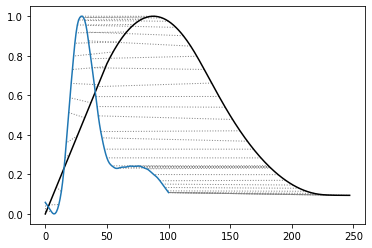

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6255632387286632


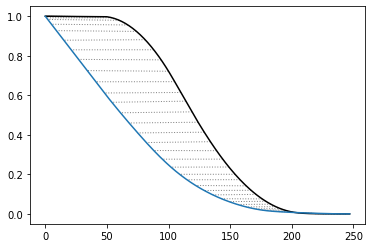

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.2531973227126103


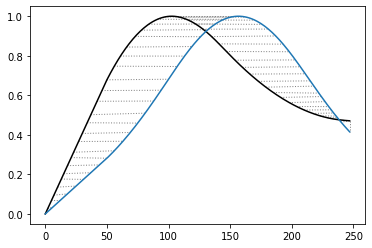

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8284013147744216


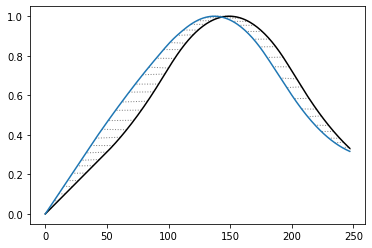

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.5986949018155796


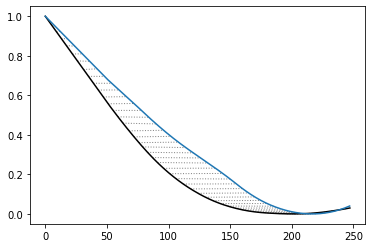

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3626087264164188


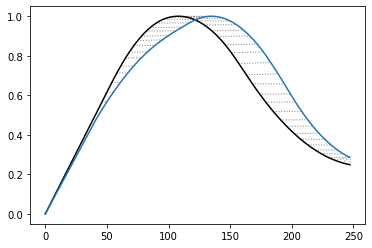

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.4454914091381237


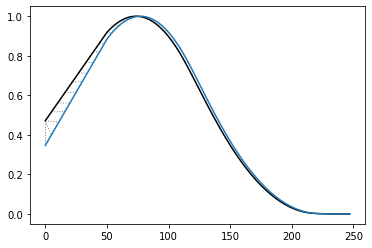

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.0505906856668246


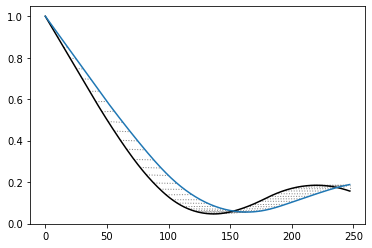

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.334209725718633


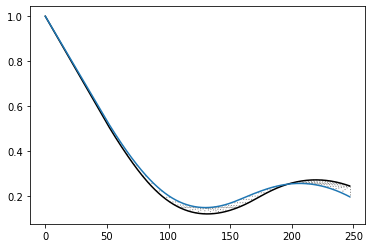

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.6969315731248629


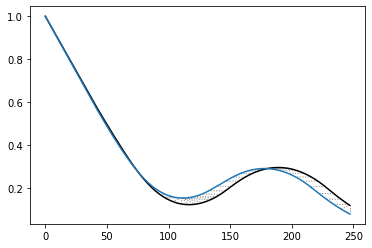

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  6.695663864843366


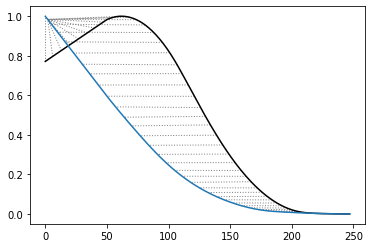

-----------------------------------------------------------------------------
g4dn_AlexNet_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6338883858812818


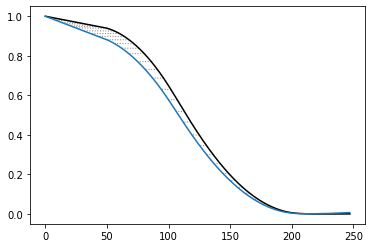

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.9192975898760265


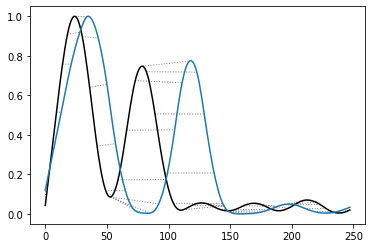

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  12.753135370379386


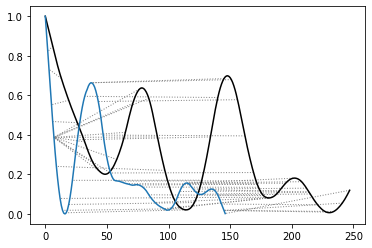

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.584138902994374


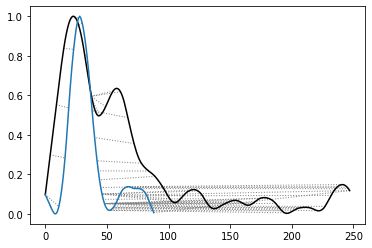

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.577095555475756


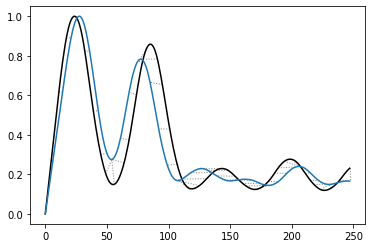

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.602219489415861


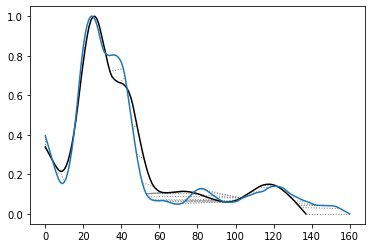

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.5178810219467223


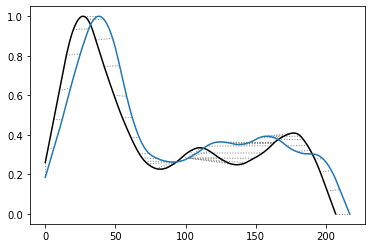

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.632278911478545


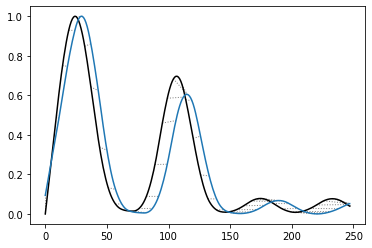

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.7452346403096906


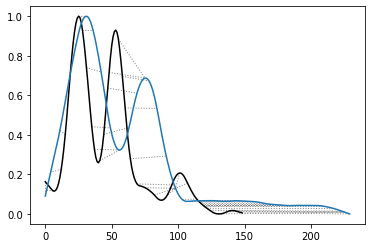

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.3994088637609474


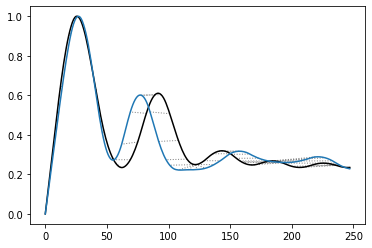

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.411400956482116


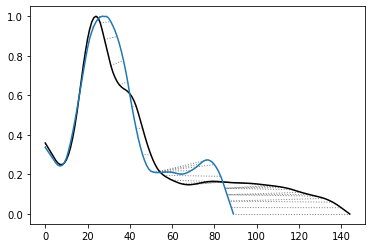

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.671479429623401


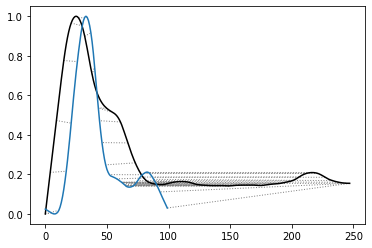

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.524383874629184


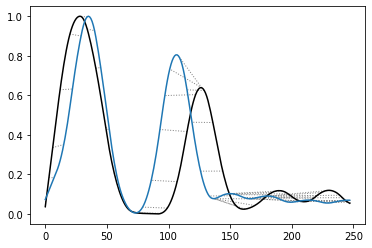

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.3184163404065554


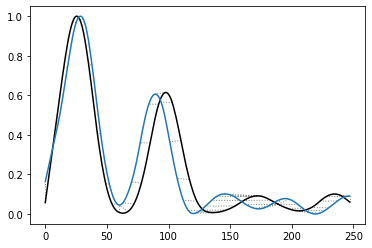

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  8.142825630327113


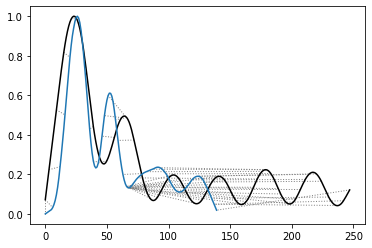

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3627792866237085


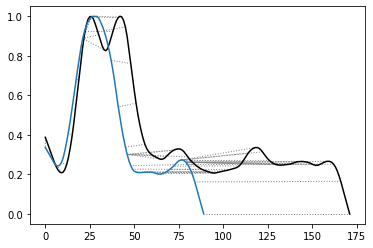

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.5763036893986259


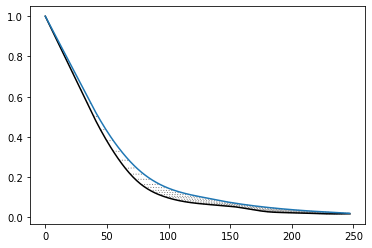

-----------------------------------------------------------------------------
g4dn_CIFAR10_CNN_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  5.177451981935398


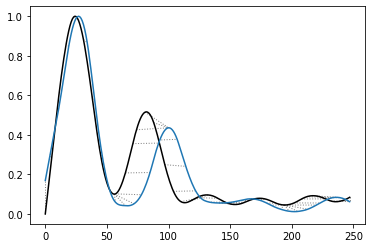

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  11.113723361494102


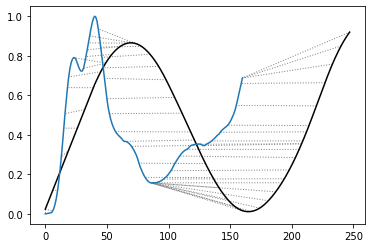

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  15.285836640055075


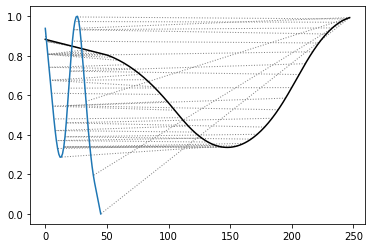

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  16.489452498276904


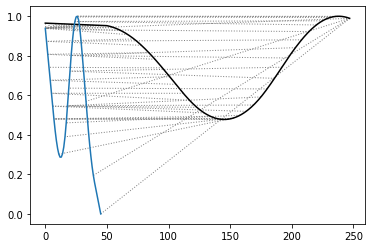

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  17.313576074517993


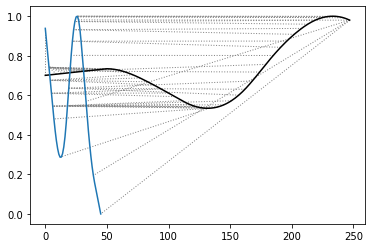

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionResNetV2_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  8.785752926127156


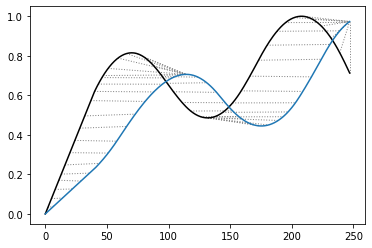

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_MNIST_CNN_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  11.982922553627374


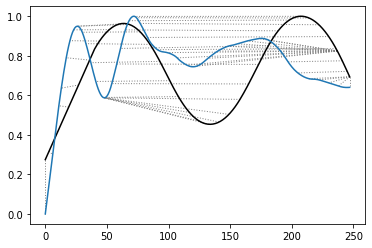

-----------------------------------------------------------------------------
g4dn_InceptionV3_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.723431297106902


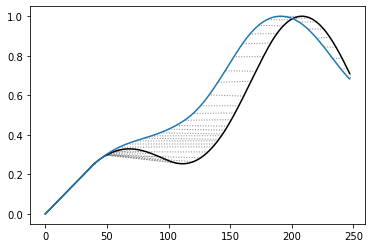

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.583558828179467


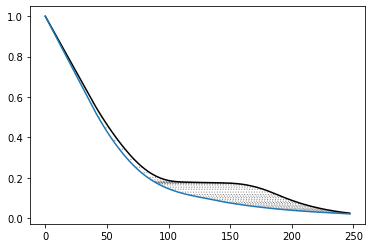

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_AlexNet_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  5.949223062211687


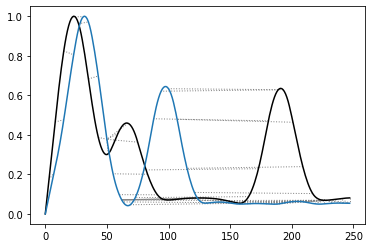

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.8113770586442042


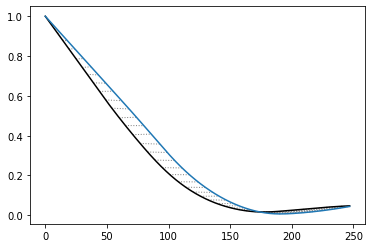

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize64_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8915206132638267


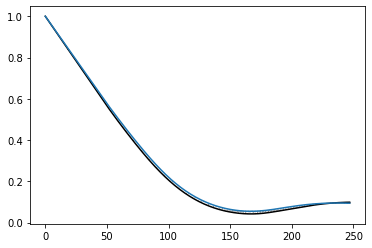

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.5800837673088888


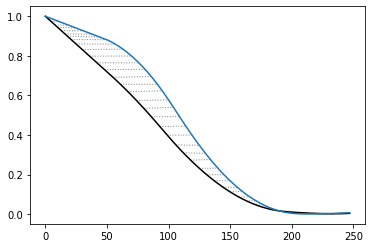

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6452555974836637


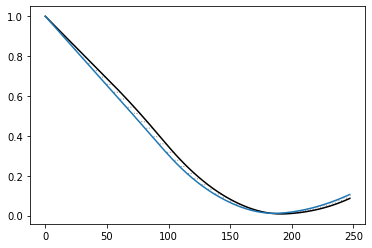

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.8252118419166419


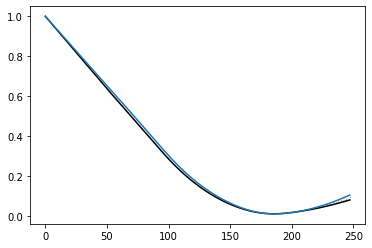

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_VGG19_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.5727582549624791


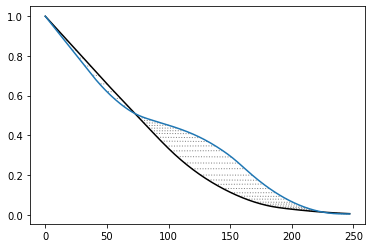

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  6.384911821763853


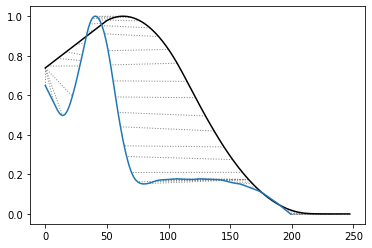

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.5998211455689073


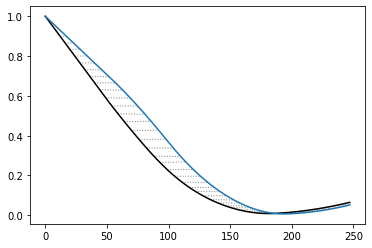

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6046088453316129


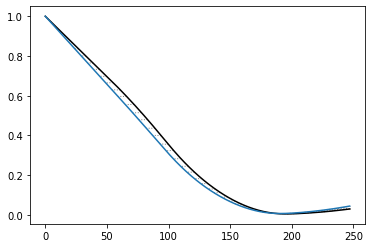

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6204653680673684


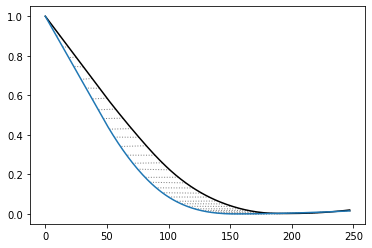

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.6869501677387572


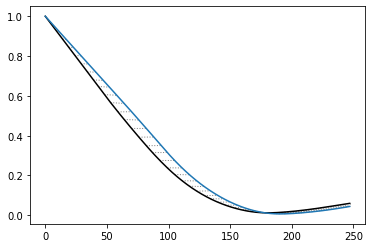

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.1192466075575391


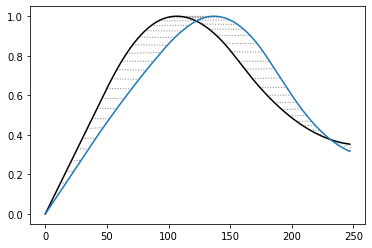

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  0.7903972025616095


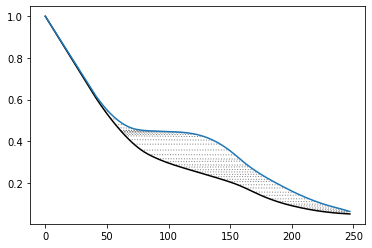

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize32_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.3233414864473607


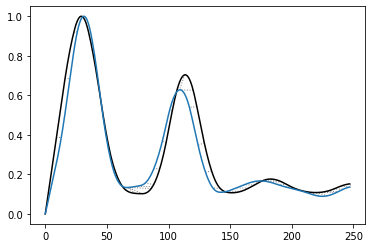

-----------------------------------------------------------------------------
g4dn_VGG19_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.9916311236499786


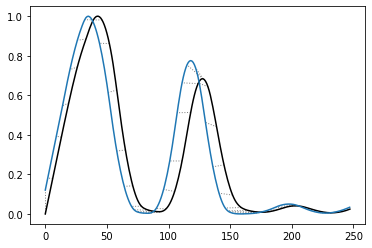

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  11.53019768554802


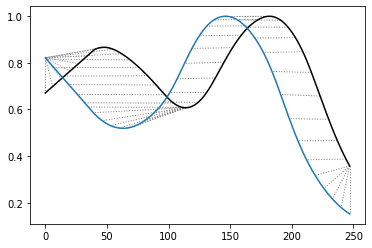

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  13.025362559279028


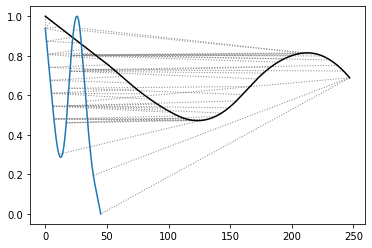

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.875461741547758


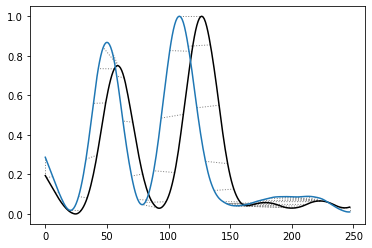

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  15.360520943357749


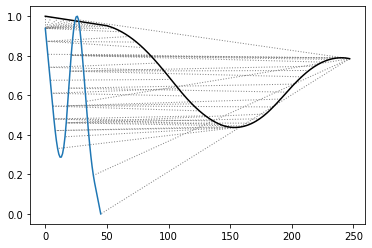

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  10.436030659654527


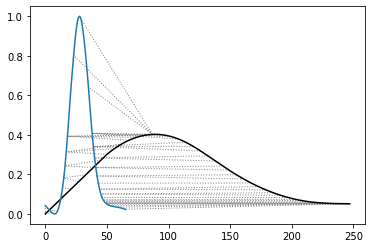

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_AlexNet_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.2400867483652425


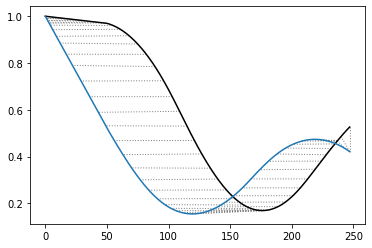

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_InceptionV3_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.857867363558067


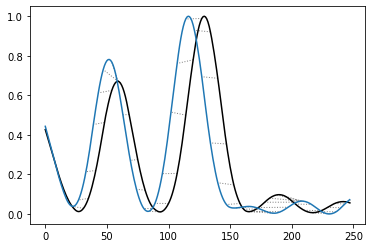

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize64_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  10.190584960964312


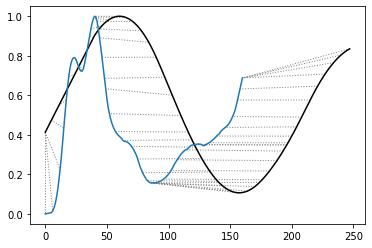

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.2768917436584477


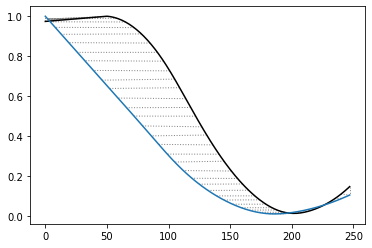

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  16.077252352072755


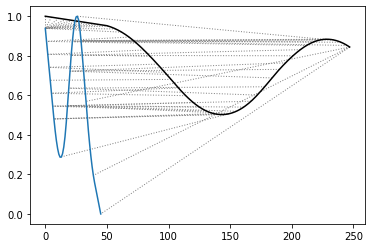

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  15.040021844833705


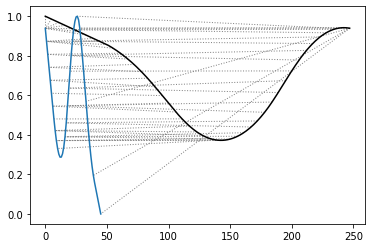

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  15.679876116966712


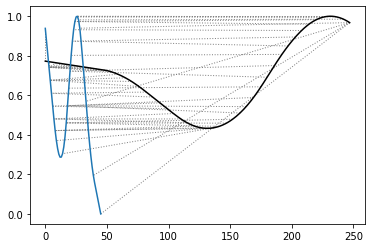

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize16_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  4.92547600143633


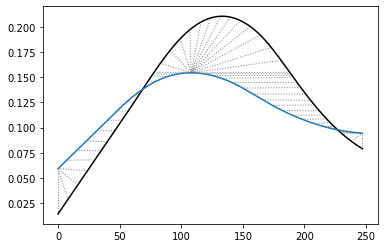

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.9614158793897927


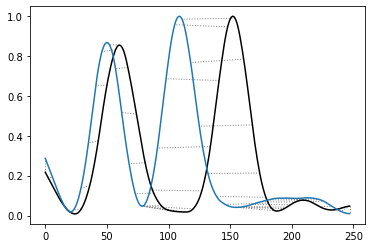

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_VGG19_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.6562251589802559


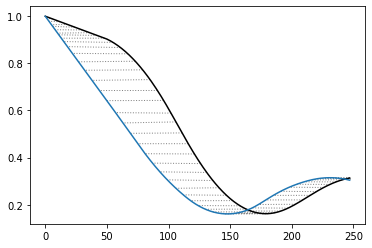

-----------------------------------------------------------------------------
g4dn_ResNet50_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNet50_batchsize128_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.305959130070525


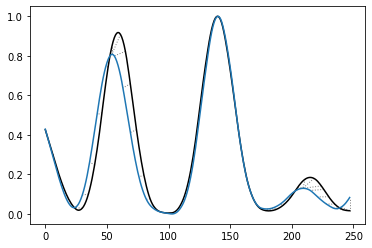

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.5962064437106567


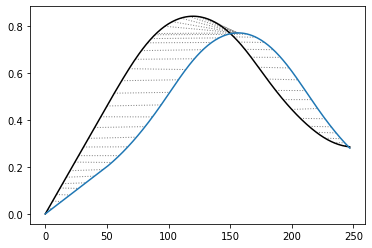

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize256_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  4.113158215544763


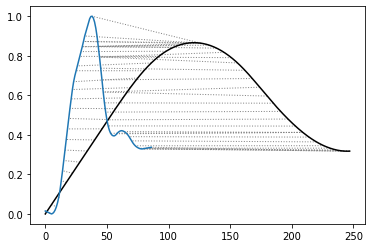

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  0.972574380536296


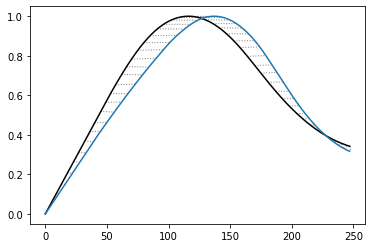

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.8794361666820703


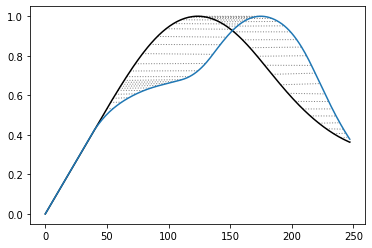

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_InceptionResNetV2_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.038920208684652


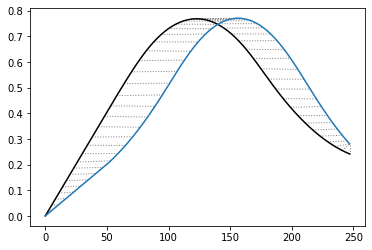

-----------------------------------------------------------------------------
g4dn_InceptionResNetV2_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNet50_batchsize16_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  1.0948567746705502


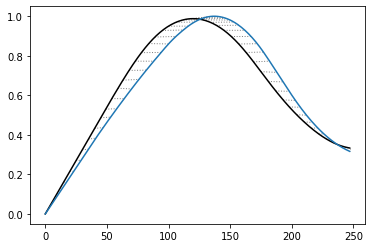

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7282894645162077


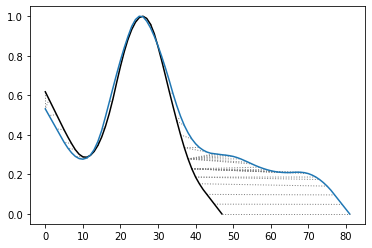

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.520277164609728


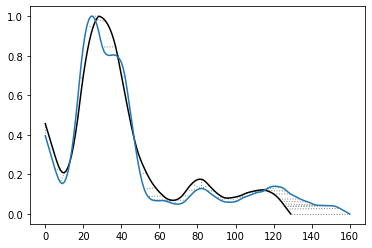

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.0770154852912235


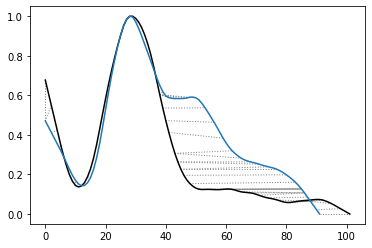

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.3665565045152226


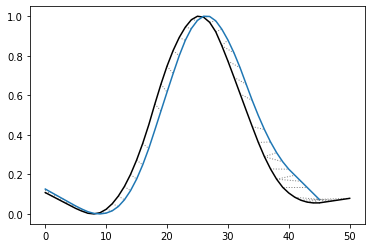

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  9.415454829373873


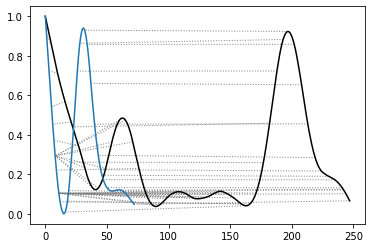

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.9542053731530733


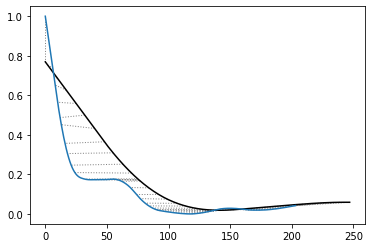

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.941185882418896


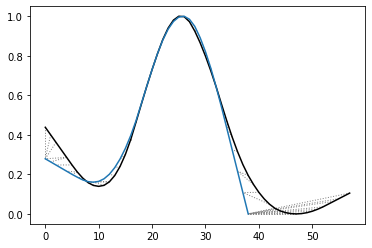

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.4720193999805078


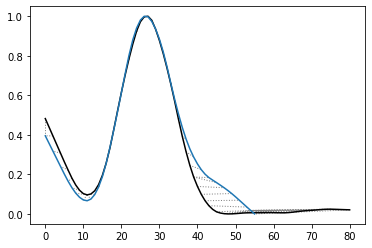

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  7.231204756376581


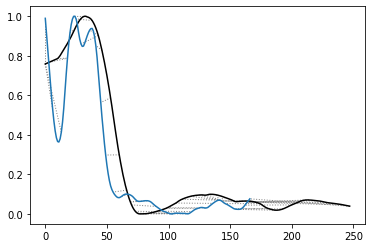

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize128_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.2098277123018697


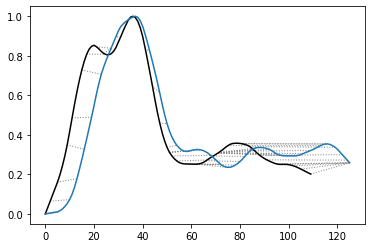

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize16_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  3.8007046773720763


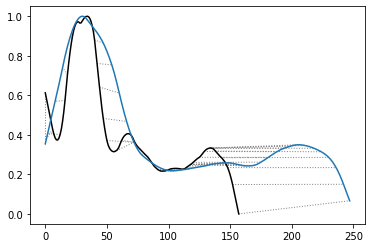

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.3325264471946845


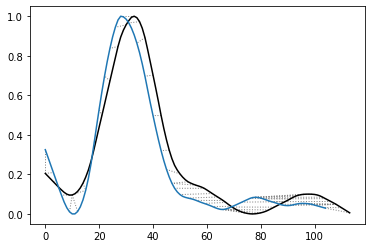

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.3770230777600716


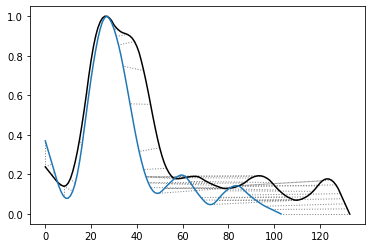

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_MNIST_CNN_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.393262781017183


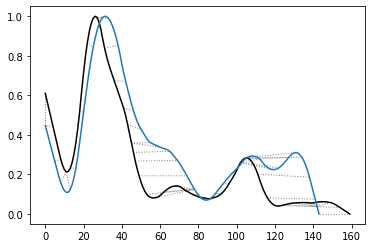

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  2.4841386288369827


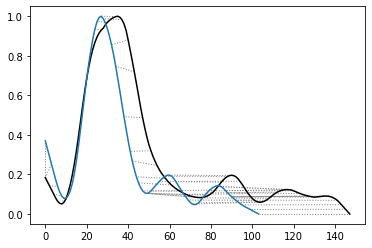

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.7019920415645629


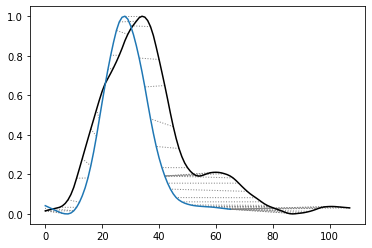

-----------------------------------------------------------------------------
g4dn_LeNet5_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.772600141897032


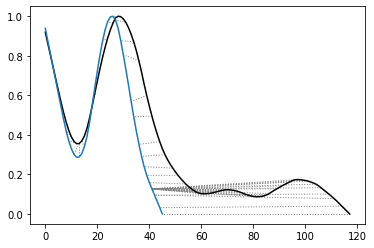

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize64_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.616955981357634


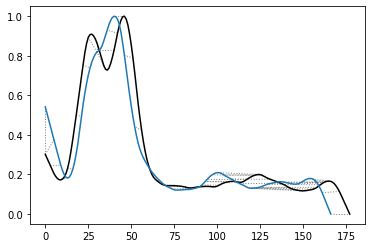

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize64_datasize224_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.346347230485051


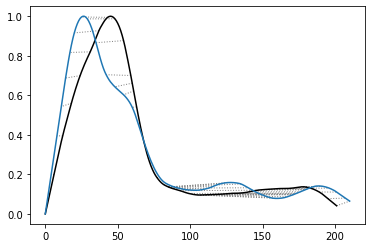

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  4.4129469095845435


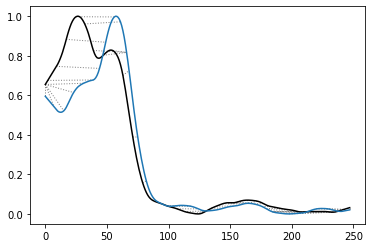

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize64_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.3324870655461485


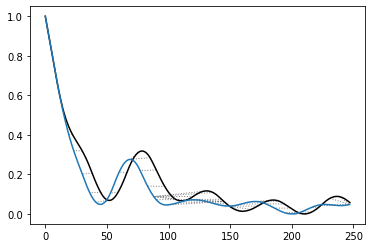

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize256_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_CIFAR10_CNN_batchsize128_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.028115247626399


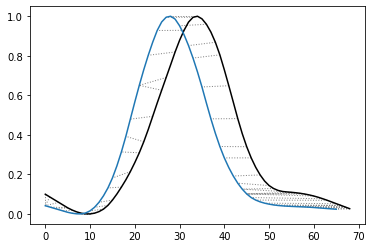

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.7267151062573034


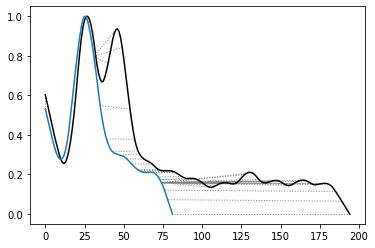

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize64_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_LeNet5_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  1.9016017729518293


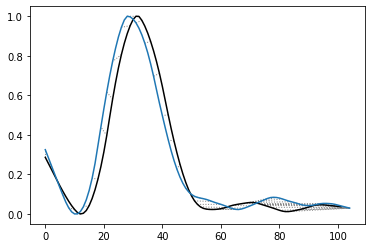

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  g5_LeNet5_batchsize64_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.4933259552595053


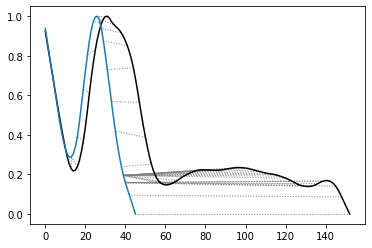

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  g5_VGG19_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  0.6576932436983421


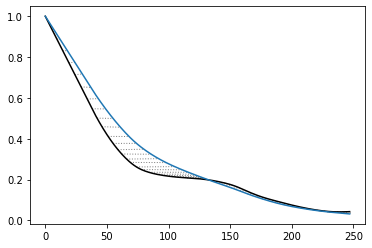

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize256_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.8977948745667184


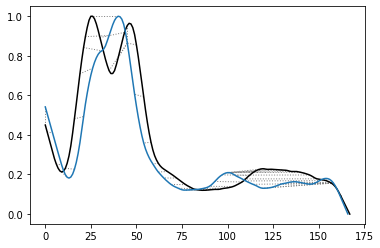

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize128_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_ResNetSmall_batchsize32_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  2.7428348826030664


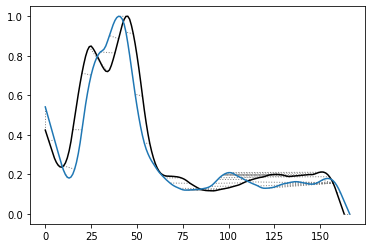

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize32_datasize128_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize16_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  3.767860194704112


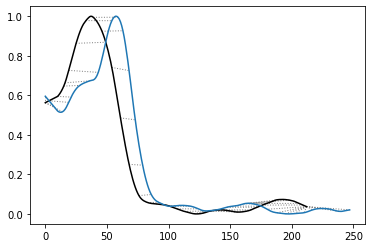

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p3_ResNetSmall_batchsize256_datasize32_total_epoch10_totaldata50000
DTW 값이 가장 작은값을 골라내기 :  3.078266447748401


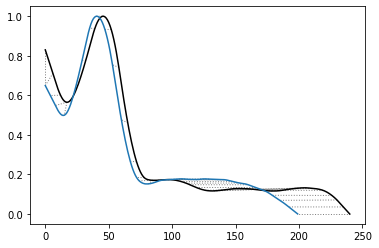

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize128_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.2235373613128486


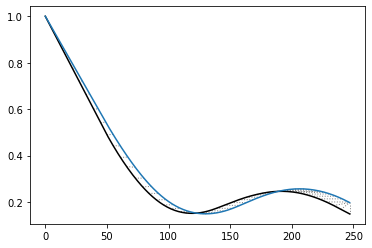

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize128_datasize64_total_epoch10_totaldata5000 와 가장 비슷한 매트릭은 ?  
=  p100_LeNet5_batchsize256_datasize64_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.5717116475643058


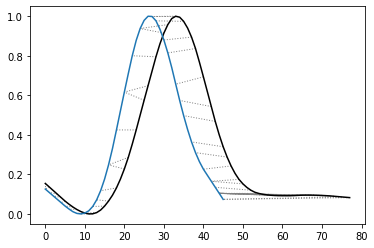

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize16_datasize224_total_epoch10_totaldata2000 와 가장 비슷한 매트릭은 ?  
=  p3_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000
DTW 값이 가장 작은값을 골라내기 :  1.9615612425444169


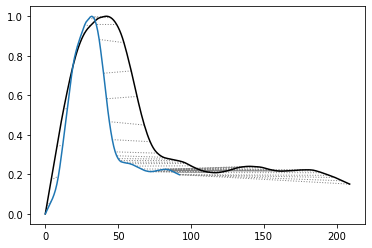

-----------------------------------------------------------------------------
g4dn_ResNetSmall_batchsize128_datasize32_total_epoch10_totaldata50000 와 가장 비슷한 매트릭은 ?  
=  p100_AlexNet_batchsize32_datasize256_total_epoch10_totaldata2000
DTW 값이 가장 작은값을 골라내기 :  2.1734220896355105


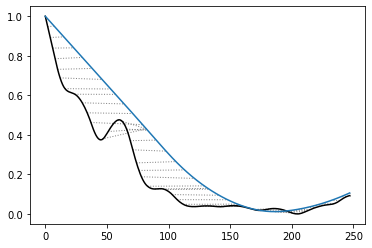

-----------------------------------------------------------------------------


In [78]:
for i in DTW_gpuutilization.columns:
    while(True):  # 동일한 인스턴스가 뽑히는걸 방지해준다.  
        min_value = min(DTW_gpuutilization[i])
        if(i[:i.find('_')] != DTW_gpuutilization.columns[list(DTW_gpuutilization[i]).index(min_value)][:i.find('_')]):
            break
        DTW_gpuutilization[i][list(DTW_gpuutilization[i]).index(min_value)]=100

    print(i + ' 와 가장 비슷한 매트릭은 ?  ') 
    print('=  '+ DTW_gpuutilization.columns[list(DTW_gpuutilization[i]).index(min_value)])
    print('DTW 값이 가장 작은값을 골라내기 :  '+ str(min_value))  # 최소값
    #print(list(DTW_gpuutilization[i]).index(min_value)) #최소값 Index
    
    query = np.array(Timeseries_gpu_utilization[i])
    query = query[np.isfinite(query)] # 뒤쪽에 nan 값 제거
    query2 = np.array(Timeseries_gpu_utilization[DTW_gpuutilization.columns[list(DTW_gpuutilization[i]).index(min_value)]])
    query2 = query2[np.isfinite(query2)] # 뒤쪽에 nan 값 제거
    dtw_value = dtw.dtw(query,query2,keep_internals=True).distance
    #print(dtw_value)
    dtw.dtw(query,query2,keep_internals=True).plot(type="twoway")
    Gpuutil_similar_metric['Similar_metric'][i]  = DTW_gpuutilization.columns[list(DTW_gpuutilization[i]).index(min_value)]
    Gpuutil_similar_metric['DTW'][i]  = min_value
    print("-----------------------------------------------------------------------------")


## 3. 매트릭별로 전체 실험중 가장 흡사한 매트릭 찾아서 매치

In [85]:
Memoryutil_similar_metric.to_csv("Memoryutil_find_best_similar_metric.csv")
Memoryutil_similar_metric.head()

,Similar_metric,DTW
p100_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000,p3_CIFAR10_CNN_batchsize128_datasize32_total_e...,3.74633
p100_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000,g5_CIFAR10_CNN_batchsize32_datasize128_total_e...,4.55609
p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000,g4dn_MNIST_CNN_batchsize16_datasize64_total_ep...,2.21464
p100_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000,p3_MNIST_CNN_batchsize64_datasize224_total_epo...,4.15141
p100_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000,p3_CIFAR10_CNN_batchsize256_datasize64_total_e...,1.54744


In [80]:
Gpuutil_similar_metric.to_csv("Gpuutil_find_best_similar_metric.csv")
Gpuutil_similar_metric.head()

,Similar_metric,DTW
p100_MNIST_CNN_batchsize32_datasize224_total_epoch10_totaldata2000,p3_CIFAR10_CNN_batchsize32_datasize224_total_e...,3.79765
p100_MNIST_CNN_batchsize16_datasize224_total_epoch10_totaldata2000,p3_CIFAR10_CNN_batchsize32_datasize128_total_e...,5.05036
p100_MNIST_CNN_batchsize64_datasize128_total_epoch10_totaldata5000,p3_LeNet5_batchsize32_datasize128_total_epoch1...,2.53218
p100_MNIST_CNN_batchsize256_datasize128_total_epoch10_totaldata5000,p3_MNIST_CNN_batchsize128_datasize224_total_ep...,4.27183
p100_MNIST_CNN_batchsize32_datasize64_total_epoch10_totaldata5000,p3_LeNet5_batchsize128_datasize128_total_epoch...,1.75674
